<a href="https://colab.research.google.com/github/escuccim/vaegan-pytorch/blob/master/VAEGAN_DenseNet169_2a.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import torchvision
from torch import nn
from torch.utils.data import DataLoader
from matplotlib import pyplot as plt, colors
%matplotlib inline
import zipfile
import os
import matplotlib.animation as animation
import torchvision.utils as vutils
import numpy as np
import re
import random
import pandas as pd
import torch.nn.functional as F
from torch.autograd import Variable
from torch.utils.data import Dataset
from torch import Tensor
from torch.optim import RMSprop,Adam,SGD
from torch.optim.lr_scheduler import ExponentialLR,MultiStepLR
from torchvision.utils import make_grid
from torch.autograd import Variable
from torch.utils.data import Dataset
from torch.optim import RMSprop,Adam,SGD
from torch.optim.lr_scheduler import ExponentialLR,MultiStepLR
from torchvision.utils import make_grid
from sklearn.metrics import f1_score
import torchvision.utils as vutils
from collections import OrderedDict
from torch.hub import load_state_dict_from_url

from google.colab import auth
auth.authenticate_user()

# upload checkpoint to GCS
project_id = 'mammography-198911'
bucket_name = 'gan-faces'

!gcloud config set project {project_id}

Updated property [core/project].


In [0]:
model_save_path = "vaegan_dn169_2a.pt"
disc_opt_save_path = "vaegan_dn169_opt_disc_2a.pt"
enc_opt_save_path = "vaegan_dn169_opt_enc_2a.pt"
dec_opt_save_path = "vaegan_dn169_opt_dec_2a.pt"

In [3]:
!gsutil cp gs://{bucket_name}/{model_save_path} ./{model_save_path} 
!gsutil cp gs://{bucket_name}/{disc_opt_save_path} ./{disc_opt_save_path} 
!gsutil cp gs://{bucket_name}/{dec_opt_save_path} ./{dec_opt_save_path} 
!gsutil cp gs://{bucket_name}/{enc_opt_save_path} ./{enc_opt_save_path} 

# !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/faces/{model_save_path}
# !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/faces/{disc_opt_save_path}
# !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/faces/{enc_opt_save_path}
# !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/faces/{dec_opt_save_path}

Copying gs://gan-faces/vaegan_dn169_2a.pt...
\ [1 files][151.3 MiB/151.3 MiB]                                                
Operation completed over 1 objects/151.3 MiB.                                    
Copying gs://gan-faces/vaegan_dn169_opt_disc_2a.pt...
- [1 files][ 48.0 MiB/ 48.0 MiB]                                                
Operation completed over 1 objects/48.0 MiB.                                     
Copying gs://gan-faces/vaegan_dn169_opt_dec_2a.pt...
-
Operation completed over 1 objects/47.6 MiB.                                     
Copying gs://gan-faces/vaegan_dn169_opt_enc_2a.pt...
- [1 files][ 54.2 MiB/ 54.2 MiB]                                                
Operation completed over 1 objects/54.2 MiB.                                     


In [0]:
model_urls = {
    'densenet121': 'https://download.pytorch.org/models/densenet121-a639ec97.pth',
    'densenet169': 'https://download.pytorch.org/models/densenet169-b2777c0a.pth',
    'densenet201': 'https://download.pytorch.org/models/densenet201-c1103571.pth',
    'densenet161': 'https://download.pytorch.org/models/densenet161-8d451a50.pth',
}

In [5]:
if not os.path.exists("celeba-dataset.zip"):
#   !kaggle datasets download -d jessicali9530/celeba-dataset
  !gsutil cp gs://{bucket_name}/celeba-dataset.zip ./celeba-dataset.zip
  zip_ref = zipfile.ZipFile('celeba-dataset.zip', 'r')
  zip_ref.extractall('data')
  zip_ref.close()

  zip_ref = zipfile.ZipFile('data/img_align_celeba.zip', 'r')
  zip_ref.extractall('data/images')
  zip_ref.close()

# if not os.path.exists("wiki_images_good.zip"):
#   !gsutil cp gs://{bucket_name}/wiki_images_good.zip ./ 
#   zip_ref = zipfile.ZipFile('wiki_images_good.zip', 'r')
#   zip_ref.extractall('data/wiki_images')
#   zip_ref.close()  

# if not os.path.exists("celeb_a_good.zip"):
# #   !kaggle datasets download -d jessicali9530/celeba-dataset
#   !gsutil cp gs://{bucket_name}/celeb_a_good.zip ./celeb_a_good.zip
#   zip_ref = zipfile.ZipFile('celeb_a_good.zip', 'r')
#   zip_ref.extractall('data/images/celeb_a')
#   zip_ref.close()

# if not os.path.exists("Training_Pictures.zip"):
#   !wget https://s3.eu-west-3.amazonaws.com/deep.skoo.ch/Training_Pictures.zip
#   zip_ref = zipfile.ZipFile('Training_Pictures.zip', 'r')
#   zip_ref.extractall('data/images/training')
#   zip_ref.close()
  
# if not os.path.exists("imdb_crop_good.zip"):  
#   !gsutil cp gs://{bucket_name}/imdb_crop_good.zip ./imdb_crop_good.zip
#   zip_ref = zipfile.ZipFile('imdb_crop_good.zip', 'r')
#   zip_ref.extractall('data/images/imdb')
#   zip_ref.close()

# if not os.path.exists("crop_part1_good.zip"):
#   !gsutil cp gs://{bucket_name}/crop_part1_good.zip ./crop_part1_good.zip
#   zip_ref = zipfile.ZipFile('crop_part1_good.zip', 'r')
#   zip_ref.extractall('data/images/crop_parta')
#   zip_ref.close()   

Copying gs://gan-faces/celeba-dataset.zip...
/ [1 files][  1.2 GiB/  1.2 GiB]  100.1 MiB/s                                   
Operation completed over 1 objects/1.2 GiB.                                      


In [6]:
if not os.path.exists("crop_part1_good.zip"):
  !gsutil cp gs://pneumonia/crop_part1_good.zip ./crop_part1_good.zip
  zip_ref = zipfile.ZipFile('crop_part1_good.zip', 'r')
  zip_ref.extractall('data/test_images/crop_parta')
  zip_ref.close()   

# !gsutil cp crop_part1_good.zip  gs://{bucket_name}/crop_part1_good.zip 

Copying gs://pneumonia/crop_part1_good.zip...
- [1 files][ 49.4 MiB/ 49.4 MiB]                                                
Operation completed over 1 objects/49.4 MiB.                                     


In [0]:
def masked_f1_score(outputs, labels):
    # mins, _ = labels.min(dim=1)
    mask = labels != -1
    f1 = f1_score(torch.squeeze(labels[mask].detach().cpu().float().view(-1)), torch.round(outputs[mask].detach().cpu().float().view(-1)), average="micro")
    return f1

def masked_accuracy(outputs, b_labels):
    mins, _ = b_labels.min(dim=1)
    mask = mins != -1
    accuracy = torch.mean((torch.round(outputs[mask].float()) == b_labels[mask].float()).float())
    return accuracy

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class _DenseLayer(nn.Module):
    def __init__(self, num_input_features, growth_rate, bn_size, drop_rate, memory_efficient=False):
        super(_DenseLayer, self).__init__()
        self.add_module('norm1', nn.BatchNorm2d(num_input_features)),
        self.add_module('relu1', nn.LeakyReLU(0.2, inplace=True)),
        self.add_module('conv1', nn.Conv2d(num_input_features, bn_size *
                                           growth_rate, kernel_size=1, stride=1,
                                           bias=False)),
        self.add_module('norm2', nn.BatchNorm2d(bn_size * growth_rate)),
        self.add_module('relu2', nn.LeakyReLU(0.2, inplace=True)),
        self.add_module('conv2', nn.Conv2d(bn_size * growth_rate, growth_rate,
                                           kernel_size=3, stride=1, padding=1,
                                           bias=False)),
        self.drop_rate = float(drop_rate)
        self.memory_efficient = memory_efficient

    def bn_function(self, inputs):
        # type: (List[Tensor]) -> Tensor
        concated_features = torch.cat(inputs, 1)
        bottleneck_output = self.conv1(self.relu1(self.norm1(concated_features)))  # noqa: T484
        return bottleneck_output

    # todo: rewrite when torchscript supports any
    def any_requires_grad(self, input):
        # type: (List[Tensor]) -> bool
        for tensor in input:
            if tensor.requires_grad:
                return True
        return False

    # @torch.jit.unused  # noqa: T484
    def call_checkpoint_bottleneck(self, input):
        # type: (List[Tensor]) -> Tensor
        def closure(*inputs):
            return self.bn_function(*inputs)

        return cp.checkpoint(closure, input)

    # @torch.jit._overload_method  # noqa: F811
    def forward(self, input):
        # type: (List[Tensor]) -> (Tensor)
        pass

    # @torch.jit._overload_method  # noqa: F811
    def forward(self, input):
        # type: (Tensor) -> (Tensor)
        pass

    # torchscript does not yet support *args, so we overload method
    # allowing it to take either a List[Tensor] or single Tensor
    def forward(self, input):  # noqa: F811
        if isinstance(input, Tensor):
            prev_features = [input]
        else:
            prev_features = input

        if self.memory_efficient and self.any_requires_grad(prev_features):
            if torch.jit.is_scripting():
                raise Exception("Memory Efficient not supported in JIT")

            bottleneck_output = self.call_checkpoint_bottleneck(prev_features)
        else:
            bottleneck_output = self.bn_function(prev_features)

        new_features = self.conv2(self.relu2(self.norm2(bottleneck_output)))
        if self.drop_rate > 0:
            new_features = F.dropout(new_features, p=self.drop_rate,
                                     training=self.training)
        return new_features

class _Transition(nn.Sequential):
    def __init__(self, num_input_features, num_output_features):
        super(_Transition, self).__init__()
        self.add_module('norm', nn.BatchNorm2d(num_input_features))
        self.add_module('relu', nn.ReLU(inplace=True))
        self.add_module('conv', nn.Conv2d(num_input_features, num_output_features,
                                          kernel_size=1, stride=1, bias=False))
        self.add_module('pool', nn.AvgPool2d(kernel_size=2, stride=2))

class _DenseBlock(nn.Module):
    _version = 2
    __constants__ = ['layers']

    def __init__(self, num_layers, num_input_features, bn_size, growth_rate, drop_rate, memory_efficient=False):
        super(_DenseBlock, self).__init__()
        self.layers = nn.ModuleDict()
        for i in range(num_layers):
            layer = _DenseLayer(
                num_input_features + i * growth_rate,
                growth_rate=growth_rate,
                bn_size=bn_size,
                drop_rate=drop_rate,
                memory_efficient=memory_efficient,
            )
            self.layers['denselayer%d' % (i + 1)] = layer

    def forward(self, init_features):
        features = [init_features]
        for name, layer in self.layers.items():
            new_features = layer(features)
            features.append(new_features)
        return torch.cat(features, 1)

    @torch.jit.ignore
    def _load_from_state_dict(self, state_dict, prefix, local_metadata, strict,
                              missing_keys, unexpected_keys, error_msgs):
        version = local_metadata.get('version', None)
        if (version is None or version < 2):
            # now we have a new nesting level for torchscript support
            for new_key in self.state_dict().keys():
                # remove prefix "layers."
                old_key = new_key[len("layers."):]
                old_key = prefix + old_key
                new_key = prefix + new_key
                if old_key in state_dict:
                    value = state_dict[old_key]
                    del state_dict[old_key]
                    state_dict[new_key] = value
        super(_DenseBlock, self)._load_from_state_dict(
            state_dict, prefix, local_metadata, strict,
            missing_keys, unexpected_keys, error_msgs)

class DenseNet(torchvision.models.densenet.DenseNet):
    r"""Densenet-BC model class, based on
    `"Densely Connected Convolutional Networks" <https://arxiv.org/pdf/1608.06993.pdf>`_
    Args:
        growth_rate (int) - how many filters to add each layer (`k` in paper)
        block_config (list of 4 ints) - how many layers in each pooling block
        num_init_features (int) - the number of filters to learn in the first convolution layer
        bn_size (int) - multiplicative factor for number of bottle neck layers
          (i.e. bn_size * k features in the bottleneck layer)
        drop_rate (float) - dropout rate after each dense layer
        num_classes (int) - number of classification classes
        memory_efficient (bool) - If True, uses checkpointing. Much more memory efficient,
          but slower. Default: *False*. See `"paper" <https://arxiv.org/pdf/1707.06990.pdf>`_
    """

    __constants__ = ['features']
    
    def __init__(self, growth_rate=32, block_config=(6, 12, 24, 16),
                 num_init_features=64, bn_size=4, drop_rate=0, num_classes=1000, memory_efficient=False):

        super(DenseNet, self).__init__()

        # First convolution
        self.features = nn.Sequential(OrderedDict([
            ('conv0', nn.Conv2d(3, num_init_features, kernel_size=7, stride=2,
                                padding=3, bias=False)),
            ('norm0', nn.BatchNorm2d(num_init_features)),
            ('relu0', nn.LeakyReLU(0.2, inplace=True)),
            ('pool0', nn.AvgPool2d(kernel_size=3, stride=2, padding=1)),
        ]))

        # Each denseblock
        num_features = num_init_features
        for i, num_layers in enumerate(block_config):
            block = _DenseBlock(
                num_layers=num_layers,
                num_input_features=num_features,
                bn_size=bn_size,
                growth_rate=growth_rate,
                drop_rate=drop_rate,
                memory_efficient=memory_efficient
            )
            self.features.add_module('denseblock%d' % (i + 1), block)
            num_features = num_features + num_layers * growth_rate
            if i != len(block_config) - 1:
                trans = _Transition(num_input_features=num_features,
                                    num_output_features=num_features // 2)
                self.features.add_module('transition%d' % (i + 1), trans)
                num_features = num_features // 2

        # Final batch norm
        self.features.add_module('norm5', nn.BatchNorm2d(num_features))

        # Linear layer
        self.classifier = nn.Linear(num_features, num_classes)

        # Official init from torch repo.
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.constant_(m.bias, 0)
                
    def forward(self, x):
        features = self.features(x)
        feature_map = F.relu(features, inplace=False)
        out = F.adaptive_avg_pool2d(feature_map, (1, 1))
        out = torch.flatten(out, 1)
        output = self.classifier(out, feature_map=features)
        return output
    
def _load_state_dict(model, model_url, progress):
    # '.'s are no longer allowed in module names, but previous _DenseLayer
    # has keys 'norm.1', 'relu.1', 'conv.1', 'norm.2', 'relu.2', 'conv.2'.
    # They are also in the checkpoints in model_urls. This pattern is used
    # to find such keys.
    pattern = re.compile(
        r'^(.*denselayer\d+\.(?:norm|relu|conv))\.((?:[12])\.(?:weight|bias|running_mean|running_var))$')

    state_dict = load_state_dict_from_url(model_url, progress=progress)
    for key in list(state_dict.keys()):
        res = pattern.match(key)
        if res:
            new_key = res.group(1) + res.group(2)
            state_dict[new_key] = state_dict[key]
            del state_dict[key]
    model.load_state_dict(state_dict)

def _densenet(arch, growth_rate, block_config, num_init_features, pretrained, progress,
              **kwargs):
    model = DenseNet(growth_rate, block_config, num_init_features, **kwargs)
    if pretrained:
        _load_state_dict(model, model_urls[arch], progress)
    return model        
        
def densenet169(pretrained=False, progress=True, **kwargs):
    r"""Densenet-169 model from
    `"Densely Connected Convolutional Networks" <https://arxiv.org/pdf/1608.06993.pdf>`_
    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
        memory_efficient (bool) - If True, uses checkpointing. Much more memory efficient,
          but slower. Default: *False*. See `"paper" <https://arxiv.org/pdf/1707.06990.pdf>`_
    """
    return _densenet('densenet169', 32, (6, 12, 32, 32), 64, pretrained, progress,
                     **kwargs)   

def densenet201(pretrained=False, progress=True, **kwargs):
    r"""Densenet-201 model from
    `"Densely Connected Convolutional Networks" <https://arxiv.org/pdf/1608.06993.pdf>`_
    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
        memory_efficient (bool) - If True, uses checkpointing. Much more memory efficient,
          but slower. Default: *False*. See `"paper" <https://arxiv.org/pdf/1707.06990.pdf>`_
    """
    return _densenet('densenet201', 32, (6, 12, 48, 32), 64, pretrained, progress,
                     **kwargs)

class DecoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=4, stride=2, padding=0, bias=False):
        super(DecoderBlock, self).__init__()
        # transpose convolution to double the dimensions
        self.conv = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=kernel_size, padding=padding, stride=stride,
                                       bias=bias)
        self.bn = nn.BatchNorm2d(out_channels)
        self.relu = nn.LeakyReLU(0.2, inplace=False)

    def forward(self, ten):
        c1 = self.conv(ten)
        bn = self.bn(c1)
        relu = self.relu(bn)
        return relu
    
class Decoder(nn.Module):
    def __init__(self, latent_dim=256, ngf=64, ngpu=1):
        super(Decoder, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( latent_dim, ngf * 12, 5, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 12),
            nn.LeakyReLU(0.2, inplace=False),
            # state size. (ngf*8) x 5 x 5
            nn.ConvTranspose2d(ngf * 12, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.LeakyReLU(0.2, inplace=False),
            # state size. (ngf*4) x 10 x 10
            nn.ConvTranspose2d( ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.LeakyReLU(0.2, inplace=False),
            # state size. (ngf*2) x 20 x 20
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.LeakyReLU(0.2, inplace=False),
            # state size. (ngf) x 40 x 40
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 1),
            nn.LeakyReLU(0.2, inplace=False),
            # state size. (ngf) x 80 x 80
            nn.ConvTranspose2d( ngf * 1, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 160 x 160
        )

    def forward(self, input):
        return self.main(input.view(input.shape[0], -1, 1, 1))
    
class DiscriminatorOutput(nn.Module):
    def __init__(self, num_ftrs):
        super(DiscriminatorOutput, self).__init__()
        # Two FC Layers to output discriminator and aux output
        self.discriminator = nn.Linear(num_ftrs, 1)
        self.aux = nn.Linear(num_ftrs, 40)
        
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, features, feature_map=None):
        output = self.discriminator(features)
        aux_output = self.aux(features)
        
        return self.sigmoid(output), feature_map, self.sigmoid(aux_output)

class EncoderOutput(nn.Module):
    def __init__(self, num_ftrs, latent_dim=256):
        super(EncoderOutput, self).__init__()
        # Two FC Layers to output code and logvar
        self.code = nn.Linear(num_ftrs, latent_dim)
        self.logvar = nn.Linear(num_ftrs, latent_dim)
        
    def forward(self, features, feature_map=None):
        code = self.code(features)
        logvar = self.logvar(features)
        return code, logvar

class VaeGan(nn.Module):
    def __init__(self,z_size=128,recon_level=5, pretrained=True):
        super(VaeGan, self).__init__()
        # latent space size
        self.z_size = z_size
        
        self.encoder = densenet169(pretrained=pretrained)
        num_ftrs = self.encoder.classifier.in_features
        self.encoder.classifier = EncoderOutput(num_ftrs=num_ftrs, latent_dim=z_size)   

        self.decoder = Decoder(latent_dim=self.z_size, ngf=48)
        
        self.discriminator = densenet169(pretrained=pretrained)
        num_ftrs = self.discriminator.classifier.in_features
        self.discriminator.classifier = DiscriminatorOutput(num_ftrs=num_ftrs)
        
        # self-defined function to init the parameters
        self.init_parameters()

    def init_parameters(self):
        # just explore the network, find every weight and bias matrix and fill it
        for m in self.modules():
            classname = m.__class__.__name__
            if classname.find('Conv') != -1:
                nn.init.normal_(m.weight.data, 0.0, 0.02)
            elif classname.find('BatchNorm') != -1:
                nn.init.normal_(m.weight.data, 1.0, 0.02)
                nn.init.constant_(m.bias.data, 0)  

    def forward(self, ten, gen_size=10):
        if self.training:
            # save the original images
            ten_original = ten
            
            # encode
            mus, log_variances = self.encoder(ten)
#             print("Encoded")
            # we need the true variances, not the log one
            variances = torch.exp(log_variances * 0.5)
            
            # sample from a gaussian
            ten_from_normal = Variable(torch.randn(len(ten), self.z_size).cuda(), requires_grad=True)
            
            # shift and scale using the means and variances
            ten = ten_from_normal * variances + mus

            # decode the tensor
            ten = self.decoder(ten)
#             print("Decoded")
            
            ten_from_normal = Variable(torch.randn(len(ten), self.z_size).cuda(), requires_grad=True)
            ten_from_normal = self.decoder(ten_from_normal)
            #discriminator
            disc_out, fm, aux_out = self.discriminator(torch.cat((ten, ten_original,ten_from_normal), 0))
                  
            return ten, disc_out, aux_out, fm, mus, log_variances

        else:
            if ten is None:
                # just sample and decode

                ten = Variable(torch.randn(gen_size, self.z_size).cuda(), requires_grad=False)
                ten = self.decoder(ten)
            else:
                mus, log_variances = self.encoder(ten)
                # we need the true variances, not the log one
                variances = torch.exp(log_variances * 0.5)
                # sample from a gaussian

                ten_from_normal = Variable(torch.randn(len(ten), self.z_size).cuda(), requires_grad=False)
                # shift and scale using the means and variances
                ten = ten_from_normal * variances + mus
                # decode the tensor
                ten = self.decoder(ten)
            return ten
   
    @staticmethod
    def weighted_bce(outputs, labels):
        mins, _ = labels.min(dim=1)
        mask = mins != -1
        criterion = torch.nn.BCELoss(reduction="none")
        loss = criterion(torch.squeeze(outputs[mask]), labels[mask])
#         weights = labels + 1
        weights = 1
        loss = (loss * weights).mean()
        return loss

    
    @staticmethod
    def loss(ten_original, ten_predicted, layer_original, layer_predicted, layer_sampled, labels_original,
             labels_predicted, labels_sampled, mus, variances, aux_out, aux_out_recon, aux_labels):
        """
        :param ten_original: original images
        :param ten_predicted:  predicted images (output of the decoder)
        :param layer_original:  intermediate layer for original (intermediate output of the discriminator)
        :param layer_predicted: intermediate layer for reconstructed (intermediate output of the discriminator)
        :param labels_original: labels for original (output of the discriminator)
        :param labels_predicted: labels for reconstructed (output of the discriminator)
        :param labels_sampled: labels for sampled from gaussian (0,1) (output of the discriminator)
        :param mus: tensor of means
        :param variances: tensor of diagonals of log_variances
        :return:
        """

        # reconstruction error, not used for the loss but useful to evaluate quality
        nle = 0.5*(ten_original.view(len(ten_original), -1) - ten_predicted.view(len(ten_predicted), -1)) ** 2
        
        # kl-divergence
        kl = -0.5 * torch.sum(-variances.exp() - torch.pow(mus,2) + variances + 1, 1)
        
        # mse between intermediate layers for both
        mse_1 = torch.sum(0.5*(layer_original - layer_predicted) ** 2, 1) / 2.
        mse_2 = torch.sum(0.5*(layer_original - layer_sampled) ** 2, 1) / 2.
        
        # bce for decoder and discriminator for original, sampled and reconstructed
        # the only excluded is the bce_gen_original
        bce_dis_original = -torch.log(labels_original + 1e-3)
        bce_dis_sampled = -torch.log(1 - labels_sampled + 1e-3)
        bce_dis_recon = -torch.log(1 - labels_predicted + 1e-3)

        bce_gen_sampled = -torch.log(labels_sampled + 1e-3)
        bce_gen_recon = -torch.log(labels_predicted + 1e-3)
        
        aux_loss_original = VaeGan.weighted_bce(aux_out, aux_labels.float())
        
        # TODO (EAS) : Add Aux loss to try to make recon match the labels
#         aux_loss_recon = VaeGan.weighted_bce(aux_out_recon, aux_labels.float())
        
        return nle, kl, mse_1, mse_2, bce_dis_original, bce_dis_sampled, bce_dis_recon, bce_gen_sampled, bce_gen_recon, aux_loss_original   

In [0]:
class RollingMeasure(object):
    def __init__(self):
        self.measure = 0.0
        self.iter = 0

    def __call__(self, measure):
        # passo nuovo valore e ottengo average
        # se first call inizializzo
        if self.iter == 0:
            self.measure = measure
        else:
            self.measure = (1.0 / self.iter * measure) + (1 - 1.0 / self.iter) * self.measure
        self.iter += 1
        return self.measure

In [0]:
z_size = 512
recon_level = 4
decay_lr = 0.90
lambda_mse = 1e-6
lr = 3e-4
decay_margin = 1
decay_equilibrium = 1

net = VaeGan(z_size=z_size,recon_level=recon_level, pretrained=False).cuda()

margin = 0.35
equilibrium = 0.68
#mse_lambda = 1.0
# OPTIM-LOSS
# an optimizer for each of the sub-networks, so we can selectively backprop
#optimizer_encoder = Adam(params=net.encoder.parameters(),lr = lr,betas=(0.9,0.999))
optimizer_encoder = RMSprop(params=net.encoder.parameters(),lr=lr,alpha=0.9,eps=1e-8,weight_decay=0,momentum=0,centered=False)
#lr_encoder = MultiStepLR(optimizer_encoder,milestones=[2],gamma=1)
lr_encoder = ExponentialLR(optimizer_encoder, gamma=decay_lr)
#optimizer_decoder = Adam(params=net.decoder.parameters(),lr = lr,betas=(0.9,0.999))
optimizer_decoder = RMSprop(params=net.decoder.parameters(),lr=lr,alpha=0.9,eps=1e-8,weight_decay=0,momentum=0,centered=False)
lr_decoder = ExponentialLR(optimizer_decoder, gamma=decay_lr)
#lr_decoder = MultiStepLR(optimizer_decoder,milestones=[2],gamma=1)
#optimizer_discriminator = Adam(params=net.discriminator.parameters(),lr = lr,betas=(0.9,0.999))
optimizer_discriminator = RMSprop(params=net.discriminator.parameters(),lr=lr,alpha=0.9,eps=1e-8,weight_decay=0,momentum=0,centered=False)
lr_discriminator = ExponentialLR(optimizer_discriminator, gamma=decay_lr)
#lr_discriminator = MultiStepLR(optimizer_discriminator,milestones=[2],gamma=1)

In [10]:
image_labels = pd.read_csv("data/list_attr_celeba.csv")
# labels[labels == -1] = 0
feature_columns = image_labels.columns[1:]
num_classes = len(feature_columns)
print(num_classes)
image_labels.replace(-1, 0, inplace=True)
image_labels[feature_columns] = image_labels[feature_columns].astype(float)

class labelledDataset(torchvision.datasets.ImageFolder):
    def __getitem__(self, index):
        path, target = self.samples[index]
        sample = self.loader(path)
        if self.transform is not None:
            sample = self.transform(sample)

        # get the label from the data
        targets = image_labels[image_labels['image_id'] == path.split("/")[-1]][['5_o_Clock_Shadow', 'Arched_Eyebrows', 
            'Attractive', 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair',
            'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin',
            'Eyeglasses', 'Goatee', 'Gray_Hair', 'Heavy_Makeup', 'High_Cheekbones',
            'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard',
            'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline',
            'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair',
            'Wearing_Earrings', 'Wearing_Hat', 'Wearing_Lipstick',
            'Wearing_Necklace', 'Wearing_Necktie', 'Young']].values
        
        if len(targets) == 0:
#             targets = np.random.binomial(1, 0.5, 40).astype(float)
            # Use -1 if we will be masking items that don't have labels
            targets = np.array([-1.] * 40).astype(float)
        else:
            targets = targets[0]
        
        return sample, targets
    
BATCH_SIZE = batch_size = 24
data_path = "data/images"
image_size = (160,160)

transform = torchvision.transforms.Compose(
    [torchvision.transforms.RandomHorizontalFlip(p=0.5), 
     torchvision.transforms.RandomResizedCrop(image_size, scale=(0.95, 1.10)), 
     torchvision.transforms.RandomApply([
        torchvision.transforms.RandomAffine(degrees=2, translate=(0.05,0.05), scale=(0.95,1.05), shear=2, resample=False, fillcolor=0),        
      ], 0.7),
      torchvision.transforms.ToTensor(),
      torchvision.transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

transform2 = torchvision.transforms.Compose(
    [torchvision.transforms.RandomResizedCrop(image_size, scale=(0.95, 1.10)),
      torchvision.transforms.ToTensor(),
     torchvision.transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

train_dataset = labelledDataset(
        root=data_path,
        transform=transform
    )

train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    num_workers=7,
    shuffle=True
)

test_dataset = torchvision.datasets.ImageFolder(
        root="data/test_images",
        transform=transform2
    )

test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=128,
    num_workers=7,
    shuffle=True
)

def count_params(model):
    model_parameters = filter(lambda p: p.requires_grad, model.parameters())
    params = sum([np.prod(p.size()) for p in model_parameters])
    return params       

40


In [11]:
def count_params(model):
    model_parameters = filter(lambda p: p.requires_grad, model.parameters())
    params = sum([np.prod(p.size()) for p in model_parameters])
    return params        

# print("Autoencoder Params:", count_params(netG))
print("Encoder Params:", count_params(net.encoder))
print("Decoder Params:", count_params(net.decoder))
print("Discriminator Params:", count_params(net.discriminator))

Encoder Params: 14189440
Decoder Params: 12464928
Discriminator Params: 12552745


In [0]:
net.load_state_dict(torch.load(model_save_path), strict=False)
optimizer_encoder.load_state_dict(torch.load(enc_opt_save_path))
optimizer_decoder.load_state_dict(torch.load(dec_opt_save_path))
optimizer_discriminator.load_state_dict(torch.load(disc_opt_save_path))

In [0]:
model_save_path = "vaegan_dn169_2a.pt"
disc_opt_save_path = "vaegan_dn169_opt_disc_2a.pt"
enc_opt_save_path = "vaegan_dn169_opt_enc_2a.pt"
dec_opt_save_path = "vaegan_dn169_opt_dec_2a.pt"

In [0]:
decay_mse = 1
decay_equilibrium = 1
margin = 0.35
equilibrium = 0.68

def train(net, n_epochs=5, train_loader=train_loader, margin=margin, plot_images=1000):
    lambda_mse = 1e-6
    lambda_aux = 0.35
    decay_mse = 1
    decay_equilibrium = 1
    equilibrium = 0.68

    try:
        for i in range(n_epochs):
            disc_trains = 0
            dec_trains = 0
            
            # reset rolling average
            loss_nle_mean = RollingMeasure()
            loss_encoder_mean = RollingMeasure()
            loss_decoder_mean = RollingMeasure()
            loss_discriminator_mean = RollingMeasure()
            loss_reconstruction_layer_mean = RollingMeasure()
            loss_kld_mean = RollingMeasure()
            gan_gen_eq_mean = RollingMeasure()
            gan_dis_eq_mean = RollingMeasure()
            aux_f1 = RollingMeasure()

            # for each batch
            for j, (data_batch,aux_labels) in enumerate(train_loader):
                # set to train mode
                train_batch = len(data_batch)
                net.train()
                # target and input are the same images
                data_in = Variable(data_batch, requires_grad=False).float().cuda()
                data_target = data_in.clone()
                aux_labels = aux_labels.cuda()

                # get output
                out, out_labels, aux_out, out_layer, mus, variances = net(data_in)

                # split so we can get the different parts
                out_layer_predicted = out_layer[:train_batch]
                out_layer_original = out_layer[train_batch:-train_batch]
                out_layer_sampled = out_layer[-train_batch:]

                #labels
                out_labels_predicted = out_labels[:train_batch]
                out_labels_original = out_labels[train_batch:-train_batch]
                out_labels_sampled = out_labels[-train_batch:]

                aux_out = aux_out[train_batch:-train_batch]
                # loss, nothing special here
                nle_value, kl_value, mse_value_1,mse_value_2, bce_dis_original_value, bce_dis_sampled_value, \
                bce_dis_predicted_value,bce_gen_sampled_value,bce_gen_predicted_value, aux_loss = VaeGan.loss(data_target, out, out_layer_original,
                                                                              out_layer_predicted,out_layer_sampled, out_labels_original,
                                                                              out_labels_predicted,out_labels_sampled, mus,
                                                                              variances, aux_out, None, aux_labels)
                # THIS IS THE MOST IMPORTANT PART OF THE CODE
                loss_encoder = torch.sum(kl_value)+torch.sum(mse_value_1) # + torch.sum(mse_value_2)
                loss_discriminator = torch.sum(bce_dis_original_value) + torch.sum(bce_dis_sampled_value) + torch.sum(bce_dis_predicted_value) + (lambda_aux * aux_loss)
                loss_decoder = torch.sum(bce_gen_sampled_value) + torch.sum(bce_gen_predicted_value)
                loss_decoder = torch.sum(lambda_mse / 2 * mse_value_1) + (1.0 - lambda_mse) * loss_decoder # + torch.sum(lambda_mse / 10 * mse_value_2)

                # register mean values of the losses for logging
                loss_nle_mean(0)
                loss_discriminator_mean((torch.mean(bce_dis_original_value) + torch.mean(bce_dis_sampled_value)+ torch.mean(bce_dis_predicted_value) + (lambda_aux * aux_loss) / train_batch).cpu().item())
                loss_decoder_mean((torch.mean(lambda_mse * mse_value_1 / 2) + (1 - lambda_mse) * (torch.mean(bce_gen_predicted_value) + torch.mean(bce_gen_sampled_value))).cpu().item()) #  + torch.mean(lambda_mse * mse_value_2 / 10)

                aux_f1(masked_accuracy(aux_out, aux_labels))

                loss_encoder_mean((torch.mean(kl_value) + torch.mean(mse_value_1)).cpu().item()) # + torch.mean(mse_value_2)
                loss_reconstruction_layer_mean((torch.mean(mse_value_1) + torch.mean(mse_value_2)).cpu().item())
                loss_kld_mean(torch.mean(kl_value).data.cpu().item())
                
                # selectively disable the decoder of the discriminator if they are unbalanced
                train_dis = True
                train_dec = True
                
                if torch.mean(bce_dis_original_value).item() < (equilibrium - margin) or torch.mean(bce_dis_sampled_value).item() < (equilibrium - margin):
                    train_dis = False
                
                if torch.mean(bce_dis_original_value).item() > (equilibrium + margin) or torch.mean(bce_dis_sampled_value).item() > (equilibrium + margin):
                    train_dec = False
                
                if train_dec is False and train_dis is False:
                    train_dis = True
                    train_dec = True

                #aggiungo log
                if train_dis:
                    gan_dis_eq_mean(1.0)
                else:
                    gan_dis_eq_mean(0.0)

                if train_dec:
                    gan_gen_eq_mean(1.0)
                else:
                    gan_gen_eq_mean(0.0)

                # BACKPROP
                # clean grads
                net.zero_grad()
                
                # encoder
                loss_encoder.backward(retain_graph=True)
                
                # someone likes to clamp the grad here
                #[p.grad.data.clamp_(-1,1) for p in net.encoder.parameters()]
                
                # update parameters
                optimizer_encoder.step()
                # clean others, so they are not afflicted by encoder loss
                net.zero_grad()
                #decoder
                if train_dec:
                    dec_trains += 1
                    loss_decoder.backward(retain_graph=True)
                    #[p.grad.data.clamp_(-1,1) for p in net.decoder.parameters()]
                    optimizer_decoder.step()
                    #clean the discriminator
                    net.discriminator.zero_grad()
                    
                #discriminator
                if train_dis or j % 20 == 0:
                    disc_trains += 1
                    loss_discriminator.backward()
                    #[p.grad.data.clamp_(-1,1) for p in net.discriminator.parameters()]
                    optimizer_discriminator.step()
                else:
                    net.zero_grad()
                    # if the discriminator is ahead of the decoder we can still train the aux
                    aux_loss.backward()
                    optimizer_discriminator.step()
                    
                    # only update the aux loss once every n steps to keep things in check
                    if False: #j % 5 == 0:
                        # clamp the gradients so we don't update too much
                        [p.grad.data.clamp_(-1.0,1.0) for p in net.discriminator.parameters()]
                        optimizer_discriminator.step()
                        net.discriminator.zero_grad()
                        

                if j % 250 == 0:
                    print('[%d/%d][%d/%d]\tDisc/Dec Trains: %.1f/%.1f\tLoss_D: %.4f\tLoss_Dec: %.4f\tAux F1: %.4f\tLoss_Enc: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
                          % (i, n_epochs, j, len(train_loader), disc_trains, dec_trains,
                              loss_discriminator_mean.measure,  loss_decoder_mean.measure, aux_f1.measure, loss_encoder_mean.measure, out_labels_original.mean().item(), out_labels_predicted.mean().item()))
                if j % plot_images == 0 and j > 0:
                    with torch.no_grad():
                        out = (out * 0.5) + 0.5
                        fig, ax = plt.subplots(1, 2, figsize=(7,7))
                        ax[0].imshow(np.transpose(vutils.make_grid(out[:4].detach().cpu(), nrow=2, padding=2, normalize=True),(1,2,0)))
                        ax[1].imshow(np.transpose(vutils.make_grid(data_in[:4].detach().cpu(), nrow=2, padding=2, normalize=True),(1,2,0)))
                        plt.show()
            
#             print('[%d/%d]\tDisc Trains: %.1f\tDec Trains: %.1f\tLoss_D: %.4f\tLoss_Dec: %.4f\tAux F1: %.4f\tLoss_Enc: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
#                           % (i, n_epochs, disc_trains, dec_trains,
#                               loss_discriminator_mean.measure,  loss_decoder_mean.measure, aux_f1.measure, loss_encoder_mean.measure, out_labels_original.mean().item(), out_labels_predicted.mean().item()))
            
            torch.save(net.state_dict(), model_save_path)
            torch.save(optimizer_discriminator.state_dict(), disc_opt_save_path)
            torch.save(optimizer_decoder.state_dict(), dec_opt_save_path)
            torch.save(optimizer_encoder.state_dict(), enc_opt_save_path)

            lr_encoder.step()
            lr_decoder.step()
            lr_discriminator.step()
            margin *=decay_margin
            equilibrium *=decay_equilibrium
            #margin non puo essere piu alto di equilibrium
            if margin > equilibrium:
                equilibrium = margin
            lambda_mse *=decay_mse
            if lambda_mse > 1:
                lambda_mse=1

            # plot some sample images
            fig, ax = plt.subplots(1, 2, figsize=(8,8))
            out = (out * 0.5) + 0.5
            ax[0].imshow(np.transpose(vutils.make_grid(out.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
            ax[1].imshow(np.transpose(vutils.make_grid(data_batch.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
            plt.show()   
            
    except KeyboardInterrupt:
        print("Interrupting... Saving model...")
        torch.save(net.state_dict(), model_save_path)
        torch.save(optimizer_discriminator.state_dict(), disc_opt_save_path)
        torch.save(optimizer_decoder.state_dict(), dec_opt_save_path)
        torch.save(optimizer_encoder.state_dict(), enc_opt_save_path)

    !gsutil cp ./{model_save_path} gs://{bucket_name}/{model_save_path}
    !gsutil cp ./{disc_opt_save_path} gs://{bucket_name}/{disc_opt_save_path}
    !gsutil cp ./{dec_opt_save_path} gs://{bucket_name}/{dec_opt_save_path}
    !gsutil cp ./{enc_opt_save_path} gs://{bucket_name}/{enc_opt_save_path}

[0/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 2.0717	Loss_Dec: 2.2938	Aux F1: 0.7816	Loss_Enc: 834.9747	D(x): 0.3760	D(G(z)): 0.3004
[0/3][250/5332]	Disc/Dec Trains: 113.0/228.0	Loss_D: 1.3068	Loss_Dec: 3.5325	Aux F1: 0.8054	Loss_Enc: 1241.9083	D(x): 0.7307	D(G(z)): 0.1889
[0/3][500/5332]	Disc/Dec Trains: 209.0/465.0	Loss_D: 1.3184	Loss_Dec: 3.5032	Aux F1: 0.8058	Loss_Enc: 1312.8130	D(x): 0.5590	D(G(z)): 0.0949
[0/3][750/5332]	Disc/Dec Trains: 289.0/699.0	Loss_D: 1.3278	Loss_Dec: 3.4970	Aux F1: 0.8068	Loss_Enc: 1156.9724	D(x): 0.4781	D(G(z)): 0.3504
[0/3][1000/5332]	Disc/Dec Trains: 368.0/937.0	Loss_D: 1.3399	Loss_Dec: 3.4344	Aux F1: 0.8079	Loss_Enc: 1073.5924	D(x): 0.5760	D(G(z)): 0.1855
[0/3][1250/5332]	Disc/Dec Trains: 434.0/1178.0	Loss_D: 1.3511	Loss_Dec: 3.3870	Aux F1: 0.8096	Loss_Enc: 1008.0906	D(x): 0.4020	D(G(z)): 0.3429
[0/3][1500/5332]	Disc/Dec Trains: 497.0/1419.0	Loss_D: 1.3527	Loss_Dec: 3.3668	Aux F1: 0.8112	Loss_Enc: 967.7975	D(x): 0.5141	D(G(z)): 0.4084


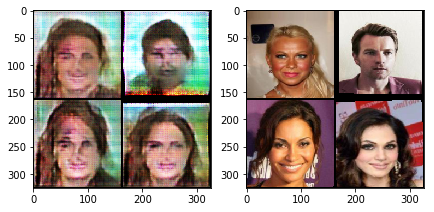

[0/3][1750/5332]	Disc/Dec Trains: 552.0/1664.0	Loss_D: 1.3566	Loss_Dec: 3.3547	Aux F1: 0.8128	Loss_Enc: 936.5537	D(x): 0.4170	D(G(z)): 0.4303
[0/3][2000/5332]	Disc/Dec Trains: 609.0/1907.0	Loss_D: 1.3589	Loss_Dec: 3.3396	Aux F1: 0.8142	Loss_Enc: 921.0905	D(x): 0.5950	D(G(z)): 0.2120
[0/3][2250/5332]	Disc/Dec Trains: 667.0/2150.0	Loss_D: 1.3579	Loss_Dec: 3.3248	Aux F1: 0.8154	Loss_Enc: 915.5844	D(x): 0.3982	D(G(z)): 0.4185
[0/3][2500/5332]	Disc/Dec Trains: 723.0/2395.0	Loss_D: 1.3522	Loss_Dec: 3.3259	Aux F1: 0.8165	Loss_Enc: 908.0020	D(x): 0.4922	D(G(z)): 0.3625
[0/3][2750/5332]	Disc/Dec Trains: 773.0/2641.0	Loss_D: 1.3543	Loss_Dec: 3.3259	Aux F1: 0.8173	Loss_Enc: 895.2128	D(x): 0.5061	D(G(z)): 0.3361
[0/3][3000/5332]	Disc/Dec Trains: 825.0/2890.0	Loss_D: 1.3517	Loss_Dec: 3.3221	Aux F1: 0.8181	Loss_Enc: 892.3237	D(x): 0.4824	D(G(z)): 0.2898


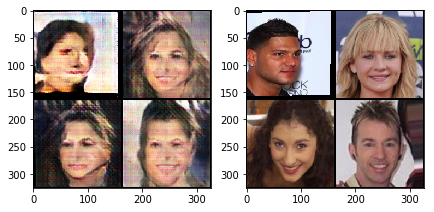

[0/3][3250/5332]	Disc/Dec Trains: 874.0/3136.0	Loss_D: 1.3499	Loss_Dec: 3.3183	Aux F1: 0.8191	Loss_Enc: 888.9676	D(x): 0.5102	D(G(z)): 0.3296
[0/3][3500/5332]	Disc/Dec Trains: 901.0/3384.0	Loss_D: 1.3543	Loss_Dec: 3.3137	Aux F1: 0.8199	Loss_Enc: 876.5599	D(x): 0.6396	D(G(z)): 0.2164
[0/3][3750/5332]	Disc/Dec Trains: 934.0/3631.0	Loss_D: 1.3565	Loss_Dec: 3.3123	Aux F1: 0.8205	Loss_Enc: 867.0645	D(x): 0.4612	D(G(z)): 0.2890
[0/3][4000/5332]	Disc/Dec Trains: 967.0/3877.0	Loss_D: 1.3620	Loss_Dec: 3.3085	Aux F1: 0.8210	Loss_Enc: 854.0225	D(x): 0.6145	D(G(z)): 0.3379
[0/3][4250/5332]	Disc/Dec Trains: 1004.0/4127.0	Loss_D: 1.3642	Loss_Dec: 3.3074	Aux F1: 0.8216	Loss_Enc: 843.1671	D(x): 0.6391	D(G(z)): 0.2240
[0/3][4500/5332]	Disc/Dec Trains: 1040.0/4374.0	Loss_D: 1.3674	Loss_Dec: 3.3069	Aux F1: 0.8220	Loss_Enc: 832.2433	D(x): 0.5754	D(G(z)): 0.3229


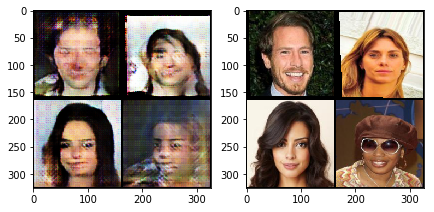

[0/3][4750/5332]	Disc/Dec Trains: 1078.0/4620.0	Loss_D: 1.3683	Loss_Dec: 3.3117	Aux F1: 0.8225	Loss_Enc: 822.3355	D(x): 0.5538	D(G(z)): 0.2439
[0/3][5000/5332]	Disc/Dec Trains: 1112.0/4866.0	Loss_D: 1.3683	Loss_Dec: 3.3172	Aux F1: 0.8229	Loss_Enc: 814.9837	D(x): 0.5966	D(G(z)): 0.3176
[0/3][5250/5332]	Disc/Dec Trains: 1144.0/5112.0	Loss_D: 1.3688	Loss_Dec: 3.3184	Aux F1: 0.8233	Loss_Enc: 809.8241	D(x): 0.4291	D(G(z)): 0.2267


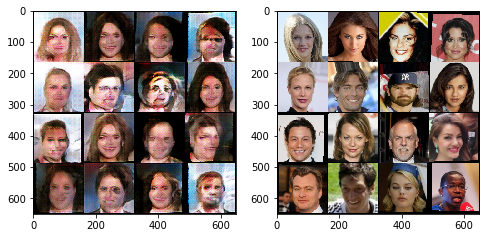

[1/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.6465	Loss_Dec: 2.8867	Aux F1: 0.8428	Loss_Enc: 578.3351	D(x): 0.4847	D(G(z)): 0.3750
[1/3][250/5332]	Disc/Dec Trains: 27.0/250.0	Loss_D: 1.4199	Loss_Dec: 3.2781	Aux F1: 0.8343	Loss_Enc: 645.4691	D(x): 0.4374	D(G(z)): 0.3583
[1/3][500/5332]	Disc/Dec Trains: 54.0/500.0	Loss_D: 1.4080	Loss_Dec: 3.2952	Aux F1: 0.8335	Loss_Enc: 651.7918	D(x): 0.4942	D(G(z)): 0.2561
[1/3][750/5332]	Disc/Dec Trains: 82.0/749.0	Loss_D: 1.4005	Loss_Dec: 3.2774	Aux F1: 0.8331	Loss_Enc: 650.8789	D(x): 0.6095	D(G(z)): 0.2791
[1/3][1000/5332]	Disc/Dec Trains: 103.0/998.0	Loss_D: 1.4166	Loss_Dec: 3.2522	Aux F1: 0.8327	Loss_Enc: 637.5920	D(x): 0.5054	D(G(z)): 0.3217


In [0]:
train(net, n_epochs=3, train_loader=train_loader, margin=0.45, plot_images=1500)

[0/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3844	Loss_Dec: 3.2682	Aux F1: 0.8461	Loss_Enc: 662.0459	D(x): 0.5082	D(G(z)): 0.3036
[0/5][250/5332]	Disc/Dec Trains: 38.0/251.0	Loss_D: 1.2716	Loss_Dec: 3.6011	Aux F1: 0.8311	Loss_Enc: 678.4701	D(x): 0.5474	D(G(z)): 0.3324
[0/5][500/5332]	Disc/Dec Trains: 72.0/500.0	Loss_D: 1.2938	Loss_Dec: 3.5953	Aux F1: 0.8326	Loss_Enc: 693.9359	D(x): 0.5554	D(G(z)): 0.3011
[0/5][750/5332]	Disc/Dec Trains: 103.0/749.0	Loss_D: 1.3003	Loss_Dec: 3.5672	Aux F1: 0.8327	Loss_Enc: 700.7323	D(x): 0.5498	D(G(z)): 0.2926
[0/5][1000/5332]	Disc/Dec Trains: 134.0/999.0	Loss_D: 1.2961	Loss_Dec: 3.5727	Aux F1: 0.8328	Loss_Enc: 696.2399	D(x): 0.5314	D(G(z)): 0.3373
[0/5][1250/5332]	Disc/Dec Trains: 164.0/1248.0	Loss_D: 1.3039	Loss_Dec: 3.5658	Aux F1: 0.8331	Loss_Enc: 706.3907	D(x): 0.3995	D(G(z)): 0.4029
[0/5][1500/5332]	Disc/Dec Trains: 197.0/1498.0	Loss_D: 1.3007	Loss_Dec: 3.5794	Aux F1: 0.8336	Loss_Enc: 706.8771	D(x): 0.5749	D(G(z)): 0.2643
[0/5][1750/5332]	Disc/D

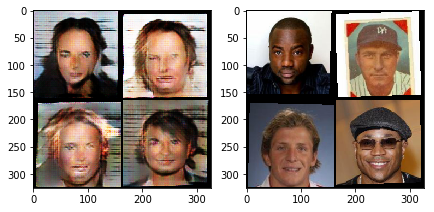

[0/5][2250/5332]	Disc/Dec Trains: 283.0/2245.0	Loss_D: 1.3062	Loss_Dec: 3.5780	Aux F1: 0.8341	Loss_Enc: 715.1017	D(x): 0.5013	D(G(z)): 0.2685
[0/5][2500/5332]	Disc/Dec Trains: 312.0/2495.0	Loss_D: 1.3073	Loss_Dec: 3.5801	Aux F1: 0.8341	Loss_Enc: 712.6630	D(x): 0.4622	D(G(z)): 0.3410
[0/5][2750/5332]	Disc/Dec Trains: 341.0/2742.0	Loss_D: 1.3072	Loss_Dec: 3.5787	Aux F1: 0.8340	Loss_Enc: 712.5585	D(x): 0.5376	D(G(z)): 0.2952
[0/5][3000/5332]	Disc/Dec Trains: 371.0/2992.0	Loss_D: 1.3050	Loss_Dec: 3.5805	Aux F1: 0.8340	Loss_Enc: 712.8796	D(x): 0.4770	D(G(z)): 0.3815
[0/5][3250/5332]	Disc/Dec Trains: 399.0/3242.0	Loss_D: 1.3045	Loss_Dec: 3.5799	Aux F1: 0.8341	Loss_Enc: 710.3415	D(x): 0.5291	D(G(z)): 0.2695
[0/5][3500/5332]	Disc/Dec Trains: 427.0/3491.0	Loss_D: 1.3049	Loss_Dec: 3.5844	Aux F1: 0.8342	Loss_Enc: 710.1332	D(x): 0.4715	D(G(z)): 0.3104
[0/5][3750/5332]	Disc/Dec Trains: 457.0/3741.0	Loss_D: 1.3050	Loss_Dec: 3.5891	Aux F1: 0.8342	Loss_Enc: 708.4969	D(x): 0.6086	D(G(z)): 0.2609
[0/5][

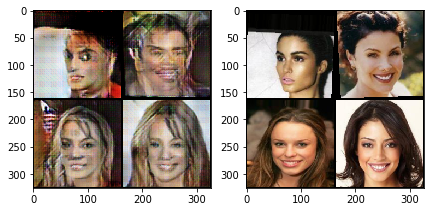

[0/5][4250/5332]	Disc/Dec Trains: 510.0/4240.0	Loss_D: 1.3050	Loss_Dec: 3.5881	Aux F1: 0.8342	Loss_Enc: 711.7075	D(x): 0.5768	D(G(z)): 0.3002


In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.475, plot_images=2000)

[0/4][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2550	Loss_Dec: 3.7175	Aux F1: 0.8368	Loss_Enc: 790.6610	D(x): 0.5516	D(G(z)): 0.2649
[0/4][250/5332]	Disc/Dec Trains: 3.0/251.0	Loss_D: 1.3879	Loss_Dec: 3.5203	Aux F1: 0.8404	Loss_Enc: 764.2631	D(x): 0.4840	D(G(z)): 0.3440
[0/4][500/5332]	Disc/Dec Trains: 9.0/501.0	Loss_D: 1.3676	Loss_Dec: 3.5551	Aux F1: 0.8397	Loss_Enc: 764.5524	D(x): 0.5743	D(G(z)): 0.3016
[0/4][750/5332]	Disc/Dec Trains: 15.0/751.0	Loss_D: 1.3636	Loss_Dec: 3.5575	Aux F1: 0.8396	Loss_Enc: 763.4101	D(x): 0.4769	D(G(z)): 0.2924
[0/4][1000/5332]	Disc/Dec Trains: 21.0/1001.0	Loss_D: 1.3505	Loss_Dec: 3.5593	Aux F1: 0.8395	Loss_Enc: 752.3232	D(x): 0.4745	D(G(z)): 0.2778
[0/4][1250/5332]	Disc/Dec Trains: 23.0/1251.0	Loss_D: 1.3742	Loss_Dec: 3.5415	Aux F1: 0.8393	Loss_Enc: 745.6158	D(x): 0.5127	D(G(z)): 0.3010
[0/4][1500/5332]	Disc/Dec Trains: 29.0/1501.0	Loss_D: 1.3825	Loss_Dec: 3.5260	Aux F1: 0.8394	Loss_Enc: 737.9570	D(x): 0.5066	D(G(z)): 0.2396


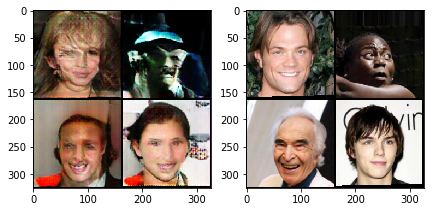

[0/4][1750/5332]	Disc/Dec Trains: 33.0/1751.0	Loss_D: 1.3825	Loss_Dec: 3.5158	Aux F1: 0.8396	Loss_Enc: 737.1802	D(x): 0.4658	D(G(z)): 0.2728
[0/4][2000/5332]	Disc/Dec Trains: 36.0/2001.0	Loss_D: 1.3830	Loss_Dec: 3.5180	Aux F1: 0.8396	Loss_Enc: 738.9437	D(x): 0.4930	D(G(z)): 0.2630
[0/4][2250/5332]	Disc/Dec Trains: 40.0/2251.0	Loss_D: 1.3785	Loss_Dec: 3.5186	Aux F1: 0.8396	Loss_Enc: 741.9337	D(x): 0.5450	D(G(z)): 0.2914
[0/4][2500/5332]	Disc/Dec Trains: 47.0/2501.0	Loss_D: 1.3750	Loss_Dec: 3.5178	Aux F1: 0.8397	Loss_Enc: 747.1206	D(x): 0.6007	D(G(z)): 0.2372
[0/4][2750/5332]	Disc/Dec Trains: 51.0/2751.0	Loss_D: 1.3705	Loss_Dec: 3.5209	Aux F1: 0.8397	Loss_Enc: 746.6206	D(x): 0.5358	D(G(z)): 0.2608
[0/4][3000/5332]	Disc/Dec Trains: 57.0/3001.0	Loss_D: 1.3614	Loss_Dec: 3.5304	Aux F1: 0.8398	Loss_Enc: 746.1947	D(x): 0.5771	D(G(z)): 0.3053


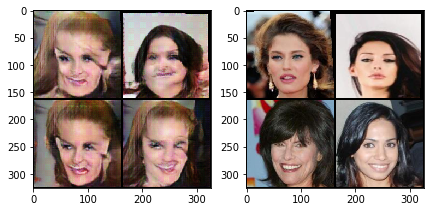

[0/4][3250/5332]	Disc/Dec Trains: 59.0/3251.0	Loss_D: 1.3662	Loss_Dec: 3.5277	Aux F1: 0.8398	Loss_Enc: 744.3655	D(x): 0.4818	D(G(z)): 0.3066
[0/4][3500/5332]	Disc/Dec Trains: 63.0/3501.0	Loss_D: 1.3697	Loss_Dec: 3.5285	Aux F1: 0.8399	Loss_Enc: 743.4658	D(x): 0.4666	D(G(z)): 0.2579
[0/4][3750/5332]	Disc/Dec Trains: 70.0/3751.0	Loss_D: 1.3746	Loss_Dec: 3.5263	Aux F1: 0.8400	Loss_Enc: 742.9698	D(x): 0.5090	D(G(z)): 0.3172
[0/4][4000/5332]	Disc/Dec Trains: 79.0/4001.0	Loss_D: 1.3717	Loss_Dec: 3.5262	Aux F1: 0.8401	Loss_Enc: 742.2660	D(x): 0.6436	D(G(z)): 0.2411
[0/4][4250/5332]	Disc/Dec Trains: 83.0/4251.0	Loss_D: 1.3663	Loss_Dec: 3.5275	Aux F1: 0.8402	Loss_Enc: 744.9731	D(x): 0.5266	D(G(z)): 0.2803
[0/4][4500/5332]	Disc/Dec Trains: 86.0/4501.0	Loss_D: 1.3686	Loss_Dec: 3.5259	Aux F1: 0.8403	Loss_Enc: 746.4067	D(x): 0.5059	D(G(z)): 0.2488


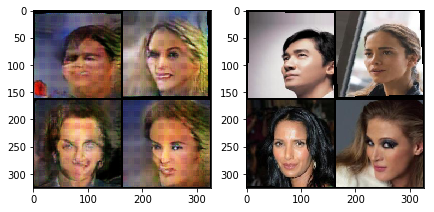

[0/4][4750/5332]	Disc/Dec Trains: 92.0/4751.0	Loss_D: 1.3664	Loss_Dec: 3.5274	Aux F1: 0.8403	Loss_Enc: 748.8151	D(x): 0.5213	D(G(z)): 0.2297
[0/4][5000/5332]	Disc/Dec Trains: 101.0/5001.0	Loss_D: 1.3591	Loss_Dec: 3.5316	Aux F1: 0.8404	Loss_Enc: 752.7649	D(x): 0.5718	D(G(z)): 0.1983
[0/4][5250/5332]	Disc/Dec Trains: 109.0/5251.0	Loss_D: 1.3520	Loss_Dec: 3.5370	Aux F1: 0.8403	Loss_Enc: 755.5418	D(x): 0.5120	D(G(z)): 0.2909


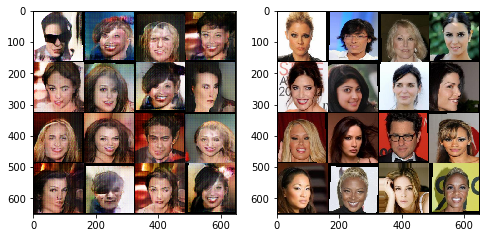

[1/4][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3206	Loss_Dec: 3.7051	Aux F1: 0.8441	Loss_Enc: 864.0026	D(x): 0.5083	D(G(z)): 0.2286
[1/4][250/5332]	Disc/Dec Trains: 7.0/251.0	Loss_D: 1.2722	Loss_Dec: 3.5894	Aux F1: 0.8416	Loss_Enc: 781.8979	D(x): 0.5102	D(G(z)): 0.2732
[1/4][500/5332]	Disc/Dec Trains: 14.0/501.0	Loss_D: 1.2418	Loss_Dec: 3.6546	Aux F1: 0.8413	Loss_Enc: 790.0009	D(x): 0.6117	D(G(z)): 0.1906
[1/4][750/5332]	Disc/Dec Trains: 20.0/751.0	Loss_D: 1.2415	Loss_Dec: 3.6678	Aux F1: 0.8411	Loss_Enc: 786.4510	D(x): 0.5742	D(G(z)): 0.2474
[1/4][1000/5332]	Disc/Dec Trains: 26.0/1001.0	Loss_D: 1.2631	Loss_Dec: 3.6465	Aux F1: 0.8413	Loss_Enc: 776.5308	D(x): 0.5690	D(G(z)): 0.2279
[1/4][1250/5332]	Disc/Dec Trains: 31.0/1251.0	Loss_D: 1.2600	Loss_Dec: 3.6618	Aux F1: 0.8411	Loss_Enc: 773.7511	D(x): 0.5421	D(G(z)): 0.2634
[1/4][1500/5332]	Disc/Dec Trains: 35.0/1501.0	Loss_D: 1.2705	Loss_Dec: 3.6628	Aux F1: 0.8412	Loss_Enc: 770.6862	D(x): 0.5422	D(G(z)): 0.2536


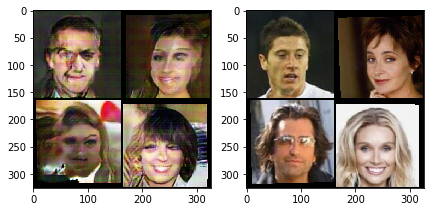

[1/4][1750/5332]	Disc/Dec Trains: 39.0/1751.0	Loss_D: 1.2808	Loss_Dec: 3.6540	Aux F1: 0.8413	Loss_Enc: 770.3940	D(x): 0.5112	D(G(z)): 0.2669
[1/4][2000/5332]	Disc/Dec Trains: 43.0/2001.0	Loss_D: 1.2914	Loss_Dec: 3.6482	Aux F1: 0.8411	Loss_Enc: 769.5356	D(x): 0.4888	D(G(z)): 0.2615
[1/4][2250/5332]	Disc/Dec Trains: 47.0/2251.0	Loss_D: 1.3149	Loss_Dec: 3.6312	Aux F1: 0.8410	Loss_Enc: 766.8953	D(x): 0.4879	D(G(z)): 0.2453
[1/4][2500/5332]	Disc/Dec Trains: 54.0/2501.0	Loss_D: 1.3176	Loss_Dec: 3.6230	Aux F1: 0.8409	Loss_Enc: 765.6086	D(x): 0.5293	D(G(z)): 0.3012
[1/4][2750/5332]	Disc/Dec Trains: 63.0/2751.0	Loss_D: 1.3176	Loss_Dec: 3.6192	Aux F1: 0.8410	Loss_Enc: 765.0796	D(x): 0.5494	D(G(z)): 0.2446
[1/4][3000/5332]	Disc/Dec Trains: 66.0/3001.0	Loss_D: 1.3194	Loss_Dec: 3.6154	Aux F1: 0.8411	Loss_Enc: 765.8591	D(x): 0.5069	D(G(z)): 0.2846


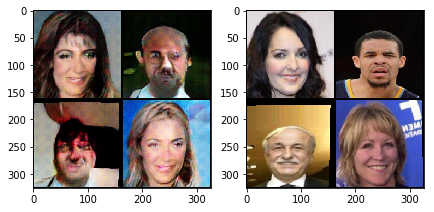

[1/4][3250/5332]	Disc/Dec Trains: 71.0/3251.0	Loss_D: 1.3262	Loss_Dec: 3.6076	Aux F1: 0.8411	Loss_Enc: 766.2690	D(x): 0.5616	D(G(z)): 0.2442
[1/4][3500/5332]	Disc/Dec Trains: 78.0/3501.0	Loss_D: 1.3251	Loss_Dec: 3.6020	Aux F1: 0.8410	Loss_Enc: 765.8837	D(x): 0.5206	D(G(z)): 0.2425
[1/4][3750/5332]	Disc/Dec Trains: 82.0/3751.0	Loss_D: 1.3272	Loss_Dec: 3.5981	Aux F1: 0.8411	Loss_Enc: 764.5355	D(x): 0.5335	D(G(z)): 0.2989
[1/4][4000/5332]	Disc/Dec Trains: 87.0/4001.0	Loss_D: 1.3320	Loss_Dec: 3.5893	Aux F1: 0.8411	Loss_Enc: 763.5222	D(x): 0.5309	D(G(z)): 0.2736
[1/4][4250/5332]	Disc/Dec Trains: 91.0/4251.0	Loss_D: 1.3372	Loss_Dec: 3.5805	Aux F1: 0.8412	Loss_Enc: 763.6913	D(x): 0.5291	D(G(z)): 0.2525
[1/4][4500/5332]	Disc/Dec Trains: 96.0/4501.0	Loss_D: 1.3379	Loss_Dec: 3.5768	Aux F1: 0.8412	Loss_Enc: 765.1444	D(x): 0.4973	D(G(z)): 0.2969


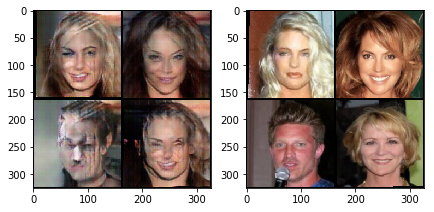

[1/4][4750/5332]	Disc/Dec Trains: 100.0/4751.0	Loss_D: 1.3416	Loss_Dec: 3.5697	Aux F1: 0.8413	Loss_Enc: 765.8665	D(x): 0.4939	D(G(z)): 0.2889
[1/4][5000/5332]	Disc/Dec Trains: 104.0/5001.0	Loss_D: 1.3438	Loss_Dec: 3.5685	Aux F1: 0.8414	Loss_Enc: 765.6666	D(x): 0.4951	D(G(z)): 0.2746
[1/4][5250/5332]	Disc/Dec Trains: 110.0/5251.0	Loss_D: 1.3420	Loss_Dec: 3.5675	Aux F1: 0.8416	Loss_Enc: 765.6942	D(x): 0.5581	D(G(z)): 0.2266


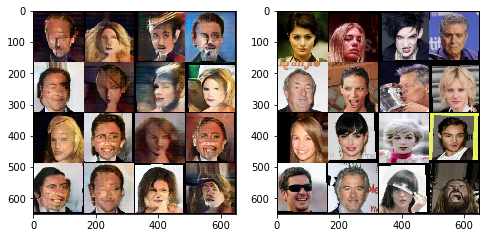

[2/4][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.1102	Loss_Dec: 3.8628	Aux F1: 0.8342	Loss_Enc: 843.2375	D(x): 0.5887	D(G(z)): 0.2218
[2/4][250/5332]	Disc/Dec Trains: 5.0/251.0	Loss_D: 1.3143	Loss_Dec: 3.5675	Aux F1: 0.8429	Loss_Enc: 765.6375	D(x): 0.5767	D(G(z)): 0.2234
[2/4][500/5332]	Disc/Dec Trains: 12.0/501.0	Loss_D: 1.3154	Loss_Dec: 3.5206	Aux F1: 0.8434	Loss_Enc: 773.5851	D(x): 0.5783	D(G(z)): 0.2367
[2/4][750/5332]	Disc/Dec Trains: 17.0/751.0	Loss_D: 1.2896	Loss_Dec: 3.5284	Aux F1: 0.8435	Loss_Enc: 780.6344	D(x): 0.5594	D(G(z)): 0.2859
[2/4][1000/5332]	Disc/Dec Trains: 20.0/1001.0	Loss_D: 1.3112	Loss_Dec: 3.5113	Aux F1: 0.8433	Loss_Enc: 779.0553	D(x): 0.4535	D(G(z)): 0.3243
[2/4][1250/5332]	Disc/Dec Trains: 26.0/1251.0	Loss_D: 1.3242	Loss_Dec: 3.5085	Aux F1: 0.8431	Loss_Enc: 770.5298	D(x): 0.5135	D(G(z)): 0.3010
[2/4][1500/5332]	Disc/Dec Trains: 31.0/1500.0	Loss_D: 1.3543	Loss_Dec: 3.4875	Aux F1: 0.8430	Loss_Enc: 762.0449	D(x): 0.4985	D(G(z)): 0.2858


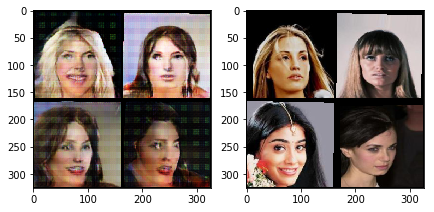

[2/4][1750/5332]	Disc/Dec Trains: 38.0/1750.0	Loss_D: 1.3602	Loss_Dec: 3.4794	Aux F1: 0.8428	Loss_Enc: 756.7415	D(x): 0.5589	D(G(z)): 0.2526
[2/4][2000/5332]	Disc/Dec Trains: 43.0/2000.0	Loss_D: 1.3661	Loss_Dec: 3.4701	Aux F1: 0.8428	Loss_Enc: 754.9026	D(x): 0.4667	D(G(z)): 0.3137
[2/4][2250/5332]	Disc/Dec Trains: 53.0/2250.0	Loss_D: 1.3643	Loss_Dec: 3.4643	Aux F1: 0.8429	Loss_Enc: 756.0016	D(x): 0.5334	D(G(z)): 0.2548
[2/4][2500/5332]	Disc/Dec Trains: 58.0/2500.0	Loss_D: 1.3591	Loss_Dec: 3.4635	Aux F1: 0.8428	Loss_Enc: 757.2947	D(x): 0.5416	D(G(z)): 0.2698
[2/4][2750/5332]	Disc/Dec Trains: 63.0/2750.0	Loss_D: 1.3651	Loss_Dec: 3.4565	Aux F1: 0.8429	Loss_Enc: 756.3771	D(x): 0.5061	D(G(z)): 0.3398
[2/4][3000/5332]	Disc/Dec Trains: 70.0/3000.0	Loss_D: 1.3653	Loss_Dec: 3.4551	Aux F1: 0.8429	Loss_Enc: 755.5296	D(x): 0.5024	D(G(z)): 0.2486


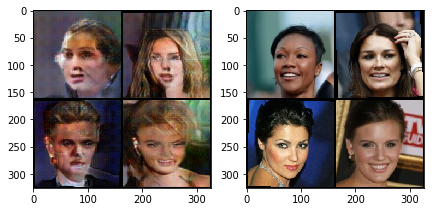

[2/4][3250/5332]	Disc/Dec Trains: 75.0/3250.0	Loss_D: 1.3594	Loss_Dec: 3.4604	Aux F1: 0.8429	Loss_Enc: 755.5151	D(x): 0.5609	D(G(z)): 0.3094
[2/4][3500/5332]	Disc/Dec Trains: 79.0/3500.0	Loss_D: 1.3586	Loss_Dec: 3.4646	Aux F1: 0.8429	Loss_Enc: 755.4294	D(x): 0.4705	D(G(z)): 0.2804
[2/4][3750/5332]	Disc/Dec Trains: 82.0/3750.0	Loss_D: 1.3576	Loss_Dec: 3.4696	Aux F1: 0.8428	Loss_Enc: 755.5972	D(x): 0.5342	D(G(z)): 0.2568
[2/4][4000/5332]	Disc/Dec Trains: 87.0/4000.0	Loss_D: 1.3554	Loss_Dec: 3.4773	Aux F1: 0.8428	Loss_Enc: 756.9022	D(x): 0.5298	D(G(z)): 0.3026
[2/4][4250/5332]	Disc/Dec Trains: 91.0/4250.0	Loss_D: 1.3538	Loss_Dec: 3.4846	Aux F1: 0.8428	Loss_Enc: 758.5981	D(x): 0.5440	D(G(z)): 0.2639
[2/4][4500/5332]	Disc/Dec Trains: 93.0/4500.0	Loss_D: 1.3553	Loss_Dec: 3.4855	Aux F1: 0.8429	Loss_Enc: 760.7430	D(x): 0.4741	D(G(z)): 0.2974


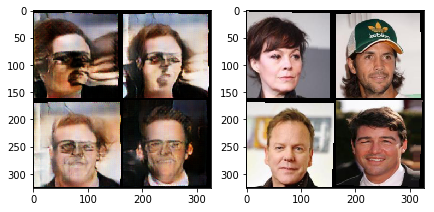

[2/4][4750/5332]	Disc/Dec Trains: 96.0/4750.0	Loss_D: 1.3590	Loss_Dec: 3.4837	Aux F1: 0.8429	Loss_Enc: 762.5453	D(x): 0.4863	D(G(z)): 0.3165
[2/4][5000/5332]	Disc/Dec Trains: 103.0/5000.0	Loss_D: 1.3568	Loss_Dec: 3.4894	Aux F1: 0.8428	Loss_Enc: 763.7745	D(x): 0.5725	D(G(z)): 0.2894
[2/4][5250/5332]	Disc/Dec Trains: 106.0/5250.0	Loss_D: 1.3583	Loss_Dec: 3.4886	Aux F1: 0.8428	Loss_Enc: 764.5242	D(x): 0.5250	D(G(z)): 0.3042


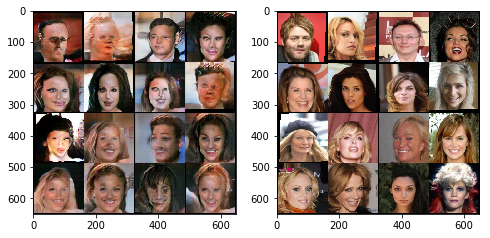

[3/4][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3795	Loss_Dec: 3.5383	Aux F1: 0.8243	Loss_Enc: 769.0568	D(x): 0.5208	D(G(z)): 0.3113
[3/4][250/5332]	Disc/Dec Trains: 5.0/251.0	Loss_D: 1.3842	Loss_Dec: 3.4968	Aux F1: 0.8436	Loss_Enc: 789.6932	D(x): 0.5135	D(G(z)): 0.2025
[3/4][500/5332]	Disc/Dec Trains: 10.0/501.0	Loss_D: 1.3619	Loss_Dec: 3.5141	Aux F1: 0.8430	Loss_Enc: 791.9735	D(x): 0.5286	D(G(z)): 0.2552
[3/4][750/5332]	Disc/Dec Trains: 14.0/751.0	Loss_D: 1.3416	Loss_Dec: 3.5347	Aux F1: 0.8431	Loss_Enc: 792.4515	D(x): 0.5432	D(G(z)): 0.2687
[3/4][1000/5332]	Disc/Dec Trains: 18.0/1001.0	Loss_D: 1.3483	Loss_Dec: 3.5281	Aux F1: 0.8432	Loss_Enc: 785.8959	D(x): 0.5119	D(G(z)): 0.3093
[3/4][1250/5332]	Disc/Dec Trains: 23.0/1251.0	Loss_D: 1.3637	Loss_Dec: 3.5106	Aux F1: 0.8433	Loss_Enc: 779.5820	D(x): 0.4484	D(G(z)): 0.3553
[3/4][1500/5332]	Disc/Dec Trains: 27.0/1501.0	Loss_D: 1.3693	Loss_Dec: 3.5010	Aux F1: 0.8434	Loss_Enc: 773.9428	D(x): 0.5060	D(G(z)): 0.2816


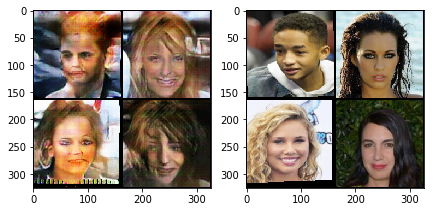

[3/4][1750/5332]	Disc/Dec Trains: 33.0/1751.0	Loss_D: 1.3630	Loss_Dec: 3.5053	Aux F1: 0.8434	Loss_Enc: 773.5716	D(x): 0.5246	D(G(z)): 0.2886
[3/4][2000/5332]	Disc/Dec Trains: 37.0/2001.0	Loss_D: 1.3624	Loss_Dec: 3.5095	Aux F1: 0.8434	Loss_Enc: 774.9843	D(x): 0.4970	D(G(z)): 0.3091
[3/4][2250/5332]	Disc/Dec Trains: 39.0/2251.0	Loss_D: 1.3690	Loss_Dec: 3.5011	Aux F1: 0.8434	Loss_Enc: 773.8307	D(x): 0.5107	D(G(z)): 0.3433
[3/4][2500/5332]	Disc/Dec Trains: 43.0/2501.0	Loss_D: 1.3685	Loss_Dec: 3.5011	Aux F1: 0.8435	Loss_Enc: 774.9769	D(x): 0.4642	D(G(z)): 0.3077
[3/4][2750/5332]	Disc/Dec Trains: 47.0/2751.0	Loss_D: 1.3688	Loss_Dec: 3.5054	Aux F1: 0.8435	Loss_Enc: 776.9770	D(x): 0.5232	D(G(z)): 0.2331
[3/4][3000/5332]	Disc/Dec Trains: 50.0/3001.0	Loss_D: 1.3722	Loss_Dec: 3.5084	Aux F1: 0.8436	Loss_Enc: 776.6652	D(x): 0.4802	D(G(z)): 0.3058


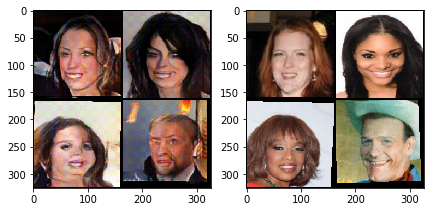

[3/4][3250/5332]	Disc/Dec Trains: 56.0/3251.0	Loss_D: 1.3706	Loss_Dec: 3.5065	Aux F1: 0.8437	Loss_Enc: 776.5122	D(x): 0.5331	D(G(z)): 0.2783
[3/4][3500/5332]	Disc/Dec Trains: 63.0/3501.0	Loss_D: 1.3639	Loss_Dec: 3.5132	Aux F1: 0.8436	Loss_Enc: 777.6878	D(x): 0.5186	D(G(z)): 0.2936
[3/4][3750/5332]	Disc/Dec Trains: 66.0/3751.0	Loss_D: 1.3642	Loss_Dec: 3.5149	Aux F1: 0.8436	Loss_Enc: 777.1946	D(x): 0.5253	D(G(z)): 0.2769
[3/4][4000/5332]	Disc/Dec Trains: 73.0/4001.0	Loss_D: 1.3628	Loss_Dec: 3.5143	Aux F1: 0.8436	Loss_Enc: 777.4084	D(x): 0.5310	D(G(z)): 0.2692
[3/4][4250/5332]	Disc/Dec Trains: 77.0/4251.0	Loss_D: 1.3603	Loss_Dec: 3.5149	Aux F1: 0.8436	Loss_Enc: 777.9643	D(x): 0.5426	D(G(z)): 0.3337
[3/4][4500/5332]	Disc/Dec Trains: 82.0/4501.0	Loss_D: 1.3567	Loss_Dec: 3.5183	Aux F1: 0.8435	Loss_Enc: 779.3627	D(x): 0.5015	D(G(z)): 0.2534


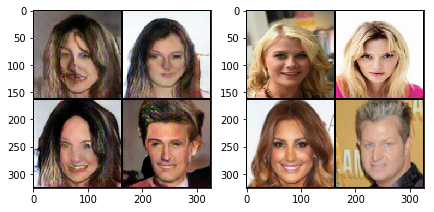

[3/4][4750/5332]	Disc/Dec Trains: 89.0/4751.0	Loss_D: 1.3536	Loss_Dec: 3.5213	Aux F1: 0.8435	Loss_Enc: 780.5432	D(x): 0.6170	D(G(z)): 0.2655
[3/4][5000/5332]	Disc/Dec Trains: 95.0/5001.0	Loss_D: 1.3502	Loss_Dec: 3.5254	Aux F1: 0.8434	Loss_Enc: 781.2689	D(x): 0.5321	D(G(z)): 0.1896
[3/4][5250/5332]	Disc/Dec Trains: 99.0/5251.0	Loss_D: 1.3470	Loss_Dec: 3.5299	Aux F1: 0.8434	Loss_Enc: 782.3025	D(x): 0.4747	D(G(z)): 0.2593


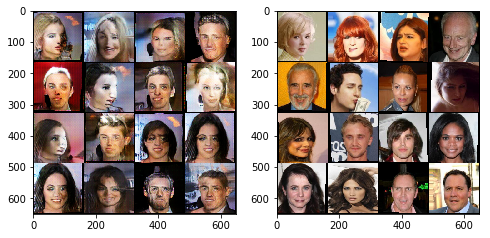

In [0]:
train(net, n_epochs=4, train_loader=train_loader, margin=0.47, plot_images=1500)

[0/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4579	Loss_Dec: 3.4760	Aux F1: 0.8355	Loss_Enc: 788.7296	D(x): 0.4881	D(G(z)): 0.2925
[0/5][250/5332]	Disc/Dec Trains: 4.0/251.0	Loss_D: 1.3841	Loss_Dec: 3.5370	Aux F1: 0.8436	Loss_Enc: 797.8692	D(x): 0.5886	D(G(z)): 0.2378
[0/5][500/5332]	Disc/Dec Trains: 7.0/501.0	Loss_D: 1.4065	Loss_Dec: 3.5112	Aux F1: 0.8436	Loss_Enc: 796.7541	D(x): 0.5128	D(G(z)): 0.2832
[0/5][750/5332]	Disc/Dec Trains: 10.0/751.0	Loss_D: 1.4334	Loss_Dec: 3.4740	Aux F1: 0.8437	Loss_Enc: 787.5983	D(x): 0.5230	D(G(z)): 0.2479
[0/5][1000/5332]	Disc/Dec Trains: 14.0/1001.0	Loss_D: 1.4158	Loss_Dec: 3.4807	Aux F1: 0.8436	Loss_Enc: 786.5771	D(x): 0.5267	D(G(z)): 0.3088
[0/5][1250/5332]	Disc/Dec Trains: 19.0/1251.0	Loss_D: 1.4023	Loss_Dec: 3.4860	Aux F1: 0.8437	Loss_Enc: 789.5703	D(x): 0.5464	D(G(z)): 0.2624
[0/5][1500/5332]	Disc/Dec Trains: 24.0/1501.0	Loss_D: 1.3862	Loss_Dec: 3.4946	Aux F1: 0.8438	Loss_Enc: 792.3230	D(x): 0.5126	D(G(z)): 0.2692
[0/5][1750/5332]	Disc/Dec Tr

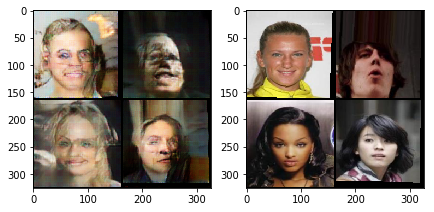

[0/5][2250/5332]	Disc/Dec Trains: 37.0/2251.0	Loss_D: 1.3614	Loss_Dec: 3.5142	Aux F1: 0.8437	Loss_Enc: 792.1802	D(x): 0.4992	D(G(z)): 0.2488
[0/5][2500/5332]	Disc/Dec Trains: 40.0/2501.0	Loss_D: 1.3659	Loss_Dec: 3.5095	Aux F1: 0.8435	Loss_Enc: 790.5412	D(x): 0.4710	D(G(z)): 0.2686
[0/5][2750/5332]	Disc/Dec Trains: 41.0/2751.0	Loss_D: 1.3729	Loss_Dec: 3.5008	Aux F1: 0.8436	Loss_Enc: 789.1093	D(x): 0.5343	D(G(z)): 0.3221
[0/5][3000/5332]	Disc/Dec Trains: 49.0/3001.0	Loss_D: 1.3682	Loss_Dec: 3.5052	Aux F1: 0.8437	Loss_Enc: 788.8356	D(x): 0.5711	D(G(z)): 0.2214
[0/5][3250/5332]	Disc/Dec Trains: 53.0/3251.0	Loss_D: 1.3655	Loss_Dec: 3.5073	Aux F1: 0.8437	Loss_Enc: 788.1127	D(x): 0.4405	D(G(z)): 0.2561
[0/5][3500/5332]	Disc/Dec Trains: 56.0/3501.0	Loss_D: 1.3650	Loss_Dec: 3.5068	Aux F1: 0.8437	Loss_Enc: 786.8461	D(x): 0.5096	D(G(z)): 0.2761
[0/5][3750/5332]	Disc/Dec Trains: 60.0/3751.0	Loss_D: 1.3648	Loss_Dec: 3.5033	Aux F1: 0.8437	Loss_Enc: 785.8266	D(x): 0.4913	D(G(z)): 0.2847
[0/5][4000/53

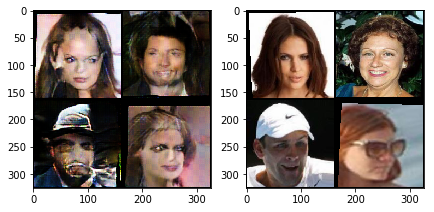

[0/5][4250/5332]	Disc/Dec Trains: 65.0/4251.0	Loss_D: 1.3753	Loss_Dec: 3.4937	Aux F1: 0.8438	Loss_Enc: 785.6210	D(x): 0.4672	D(G(z)): 0.2610
[0/5][4500/5332]	Disc/Dec Trains: 72.0/4501.0	Loss_D: 1.3730	Loss_Dec: 3.4927	Aux F1: 0.8439	Loss_Enc: 786.6425	D(x): 0.4988	D(G(z)): 0.2691
[0/5][4750/5332]	Disc/Dec Trains: 76.0/4751.0	Loss_D: 1.3707	Loss_Dec: 3.4921	Aux F1: 0.8439	Loss_Enc: 787.5460	D(x): 0.5427	D(G(z)): 0.3035
[0/5][5000/5332]	Disc/Dec Trains: 82.0/5001.0	Loss_D: 1.3689	Loss_Dec: 3.4913	Aux F1: 0.8440	Loss_Enc: 788.3051	D(x): 0.5358	D(G(z)): 0.2768
[0/5][5250/5332]	Disc/Dec Trains: 86.0/5251.0	Loss_D: 1.3655	Loss_Dec: 3.4943	Aux F1: 0.8441	Loss_Enc: 790.5209	D(x): 0.5382	D(G(z)): 0.2676


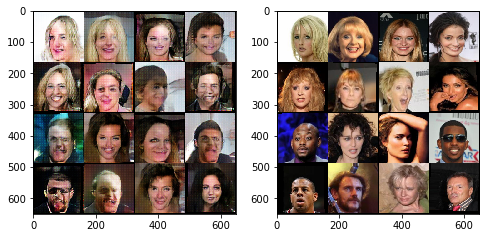

[1/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3148	Loss_Dec: 3.5712	Aux F1: 0.8461	Loss_Enc: 828.5565	D(x): 0.5374	D(G(z)): 0.2643
[1/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.3520	Loss_Dec: 3.5497	Aux F1: 0.8444	Loss_Enc: 830.9488	D(x): 0.5135	D(G(z)): 0.2649
[1/5][500/5332]	Disc/Dec Trains: 4.0/501.0	Loss_D: 1.3817	Loss_Dec: 3.5052	Aux F1: 0.8448	Loss_Enc: 827.1080	D(x): 0.5004	D(G(z)): 0.2296
[1/5][750/5332]	Disc/Dec Trains: 8.0/751.0	Loss_D: 1.3801	Loss_Dec: 3.5093	Aux F1: 0.8447	Loss_Enc: 821.2766	D(x): 0.5105	D(G(z)): 0.2932
[1/5][1000/5332]	Disc/Dec Trains: 10.0/1001.0	Loss_D: 1.3992	Loss_Dec: 3.4816	Aux F1: 0.8447	Loss_Enc: 812.9992	D(x): 0.4904	D(G(z)): 0.3422
[1/5][1250/5332]	Disc/Dec Trains: 17.0/1251.0	Loss_D: 1.3749	Loss_Dec: 3.4851	Aux F1: 0.8450	Loss_Enc: 812.9389	D(x): 0.5715	D(G(z)): 0.2456
[1/5][1500/5332]	Disc/Dec Trains: 23.0/1501.0	Loss_D: 1.3594	Loss_Dec: 3.4893	Aux F1: 0.8451	Loss_Enc: 815.8501	D(x): 0.5540	D(G(z)): 0.2304
[1/5][1750/5332]	Disc/Dec Tra

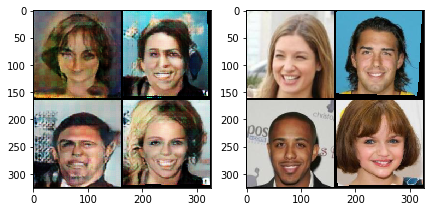

[1/5][2250/5332]	Disc/Dec Trains: 34.0/2251.0	Loss_D: 1.3456	Loss_Dec: 3.5122	Aux F1: 0.8451	Loss_Enc: 824.2572	D(x): 0.5842	D(G(z)): 0.2067
[1/5][2500/5332]	Disc/Dec Trains: 39.0/2501.0	Loss_D: 1.3333	Loss_Dec: 3.5284	Aux F1: 0.8452	Loss_Enc: 831.0035	D(x): 0.5626	D(G(z)): 0.2472
[1/5][2750/5332]	Disc/Dec Trains: 42.0/2751.0	Loss_D: 1.3297	Loss_Dec: 3.5353	Aux F1: 0.8453	Loss_Enc: 836.6573	D(x): 0.6018	D(G(z)): 0.2336
[1/5][3000/5332]	Disc/Dec Trains: 46.0/3001.0	Loss_D: 1.3301	Loss_Dec: 3.5447	Aux F1: 0.8453	Loss_Enc: 841.6296	D(x): 0.5091	D(G(z)): 0.3082
[1/5][3250/5332]	Disc/Dec Trains: 51.0/3251.0	Loss_D: 1.3389	Loss_Dec: 3.5448	Aux F1: 0.8453	Loss_Enc: 842.5332	D(x): 0.5492	D(G(z)): 0.2611
[1/5][3500/5332]	Disc/Dec Trains: 55.0/3501.0	Loss_D: 1.3356	Loss_Dec: 3.5423	Aux F1: 0.8452	Loss_Enc: 841.6099	D(x): 0.5696	D(G(z)): 0.2765
[1/5][3750/5332]	Disc/Dec Trains: 60.0/3751.0	Loss_D: 1.3412	Loss_Dec: 3.5302	Aux F1: 0.8451	Loss_Enc: 839.4733	D(x): 0.5240	D(G(z)): 0.3049
[1/5][4000/53

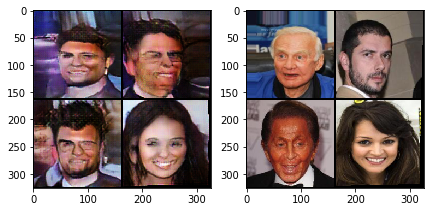

[1/5][4250/5332]	Disc/Dec Trains: 76.0/4251.0	Loss_D: 1.3324	Loss_Dec: 3.5265	Aux F1: 0.8451	Loss_Enc: 837.2091	D(x): 0.5600	D(G(z)): 0.2739


In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.465, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3945	Loss_Dec: 3.3931	Aux F1: 0.8599	Loss_Enc: 752.3199	D(x): 0.5303	D(G(z)): 0.2807
[0/5][250/5332]	Disc/Dec Trains: 6.0/251.0	Loss_D: 1.4334	Loss_Dec: 3.3389	Aux F1: 0.8454	Loss_Enc: 764.9784	D(x): 0.5366	D(G(z)): 0.2843
[0/5][500/5332]	Disc/Dec Trains: 11.0/501.0	Loss_D: 1.3902	Loss_Dec: 3.3872	Aux F1: 0.8453	Loss_Enc: 772.1014	D(x): 0.5490	D(G(z)): 0.2713
[0/5][750/5332]	Disc/Dec Trains: 13.0/751.0	Loss_D: 1.4019	Loss_Dec: 3.3927	Aux F1: 0.8455	Loss_Enc: 768.6979	D(x): 0.5380	D(G(z)): 0.3300
[0/5][1000/5332]	Disc/Dec Trains: 16.0/1001.0	Loss_D: 1.4160	Loss_Dec: 3.3962	Aux F1: 0.8456	Loss_Enc: 768.0574	D(x): 0.5125	D(G(z)): 0.2766
[0/5][1250/5332]	Disc/Dec Trains: 19.0/1251.0	Loss_D: 1.4253	Loss_Dec: 3.3992	Aux F1: 0.8457	Loss_Enc: 766.9991	D(x): 0.4725	D(G(z)): 0.3145
[0/5][1500/5332]	Disc/Dec Trains: 22.0/1501.0	Loss_D: 1.4332	Loss_Dec: 3.3981	Aux F1: 0.8458	Loss_Enc: 765.9799	D(x): 0.4994	D(G(z)): 0.2408
[0/5][1750/5332]	Disc/Dec T

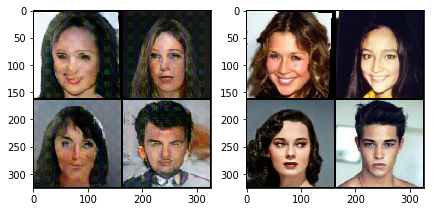

[0/5][2250/5332]	Disc/Dec Trains: 31.0/2251.0	Loss_D: 1.4389	Loss_Dec: 3.3984	Aux F1: 0.8457	Loss_Enc: 757.0143	D(x): 0.5035	D(G(z)): 0.2751
[0/5][2500/5332]	Disc/Dec Trains: 35.0/2501.0	Loss_D: 1.4363	Loss_Dec: 3.3963	Aux F1: 0.8457	Loss_Enc: 754.6101	D(x): 0.5010	D(G(z)): 0.2939
[0/5][2750/5332]	Disc/Dec Trains: 39.0/2751.0	Loss_D: 1.4357	Loss_Dec: 3.3945	Aux F1: 0.8456	Loss_Enc: 753.3480	D(x): 0.5189	D(G(z)): 0.2541
[0/5][3000/5332]	Disc/Dec Trains: 42.0/3001.0	Loss_D: 1.4309	Loss_Dec: 3.3962	Aux F1: 0.8457	Loss_Enc: 753.6687	D(x): 0.4907	D(G(z)): 0.2878
[0/5][3250/5332]	Disc/Dec Trains: 45.0/3251.0	Loss_D: 1.4318	Loss_Dec: 3.3914	Aux F1: 0.8457	Loss_Enc: 754.7694	D(x): 0.5089	D(G(z)): 0.3062
[0/5][3500/5332]	Disc/Dec Trains: 48.0/3501.0	Loss_D: 1.4325	Loss_Dec: 3.3879	Aux F1: 0.8457	Loss_Enc: 756.5722	D(x): 0.4672	D(G(z)): 0.2867
[0/5][3750/5332]	Disc/Dec Trains: 51.0/3751.0	Loss_D: 1.4322	Loss_Dec: 3.3878	Aux F1: 0.8458	Loss_Enc: 757.7322	D(x): 0.5375	D(G(z)): 0.3087
[0/5][4000/53

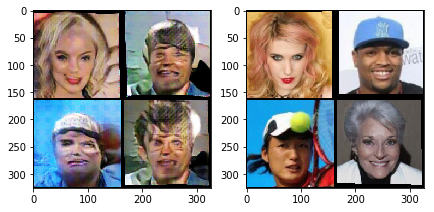

[0/5][4250/5332]	Disc/Dec Trains: 55.0/4251.0	Loss_D: 1.4312	Loss_Dec: 3.3850	Aux F1: 0.8458	Loss_Enc: 759.1483	D(x): 0.5151	D(G(z)): 0.3028
[0/5][4500/5332]	Disc/Dec Trains: 58.0/4501.0	Loss_D: 1.4301	Loss_Dec: 3.3864	Aux F1: 0.8457	Loss_Enc: 760.7637	D(x): 0.4268	D(G(z)): 0.2809
[0/5][4750/5332]	Disc/Dec Trains: 61.0/4751.0	Loss_D: 1.4310	Loss_Dec: 3.3849	Aux F1: 0.8457	Loss_Enc: 761.8730	D(x): 0.5229	D(G(z)): 0.3139
[0/5][5000/5332]	Disc/Dec Trains: 63.0/5001.0	Loss_D: 1.4315	Loss_Dec: 3.3858	Aux F1: 0.8458	Loss_Enc: 762.5157	D(x): 0.4953	D(G(z)): 0.2715
[0/5][5250/5332]	Disc/Dec Trains: 65.0/5251.0	Loss_D: 1.4317	Loss_Dec: 3.3853	Aux F1: 0.8458	Loss_Enc: 763.0743	D(x): 0.5618	D(G(z)): 0.2332


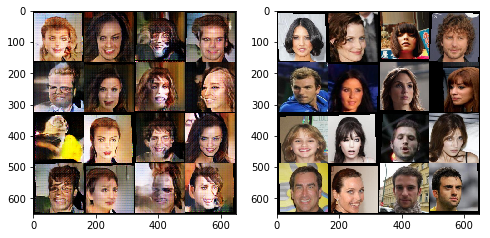

[1/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3498	Loss_Dec: 3.4022	Aux F1: 0.8566	Loss_Enc: 748.2141	D(x): 0.5373	D(G(z)): 0.2923
[1/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.4279	Loss_Dec: 3.3862	Aux F1: 0.8461	Loss_Enc: 779.3915	D(x): 0.4646	D(G(z)): 0.3560
[1/5][500/5332]	Disc/Dec Trains: 5.0/501.0	Loss_D: 1.4139	Loss_Dec: 3.4058	Aux F1: 0.8461	Loss_Enc: 782.2771	D(x): 0.5040	D(G(z)): 0.3106
[1/5][750/5332]	Disc/Dec Trains: 10.0/751.0	Loss_D: 1.3882	Loss_Dec: 3.4406	Aux F1: 0.8462	Loss_Enc: 798.2438	D(x): 0.5464	D(G(z)): 0.2521
[1/5][1000/5332]	Disc/Dec Trains: 11.0/1001.0	Loss_D: 1.3966	Loss_Dec: 3.4335	Aux F1: 0.8463	Loss_Enc: 811.3247	D(x): 0.4738	D(G(z)): 0.3027
[1/5][1250/5332]	Disc/Dec Trains: 16.0/1251.0	Loss_D: 1.3994	Loss_Dec: 3.4340	Aux F1: 0.8465	Loss_Enc: 816.0794	D(x): 0.5711	D(G(z)): 0.2581
[1/5][1500/5332]	Disc/Dec Trains: 19.0/1501.0	Loss_D: 1.4011	Loss_Dec: 3.4353	Aux F1: 0.8466	Loss_Enc: 818.4983	D(x): 0.5136	D(G(z)): 0.2588
[1/5][1750/5332]	Disc/Dec Tr

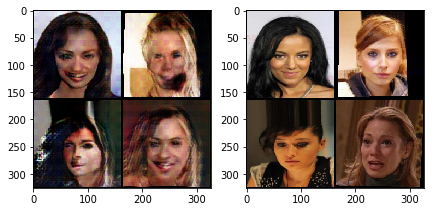

[1/5][2250/5332]	Disc/Dec Trains: 33.0/2251.0	Loss_D: 1.3934	Loss_Dec: 3.4379	Aux F1: 0.8470	Loss_Enc: 816.5389	D(x): 0.5047	D(G(z)): 0.2409
[1/5][2500/5332]	Disc/Dec Trains: 37.0/2501.0	Loss_D: 1.3864	Loss_Dec: 3.4419	Aux F1: 0.8470	Loss_Enc: 815.7443	D(x): 0.5044	D(G(z)): 0.2692
[1/5][2750/5332]	Disc/Dec Trains: 41.0/2751.0	Loss_D: 1.3819	Loss_Dec: 3.4488	Aux F1: 0.8471	Loss_Enc: 813.3149	D(x): 0.5444	D(G(z)): 0.2689
[1/5][3000/5332]	Disc/Dec Trains: 43.0/3001.0	Loss_D: 1.3767	Loss_Dec: 3.4555	Aux F1: 0.8471	Loss_Enc: 811.1948	D(x): 0.5583	D(G(z)): 0.2670
[1/5][3250/5332]	Disc/Dec Trains: 45.0/3251.0	Loss_D: 1.3793	Loss_Dec: 3.4531	Aux F1: 0.8471	Loss_Enc: 808.4829	D(x): 0.5033	D(G(z)): 0.2855
[1/5][3500/5332]	Disc/Dec Trains: 49.0/3501.0	Loss_D: 1.3794	Loss_Dec: 3.4518	Aux F1: 0.8471	Loss_Enc: 806.9752	D(x): 0.5435	D(G(z)): 0.3067
[1/5][3750/5332]	Disc/Dec Trains: 54.0/3751.0	Loss_D: 1.3749	Loss_Dec: 3.4532	Aux F1: 0.8472	Loss_Enc: 806.8374	D(x): 0.5256	D(G(z)): 0.2698
[1/5][4000/53

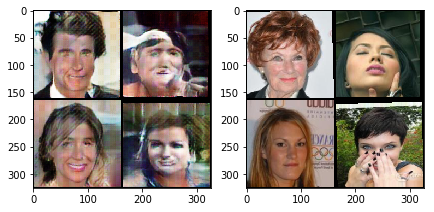

[1/5][4250/5332]	Disc/Dec Trains: 61.0/4251.0	Loss_D: 1.3737	Loss_Dec: 3.4530	Aux F1: 0.8472	Loss_Enc: 806.3870	D(x): 0.5370	D(G(z)): 0.2460
[1/5][4500/5332]	Disc/Dec Trains: 67.0/4501.0	Loss_D: 1.3671	Loss_Dec: 3.4549	Aux F1: 0.8472	Loss_Enc: 806.2714	D(x): 0.5654	D(G(z)): 0.2283
[1/5][4750/5332]	Disc/Dec Trains: 73.0/4751.0	Loss_D: 1.3641	Loss_Dec: 3.4550	Aux F1: 0.8473	Loss_Enc: 806.1428	D(x): 0.5851	D(G(z)): 0.2652
[1/5][5000/5332]	Disc/Dec Trains: 76.0/5001.0	Loss_D: 1.3628	Loss_Dec: 3.4538	Aux F1: 0.8472	Loss_Enc: 806.7439	D(x): 0.5350	D(G(z)): 0.2865
[1/5][5250/5332]	Disc/Dec Trains: 80.0/5251.0	Loss_D: 1.3612	Loss_Dec: 3.4533	Aux F1: 0.8472	Loss_Enc: 807.9152	D(x): 0.4989	D(G(z)): 0.3109


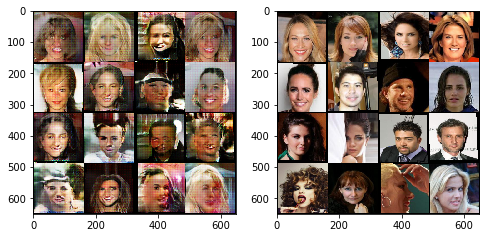

[2/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4640	Loss_Dec: 3.3868	Aux F1: 0.8349	Loss_Enc: 793.1274	D(x): 0.5314	D(G(z)): 0.3411
[2/5][250/5332]	Disc/Dec Trains: 4.0/251.0	Loss_D: 1.3257	Loss_Dec: 3.4784	Aux F1: 0.8479	Loss_Enc: 816.6039	D(x): 0.5407	D(G(z)): 0.2705
[2/5][500/5332]	Disc/Dec Trains: 9.0/501.0	Loss_D: 1.3039	Loss_Dec: 3.4904	Aux F1: 0.8478	Loss_Enc: 819.9961	D(x): 0.5218	D(G(z)): 0.2858
[2/5][750/5332]	Disc/Dec Trains: 14.0/751.0	Loss_D: 1.2920	Loss_Dec: 3.5018	Aux F1: 0.8475	Loss_Enc: 826.0740	D(x): 0.5405	D(G(z)): 0.3076
[2/5][1000/5332]	Disc/Dec Trains: 18.0/1001.0	Loss_D: 1.2942	Loss_Dec: 3.5011	Aux F1: 0.8473	Loss_Enc: 826.7018	D(x): 0.6179	D(G(z)): 0.2953
[2/5][1250/5332]	Disc/Dec Trains: 21.0/1251.0	Loss_D: 1.3109	Loss_Dec: 3.4889	Aux F1: 0.8473	Loss_Enc: 824.7446	D(x): 0.5232	D(G(z)): 0.2957
[2/5][1500/5332]	Disc/Dec Trains: 24.0/1501.0	Loss_D: 1.3253	Loss_Dec: 3.4793	Aux F1: 0.8472	Loss_Enc: 824.2452	D(x): 0.5297	D(G(z)): 0.3072
[2/5][1750/5332]	Disc/Dec Tr

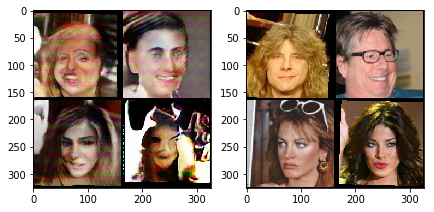

[2/5][2250/5332]	Disc/Dec Trains: 32.0/2251.0	Loss_D: 1.3384	Loss_Dec: 3.4768	Aux F1: 0.8472	Loss_Enc: 826.8391	D(x): 0.5430	D(G(z)): 0.2853
[2/5][2500/5332]	Disc/Dec Trains: 38.0/2501.0	Loss_D: 1.3385	Loss_Dec: 3.4748	Aux F1: 0.8472	Loss_Enc: 828.2943	D(x): 0.6132	D(G(z)): 0.2111
[2/5][2750/5332]	Disc/Dec Trains: 40.0/2751.0	Loss_D: 1.3371	Loss_Dec: 3.4774	Aux F1: 0.8473	Loss_Enc: 829.2391	D(x): 0.4883	D(G(z)): 0.3213
[2/5][3000/5332]	Disc/Dec Trains: 42.0/3001.0	Loss_D: 1.3447	Loss_Dec: 3.4700	Aux F1: 0.8475	Loss_Enc: 829.6395	D(x): 0.4587	D(G(z)): 0.3490
[2/5][3250/5332]	Disc/Dec Trains: 44.0/3251.0	Loss_D: 1.3489	Loss_Dec: 3.4663	Aux F1: 0.8476	Loss_Enc: 830.8327	D(x): 0.5287	D(G(z)): 0.2598
[2/5][3500/5332]	Disc/Dec Trains: 46.0/3501.0	Loss_D: 1.3532	Loss_Dec: 3.4626	Aux F1: 0.8477	Loss_Enc: 832.0587	D(x): 0.4824	D(G(z)): 0.3047
[2/5][3750/5332]	Disc/Dec Trains: 52.0/3751.0	Loss_D: 1.3517	Loss_Dec: 3.4642	Aux F1: 0.8477	Loss_Enc: 832.6971	D(x): 0.5115	D(G(z)): 0.2709
[2/5][4000/53

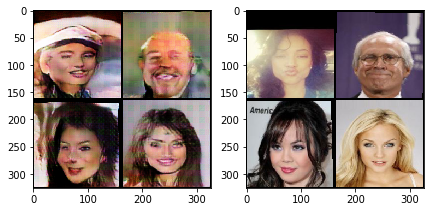

[2/5][4250/5332]	Disc/Dec Trains: 58.0/4251.0	Loss_D: 1.3516	Loss_Dec: 3.4692	Aux F1: 0.8478	Loss_Enc: 830.9295	D(x): 0.4967	D(G(z)): 0.3013
[2/5][4500/5332]	Disc/Dec Trains: 61.0/4501.0	Loss_D: 1.3526	Loss_Dec: 3.4713	Aux F1: 0.8478	Loss_Enc: 829.2679	D(x): 0.5088	D(G(z)): 0.3332
[2/5][4750/5332]	Disc/Dec Trains: 65.0/4751.0	Loss_D: 1.3591	Loss_Dec: 3.4685	Aux F1: 0.8478	Loss_Enc: 827.0932	D(x): 0.4457	D(G(z)): 0.3071
[2/5][5000/5332]	Disc/Dec Trains: 69.0/5001.0	Loss_D: 1.3600	Loss_Dec: 3.4699	Aux F1: 0.8478	Loss_Enc: 825.4782	D(x): 0.5213	D(G(z)): 0.2426
[2/5][5250/5332]	Disc/Dec Trains: 76.0/5251.0	Loss_D: 1.3619	Loss_Dec: 3.4680	Aux F1: 0.8478	Loss_Enc: 823.8249	D(x): 0.5273	D(G(z)): 0.2591


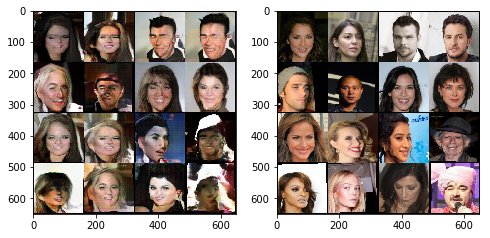

[3/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3567	Loss_Dec: 3.4542	Aux F1: 0.8487	Loss_Enc: 777.1711	D(x): 0.5343	D(G(z)): 0.2877
[3/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.3694	Loss_Dec: 3.4493	Aux F1: 0.8484	Loss_Enc: 777.2226	D(x): 0.5273	D(G(z)): 0.3096
[3/5][500/5332]	Disc/Dec Trains: 7.0/501.0	Loss_D: 1.3568	Loss_Dec: 3.4660	Aux F1: 0.8481	Loss_Enc: 786.8974	D(x): 0.5139	D(G(z)): 0.2345
[3/5][750/5332]	Disc/Dec Trains: 9.0/751.0	Loss_D: 1.3704	Loss_Dec: 3.4570	Aux F1: 0.8482	Loss_Enc: 790.2604	D(x): 0.5099	D(G(z)): 0.2477
[3/5][1000/5332]	Disc/Dec Trains: 11.0/1001.0	Loss_D: 1.3910	Loss_Dec: 3.4488	Aux F1: 0.8482	Loss_Enc: 791.3510	D(x): 0.5096	D(G(z)): 0.2921
[3/5][1250/5332]	Disc/Dec Trains: 14.0/1251.0	Loss_D: 1.3930	Loss_Dec: 3.4485	Aux F1: 0.8483	Loss_Enc: 793.2130	D(x): 0.5218	D(G(z)): 0.2536
[3/5][1500/5332]	Disc/Dec Trains: 17.0/1501.0	Loss_D: 1.3978	Loss_Dec: 3.4455	Aux F1: 0.8484	Loss_Enc: 792.5422	D(x): 0.4894	D(G(z)): 0.2531
[3/5][1750/5332]	Disc/Dec Tra

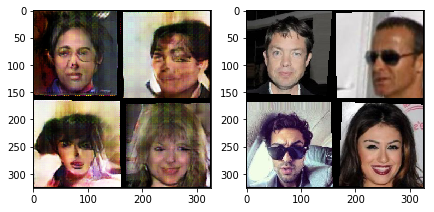

[3/5][2250/5332]	Disc/Dec Trains: 28.0/2251.0	Loss_D: 1.4008	Loss_Dec: 3.4397	Aux F1: 0.8485	Loss_Enc: 795.1329	D(x): 0.4406	D(G(z)): 0.3096
[3/5][2500/5332]	Disc/Dec Trains: 33.0/2501.0	Loss_D: 1.3981	Loss_Dec: 3.4364	Aux F1: 0.8484	Loss_Enc: 795.7434	D(x): 0.4732	D(G(z)): 0.2590
[3/5][2750/5332]	Disc/Dec Trains: 36.0/2751.0	Loss_D: 1.3915	Loss_Dec: 3.4371	Aux F1: 0.8485	Loss_Enc: 796.9816	D(x): 0.5623	D(G(z)): 0.3001
[3/5][3000/5332]	Disc/Dec Trains: 41.0/3001.0	Loss_D: 1.3887	Loss_Dec: 3.4360	Aux F1: 0.8485	Loss_Enc: 798.5169	D(x): 0.5382	D(G(z)): 0.2445
[3/5][3250/5332]	Disc/Dec Trains: 43.0/3251.0	Loss_D: 1.3835	Loss_Dec: 3.4390	Aux F1: 0.8484	Loss_Enc: 800.2648	D(x): 0.5167	D(G(z)): 0.3173
[3/5][3500/5332]	Disc/Dec Trains: 45.0/3501.0	Loss_D: 1.3849	Loss_Dec: 3.4388	Aux F1: 0.8484	Loss_Enc: 801.3755	D(x): 0.5330	D(G(z)): 0.2663
[3/5][3750/5332]	Disc/Dec Trains: 47.0/3751.0	Loss_D: 1.3900	Loss_Dec: 3.4357	Aux F1: 0.8484	Loss_Enc: 801.1122	D(x): 0.5421	D(G(z)): 0.2933
[3/5][4000/53

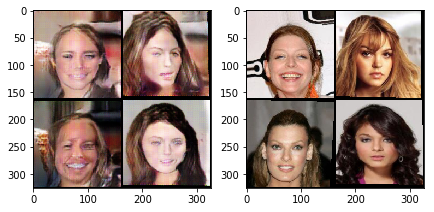

[3/5][4250/5332]	Disc/Dec Trains: 53.0/4251.0	Loss_D: 1.3929	Loss_Dec: 3.4361	Aux F1: 0.8483	Loss_Enc: 801.4238	D(x): 0.4459	D(G(z)): 0.2986
[3/5][4500/5332]	Disc/Dec Trains: 55.0/4501.0	Loss_D: 1.3935	Loss_Dec: 3.4379	Aux F1: 0.8484	Loss_Enc: 801.0578	D(x): 0.5080	D(G(z)): 0.3063
[3/5][4750/5332]	Disc/Dec Trains: 58.0/4751.0	Loss_D: 1.3963	Loss_Dec: 3.4344	Aux F1: 0.8484	Loss_Enc: 800.0998	D(x): 0.5307	D(G(z)): 0.2350
[3/5][5000/5332]	Disc/Dec Trains: 61.0/5001.0	Loss_D: 1.3931	Loss_Dec: 3.4360	Aux F1: 0.8485	Loss_Enc: 800.0839	D(x): 0.5443	D(G(z)): 0.2569
[3/5][5250/5332]	Disc/Dec Trains: 64.0/5251.0	Loss_D: 1.3920	Loss_Dec: 3.4357	Aux F1: 0.8484	Loss_Enc: 799.8364	D(x): 0.5018	D(G(z)): 0.2791


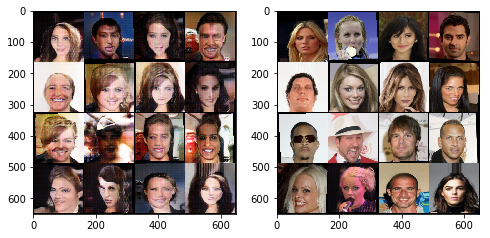

[4/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3979	Loss_Dec: 3.5112	Aux F1: 0.8559	Loss_Enc: 856.7212	D(x): 0.4977	D(G(z)): 0.2610
[4/5][250/5332]	Disc/Dec Trains: 3.0/251.0	Loss_D: 1.4433	Loss_Dec: 3.3608	Aux F1: 0.8485	Loss_Enc: 783.2483	D(x): 0.4387	D(G(z)): 0.3030
[4/5][500/5332]	Disc/Dec Trains: 6.0/501.0	Loss_D: 1.4285	Loss_Dec: 3.3999	Aux F1: 0.8488	Loss_Enc: 789.2916	D(x): 0.5477	D(G(z)): 0.3110
[4/5][750/5332]	Disc/Dec Trains: 9.0/751.0	Loss_D: 1.4241	Loss_Dec: 3.4297	Aux F1: 0.8490	Loss_Enc: 797.6354	D(x): 0.5052	D(G(z)): 0.2529
[4/5][1000/5332]	Disc/Dec Trains: 11.0/1001.0	Loss_D: 1.4626	Loss_Dec: 3.4214	Aux F1: 0.8492	Loss_Enc: 800.8223	D(x): 0.4804	D(G(z)): 0.2821
[4/5][1250/5332]	Disc/Dec Trains: 15.0/1251.0	Loss_D: 1.4337	Loss_Dec: 3.4573	Aux F1: 0.8493	Loss_Enc: 803.8608	D(x): 0.5128	D(G(z)): 0.2904
[4/5][1500/5332]	Disc/Dec Trains: 17.0/1501.0	Loss_D: 1.4125	Loss_Dec: 3.4819	Aux F1: 0.8493	Loss_Enc: 805.6987	D(x): 0.5781	D(G(z)): 0.2698
[4/5][1750/5332]	Disc/Dec Tra

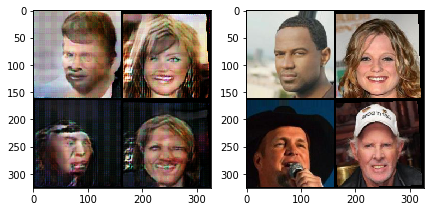

[4/5][2250/5332]	Disc/Dec Trains: 25.0/2251.0	Loss_D: 1.3917	Loss_Dec: 3.5015	Aux F1: 0.8493	Loss_Enc: 800.4309	D(x): 0.5315	D(G(z)): 0.2449
[4/5][2500/5332]	Disc/Dec Trains: 29.0/2501.0	Loss_D: 1.3911	Loss_Dec: 3.4984	Aux F1: 0.8494	Loss_Enc: 798.4839	D(x): 0.5327	D(G(z)): 0.2490
[4/5][2750/5332]	Disc/Dec Trains: 34.0/2751.0	Loss_D: 1.3794	Loss_Dec: 3.5045	Aux F1: 0.8494	Loss_Enc: 797.5094	D(x): 0.5621	D(G(z)): 0.2566
[4/5][3000/5332]	Disc/Dec Trains: 37.0/3001.0	Loss_D: 1.3726	Loss_Dec: 3.5079	Aux F1: 0.8495	Loss_Enc: 795.7784	D(x): 0.5037	D(G(z)): 0.2815
[4/5][3250/5332]	Disc/Dec Trains: 41.0/3251.0	Loss_D: 1.3732	Loss_Dec: 3.5044	Aux F1: 0.8496	Loss_Enc: 793.0809	D(x): 0.5413	D(G(z)): 0.2781
[4/5][3500/5332]	Disc/Dec Trains: 46.0/3501.0	Loss_D: 1.3748	Loss_Dec: 3.4991	Aux F1: 0.8496	Loss_Enc: 791.1808	D(x): 0.5332	D(G(z)): 0.2268
[4/5][3750/5332]	Disc/Dec Trains: 49.0/3751.0	Loss_D: 1.3712	Loss_Dec: 3.5026	Aux F1: 0.8496	Loss_Enc: 790.5937	D(x): 0.5054	D(G(z)): 0.2855
[4/5][4000/53

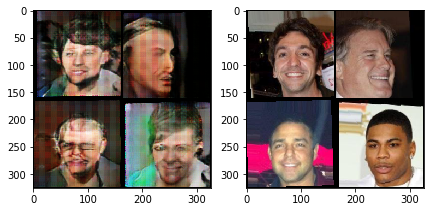

[4/5][4250/5332]	Disc/Dec Trains: 55.0/4251.0	Loss_D: 1.3717	Loss_Dec: 3.4992	Aux F1: 0.8496	Loss_Enc: 788.2786	D(x): 0.5344	D(G(z)): 0.2590
[4/5][4500/5332]	Disc/Dec Trains: 60.0/4501.0	Loss_D: 1.3684	Loss_Dec: 3.5035	Aux F1: 0.8496	Loss_Enc: 788.5542	D(x): 0.5035	D(G(z)): 0.2757
[4/5][4750/5332]	Disc/Dec Trains: 65.0/4751.0	Loss_D: 1.3628	Loss_Dec: 3.5092	Aux F1: 0.8497	Loss_Enc: 790.0855	D(x): 0.5795	D(G(z)): 0.2673
[4/5][5000/5332]	Disc/Dec Trains: 71.0/5001.0	Loss_D: 1.3585	Loss_Dec: 3.5171	Aux F1: 0.8496	Loss_Enc: 791.1901	D(x): 0.5034	D(G(z)): 0.2790
[4/5][5250/5332]	Disc/Dec Trains: 73.0/5251.0	Loss_D: 1.3575	Loss_Dec: 3.5212	Aux F1: 0.8496	Loss_Enc: 791.7607	D(x): 0.5875	D(G(z)): 0.2922


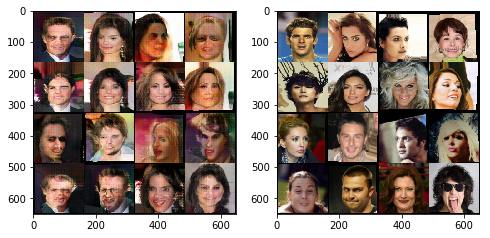

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.465, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4163	Loss_Dec: 3.5982	Aux F1: 0.8388	Loss_Enc: 841.3899	D(x): 0.4984	D(G(z)): 0.2622
[0/5][250/5332]	Disc/Dec Trains: 5.0/251.0	Loss_D: 1.3823	Loss_Dec: 3.5354	Aux F1: 0.8488	Loss_Enc: 808.4242	D(x): 0.5505	D(G(z)): 0.2765
[0/5][500/5332]	Disc/Dec Trains: 9.0/501.0	Loss_D: 1.3435	Loss_Dec: 3.5477	Aux F1: 0.8496	Loss_Enc: 815.6914	D(x): 0.4683	D(G(z)): 0.2510
[0/5][750/5332]	Disc/Dec Trains: 13.0/751.0	Loss_D: 1.3331	Loss_Dec: 3.5380	Aux F1: 0.8499	Loss_Enc: 819.7424	D(x): 0.5685	D(G(z)): 0.2752
[0/5][1000/5332]	Disc/Dec Trains: 16.0/1001.0	Loss_D: 1.3255	Loss_Dec: 3.5390	Aux F1: 0.8497	Loss_Enc: 821.7356	D(x): 0.5615	D(G(z)): 0.2807
[0/5][1250/5332]	Disc/Dec Trains: 20.0/1251.0	Loss_D: 1.3231	Loss_Dec: 3.5363	Aux F1: 0.8495	Loss_Enc: 820.6721	D(x): 0.5637	D(G(z)): 0.2712
[0/5][1500/5332]	Disc/Dec Trains: 26.0/1501.0	Loss_D: 1.3292	Loss_Dec: 3.5262	Aux F1: 0.8494	Loss_Enc: 818.0732	D(x): 0.5133	D(G(z)): 0.2852
[0/5][1750/5332]	Disc/Dec Tr

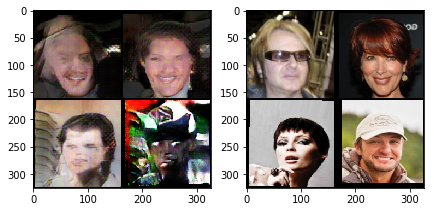

[0/5][2250/5332]	Disc/Dec Trains: 40.0/2251.0	Loss_D: 1.3276	Loss_Dec: 3.5213	Aux F1: 0.8490	Loss_Enc: 812.5785	D(x): 0.5467	D(G(z)): 0.2778
[0/5][2500/5332]	Disc/Dec Trains: 43.0/2501.0	Loss_D: 1.3281	Loss_Dec: 3.5185	Aux F1: 0.8489	Loss_Enc: 809.6210	D(x): 0.5679	D(G(z)): 0.3095
[0/5][2750/5332]	Disc/Dec Trains: 49.0/2751.0	Loss_D: 1.3299	Loss_Dec: 3.5162	Aux F1: 0.8488	Loss_Enc: 806.3071	D(x): 0.5117	D(G(z)): 0.2478
[0/5][3000/5332]	Disc/Dec Trains: 57.0/3001.0	Loss_D: 1.3235	Loss_Dec: 3.5210	Aux F1: 0.8489	Loss_Enc: 804.2473	D(x): 0.5701	D(G(z)): 0.2485
[0/5][3250/5332]	Disc/Dec Trains: 60.0/3251.0	Loss_D: 1.3193	Loss_Dec: 3.5253	Aux F1: 0.8488	Loss_Enc: 802.5456	D(x): 0.6269	D(G(z)): 0.2724
[0/5][3500/5332]	Disc/Dec Trains: 65.0/3501.0	Loss_D: 1.3197	Loss_Dec: 3.5228	Aux F1: 0.8487	Loss_Enc: 800.4302	D(x): 0.5160	D(G(z)): 0.2698
[0/5][3750/5332]	Disc/Dec Trains: 67.0/3751.0	Loss_D: 1.3243	Loss_Dec: 3.5176	Aux F1: 0.8488	Loss_Enc: 797.9435	D(x): 0.4982	D(G(z)): 0.3339
[0/5][4000/53

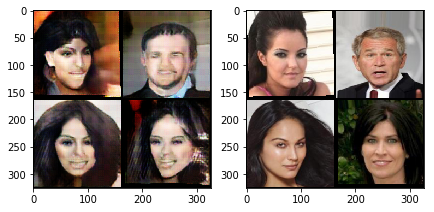

[0/5][4250/5332]	Disc/Dec Trains: 73.0/4250.0	Loss_D: 1.3423	Loss_Dec: 3.4979	Aux F1: 0.8489	Loss_Enc: 792.5063	D(x): 0.4862	D(G(z)): 0.3201
[0/5][4500/5332]	Disc/Dec Trains: 77.0/4500.0	Loss_D: 1.3430	Loss_Dec: 3.4925	Aux F1: 0.8489	Loss_Enc: 790.2711	D(x): 0.5020	D(G(z)): 0.3328
[0/5][4750/5332]	Disc/Dec Trains: 82.0/4750.0	Loss_D: 1.3429	Loss_Dec: 3.4886	Aux F1: 0.8488	Loss_Enc: 787.9858	D(x): 0.5149	D(G(z)): 0.2429
[0/5][5000/5332]	Disc/Dec Trains: 84.0/5000.0	Loss_D: 1.3443	Loss_Dec: 3.4846	Aux F1: 0.8488	Loss_Enc: 785.6092	D(x): 0.5558	D(G(z)): 0.2869
[0/5][5250/5332]	Disc/Dec Trains: 89.0/5250.0	Loss_D: 1.3448	Loss_Dec: 3.4813	Aux F1: 0.8488	Loss_Enc: 783.8276	D(x): 0.5324	D(G(z)): 0.2747


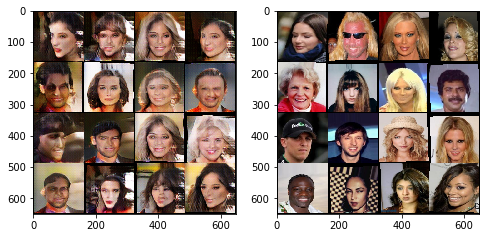

[1/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4653	Loss_Dec: 3.4617	Aux F1: 0.8651	Loss_Enc: 716.0634	D(x): 0.4851	D(G(z)): 0.2979
[1/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.4360	Loss_Dec: 3.3634	Aux F1: 0.8488	Loss_Enc: 742.0627	D(x): 0.5274	D(G(z)): 0.2779
[1/5][500/5332]	Disc/Dec Trains: 7.0/501.0	Loss_D: 1.4532	Loss_Dec: 3.3506	Aux F1: 0.8485	Loss_Enc: 739.6043	D(x): 0.4993	D(G(z)): 0.2971
[1/5][750/5332]	Disc/Dec Trains: 10.0/751.0	Loss_D: 1.4244	Loss_Dec: 3.3888	Aux F1: 0.8483	Loss_Enc: 739.6555	D(x): 0.5703	D(G(z)): 0.3193
[1/5][1000/5332]	Disc/Dec Trains: 12.0/1001.0	Loss_D: 1.4331	Loss_Dec: 3.3833	Aux F1: 0.8484	Loss_Enc: 740.7009	D(x): 0.4979	D(G(z)): 0.3370
[1/5][1250/5332]	Disc/Dec Trains: 17.0/1251.0	Loss_D: 1.4406	Loss_Dec: 3.3747	Aux F1: 0.8488	Loss_Enc: 739.6969	D(x): 0.5537	D(G(z)): 0.2641
[1/5][1500/5332]	Disc/Dec Trains: 18.0/1501.0	Loss_D: 1.4394	Loss_Dec: 3.3697	Aux F1: 0.8489	Loss_Enc: 737.6809	D(x): 0.4980	D(G(z)): 0.3289
[1/5][1750/5332]	Disc/Dec Tr

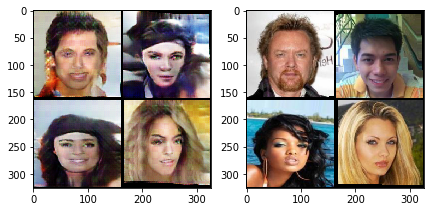

[1/5][2250/5332]	Disc/Dec Trains: 29.0/2251.0	Loss_D: 1.4254	Loss_Dec: 3.3729	Aux F1: 0.8488	Loss_Enc: 736.1913	D(x): 0.4775	D(G(z)): 0.2609
[1/5][2500/5332]	Disc/Dec Trains: 31.0/2501.0	Loss_D: 1.4219	Loss_Dec: 3.3757	Aux F1: 0.8489	Loss_Enc: 738.4184	D(x): 0.5010	D(G(z)): 0.3251
[1/5][2750/5332]	Disc/Dec Trains: 34.0/2751.0	Loss_D: 1.4215	Loss_Dec: 3.3761	Aux F1: 0.8490	Loss_Enc: 739.6214	D(x): 0.4961	D(G(z)): 0.3125
[1/5][3000/5332]	Disc/Dec Trains: 39.0/3001.0	Loss_D: 1.4193	Loss_Dec: 3.3784	Aux F1: 0.8489	Loss_Enc: 740.7324	D(x): 0.4887	D(G(z)): 0.2697
[1/5][3250/5332]	Disc/Dec Trains: 41.0/3251.0	Loss_D: 1.4158	Loss_Dec: 3.3837	Aux F1: 0.8489	Loss_Enc: 742.6271	D(x): 0.5456	D(G(z)): 0.2814
[1/5][3500/5332]	Disc/Dec Trains: 44.0/3501.0	Loss_D: 1.4120	Loss_Dec: 3.3903	Aux F1: 0.8489	Loss_Enc: 744.9966	D(x): 0.5205	D(G(z)): 0.3249
[1/5][3750/5332]	Disc/Dec Trains: 48.0/3751.0	Loss_D: 1.4066	Loss_Dec: 3.3964	Aux F1: 0.8489	Loss_Enc: 747.4395	D(x): 0.5785	D(G(z)): 0.2675
[1/5][4000/53

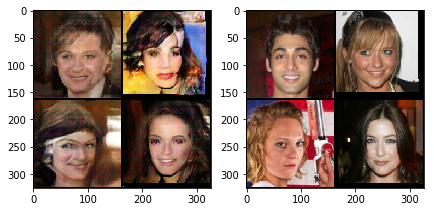

[1/5][4250/5332]	Disc/Dec Trains: 55.0/4251.0	Loss_D: 1.4058	Loss_Dec: 3.3961	Aux F1: 0.8489	Loss_Enc: 749.7664	D(x): 0.5424	D(G(z)): 0.3098
[1/5][4500/5332]	Disc/Dec Trains: 55.0/4501.0	Loss_D: 1.4082	Loss_Dec: 3.3964	Aux F1: 0.8490	Loss_Enc: 749.9625	D(x): 0.4917	D(G(z)): 0.3352
[1/5][4750/5332]	Disc/Dec Trains: 61.0/4751.0	Loss_D: 1.4098	Loss_Dec: 3.3942	Aux F1: 0.8489	Loss_Enc: 749.9155	D(x): 0.5331	D(G(z)): 0.2834
[1/5][5000/5332]	Disc/Dec Trains: 65.0/5001.0	Loss_D: 1.4065	Loss_Dec: 3.3961	Aux F1: 0.8489	Loss_Enc: 750.5315	D(x): 0.4790	D(G(z)): 0.2447
[1/5][5250/5332]	Disc/Dec Trains: 67.0/5251.0	Loss_D: 1.4050	Loss_Dec: 3.3988	Aux F1: 0.8490	Loss_Enc: 751.5478	D(x): 0.5193	D(G(z)): 0.3201


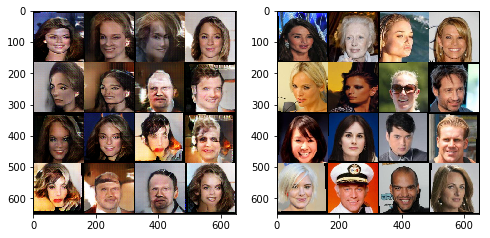

[2/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4144	Loss_Dec: 3.5119	Aux F1: 0.8493	Loss_Enc: 796.6334	D(x): 0.5148	D(G(z)): 0.2682
[2/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.4756	Loss_Dec: 3.3681	Aux F1: 0.8499	Loss_Enc: 763.9354	D(x): 0.5146	D(G(z)): 0.2809
[2/5][500/5332]	Disc/Dec Trains: 4.0/501.0	Loss_D: 1.4944	Loss_Dec: 3.3430	Aux F1: 0.8495	Loss_Enc: 757.8392	D(x): 0.4686	D(G(z)): 0.3246
[2/5][750/5332]	Disc/Dec Trains: 9.0/751.0	Loss_D: 1.4854	Loss_Dec: 3.3401	Aux F1: 0.8498	Loss_Enc: 759.1955	D(x): 0.5143	D(G(z)): 0.2546
[2/5][1000/5332]	Disc/Dec Trains: 13.0/1001.0	Loss_D: 1.4634	Loss_Dec: 3.3602	Aux F1: 0.8500	Loss_Enc: 763.5873	D(x): 0.5152	D(G(z)): 0.2500
[2/5][1250/5332]	Disc/Dec Trains: 16.0/1251.0	Loss_D: 1.4489	Loss_Dec: 3.3706	Aux F1: 0.8499	Loss_Enc: 767.6498	D(x): 0.4920	D(G(z)): 0.2470
[2/5][1500/5332]	Disc/Dec Trains: 21.0/1501.0	Loss_D: 1.4371	Loss_Dec: 3.3810	Aux F1: 0.8499	Loss_Enc: 770.2643	D(x): 0.4991	D(G(z)): 0.3061
[2/5][1750/5332]	Disc/Dec Tra

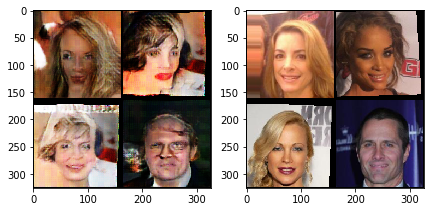

[2/5][2250/5332]	Disc/Dec Trains: 29.0/2251.0	Loss_D: 1.4204	Loss_Dec: 3.3967	Aux F1: 0.8499	Loss_Enc: 772.0993	D(x): 0.4727	D(G(z)): 0.3526
[2/5][2500/5332]	Disc/Dec Trains: 30.0/2501.0	Loss_D: 1.4183	Loss_Dec: 3.3980	Aux F1: 0.8500	Loss_Enc: 772.4074	D(x): 0.4604	D(G(z)): 0.3287
[2/5][2750/5332]	Disc/Dec Trains: 34.0/2751.0	Loss_D: 1.4216	Loss_Dec: 3.3947	Aux F1: 0.8500	Loss_Enc: 771.9575	D(x): 0.5130	D(G(z)): 0.2879
[2/5][3000/5332]	Disc/Dec Trains: 35.0/3001.0	Loss_D: 1.4216	Loss_Dec: 3.3949	Aux F1: 0.8500	Loss_Enc: 772.5220	D(x): 0.4723	D(G(z)): 0.2975
[2/5][3250/5332]	Disc/Dec Trains: 41.0/3251.0	Loss_D: 1.4226	Loss_Dec: 3.3930	Aux F1: 0.8500	Loss_Enc: 772.9289	D(x): 0.4895	D(G(z)): 0.2675
[2/5][3500/5332]	Disc/Dec Trains: 42.0/3501.0	Loss_D: 1.4208	Loss_Dec: 3.3944	Aux F1: 0.8500	Loss_Enc: 773.0578	D(x): 0.4929	D(G(z)): 0.3264
[2/5][3750/5332]	Disc/Dec Trains: 47.0/3751.0	Loss_D: 1.4226	Loss_Dec: 3.3925	Aux F1: 0.8501	Loss_Enc: 772.7773	D(x): 0.5419	D(G(z)): 0.2640
[2/5][4000/53

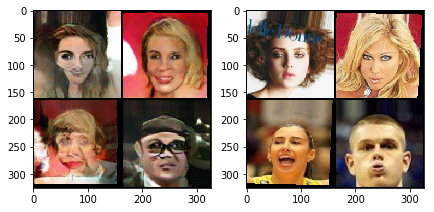

[2/5][4250/5332]	Disc/Dec Trains: 57.0/4251.0	Loss_D: 1.4183	Loss_Dec: 3.3951	Aux F1: 0.8502	Loss_Enc: 773.4003	D(x): 0.4886	D(G(z)): 0.2784
[2/5][4500/5332]	Disc/Dec Trains: 62.0/4501.0	Loss_D: 1.4143	Loss_Dec: 3.3968	Aux F1: 0.8502	Loss_Enc: 773.5741	D(x): 0.5204	D(G(z)): 0.2693
[2/5][4750/5332]	Disc/Dec Trains: 64.0/4751.0	Loss_D: 1.4116	Loss_Dec: 3.3984	Aux F1: 0.8503	Loss_Enc: 773.3157	D(x): 0.5111	D(G(z)): 0.2801
[2/5][5000/5332]	Disc/Dec Trains: 70.0/5001.0	Loss_D: 1.4114	Loss_Dec: 3.3964	Aux F1: 0.8502	Loss_Enc: 772.4992	D(x): 0.5890	D(G(z)): 0.2209
[2/5][5250/5332]	Disc/Dec Trains: 72.0/5251.0	Loss_D: 1.4091	Loss_Dec: 3.3962	Aux F1: 0.8502	Loss_Enc: 772.4393	D(x): 0.5477	D(G(z)): 0.2615


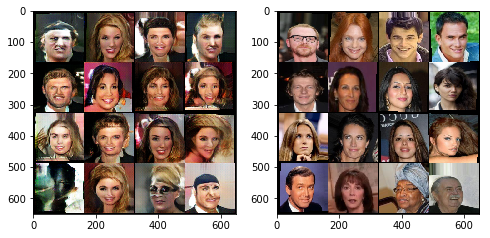

[3/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4171	Loss_Dec: 3.2333	Aux F1: 0.8441	Loss_Enc: 753.8350	D(x): 0.5220	D(G(z)): 0.3202
[3/5][250/5332]	Disc/Dec Trains: 1.0/251.0	Loss_D: 1.3939	Loss_Dec: 3.3841	Aux F1: 0.8511	Loss_Enc: 778.5200	D(x): 0.4710	D(G(z)): 0.3212
[3/5][500/5332]	Disc/Dec Trains: 3.0/501.0	Loss_D: 1.4160	Loss_Dec: 3.3597	Aux F1: 0.8506	Loss_Enc: 771.4939	D(x): 0.4009	D(G(z)): 0.3912
[3/5][750/5332]	Disc/Dec Trains: 4.0/751.0	Loss_D: 1.4355	Loss_Dec: 3.3552	Aux F1: 0.8508	Loss_Enc: 764.9070	D(x): 0.5175	D(G(z)): 0.3534
[3/5][1000/5332]	Disc/Dec Trains: 7.0/1001.0	Loss_D: 1.4428	Loss_Dec: 3.3556	Aux F1: 0.8505	Loss_Enc: 759.3550	D(x): 0.5033	D(G(z)): 0.3299
[3/5][1250/5332]	Disc/Dec Trains: 9.0/1251.0	Loss_D: 1.4518	Loss_Dec: 3.3486	Aux F1: 0.8509	Loss_Enc: 755.1075	D(x): 0.5161	D(G(z)): 0.3349
[3/5][1500/5332]	Disc/Dec Trains: 12.0/1501.0	Loss_D: 1.4519	Loss_Dec: 3.3477	Aux F1: 0.8510	Loss_Enc: 752.9618	D(x): 0.5089	D(G(z)): 0.2972
[3/5][1750/5332]	Disc/Dec Train

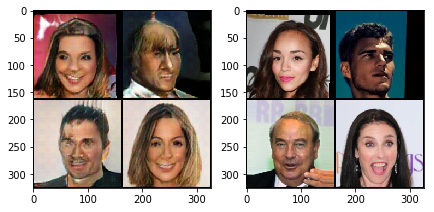

[3/5][2250/5332]	Disc/Dec Trains: 18.0/2251.0	Loss_D: 1.4573	Loss_Dec: 3.3391	Aux F1: 0.8511	Loss_Enc: 751.3420	D(x): 0.4712	D(G(z)): 0.4117
[3/5][2500/5332]	Disc/Dec Trains: 24.0/2501.0	Loss_D: 1.4577	Loss_Dec: 3.3352	Aux F1: 0.8512	Loss_Enc: 751.2693	D(x): 0.5483	D(G(z)): 0.2896
[3/5][2750/5332]	Disc/Dec Trains: 28.0/2751.0	Loss_D: 1.4537	Loss_Dec: 3.3382	Aux F1: 0.8513	Loss_Enc: 751.6750	D(x): 0.5227	D(G(z)): 0.2939
[3/5][3000/5332]	Disc/Dec Trains: 35.0/3001.0	Loss_D: 1.4442	Loss_Dec: 3.3450	Aux F1: 0.8513	Loss_Enc: 752.4614	D(x): 0.6015	D(G(z)): 0.2366


In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.4625, plot_images=2000)

[0/1][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2543	Loss_Dec: 3.6222	Aux F1: 0.8480	Loss_Enc: 830.7992	D(x): 0.5367	D(G(z)): 0.2197
[0/1][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.3212	Loss_Dec: 3.4683	Aux F1: 0.8503	Loss_Enc: 793.6597	D(x): 0.4889	D(G(z)): 0.2995
[0/1][500/5332]	Disc/Dec Trains: 5.0/501.0	Loss_D: 1.3432	Loss_Dec: 3.4500	Aux F1: 0.8513	Loss_Enc: 791.5931	D(x): 0.5789	D(G(z)): 0.2607
[0/1][750/5332]	Disc/Dec Trains: 7.0/751.0	Loss_D: 1.3454	Loss_Dec: 3.4458	Aux F1: 0.8512	Loss_Enc: 792.4986	D(x): 0.4921	D(G(z)): 0.2785
[0/1][1000/5332]	Disc/Dec Trains: 11.0/1001.0	Loss_D: 1.3498	Loss_Dec: 3.4456	Aux F1: 0.8512	Loss_Enc: 793.8436	D(x): 0.5251	D(G(z)): 0.2725
[0/1][1250/5332]	Disc/Dec Trains: 13.0/1251.0	Loss_D: 1.3468	Loss_Dec: 3.4545	Aux F1: 0.8514	Loss_Enc: 795.4262	D(x): 0.5354	D(G(z)): 0.2576
[0/1][1500/5332]	Disc/Dec Trains: 15.0/1501.0	Loss_D: 1.3536	Loss_Dec: 3.4556	Aux F1: 0.8512	Loss_Enc: 794.4345	D(x): 0.4926	D(G(z)): 0.3171
[0/1][1750/5332]	Disc/Dec Tra

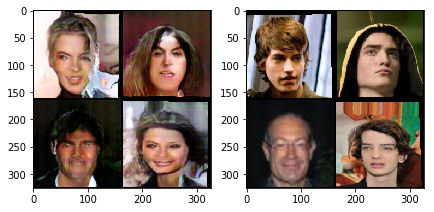

[0/1][2250/5332]	Disc/Dec Trains: 24.0/2251.0	Loss_D: 1.3608	Loss_Dec: 3.4583	Aux F1: 0.8512	Loss_Enc: 794.2974	D(x): 0.4634	D(G(z)): 0.2929
[0/1][2500/5332]	Disc/Dec Trains: 26.0/2501.0	Loss_D: 1.3613	Loss_Dec: 3.4565	Aux F1: 0.8512	Loss_Enc: 795.3300	D(x): 0.5292	D(G(z)): 0.2683
[0/1][2750/5332]	Disc/Dec Trains: 29.0/2751.0	Loss_D: 1.3654	Loss_Dec: 3.4506	Aux F1: 0.8512	Loss_Enc: 796.1764	D(x): 0.5268	D(G(z)): 0.2339
[0/1][3000/5332]	Disc/Dec Trains: 33.0/3001.0	Loss_D: 1.3664	Loss_Dec: 3.4475	Aux F1: 0.8513	Loss_Enc: 796.7793	D(x): 0.4960	D(G(z)): 0.2467
[0/1][3250/5332]	Disc/Dec Trains: 36.0/3251.0	Loss_D: 1.3641	Loss_Dec: 3.4462	Aux F1: 0.8513	Loss_Enc: 797.6141	D(x): 0.5226	D(G(z)): 0.2724
[0/1][3500/5332]	Disc/Dec Trains: 39.0/3501.0	Loss_D: 1.3621	Loss_Dec: 3.4451	Aux F1: 0.8514	Loss_Enc: 798.8651	D(x): 0.5639	D(G(z)): 0.2478
[0/1][3750/5332]	Disc/Dec Trains: 43.0/3751.0	Loss_D: 1.3620	Loss_Dec: 3.4442	Aux F1: 0.8514	Loss_Enc: 800.0715	D(x): 0.5818	D(G(z)): 0.3019
[0/1][4000/53

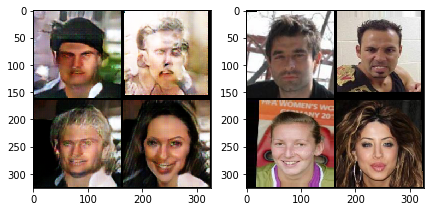

[0/1][4250/5332]	Disc/Dec Trains: 47.0/4251.0	Loss_D: 1.3589	Loss_Dec: 3.4446	Aux F1: 0.8514	Loss_Enc: 802.8165	D(x): 0.5000	D(G(z)): 0.2593
[0/1][4500/5332]	Disc/Dec Trains: 48.0/4501.0	Loss_D: 1.3589	Loss_Dec: 3.4431	Aux F1: 0.8513	Loss_Enc: 804.0131	D(x): 0.5571	D(G(z)): 0.2726
[0/1][4750/5332]	Disc/Dec Trains: 52.0/4751.0	Loss_D: 1.3598	Loss_Dec: 3.4412	Aux F1: 0.8514	Loss_Enc: 804.9294	D(x): 0.5506	D(G(z)): 0.2562
[0/1][5000/5332]	Disc/Dec Trains: 53.0/5001.0	Loss_D: 1.3608	Loss_Dec: 3.4385	Aux F1: 0.8514	Loss_Enc: 805.4065	D(x): 0.5313	D(G(z)): 0.2855
[0/1][5250/5332]	Disc/Dec Trains: 58.0/5251.0	Loss_D: 1.3611	Loss_Dec: 3.4387	Aux F1: 0.8514	Loss_Enc: 805.9852	D(x): 0.5638	D(G(z)): 0.2059


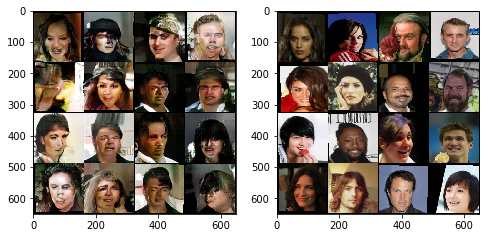

In [0]:
train(net, n_epochs=1, train_loader=train_loader, margin=0.4625, plot_images=2000)

[0/3][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2094	Loss_Dec: 3.6169	Aux F1: 0.8697	Loss_Enc: 824.7917	D(x): 0.5463	D(G(z)): 0.2368
[0/3][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.3207	Loss_Dec: 3.4655	Aux F1: 0.8511	Loss_Enc: 811.2215	D(x): 0.5290	D(G(z)): 0.2437
[0/3][500/5332]	Disc/Dec Trains: 4.0/501.0	Loss_D: 1.3390	Loss_Dec: 3.4476	Aux F1: 0.8512	Loss_Enc: 805.0882	D(x): 0.4913	D(G(z)): 0.2813
[0/3][750/5332]	Disc/Dec Trains: 6.0/751.0	Loss_D: 1.3612	Loss_Dec: 3.4272	Aux F1: 0.8518	Loss_Enc: 798.8764	D(x): 0.5428	D(G(z)): 0.2423
[0/3][1000/5332]	Disc/Dec Trains: 9.0/1001.0	Loss_D: 1.3666	Loss_Dec: 3.4228	Aux F1: 0.8517	Loss_Enc: 797.9232	D(x): 0.5118	D(G(z)): 0.3396
[0/3][1250/5332]	Disc/Dec Trains: 13.0/1251.0	Loss_D: 1.3701	Loss_Dec: 3.4172	Aux F1: 0.8518	Loss_Enc: 797.1887	D(x): 0.5006	D(G(z)): 0.2900
[0/3][1500/5332]	Disc/Dec Trains: 18.0/1501.0	Loss_D: 1.3648	Loss_Dec: 3.4233	Aux F1: 0.8516	Loss_Enc: 797.6381	D(x): 0.5134	D(G(z)): 0.2397
[0/3][1750/5332]	Disc/Dec Trai

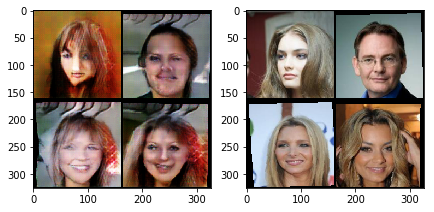

[0/3][2250/5332]	Disc/Dec Trains: 27.0/2251.0	Loss_D: 1.3630	Loss_Dec: 3.4355	Aux F1: 0.8513	Loss_Enc: 798.0445	D(x): 0.5497	D(G(z)): 0.3053
[0/3][2500/5332]	Disc/Dec Trains: 32.0/2501.0	Loss_D: 1.3606	Loss_Dec: 3.4382	Aux F1: 0.8513	Loss_Enc: 798.9353	D(x): 0.5012	D(G(z)): 0.2333
[0/3][2750/5332]	Disc/Dec Trains: 34.0/2751.0	Loss_D: 1.3579	Loss_Dec: 3.4412	Aux F1: 0.8513	Loss_Enc: 799.7840	D(x): 0.5201	D(G(z)): 0.2889
[0/3][3000/5332]	Disc/Dec Trains: 36.0/3001.0	Loss_D: 1.3586	Loss_Dec: 3.4412	Aux F1: 0.8513	Loss_Enc: 799.3729	D(x): 0.5149	D(G(z)): 0.3156
[0/3][3250/5332]	Disc/Dec Trains: 40.0/3251.0	Loss_D: 1.3612	Loss_Dec: 3.4409	Aux F1: 0.8513	Loss_Enc: 798.7986	D(x): 0.5270	D(G(z)): 0.2614
[0/3][3500/5332]	Disc/Dec Trains: 43.0/3501.0	Loss_D: 1.3647	Loss_Dec: 3.4393	Aux F1: 0.8513	Loss_Enc: 798.2145	D(x): 0.4862	D(G(z)): 0.3208
[0/3][3750/5332]	Disc/Dec Trains: 47.0/3751.0	Loss_D: 1.3659	Loss_Dec: 3.4409	Aux F1: 0.8513	Loss_Enc: 797.9967	D(x): 0.5303	D(G(z)): 0.3080
[0/3][4000/53

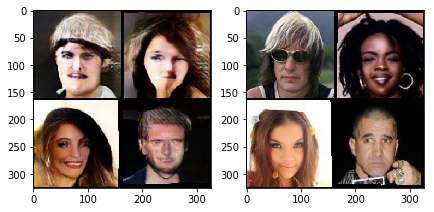

[0/3][4250/5332]	Disc/Dec Trains: 57.0/4251.0	Loss_D: 1.3696	Loss_Dec: 3.4409	Aux F1: 0.8513	Loss_Enc: 798.3672	D(x): 0.5083	D(G(z)): 0.2361
[0/3][4500/5332]	Disc/Dec Trains: 62.0/4501.0	Loss_D: 1.3677	Loss_Dec: 3.4433	Aux F1: 0.8512	Loss_Enc: 800.0650	D(x): 0.4795	D(G(z)): 0.2277
[0/3][4750/5332]	Disc/Dec Trains: 65.0/4751.0	Loss_D: 1.3665	Loss_Dec: 3.4453	Aux F1: 0.8512	Loss_Enc: 801.6337	D(x): 0.4801	D(G(z)): 0.2916
[0/3][5000/5332]	Disc/Dec Trains: 67.0/5001.0	Loss_D: 1.3659	Loss_Dec: 3.4447	Aux F1: 0.8512	Loss_Enc: 803.3877	D(x): 0.5337	D(G(z)): 0.3083
[0/3][5250/5332]	Disc/Dec Trains: 71.0/5251.0	Loss_D: 1.3645	Loss_Dec: 3.4448	Aux F1: 0.8512	Loss_Enc: 805.0978	D(x): 0.5559	D(G(z)): 0.2521


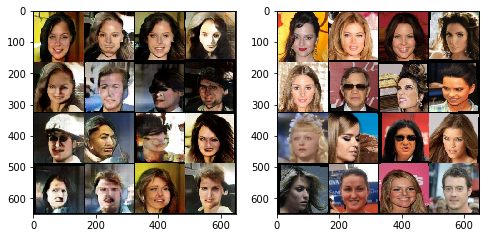

[1/3][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3588	Loss_Dec: 3.5611	Aux F1: 0.8599	Loss_Enc: 784.6511	D(x): 0.5265	D(G(z)): 0.2709
[1/3][250/5332]	Disc/Dec Trains: 3.0/251.0	Loss_D: 1.3553	Loss_Dec: 3.4523	Aux F1: 0.8518	Loss_Enc: 831.4410	D(x): 0.5360	D(G(z)): 0.2461
[1/3][500/5332]	Disc/Dec Trains: 6.0/501.0	Loss_D: 1.3439	Loss_Dec: 3.4637	Aux F1: 0.8513	Loss_Enc: 835.3552	D(x): 0.5314	D(G(z)): 0.2419
[1/3][750/5332]	Disc/Dec Trains: 11.0/751.0	Loss_D: 1.3477	Loss_Dec: 3.4540	Aux F1: 0.8511	Loss_Enc: 835.4972	D(x): 0.5050	D(G(z)): 0.2299
[1/3][1000/5332]	Disc/Dec Trains: 17.0/1001.0	Loss_D: 1.3452	Loss_Dec: 3.4520	Aux F1: 0.8508	Loss_Enc: 836.3086	D(x): 0.5168	D(G(z)): 0.2481
[1/3][1250/5332]	Disc/Dec Trains: 26.0/1251.0	Loss_D: 1.3454	Loss_Dec: 3.4430	Aux F1: 0.8509	Loss_Enc: 834.2336	D(x): 0.5238	D(G(z)): 0.2722
[1/3][1500/5332]	Disc/Dec Trains: 30.0/1501.0	Loss_D: 1.3417	Loss_Dec: 3.4444	Aux F1: 0.8508	Loss_Enc: 833.6791	D(x): 0.5498	D(G(z)): 0.2655
[1/3][1750/5332]	Disc/Dec Tr

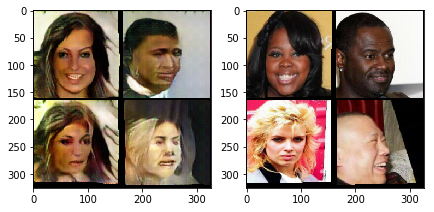

[1/3][2250/5332]	Disc/Dec Trains: 42.0/2251.0	Loss_D: 1.3533	Loss_Dec: 3.4375	Aux F1: 0.8506	Loss_Enc: 825.0851	D(x): 0.5337	D(G(z)): 0.2782
[1/3][2500/5332]	Disc/Dec Trains: 47.0/2501.0	Loss_D: 1.3549	Loss_Dec: 3.4346	Aux F1: 0.8505	Loss_Enc: 822.1888	D(x): 0.5342	D(G(z)): 0.2849
[1/3][2750/5332]	Disc/Dec Trains: 49.0/2751.0	Loss_D: 1.3569	Loss_Dec: 3.4323	Aux F1: 0.8504	Loss_Enc: 819.2652	D(x): 0.5187	D(G(z)): 0.3036
[1/3][3000/5332]	Disc/Dec Trains: 53.0/3001.0	Loss_D: 1.3600	Loss_Dec: 3.4297	Aux F1: 0.8505	Loss_Enc: 816.3635	D(x): 0.5688	D(G(z)): 0.2697
[1/3][3250/5332]	Disc/Dec Trains: 56.0/3251.0	Loss_D: 1.3636	Loss_Dec: 3.4287	Aux F1: 0.8504	Loss_Enc: 813.4731	D(x): 0.4870	D(G(z)): 0.3038
[1/3][3500/5332]	Disc/Dec Trains: 57.0/3501.0	Loss_D: 1.3698	Loss_Dec: 3.4251	Aux F1: 0.8504	Loss_Enc: 810.8752	D(x): 0.5011	D(G(z)): 0.2494
[1/3][3750/5332]	Disc/Dec Trains: 60.0/3751.0	Loss_D: 1.3754	Loss_Dec: 3.4207	Aux F1: 0.8504	Loss_Enc: 808.4526	D(x): 0.5199	D(G(z)): 0.3105
[1/3][4000/53

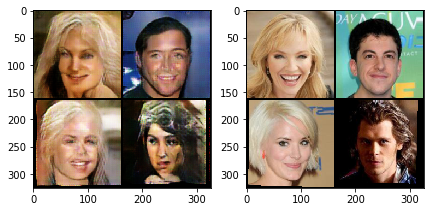

[1/3][4250/5332]	Disc/Dec Trains: 69.0/4251.0	Loss_D: 1.3825	Loss_Dec: 3.4148	Aux F1: 0.8505	Loss_Enc: 804.4857	D(x): 0.5114	D(G(z)): 0.2832
[1/3][4500/5332]	Disc/Dec Trains: 71.0/4501.0	Loss_D: 1.3855	Loss_Dec: 3.4135	Aux F1: 0.8505	Loss_Enc: 802.7783	D(x): 0.4805	D(G(z)): 0.3006
[1/3][4750/5332]	Disc/Dec Trains: 74.0/4751.0	Loss_D: 1.3911	Loss_Dec: 3.4110	Aux F1: 0.8505	Loss_Enc: 801.0366	D(x): 0.4555	D(G(z)): 0.2852
[1/3][5000/5332]	Disc/Dec Trains: 76.0/5001.0	Loss_D: 1.3967	Loss_Dec: 3.4076	Aux F1: 0.8506	Loss_Enc: 799.5569	D(x): 0.4639	D(G(z)): 0.3628
[1/3][5250/5332]	Disc/Dec Trains: 79.0/5251.0	Loss_D: 1.4048	Loss_Dec: 3.4027	Aux F1: 0.8506	Loss_Enc: 797.8085	D(x): 0.4766	D(G(z)): 0.3427


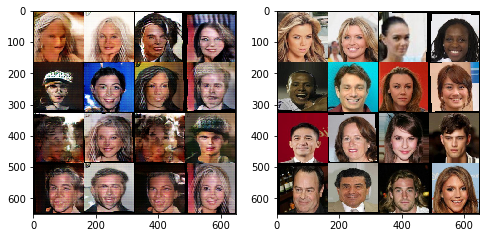

[2/3][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.4362	Loss_Dec: 3.4558	Aux F1: 0.8592	Loss_Enc: 747.1770	D(x): 0.4960	D(G(z)): 0.3259
[2/3][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.5527	Loss_Dec: 3.3060	Aux F1: 0.8507	Loss_Enc: 763.8316	D(x): 0.4420	D(G(z)): 0.3580
[2/3][500/5332]	Disc/Dec Trains: 4.0/501.0	Loss_D: 1.5696	Loss_Dec: 3.2913	Aux F1: 0.8509	Loss_Enc: 760.2917	D(x): 0.4770	D(G(z)): 0.3924
[2/3][750/5332]	Disc/Dec Trains: 8.0/751.0	Loss_D: 1.5474	Loss_Dec: 3.3104	Aux F1: 0.8508	Loss_Enc: 761.1252	D(x): 0.5146	D(G(z)): 0.3737
[2/3][1000/5332]	Disc/Dec Trains: 8.0/1001.0	Loss_D: 1.5405	Loss_Dec: 3.3172	Aux F1: 0.8508	Loss_Enc: 760.8744	D(x): 0.4931	D(G(z)): 0.3611
[2/3][1250/5332]	Disc/Dec Trains: 11.0/1251.0	Loss_D: 1.5550	Loss_Dec: 3.3056	Aux F1: 0.8507	Loss_Enc: 760.1451	D(x): 0.4654	D(G(z)): 0.3721
[2/3][1500/5332]	Disc/Dec Trains: 15.0/1501.0	Loss_D: 1.5560	Loss_Dec: 3.3071	Aux F1: 0.8508	Loss_Enc: 759.7979	D(x): 0.4885	D(G(z)): 0.4012
[2/3][1750/5332]	Disc/Dec Trai

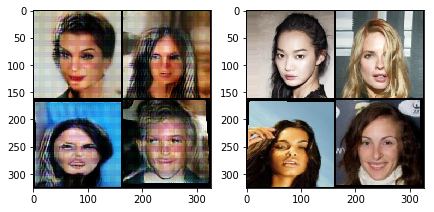

[2/3][2250/5332]	Disc/Dec Trains: 21.0/2251.0	Loss_D: 1.5691	Loss_Dec: 3.2993	Aux F1: 0.8511	Loss_Enc: 760.2540	D(x): 0.5113	D(G(z)): 0.3876
[2/3][2500/5332]	Disc/Dec Trains: 23.0/2501.0	Loss_D: 1.5775	Loss_Dec: 3.2931	Aux F1: 0.8510	Loss_Enc: 759.8138	D(x): 0.4144	D(G(z)): 0.4737
[2/3][2750/5332]	Disc/Dec Trains: 26.0/2751.0	Loss_D: 1.5835	Loss_Dec: 3.2848	Aux F1: 0.8510	Loss_Enc: 759.2698	D(x): 0.4418	D(G(z)): 0.3613
[2/3][3000/5332]	Disc/Dec Trains: 29.0/3001.0	Loss_D: 1.5873	Loss_Dec: 3.2790	Aux F1: 0.8511	Loss_Enc: 758.6745	D(x): 0.4474	D(G(z)): 0.3401
[2/3][3250/5332]	Disc/Dec Trains: 32.0/3251.0	Loss_D: 1.5894	Loss_Dec: 3.2737	Aux F1: 0.8510	Loss_Enc: 758.0348	D(x): 0.4565	D(G(z)): 0.3218
[2/3][3500/5332]	Disc/Dec Trains: 35.0/3501.0	Loss_D: 1.5895	Loss_Dec: 3.2698	Aux F1: 0.8511	Loss_Enc: 757.3490	D(x): 0.5168	D(G(z)): 0.3295
[2/3][3750/5332]	Disc/Dec Trains: 38.0/3751.0	Loss_D: 1.5894	Loss_Dec: 3.2674	Aux F1: 0.8512	Loss_Enc: 756.4957	D(x): 0.4017	D(G(z)): 0.4179
[2/3][4000/53

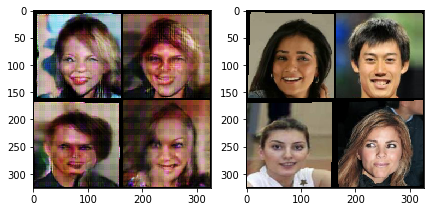

[2/3][4250/5332]	Disc/Dec Trains: 42.0/4250.0	Loss_D: 1.5946	Loss_Dec: 3.2583	Aux F1: 0.8511	Loss_Enc: 754.2796	D(x): 0.4810	D(G(z)): 0.3283
[2/3][4500/5332]	Disc/Dec Trains: 43.0/4500.0	Loss_D: 1.5965	Loss_Dec: 3.2548	Aux F1: 0.8511	Loss_Enc: 753.1399	D(x): 0.4150	D(G(z)): 0.3758
[2/3][4750/5332]	Disc/Dec Trains: 45.0/4750.0	Loss_D: 1.5997	Loss_Dec: 3.2501	Aux F1: 0.8511	Loss_Enc: 751.8993	D(x): 0.4338	D(G(z)): 0.3711
[2/3][5000/5332]	Disc/Dec Trains: 48.0/5000.0	Loss_D: 1.6000	Loss_Dec: 3.2488	Aux F1: 0.8512	Loss_Enc: 750.6895	D(x): 0.4442	D(G(z)): 0.3520
[2/3][5250/5332]	Disc/Dec Trains: 51.0/5250.0	Loss_D: 1.5996	Loss_Dec: 3.2484	Aux F1: 0.8512	Loss_Enc: 749.6887	D(x): 0.4550	D(G(z)): 0.3592


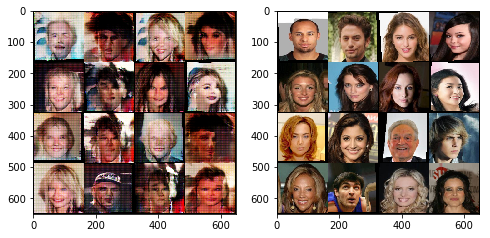

In [0]:
train(net, n_epochs=3, train_loader=train_loader, margin=0.46, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.5360	Loss_Dec: 3.4929	Aux F1: 0.8539	Loss_Enc: 782.9021	D(x): 0.4723	D(G(z)): 0.3381
[0/5][250/5332]	Disc/Dec Trains: 5.0/251.0	Loss_D: 1.4640	Loss_Dec: 3.4426	Aux F1: 0.8519	Loss_Enc: 800.0437	D(x): 0.5401	D(G(z)): 0.2775
[0/5][500/5332]	Disc/Dec Trains: 11.0/501.0	Loss_D: 1.4315	Loss_Dec: 3.4730	Aux F1: 0.8516	Loss_Enc: 806.2804	D(x): 0.5162	D(G(z)): 0.2516
[0/5][750/5332]	Disc/Dec Trains: 16.0/751.0	Loss_D: 1.4180	Loss_Dec: 3.4865	Aux F1: 0.8513	Loss_Enc: 808.3962	D(x): 0.5506	D(G(z)): 0.2560
[0/5][1000/5332]	Disc/Dec Trains: 20.0/1001.0	Loss_D: 1.4084	Loss_Dec: 3.4906	Aux F1: 0.8513	Loss_Enc: 806.6361	D(x): 0.4766	D(G(z)): 0.2903
[0/5][1250/5332]	Disc/Dec Trains: 25.0/1251.0	Loss_D: 1.3970	Loss_Dec: 3.4944	Aux F1: 0.8514	Loss_Enc: 803.7831	D(x): 0.5732	D(G(z)): 0.2741
[0/5][1500/5332]	Disc/Dec Trains: 31.0/1501.0	Loss_D: 1.3866	Loss_Dec: 3.5020	Aux F1: 0.8515	Loss_Enc: 800.9363	D(x): 0.4814	D(G(z)): 0.2625
[0/5][1750/5332]	Disc/Dec T

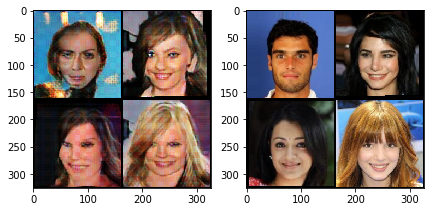

[0/5][2250/5332]	Disc/Dec Trains: 44.0/2251.0	Loss_D: 1.3687	Loss_Dec: 3.5078	Aux F1: 0.8517	Loss_Enc: 794.1555	D(x): 0.5568	D(G(z)): 0.3006
[0/5][2500/5332]	Disc/Dec Trains: 48.0/2501.0	Loss_D: 1.3659	Loss_Dec: 3.5070	Aux F1: 0.8518	Loss_Enc: 792.9469	D(x): 0.5592	D(G(z)): 0.2703
[0/5][2750/5332]	Disc/Dec Trains: 57.0/2751.0	Loss_D: 1.3615	Loss_Dec: 3.5066	Aux F1: 0.8517	Loss_Enc: 792.4879	D(x): 0.5608	D(G(z)): 0.2483
[0/5][3000/5332]	Disc/Dec Trains: 60.0/3001.0	Loss_D: 1.3569	Loss_Dec: 3.5075	Aux F1: 0.8517	Loss_Enc: 793.0228	D(x): 0.5077	D(G(z)): 0.2671
[0/5][3250/5332]	Disc/Dec Trains: 64.0/3251.0	Loss_D: 1.3534	Loss_Dec: 3.5072	Aux F1: 0.8517	Loss_Enc: 793.5986	D(x): 0.4976	D(G(z)): 0.3102
[0/5][3500/5332]	Disc/Dec Trains: 67.0/3501.0	Loss_D: 1.3519	Loss_Dec: 3.5048	Aux F1: 0.8517	Loss_Enc: 794.2649	D(x): 0.4726	D(G(z)): 0.3238
[0/5][3750/5332]	Disc/Dec Trains: 71.0/3751.0	Loss_D: 1.3514	Loss_Dec: 3.5022	Aux F1: 0.8518	Loss_Enc: 794.7533	D(x): 0.5159	D(G(z)): 0.2665
[0/5][4000/53

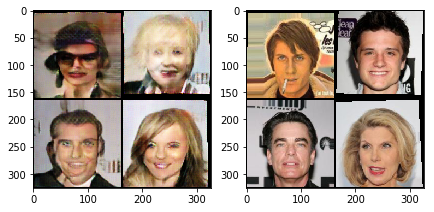

[0/5][4250/5332]	Disc/Dec Trains: 78.0/4251.0	Loss_D: 1.3491	Loss_Dec: 3.4999	Aux F1: 0.8517	Loss_Enc: 796.3007	D(x): 0.5504	D(G(z)): 0.2798
[0/5][4500/5332]	Disc/Dec Trains: 80.0/4501.0	Loss_D: 1.3502	Loss_Dec: 3.4973	Aux F1: 0.8517	Loss_Enc: 797.1768	D(x): 0.5543	D(G(z)): 0.2808
[0/5][4750/5332]	Disc/Dec Trains: 84.0/4751.0	Loss_D: 1.3517	Loss_Dec: 3.4940	Aux F1: 0.8517	Loss_Enc: 797.8987	D(x): 0.5368	D(G(z)): 0.3196
[0/5][5000/5332]	Disc/Dec Trains: 86.0/5001.0	Loss_D: 1.3544	Loss_Dec: 3.4896	Aux F1: 0.8517	Loss_Enc: 798.4145	D(x): 0.5479	D(G(z)): 0.2871
[0/5][5250/5332]	Disc/Dec Trains: 87.0/5251.0	Loss_D: 1.3599	Loss_Dec: 3.4831	Aux F1: 0.8517	Loss_Enc: 798.4593	D(x): 0.4708	D(G(z)): 0.3592


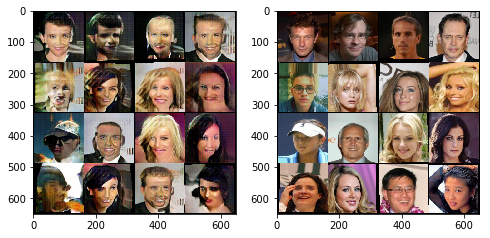

[1/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.3752	Loss_Dec: 3.8063	Aux F1: 0.8586	Loss_Enc: 842.8594	D(x): 0.4900	D(G(z)): 0.2731
[1/5][250/5332]	Disc/Dec Trains: 4.0/251.0	Loss_D: 1.3807	Loss_Dec: 3.4144	Aux F1: 0.8514	Loss_Enc: 803.4465	D(x): 0.4551	D(G(z)): 0.3259
[1/5][500/5332]	Disc/Dec Trains: 10.0/501.0	Loss_D: 1.3802	Loss_Dec: 3.4188	Aux F1: 0.8511	Loss_Enc: 803.0370	D(x): 0.4925	D(G(z)): 0.2577
[1/5][750/5332]	Disc/Dec Trains: 15.0/751.0	Loss_D: 1.3751	Loss_Dec: 3.4293	Aux F1: 0.8514	Loss_Enc: 805.0049	D(x): 0.5567	D(G(z)): 0.2382
[1/5][1000/5332]	Disc/Dec Trains: 21.0/1001.0	Loss_D: 1.3631	Loss_Dec: 3.4428	Aux F1: 0.8515	Loss_Enc: 807.7825	D(x): 0.5135	D(G(z)): 0.2579
[1/5][1250/5332]	Disc/Dec Trains: 28.0/1251.0	Loss_D: 1.3512	Loss_Dec: 3.4522	Aux F1: 0.8518	Loss_Enc: 808.9580	D(x): 0.5235	D(G(z)): 0.2505
[1/5][1500/5332]	Disc/Dec Trains: 36.0/1501.0	Loss_D: 1.3357	Loss_Dec: 3.4682	Aux F1: 0.8518	Loss_Enc: 810.3636	D(x): 0.5212	D(G(z)): 0.2490
[1/5][1750/5332]	Disc/Dec T

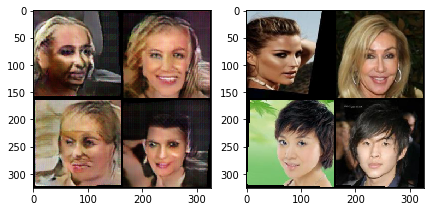

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.475, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2053	Loss_Dec: 3.4737	Aux F1: 0.8526	Loss_Enc: 805.9720	D(x): 0.5981	D(G(z)): 0.2812
[0/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.3127	Loss_Dec: 3.5334	Aux F1: 0.8520	Loss_Enc: 828.3519	D(x): 0.5673	D(G(z)): 0.2322
[0/5][500/5332]	Disc/Dec Trains: 7.0/501.0	Loss_D: 1.3112	Loss_Dec: 3.5348	Aux F1: 0.8522	Loss_Enc: 829.2064	D(x): 0.5296	D(G(z)): 0.2915
[0/5][750/5332]	Disc/Dec Trains: 12.0/751.0	Loss_D: 1.3119	Loss_Dec: 3.5343	Aux F1: 0.8520	Loss_Enc: 828.4331	D(x): 0.5701	D(G(z)): 0.2508
[0/5][1000/5332]	Disc/Dec Trains: 16.0/1001.0	Loss_D: 1.3146	Loss_Dec: 3.5350	Aux F1: 0.8522	Loss_Enc: 828.4699	D(x): 0.5461	D(G(z)): 0.3127
[0/5][1250/5332]	Disc/Dec Trains: 19.0/1251.0	Loss_D: 1.3193	Loss_Dec: 3.5290	Aux F1: 0.8521	Loss_Enc: 826.4211	D(x): 0.5163	D(G(z)): 0.3093
[0/5][1500/5332]	Disc/Dec Trains: 24.0/1501.0	Loss_D: 1.3208	Loss_Dec: 3.5279	Aux F1: 0.8521	Loss_Enc: 825.7554	D(x): 0.5274	D(G(z)): 0.2876
[0/5][1750/5332]	Disc/Dec Tr

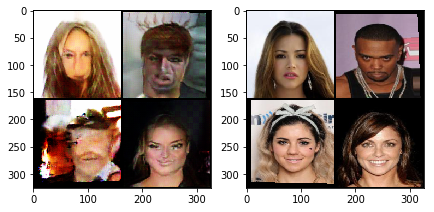

[0/5][2250/5332]	Disc/Dec Trains: 37.0/2251.0	Loss_D: 1.3208	Loss_Dec: 3.5280	Aux F1: 0.8521	Loss_Enc: 823.0150	D(x): 0.5451	D(G(z)): 0.2638
[0/5][2500/5332]	Disc/Dec Trains: 39.0/2501.0	Loss_D: 1.3214	Loss_Dec: 3.5273	Aux F1: 0.8521	Loss_Enc: 821.7976	D(x): 0.5505	D(G(z)): 0.2967
[0/5][2750/5332]	Disc/Dec Trains: 41.0/2751.0	Loss_D: 1.3232	Loss_Dec: 3.5250	Aux F1: 0.8521	Loss_Enc: 820.8717	D(x): 0.5520	D(G(z)): 0.2526
[0/5][3000/5332]	Disc/Dec Trains: 46.0/3001.0	Loss_D: 1.3251	Loss_Dec: 3.5232	Aux F1: 0.8521	Loss_Enc: 819.9397	D(x): 0.4648	D(G(z)): 0.2670
[0/5][3250/5332]	Disc/Dec Trains: 48.0/3251.0	Loss_D: 1.3260	Loss_Dec: 3.5213	Aux F1: 0.8522	Loss_Enc: 818.9640	D(x): 0.5037	D(G(z)): 0.2803
[0/5][3500/5332]	Disc/Dec Trains: 51.0/3501.0	Loss_D: 1.3267	Loss_Dec: 3.5197	Aux F1: 0.8522	Loss_Enc: 818.0521	D(x): 0.4953	D(G(z)): 0.2508
[0/5][3750/5332]	Disc/Dec Trains: 53.0/3751.0	Loss_D: 1.3287	Loss_Dec: 3.5162	Aux F1: 0.8524	Loss_Enc: 817.1169	D(x): 0.5006	D(G(z)): 0.2715
[0/5][4000/53

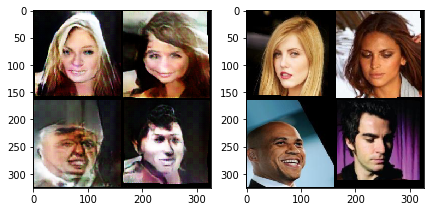

[0/5][4250/5332]	Disc/Dec Trains: 59.0/4251.0	Loss_D: 1.3310	Loss_Dec: 3.5104	Aux F1: 0.8524	Loss_Enc: 816.0050	D(x): 0.5235	D(G(z)): 0.2925
[0/5][4500/5332]	Disc/Dec Trains: 65.0/4501.0	Loss_D: 1.3324	Loss_Dec: 3.5077	Aux F1: 0.8524	Loss_Enc: 815.4699	D(x): 0.5461	D(G(z)): 0.3271
[0/5][4750/5332]	Disc/Dec Trains: 69.0/4751.0	Loss_D: 1.3331	Loss_Dec: 3.5063	Aux F1: 0.8524	Loss_Enc: 815.3638	D(x): 0.5032	D(G(z)): 0.3225
[0/5][5000/5332]	Disc/Dec Trains: 74.0/5001.0	Loss_D: 1.3329	Loss_Dec: 3.5042	Aux F1: 0.8525	Loss_Enc: 815.0934	D(x): 0.5655	D(G(z)): 0.2799
[0/5][5250/5332]	Disc/Dec Trains: 78.0/5251.0	Loss_D: 1.3321	Loss_Dec: 3.5034	Aux F1: 0.8524	Loss_Enc: 815.1413	D(x): 0.5138	D(G(z)): 0.2597


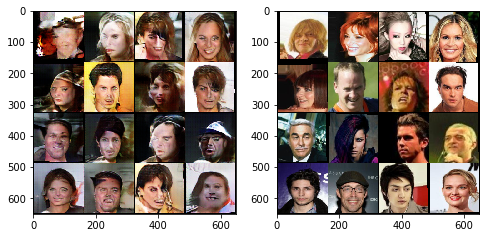

[1/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2747	Loss_Dec: 3.3286	Aux F1: 0.8586	Loss_Enc: 815.7800	D(x): 0.5630	D(G(z)): 0.2917
[1/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.3189	Loss_Dec: 3.4821	Aux F1: 0.8533	Loss_Enc: 814.9119	D(x): 0.5344	D(G(z)): 0.2854
[1/5][500/5332]	Disc/Dec Trains: 4.0/501.0	Loss_D: 1.3316	Loss_Dec: 3.4689	Aux F1: 0.8528	Loss_Enc: 814.3557	D(x): 0.5741	D(G(z)): 0.2866
[1/5][750/5332]	Disc/Dec Trains: 8.0/751.0	Loss_D: 1.3313	Loss_Dec: 3.4626	Aux F1: 0.8528	Loss_Enc: 813.0002	D(x): 0.5280	D(G(z)): 0.3157
[1/5][1000/5332]	Disc/Dec Trains: 12.0/1001.0	Loss_D: 1.3307	Loss_Dec: 3.4602	Aux F1: 0.8528	Loss_Enc: 812.2890	D(x): 0.5447	D(G(z)): 0.2727
[1/5][1250/5332]	Disc/Dec Trains: 16.0/1251.0	Loss_D: 1.3297	Loss_Dec: 3.4594	Aux F1: 0.8528	Loss_Enc: 812.2531	D(x): 0.5504	D(G(z)): 0.2746
[1/5][1500/5332]	Disc/Dec Trains: 18.0/1501.0	Loss_D: 1.3271	Loss_Dec: 3.4606	Aux F1: 0.8528	Loss_Enc: 812.6356	D(x): 0.6219	D(G(z)): 0.2357
[1/5][1750/5332]	Disc/Dec Tra

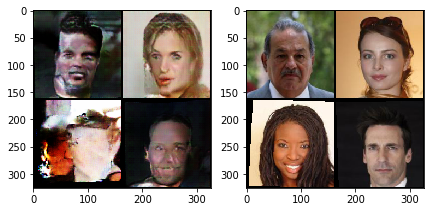

[1/5][2250/5332]	Disc/Dec Trains: 26.0/2251.0	Loss_D: 1.3306	Loss_Dec: 3.4553	Aux F1: 0.8527	Loss_Enc: 811.4734	D(x): 0.5357	D(G(z)): 0.3337
[1/5][2500/5332]	Disc/Dec Trains: 30.0/2501.0	Loss_D: 1.3320	Loss_Dec: 3.4537	Aux F1: 0.8527	Loss_Enc: 811.2878	D(x): 0.5236	D(G(z)): 0.2279
[1/5][2750/5332]	Disc/Dec Trains: 33.0/2751.0	Loss_D: 1.3325	Loss_Dec: 3.4537	Aux F1: 0.8529	Loss_Enc: 811.3833	D(x): 0.5379	D(G(z)): 0.2839
[1/5][3000/5332]	Disc/Dec Trains: 37.0/3001.0	Loss_D: 1.3328	Loss_Dec: 3.4539	Aux F1: 0.8529	Loss_Enc: 811.3748	D(x): 0.5789	D(G(z)): 0.2782
[1/5][3250/5332]	Disc/Dec Trains: 38.0/3251.0	Loss_D: 1.3324	Loss_Dec: 3.4542	Aux F1: 0.8529	Loss_Enc: 811.2966	D(x): 0.5792	D(G(z)): 0.2725
[1/5][3500/5332]	Disc/Dec Trains: 41.0/3501.0	Loss_D: 1.3330	Loss_Dec: 3.4541	Aux F1: 0.8529	Loss_Enc: 811.1091	D(x): 0.5974	D(G(z)): 0.2569
[1/5][3750/5332]	Disc/Dec Trains: 44.0/3751.0	Loss_D: 1.3338	Loss_Dec: 3.4541	Aux F1: 0.8530	Loss_Enc: 810.9779	D(x): 0.5413	D(G(z)): 0.2948
[1/5][4000/53

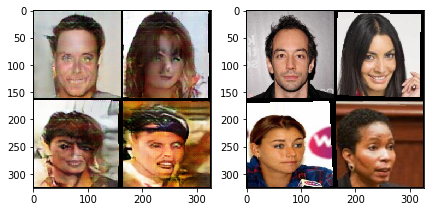

[1/5][4250/5332]	Disc/Dec Trains: 48.0/4251.0	Loss_D: 1.3345	Loss_Dec: 3.4544	Aux F1: 0.8528	Loss_Enc: 811.1589	D(x): 0.5072	D(G(z)): 0.2869
[1/5][4500/5332]	Disc/Dec Trains: 48.0/4501.0	Loss_D: 1.3359	Loss_Dec: 3.4543	Aux F1: 0.8527	Loss_Enc: 811.1331	D(x): 0.5813	D(G(z)): 0.2961
[1/5][4750/5332]	Disc/Dec Trains: 52.0/4751.0	Loss_D: 1.3377	Loss_Dec: 3.4532	Aux F1: 0.8527	Loss_Enc: 810.9784	D(x): 0.5477	D(G(z)): 0.2799
[1/5][5000/5332]	Disc/Dec Trains: 60.0/5001.0	Loss_D: 1.3381	Loss_Dec: 3.4533	Aux F1: 0.8528	Loss_Enc: 810.8697	D(x): 0.5188	D(G(z)): 0.3574
[1/5][5250/5332]	Disc/Dec Trains: 64.0/5251.0	Loss_D: 1.3377	Loss_Dec: 3.4549	Aux F1: 0.8528	Loss_Enc: 810.7410	D(x): 0.5281	D(G(z)): 0.2796


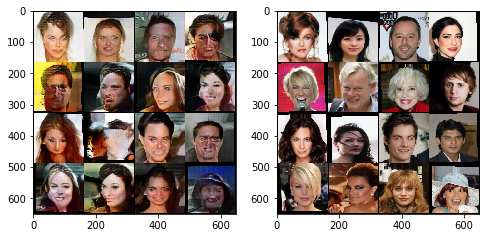

[2/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2410	Loss_Dec: 3.5717	Aux F1: 0.8579	Loss_Enc: 843.3359	D(x): 0.5473	D(G(z)): 0.2498
[2/5][250/5332]	Disc/Dec Trains: 6.0/251.0	Loss_D: 1.3260	Loss_Dec: 3.4878	Aux F1: 0.8533	Loss_Enc: 805.9792	D(x): 0.5226	D(G(z)): 0.2918
[2/5][500/5332]	Disc/Dec Trains: 7.0/501.0	Loss_D: 1.3211	Loss_Dec: 3.5004	Aux F1: 0.8531	Loss_Enc: 805.2304	D(x): 0.5573	D(G(z)): 0.2562
[2/5][750/5332]	Disc/Dec Trains: 8.0/751.0	Loss_D: 1.3251	Loss_Dec: 3.5006	Aux F1: 0.8532	Loss_Enc: 804.9155	D(x): 0.5257	D(G(z)): 0.2885
[2/5][1000/5332]	Disc/Dec Trains: 13.0/1001.0	Loss_D: 1.3280	Loss_Dec: 3.4958	Aux F1: 0.8532	Loss_Enc: 804.5080	D(x): 0.5870	D(G(z)): 0.2485
[2/5][1250/5332]	Disc/Dec Trains: 16.0/1251.0	Loss_D: 1.3295	Loss_Dec: 3.4947	Aux F1: 0.8533	Loss_Enc: 804.4409	D(x): 0.5677	D(G(z)): 0.3066
[2/5][1500/5332]	Disc/Dec Trains: 20.0/1501.0	Loss_D: 1.3316	Loss_Dec: 3.4932	Aux F1: 0.8531	Loss_Enc: 804.2196	D(x): 0.5044	D(G(z)): 0.3200
[2/5][1750/5332]	Disc/Dec Tra

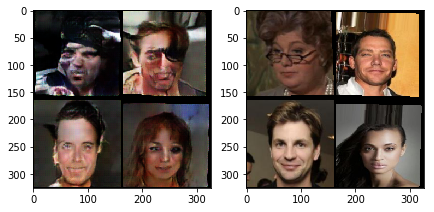

[2/5][2250/5332]	Disc/Dec Trains: 37.0/2251.0	Loss_D: 1.3297	Loss_Dec: 3.4978	Aux F1: 0.8531	Loss_Enc: 805.1327	D(x): 0.5427	D(G(z)): 0.2454
[2/5][2500/5332]	Disc/Dec Trains: 40.0/2501.0	Loss_D: 1.3291	Loss_Dec: 3.5013	Aux F1: 0.8530	Loss_Enc: 805.1425	D(x): 0.5072	D(G(z)): 0.2621
[2/5][2750/5332]	Disc/Dec Trains: 44.0/2751.0	Loss_D: 1.3280	Loss_Dec: 3.5045	Aux F1: 0.8531	Loss_Enc: 805.3707	D(x): 0.5235	D(G(z)): 0.2414
[2/5][3000/5332]	Disc/Dec Trains: 47.0/3001.0	Loss_D: 1.3274	Loss_Dec: 3.5081	Aux F1: 0.8531	Loss_Enc: 805.5403	D(x): 0.5435	D(G(z)): 0.2325
[2/5][3250/5332]	Disc/Dec Trains: 49.0/3251.0	Loss_D: 1.3268	Loss_Dec: 3.5119	Aux F1: 0.8532	Loss_Enc: 805.6184	D(x): 0.5612	D(G(z)): 0.2580
[2/5][3500/5332]	Disc/Dec Trains: 53.0/3501.0	Loss_D: 1.3276	Loss_Dec: 3.5130	Aux F1: 0.8532	Loss_Enc: 805.6156	D(x): 0.5601	D(G(z)): 0.2948
[2/5][3750/5332]	Disc/Dec Trains: 56.0/3751.0	Loss_D: 1.3281	Loss_Dec: 3.5140	Aux F1: 0.8533	Loss_Enc: 805.5681	D(x): 0.5215	D(G(z)): 0.2796
[2/5][4000/53

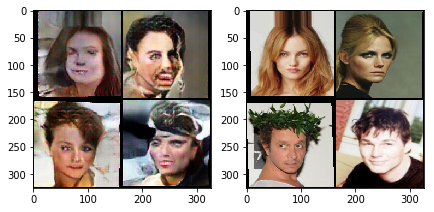

[2/5][4250/5332]	Disc/Dec Trains: 65.0/4251.0	Loss_D: 1.3268	Loss_Dec: 3.5183	Aux F1: 0.8532	Loss_Enc: 805.5297	D(x): 0.5282	D(G(z)): 0.2880
[2/5][4500/5332]	Disc/Dec Trains: 69.0/4501.0	Loss_D: 1.3264	Loss_Dec: 3.5202	Aux F1: 0.8532	Loss_Enc: 805.6197	D(x): 0.5094	D(G(z)): 0.2756
[2/5][4750/5332]	Disc/Dec Trains: 75.0/4751.0	Loss_D: 1.3257	Loss_Dec: 3.5222	Aux F1: 0.8532	Loss_Enc: 805.5501	D(x): 0.5317	D(G(z)): 0.2621
[2/5][5000/5332]	Disc/Dec Trains: 81.0/5001.0	Loss_D: 1.3238	Loss_Dec: 3.5259	Aux F1: 0.8532	Loss_Enc: 805.6281	D(x): 0.5669	D(G(z)): 0.2596
[2/5][5250/5332]	Disc/Dec Trains: 83.0/5251.0	Loss_D: 1.3228	Loss_Dec: 3.5275	Aux F1: 0.8532	Loss_Enc: 805.2798	D(x): 0.6279	D(G(z)): 0.2699


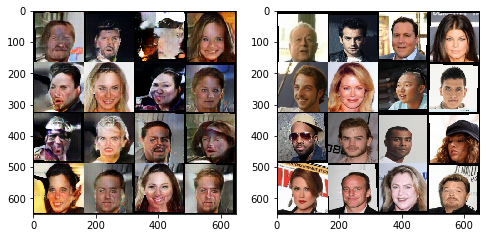

[3/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.2990	Loss_Dec: 3.4803	Aux F1: 0.8461	Loss_Enc: 768.3547	D(x): 0.5534	D(G(z)): 0.2694
[3/5][250/5332]	Disc/Dec Trains: 2.0/251.0	Loss_D: 1.2994	Loss_Dec: 3.5647	Aux F1: 0.8535	Loss_Enc: 805.5036	D(x): 0.5461	D(G(z)): 0.2610
[3/5][500/5332]	Disc/Dec Trains: 6.0/501.0	Loss_D: 1.2997	Loss_Dec: 3.5662	Aux F1: 0.8535	Loss_Enc: 804.7190	D(x): 0.5210	D(G(z)): 0.3380
[3/5][750/5332]	Disc/Dec Trains: 10.0/751.0	Loss_D: 1.3005	Loss_Dec: 3.5690	Aux F1: 0.8537	Loss_Enc: 804.3066	D(x): 0.5550	D(G(z)): 0.2751
[3/5][1000/5332]	Disc/Dec Trains: 13.0/1001.0	Loss_D: 1.3014	Loss_Dec: 3.5675	Aux F1: 0.8536	Loss_Enc: 804.3239	D(x): 0.5369	D(G(z)): 0.2724
[3/5][1250/5332]	Disc/Dec Trains: 17.0/1251.0	Loss_D: 1.3023	Loss_Dec: 3.5657	Aux F1: 0.8535	Loss_Enc: 805.1980	D(x): 0.5710	D(G(z)): 0.2418
[3/5][1500/5332]	Disc/Dec Trains: 20.0/1501.0	Loss_D: 1.3010	Loss_Dec: 3.5699	Aux F1: 0.8534	Loss_Enc: 806.0038	D(x): 0.5584	D(G(z)): 0.2965
[3/5][1750/5332]	Disc/Dec Tr

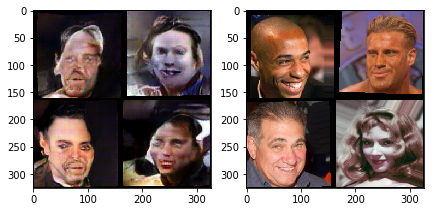

[3/5][2250/5332]	Disc/Dec Trains: 23.0/2251.0	Loss_D: 1.3058	Loss_Dec: 3.5688	Aux F1: 0.8532	Loss_Enc: 806.3027	D(x): 0.5191	D(G(z)): 0.2915
[3/5][2500/5332]	Disc/Dec Trains: 27.0/2501.0	Loss_D: 1.3099	Loss_Dec: 3.5657	Aux F1: 0.8532	Loss_Enc: 805.6591	D(x): 0.4891	D(G(z)): 0.2577
[3/5][2750/5332]	Disc/Dec Trains: 28.0/2751.0	Loss_D: 1.3128	Loss_Dec: 3.5658	Aux F1: 0.8533	Loss_Enc: 805.4611	D(x): 0.5350	D(G(z)): 0.2808
[3/5][3000/5332]	Disc/Dec Trains: 28.0/3001.0	Loss_D: 1.3181	Loss_Dec: 3.5624	Aux F1: 0.8533	Loss_Enc: 804.9963	D(x): 0.5071	D(G(z)): 0.2638
[3/5][3250/5332]	Disc/Dec Trains: 28.0/3251.0	Loss_D: 1.3252	Loss_Dec: 3.5563	Aux F1: 0.8532	Loss_Enc: 803.9436	D(x): 0.5254	D(G(z)): 0.3182
[3/5][3500/5332]	Disc/Dec Trains: 30.0/3501.0	Loss_D: 1.3328	Loss_Dec: 3.5483	Aux F1: 0.8532	Loss_Enc: 802.9673	D(x): 0.5554	D(G(z)): 0.3328
[3/5][3750/5332]	Disc/Dec Trains: 32.0/3751.0	Loss_D: 1.3396	Loss_Dec: 3.5417	Aux F1: 0.8533	Loss_Enc: 802.0464	D(x): 0.5476	D(G(z)): 0.3063
[3/5][4000/53

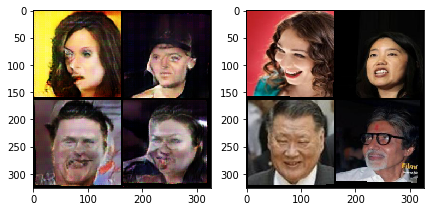

[3/5][4250/5332]	Disc/Dec Trains: 36.0/4251.0	Loss_D: 1.3515	Loss_Dec: 3.5301	Aux F1: 0.8534	Loss_Enc: 800.5248	D(x): 0.5388	D(G(z)): 0.3375
[3/5][4500/5332]	Disc/Dec Trains: 39.0/4501.0	Loss_D: 1.3561	Loss_Dec: 3.5249	Aux F1: 0.8535	Loss_Enc: 799.7506	D(x): 0.4589	D(G(z)): 0.2971
[3/5][4750/5332]	Disc/Dec Trains: 43.0/4751.0	Loss_D: 1.3593	Loss_Dec: 3.5211	Aux F1: 0.8535	Loss_Enc: 798.8856	D(x): 0.5289	D(G(z)): 0.3359
[3/5][5000/5332]	Disc/Dec Trains: 47.0/5001.0	Loss_D: 1.3616	Loss_Dec: 3.5190	Aux F1: 0.8535	Loss_Enc: 798.3014	D(x): 0.5610	D(G(z)): 0.2584
[3/5][5250/5332]	Disc/Dec Trains: 49.0/5251.0	Loss_D: 1.3634	Loss_Dec: 3.5171	Aux F1: 0.8536	Loss_Enc: 797.5788	D(x): 0.5124	D(G(z)): 0.3093


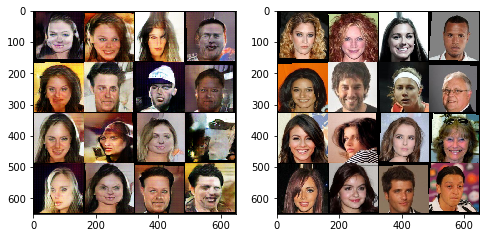

[4/5][0/5332]	Disc/Dec Trains: 0.0/1.0	Loss_D: 1.5641	Loss_Dec: 3.4604	Aux F1: 0.8553	Loss_Enc: 795.6478	D(x): 0.4771	D(G(z)): 0.2902
[4/5][250/5332]	Disc/Dec Trains: 3.0/251.0	Loss_D: 1.3976	Loss_Dec: 3.4739	Aux F1: 0.8539	Loss_Enc: 782.5461	D(x): 0.4982	D(G(z)): 0.3179
[4/5][500/5332]	Disc/Dec Trains: 11.0/501.0	Loss_D: 1.3910	Loss_Dec: 3.4754	Aux F1: 0.8538	Loss_Enc: 780.4233	D(x): 0.5202	D(G(z)): 0.2566
[4/5][750/5332]	Disc/Dec Trains: 15.0/751.0	Loss_D: 1.3840	Loss_Dec: 3.4826	Aux F1: 0.8538	Loss_Enc: 780.5009	D(x): 0.5714	D(G(z)): 0.2534
[4/5][1000/5332]	Disc/Dec Trains: 23.0/1001.0	Loss_D: 1.3781	Loss_Dec: 3.4889	Aux F1: 0.8538	Loss_Enc: 779.3756	D(x): 0.5096	D(G(z)): 0.2558
[4/5][1250/5332]	Disc/Dec Trains: 24.0/1251.0	Loss_D: 1.3729	Loss_Dec: 3.4952	Aux F1: 0.8536	Loss_Enc: 779.6164	D(x): 0.5379	D(G(z)): 0.2795
[4/5][1500/5332]	Disc/Dec Trains: 26.0/1501.0	Loss_D: 1.3696	Loss_Dec: 3.4993	Aux F1: 0.8537	Loss_Enc: 779.8744	D(x): 0.5525	D(G(z)): 0.2616
[4/5][1750/5332]	Disc/Dec T

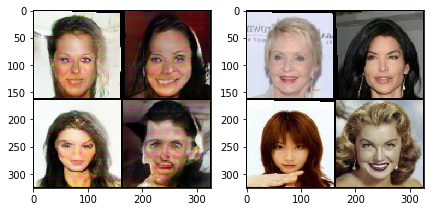

[4/5][2250/5332]	Disc/Dec Trains: 33.0/2251.0	Loss_D: 1.3633	Loss_Dec: 3.5007	Aux F1: 0.8538	Loss_Enc: 779.2020	D(x): 0.6245	D(G(z)): 0.2754
[4/5][2500/5332]	Disc/Dec Trains: 37.0/2501.0	Loss_D: 1.3635	Loss_Dec: 3.5007	Aux F1: 0.8538	Loss_Enc: 779.2201	D(x): 0.5387	D(G(z)): 0.2738
[4/5][2750/5332]	Disc/Dec Trains: 43.0/2751.0	Loss_D: 1.3616	Loss_Dec: 3.5006	Aux F1: 0.8538	Loss_Enc: 779.1478	D(x): 0.5144	D(G(z)): 0.2410
[4/5][3000/5332]	Disc/Dec Trains: 48.0/3001.0	Loss_D: 1.3612	Loss_Dec: 3.5007	Aux F1: 0.8539	Loss_Enc: 778.8752	D(x): 0.5375	D(G(z)): 0.2831
[4/5][3250/5332]	Disc/Dec Trains: 55.0/3251.0	Loss_D: 1.3591	Loss_Dec: 3.5003	Aux F1: 0.8539	Loss_Enc: 778.7654	D(x): 0.5614	D(G(z)): 0.2337
[4/5][3500/5332]	Disc/Dec Trains: 56.0/3501.0	Loss_D: 1.3566	Loss_Dec: 3.5009	Aux F1: 0.8539	Loss_Enc: 778.9328	D(x): 0.5281	D(G(z)): 0.2796
[4/5][3750/5332]	Disc/Dec Trains: 59.0/3751.0	Loss_D: 1.3538	Loss_Dec: 3.5020	Aux F1: 0.8540	Loss_Enc: 779.0646	D(x): 0.5733	D(G(z)): 0.3286
[4/5][4000/53

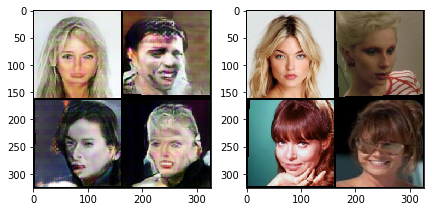

[4/5][4250/5332]	Disc/Dec Trains: 62.0/4251.0	Loss_D: 1.3515	Loss_Dec: 3.5036	Aux F1: 0.8539	Loss_Enc: 779.2314	D(x): 0.5377	D(G(z)): 0.2967
[4/5][4500/5332]	Disc/Dec Trains: 63.0/4501.0	Loss_D: 1.3508	Loss_Dec: 3.5044	Aux F1: 0.8539	Loss_Enc: 779.2039	D(x): 0.5196	D(G(z)): 0.3381
[4/5][4750/5332]	Disc/Dec Trains: 64.0/4751.0	Loss_D: 1.3507	Loss_Dec: 3.5035	Aux F1: 0.8540	Loss_Enc: 778.9153	D(x): 0.5264	D(G(z)): 0.2561
[4/5][5000/5332]	Disc/Dec Trains: 66.0/5001.0	Loss_D: 1.3514	Loss_Dec: 3.5028	Aux F1: 0.8540	Loss_Enc: 778.7689	D(x): 0.5300	D(G(z)): 0.3153
[4/5][5250/5332]	Disc/Dec Trains: 67.0/5251.0	Loss_D: 1.3521	Loss_Dec: 3.5015	Aux F1: 0.8540	Loss_Enc: 778.6122	D(x): 0.5632	D(G(z)): 0.2216


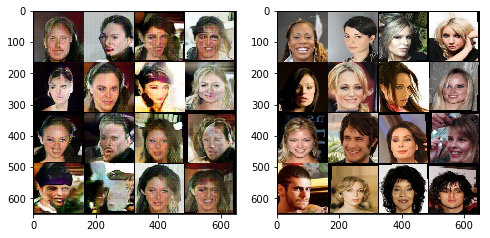

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.475, plot_images=2000)

[0/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.3613	Loss_Dec: 3.4695	Aux F1: 0.8447	Loss_Enc: 775.4957	D(x): 0.5397	D(G(z)): 0.2888
[0/3][250/5332]	Disc/Dec Trains: 14.0/251.0	Loss_D: 1.3287	Loss_Dec: 3.5129	Aux F1: 0.8535	Loss_Enc: 776.5344	D(x): 0.6016	D(G(z)): 0.2442
[0/3][500/5332]	Disc/Dec Trains: 30.0/501.0	Loss_D: 1.3100	Loss_Dec: 3.5351	Aux F1: 0.8541	Loss_Enc: 779.3922	D(x): 0.5422	D(G(z)): 0.2810
[0/3][750/5332]	Disc/Dec Trains: 42.0/751.0	Loss_D: 1.3015	Loss_Dec: 3.5499	Aux F1: 0.8540	Loss_Enc: 779.9890	D(x): 0.5525	D(G(z)): 0.2729
[0/3][1000/5332]	Disc/Dec Trains: 55.0/1001.0	Loss_D: 1.2893	Loss_Dec: 3.5678	Aux F1: 0.8541	Loss_Enc: 780.6829	D(x): 0.5452	D(G(z)): 0.2815
[0/3][1250/5332]	Disc/Dec Trains: 67.0/1251.0	Loss_D: 1.2769	Loss_Dec: 3.5856	Aux F1: 0.8541	Loss_Enc: 781.7299	D(x): 0.5350	D(G(z)): 0.2675
[0/3][1500/5332]	Disc/Dec Trains: 80.0/1501.0	Loss_D: 1.2650	Loss_Dec: 3.6033	Aux F1: 0.8541	Loss_Enc: 783.0659	D(x): 0.5203	D(G(z)): 0.2804
[0/3][1750/5332]	Disc/Dec 

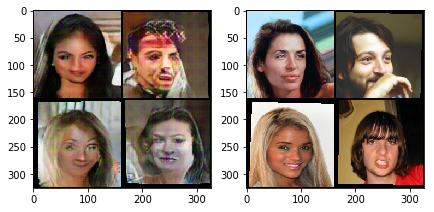

[0/3][2250/5332]	Disc/Dec Trains: 117.0/2251.0	Loss_D: 1.2393	Loss_Dec: 3.6451	Aux F1: 0.8543	Loss_Enc: 787.3063	D(x): 0.5835	D(G(z)): 0.2638
[0/3][2500/5332]	Disc/Dec Trains: 130.0/2501.0	Loss_D: 1.2321	Loss_Dec: 3.6578	Aux F1: 0.8541	Loss_Enc: 788.4338	D(x): 0.6113	D(G(z)): 0.2624
[0/3][2750/5332]	Disc/Dec Trains: 142.0/2751.0	Loss_D: 1.2254	Loss_Dec: 3.6693	Aux F1: 0.8539	Loss_Enc: 789.4130	D(x): 0.5485	D(G(z)): 0.2553
[0/3][3000/5332]	Disc/Dec Trains: 155.0/3001.0	Loss_D: 1.2199	Loss_Dec: 3.6793	Aux F1: 0.8539	Loss_Enc: 790.1126	D(x): 0.5566	D(G(z)): 0.2150
[0/3][3250/5332]	Disc/Dec Trains: 167.0/3251.0	Loss_D: 1.2135	Loss_Dec: 3.6904	Aux F1: 0.8539	Loss_Enc: 791.2835	D(x): 0.6056	D(G(z)): 0.2369
[0/3][3500/5332]	Disc/Dec Trains: 180.0/3501.0	Loss_D: 1.2087	Loss_Dec: 3.6998	Aux F1: 0.8539	Loss_Enc: 792.0910	D(x): 0.5635	D(G(z)): 0.2668
[0/3][3750/5332]	Disc/Dec Trains: 192.0/3751.0	Loss_D: 1.2039	Loss_Dec: 3.7087	Aux F1: 0.8538	Loss_Enc: 793.0744	D(x): 0.6091	D(G(z)): 0.2069
[0/3][

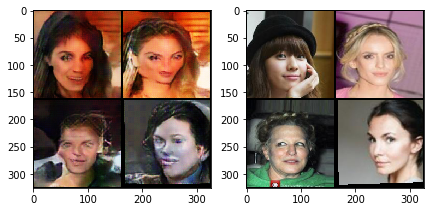

[0/3][4250/5332]	Disc/Dec Trains: 218.0/4251.0	Loss_D: 1.1946	Loss_Dec: 3.7270	Aux F1: 0.8536	Loss_Enc: 795.0533	D(x): 0.6639	D(G(z)): 0.2071
[0/3][4500/5332]	Disc/Dec Trains: 231.0/4501.0	Loss_D: 1.1901	Loss_Dec: 3.7358	Aux F1: 0.8536	Loss_Enc: 796.1161	D(x): 0.6317	D(G(z)): 0.2344
[0/3][4750/5332]	Disc/Dec Trains: 243.0/4751.0	Loss_D: 1.1858	Loss_Dec: 3.7436	Aux F1: 0.8535	Loss_Enc: 796.9101	D(x): 0.6298	D(G(z)): 0.1922
[0/3][5000/5332]	Disc/Dec Trains: 256.0/5001.0	Loss_D: 1.1821	Loss_Dec: 3.7515	Aux F1: 0.8535	Loss_Enc: 797.7786	D(x): 0.7003	D(G(z)): 0.2029
[0/3][5250/5332]	Disc/Dec Trains: 268.0/5251.0	Loss_D: 1.1782	Loss_Dec: 3.7599	Aux F1: 0.8534	Loss_Enc: 798.6700	D(x): 0.6219	D(G(z)): 0.2141


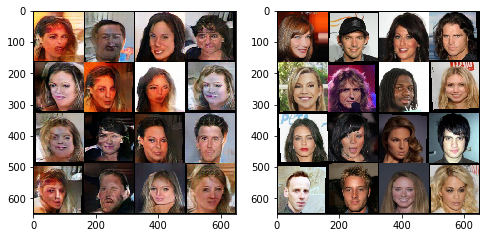

[1/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0290	Loss_Dec: 4.0857	Aux F1: 0.8500	Loss_Enc: 846.1256	D(x): 0.6278	D(G(z)): 0.2171
[1/3][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 1.0953	Loss_Dec: 3.9261	Aux F1: 0.8523	Loss_Enc: 814.1825	D(x): 0.6450	D(G(z)): 0.2543
[1/3][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 1.0887	Loss_Dec: 3.9338	Aux F1: 0.8524	Loss_Enc: 816.3532	D(x): 0.6190	D(G(z)): 0.1937
[1/3][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 1.0858	Loss_Dec: 3.9423	Aux F1: 0.8524	Loss_Enc: 817.4710	D(x): 0.6337	D(G(z)): 0.1957
[1/3][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 1.0874	Loss_Dec: 3.9442	Aux F1: 0.8525	Loss_Enc: 817.8702	D(x): 0.5890	D(G(z)): 0.2726
[1/3][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 1.0846	Loss_Dec: 3.9464	Aux F1: 0.8526	Loss_Enc: 818.2843	D(x): 0.6280	D(G(z)): 0.2242
[1/3][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 1.0818	Loss_Dec: 3.9478	Aux F1: 0.8525	Loss_Enc: 818.9556	D(x): 0.7021	D(G(z)): 0.2796
[1/3][1750/5332]	Disc/Dec 

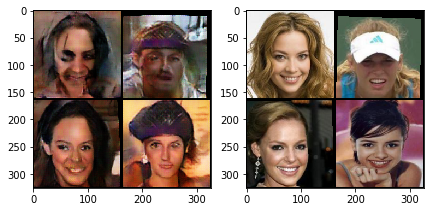

[1/3][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 1.0784	Loss_Dec: 3.9539	Aux F1: 0.8526	Loss_Enc: 820.7999	D(x): 0.5970	D(G(z)): 0.2461
[1/3][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 1.0772	Loss_Dec: 3.9564	Aux F1: 0.8525	Loss_Enc: 821.2805	D(x): 0.6591	D(G(z)): 0.1977
[1/3][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 1.0749	Loss_Dec: 3.9613	Aux F1: 0.8525	Loss_Enc: 821.8092	D(x): 0.6915	D(G(z)): 0.2194
[1/3][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 1.0733	Loss_Dec: 3.9663	Aux F1: 0.8525	Loss_Enc: 822.4960	D(x): 0.6314	D(G(z)): 0.2285
[1/3][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 1.0717	Loss_Dec: 3.9703	Aux F1: 0.8525	Loss_Enc: 822.9333	D(x): 0.6393	D(G(z)): 0.2279
[1/3][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 1.0704	Loss_Dec: 3.9733	Aux F1: 0.8525	Loss_Enc: 823.4926	D(x): 0.6359	D(G(z)): 0.2575
[1/3][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 1.0699	Loss_Dec: 3.9756	Aux F1: 0.8525	Loss_Enc: 823.9038	D(x): 0.5963	D(G(z)): 0.2277
[1/3][

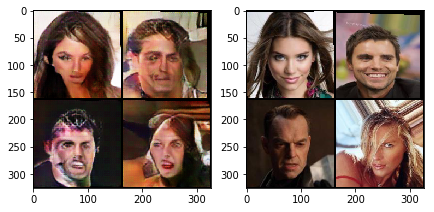

[1/3][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 1.0673	Loss_Dec: 3.9815	Aux F1: 0.8526	Loss_Enc: 824.6947	D(x): 0.6948	D(G(z)): 0.2126
[1/3][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 1.0663	Loss_Dec: 3.9846	Aux F1: 0.8525	Loss_Enc: 825.0473	D(x): 0.6775	D(G(z)): 0.1960
[1/3][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 1.0657	Loss_Dec: 3.9870	Aux F1: 0.8525	Loss_Enc: 825.3015	D(x): 0.6346	D(G(z)): 0.2277
[1/3][5000/5332]	Disc/Dec Trains: 253.0/5001.0	Loss_D: 1.0651	Loss_Dec: 3.9893	Aux F1: 0.8524	Loss_Enc: 825.4613	D(x): 0.6754	D(G(z)): 0.2080
[1/3][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 1.0644	Loss_Dec: 3.9912	Aux F1: 0.8524	Loss_Enc: 825.8018	D(x): 0.6679	D(G(z)): 0.2124


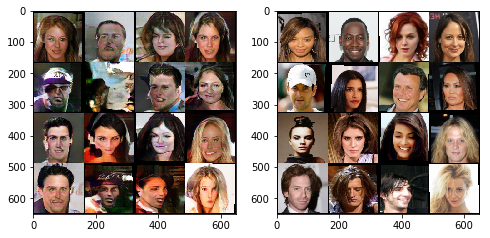

[2/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0361	Loss_Dec: 3.9921	Aux F1: 0.8539	Loss_Enc: 847.7510	D(x): 0.6404	D(G(z)): 0.2248
[2/3][250/5332]	Disc/Dec Trains: 14.0/251.0	Loss_D: 1.0251	Loss_Dec: 4.0416	Aux F1: 0.8524	Loss_Enc: 840.1368	D(x): 0.6387	D(G(z)): 0.2026
[2/3][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 1.0309	Loss_Dec: 4.0423	Aux F1: 0.8522	Loss_Enc: 839.1668	D(x): 0.6751	D(G(z)): 0.1869
[2/3][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 1.0286	Loss_Dec: 4.0464	Aux F1: 0.8522	Loss_Enc: 839.2340	D(x): 0.6516	D(G(z)): 0.2323
[2/3][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 1.0280	Loss_Dec: 4.0483	Aux F1: 0.8520	Loss_Enc: 840.2381	D(x): 0.6537	D(G(z)): 0.2162
[2/3][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 1.0291	Loss_Dec: 4.0485	Aux F1: 0.8520	Loss_Enc: 840.7610	D(x): 0.5996	D(G(z)): 0.2046


In [0]:
train(net, n_epochs=3, train_loader=train_loader, margin=0.475, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0378	Loss_Dec: 4.0946	Aux F1: 0.8461	Loss_Enc: 855.7686	D(x): 0.6196	D(G(z)): 0.2220
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 1.0149	Loss_Dec: 4.1009	Aux F1: 0.8528	Loss_Enc: 844.6589	D(x): 0.6658	D(G(z)): 0.1884
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 1.0118	Loss_Dec: 4.1055	Aux F1: 0.8524	Loss_Enc: 845.4411	D(x): 0.6805	D(G(z)): 0.2270
[0/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 1.0159	Loss_Dec: 4.1018	Aux F1: 0.8522	Loss_Enc: 845.3419	D(x): 0.6365	D(G(z)): 0.2308
[0/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 1.0117	Loss_Dec: 4.1069	Aux F1: 0.8522	Loss_Enc: 846.3785	D(x): 0.6960	D(G(z)): 0.2026
[0/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 1.0104	Loss_Dec: 4.1098	Aux F1: 0.8521	Loss_Enc: 847.3817	D(x): 0.5765	D(G(z)): 0.2150
[0/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 1.0088	Loss_Dec: 4.1101	Aux F1: 0.8521	Loss_Enc: 847.7131	D(x): 0.6711	D(G(z)): 0.2133
[0/5][1750/5332]	Disc/Dec 

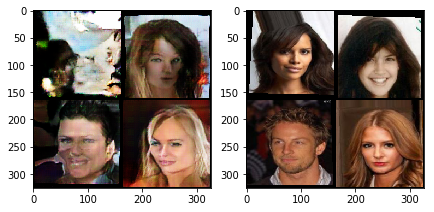

[0/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 1.0089	Loss_Dec: 4.1112	Aux F1: 0.8520	Loss_Enc: 848.7430	D(x): 0.5782	D(G(z)): 0.2243
[0/5][2500/5332]	Disc/Dec Trains: 129.0/2501.0	Loss_D: 1.0085	Loss_Dec: 4.1113	Aux F1: 0.8519	Loss_Enc: 848.9238	D(x): 0.6524	D(G(z)): 0.2348
[0/5][2750/5332]	Disc/Dec Trains: 141.0/2751.0	Loss_D: 1.0080	Loss_Dec: 4.1131	Aux F1: 0.8519	Loss_Enc: 849.2440	D(x): 0.6081	D(G(z)): 0.2439
[0/5][3000/5332]	Disc/Dec Trains: 154.0/3001.0	Loss_D: 1.0078	Loss_Dec: 4.1141	Aux F1: 0.8520	Loss_Enc: 849.4403	D(x): 0.6072	D(G(z)): 0.2181
[0/5][3250/5332]	Disc/Dec Trains: 166.0/3251.0	Loss_D: 1.0074	Loss_Dec: 4.1167	Aux F1: 0.8520	Loss_Enc: 849.8439	D(x): 0.6292	D(G(z)): 0.2477
[0/5][3500/5332]	Disc/Dec Trains: 179.0/3501.0	Loss_D: 1.0073	Loss_Dec: 4.1166	Aux F1: 0.8519	Loss_Enc: 850.0600	D(x): 0.6826	D(G(z)): 0.1980
[0/5][3750/5332]	Disc/Dec Trains: 192.0/3751.0	Loss_D: 1.0068	Loss_Dec: 4.1172	Aux F1: 0.8519	Loss_Enc: 850.4655	D(x): 0.6796	D(G(z)): 0.2142
[0/5][

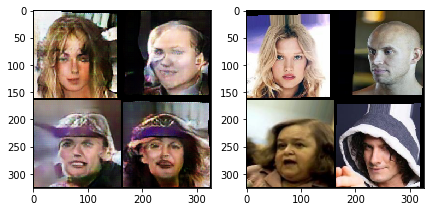

[0/5][4250/5332]	Disc/Dec Trains: 217.0/4251.0	Loss_D: 1.0058	Loss_Dec: 4.1201	Aux F1: 0.8518	Loss_Enc: 850.9059	D(x): 0.7048	D(G(z)): 0.1904
[0/5][4500/5332]	Disc/Dec Trains: 230.0/4501.0	Loss_D: 1.0059	Loss_Dec: 4.1222	Aux F1: 0.8518	Loss_Enc: 851.1861	D(x): 0.6433	D(G(z)): 0.2566
[0/5][4750/5332]	Disc/Dec Trains: 242.0/4751.0	Loss_D: 1.0051	Loss_Dec: 4.1254	Aux F1: 0.8519	Loss_Enc: 851.4698	D(x): 0.6694	D(G(z)): 0.2266
[0/5][5000/5332]	Disc/Dec Trains: 255.0/5001.0	Loss_D: 1.0053	Loss_Dec: 4.1270	Aux F1: 0.8518	Loss_Enc: 851.5314	D(x): 0.6322	D(G(z)): 0.1899
[0/5][5250/5332]	Disc/Dec Trains: 267.0/5251.0	Loss_D: 1.0054	Loss_Dec: 4.1278	Aux F1: 0.8518	Loss_Enc: 851.4911	D(x): 0.6441	D(G(z)): 0.2567


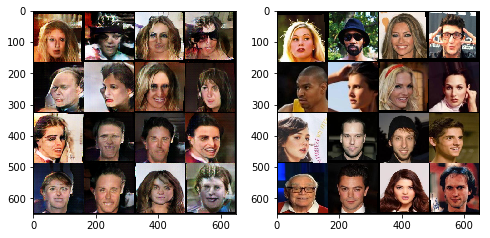

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0380	Loss_Dec: 4.0609	Aux F1: 0.8493	Loss_Enc: 833.4391	D(x): 0.6813	D(G(z)): 0.2417
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 1.0012	Loss_Dec: 4.1611	Aux F1: 0.8490	Loss_Enc: 855.2558	D(x): 0.6359	D(G(z)): 0.2932
[1/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 1.0092	Loss_Dec: 4.1583	Aux F1: 0.8503	Loss_Enc: 852.9912	D(x): 0.6255	D(G(z)): 0.2569
[1/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 1.0072	Loss_Dec: 4.1624	Aux F1: 0.8509	Loss_Enc: 853.6842	D(x): 0.6692	D(G(z)): 0.2227
[1/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 1.0055	Loss_Dec: 4.1621	Aux F1: 0.8512	Loss_Enc: 853.9223	D(x): 0.6717	D(G(z)): 0.2202
[1/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 1.0050	Loss_Dec: 4.1626	Aux F1: 0.8512	Loss_Enc: 853.6051	D(x): 0.7035	D(G(z)): 0.1936
[1/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 1.0043	Loss_Dec: 4.1641	Aux F1: 0.8512	Loss_Enc: 853.6243	D(x): 0.6989	D(G(z)): 0.2042
[1/5][1750/5332]	Disc/Dec 

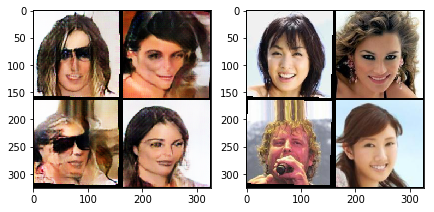

[1/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 1.0009	Loss_Dec: 4.1675	Aux F1: 0.8512	Loss_Enc: 852.6309	D(x): 0.7199	D(G(z)): 0.2031
[1/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.9991	Loss_Dec: 4.1701	Aux F1: 0.8513	Loss_Enc: 853.1451	D(x): 0.6649	D(G(z)): 0.1580
[1/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.9998	Loss_Dec: 4.1707	Aux F1: 0.8514	Loss_Enc: 853.1563	D(x): 0.6402	D(G(z)): 0.2041
[1/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.9994	Loss_Dec: 4.1711	Aux F1: 0.8513	Loss_Enc: 852.8986	D(x): 0.6941	D(G(z)): 0.2213
[1/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.9984	Loss_Dec: 4.1731	Aux F1: 0.8513	Loss_Enc: 853.1513	D(x): 0.6110	D(G(z)): 0.2644
[1/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.9982	Loss_Dec: 4.1735	Aux F1: 0.8513	Loss_Enc: 853.0642	D(x): 0.6283	D(G(z)): 0.2267
[1/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.9982	Loss_Dec: 4.1740	Aux F1: 0.8514	Loss_Enc: 852.9471	D(x): 0.6602	D(G(z)): 0.2622
[1/5][

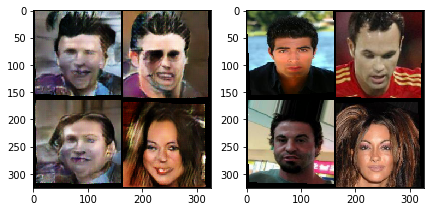

[1/5][4250/5332]	Disc/Dec Trains: 215.0/4251.0	Loss_D: 0.9967	Loss_Dec: 4.1745	Aux F1: 0.8514	Loss_Enc: 852.9970	D(x): 0.7009	D(G(z)): 0.1927
[1/5][4500/5332]	Disc/Dec Trains: 228.0/4501.0	Loss_D: 0.9966	Loss_Dec: 4.1737	Aux F1: 0.8514	Loss_Enc: 852.9112	D(x): 0.6383	D(G(z)): 0.2297
[1/5][4750/5332]	Disc/Dec Trains: 240.0/4751.0	Loss_D: 0.9958	Loss_Dec: 4.1745	Aux F1: 0.8514	Loss_Enc: 853.0212	D(x): 0.6662	D(G(z)): 0.2398
[1/5][5000/5332]	Disc/Dec Trains: 253.0/5001.0	Loss_D: 0.9955	Loss_Dec: 4.1748	Aux F1: 0.8514	Loss_Enc: 853.0376	D(x): 0.6673	D(G(z)): 0.2181
[1/5][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 0.9947	Loss_Dec: 4.1765	Aux F1: 0.8514	Loss_Enc: 853.2397	D(x): 0.6211	D(G(z)): 0.2382


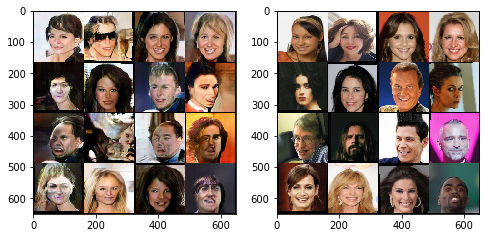

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9344	Loss_Dec: 4.3117	Aux F1: 0.8395	Loss_Enc: 872.8667	D(x): 0.6651	D(G(z)): 0.1711
[2/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9826	Loss_Dec: 4.1975	Aux F1: 0.8506	Loss_Enc: 853.7420	D(x): 0.6609	D(G(z)): 0.2744
[2/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.9851	Loss_Dec: 4.1987	Aux F1: 0.8511	Loss_Enc: 855.6082	D(x): 0.7149	D(G(z)): 0.2414
[2/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.9854	Loss_Dec: 4.1927	Aux F1: 0.8510	Loss_Enc: 855.6560	D(x): 0.6842	D(G(z)): 0.1972
[2/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.9859	Loss_Dec: 4.1917	Aux F1: 0.8512	Loss_Enc: 856.1191	D(x): 0.6594	D(G(z)): 0.2329
[2/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.9869	Loss_Dec: 4.1909	Aux F1: 0.8513	Loss_Enc: 855.9414	D(x): 0.6955	D(G(z)): 0.2548
[2/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.9862	Loss_Dec: 4.1941	Aux F1: 0.8512	Loss_Enc: 856.2111	D(x): 0.6031	D(G(z)): 0.2703
[2/5][1750/5332]	Disc/Dec 

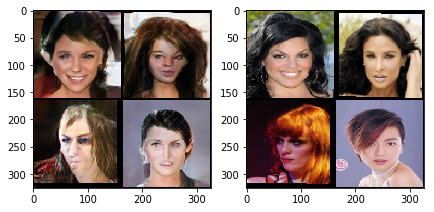

[2/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.9857	Loss_Dec: 4.1928	Aux F1: 0.8513	Loss_Enc: 856.4945	D(x): 0.6227	D(G(z)): 0.1938
[2/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.9863	Loss_Dec: 4.1925	Aux F1: 0.8513	Loss_Enc: 856.3377	D(x): 0.6555	D(G(z)): 0.2494
[2/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.9859	Loss_Dec: 4.1936	Aux F1: 0.8513	Loss_Enc: 856.7261	D(x): 0.6558	D(G(z)): 0.2170
[2/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.9864	Loss_Dec: 4.1923	Aux F1: 0.8513	Loss_Enc: 856.8209	D(x): 0.7088	D(G(z)): 0.1955
[2/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.9862	Loss_Dec: 4.1913	Aux F1: 0.8512	Loss_Enc: 857.0038	D(x): 0.6249	D(G(z)): 0.2056
[2/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.9865	Loss_Dec: 4.1908	Aux F1: 0.8513	Loss_Enc: 857.1047	D(x): 0.6633	D(G(z)): 0.2895
[2/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.9863	Loss_Dec: 4.1918	Aux F1: 0.8513	Loss_Enc: 857.3105	D(x): 0.6480	D(G(z)): 0.2044
[2/5][

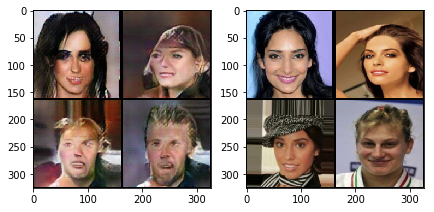

[2/5][4250/5332]	Disc/Dec Trains: 215.0/4251.0	Loss_D: 0.9865	Loss_Dec: 4.1919	Aux F1: 0.8513	Loss_Enc: 857.4188	D(x): 0.6806	D(G(z)): 0.2265
[2/5][4500/5332]	Disc/Dec Trains: 229.0/4501.0	Loss_D: 0.9861	Loss_Dec: 4.1928	Aux F1: 0.8513	Loss_Enc: 857.7398	D(x): 0.7066	D(G(z)): 0.2177
[2/5][4750/5332]	Disc/Dec Trains: 241.0/4751.0	Loss_D: 0.9855	Loss_Dec: 4.1944	Aux F1: 0.8513	Loss_Enc: 858.0644	D(x): 0.6907	D(G(z)): 0.2098
[2/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.9852	Loss_Dec: 4.1952	Aux F1: 0.8512	Loss_Enc: 858.2635	D(x): 0.6199	D(G(z)): 0.1938
[2/5][5250/5332]	Disc/Dec Trains: 267.0/5251.0	Loss_D: 0.9847	Loss_Dec: 4.1960	Aux F1: 0.8513	Loss_Enc: 858.4930	D(x): 0.6493	D(G(z)): 0.2437


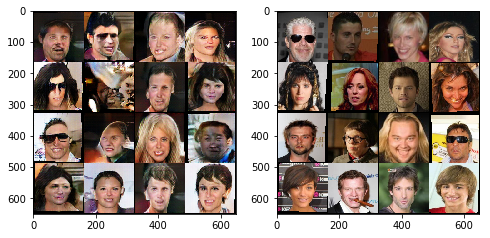

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9322	Loss_Dec: 4.3534	Aux F1: 0.8520	Loss_Enc: 901.7335	D(x): 0.6486	D(G(z)): 0.1855
[3/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9737	Loss_Dec: 4.2144	Aux F1: 0.8515	Loss_Enc: 864.3182	D(x): 0.6315	D(G(z)): 0.2470
[3/5][500/5332]	Disc/Dec Trains: 28.0/501.0	Loss_D: 0.9696	Loss_Dec: 4.2276	Aux F1: 0.8513	Loss_Enc: 863.9327	D(x): 0.6762	D(G(z)): 0.2353
[3/5][750/5332]	Disc/Dec Trains: 40.0/751.0	Loss_D: 0.9686	Loss_Dec: 4.2350	Aux F1: 0.8513	Loss_Enc: 864.4727	D(x): 0.6790	D(G(z)): 0.2175
[3/5][1000/5332]	Disc/Dec Trains: 53.0/1001.0	Loss_D: 0.9674	Loss_Dec: 4.2383	Aux F1: 0.8511	Loss_Enc: 865.2016	D(x): 0.6810	D(G(z)): 0.2276
[3/5][1250/5332]	Disc/Dec Trains: 65.0/1251.0	Loss_D: 0.9677	Loss_Dec: 4.2371	Aux F1: 0.8511	Loss_Enc: 865.2604	D(x): 0.7133	D(G(z)): 0.2399
[3/5][1500/5332]	Disc/Dec Trains: 78.0/1501.0	Loss_D: 0.9679	Loss_Dec: 4.2374	Aux F1: 0.8511	Loss_Enc: 865.5550	D(x): 0.7032	D(G(z)): 0.2132
[3/5][1750/5332]	Disc/Dec 

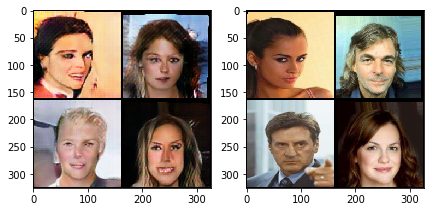

[3/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 0.9638	Loss_Dec: 4.2406	Aux F1: 0.8511	Loss_Enc: 865.9789	D(x): 0.6588	D(G(z)): 0.2346
[3/5][2500/5332]	Disc/Dec Trains: 128.0/2501.0	Loss_D: 0.9633	Loss_Dec: 4.2423	Aux F1: 0.8510	Loss_Enc: 866.1457	D(x): 0.6323	D(G(z)): 0.2226
[3/5][2750/5332]	Disc/Dec Trains: 141.0/2751.0	Loss_D: 0.9618	Loss_Dec: 4.2449	Aux F1: 0.8511	Loss_Enc: 866.4348	D(x): 0.6829	D(G(z)): 0.2157
[3/5][3000/5332]	Disc/Dec Trains: 154.0/3001.0	Loss_D: 0.9598	Loss_Dec: 4.2472	Aux F1: 0.8510	Loss_Enc: 866.7954	D(x): 0.6935	D(G(z)): 0.2172
[3/5][3250/5332]	Disc/Dec Trains: 166.0/3251.0	Loss_D: 0.9584	Loss_Dec: 4.2505	Aux F1: 0.8510	Loss_Enc: 867.0947	D(x): 0.6928	D(G(z)): 0.1872
[3/5][3500/5332]	Disc/Dec Trains: 179.0/3501.0	Loss_D: 0.9575	Loss_Dec: 4.2525	Aux F1: 0.8510	Loss_Enc: 867.3756	D(x): 0.6919	D(G(z)): 0.2185
[3/5][3750/5332]	Disc/Dec Trains: 191.0/3751.0	Loss_D: 0.9563	Loss_Dec: 4.2557	Aux F1: 0.8510	Loss_Enc: 867.4993	D(x): 0.6659	D(G(z)): 0.2050
[3/5][

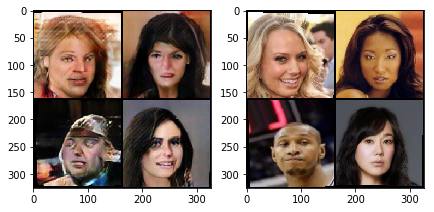

[3/5][4250/5332]	Disc/Dec Trains: 216.0/4251.0	Loss_D: 0.9534	Loss_Dec: 4.2620	Aux F1: 0.8510	Loss_Enc: 867.9809	D(x): 0.6451	D(G(z)): 0.2187
[3/5][4500/5332]	Disc/Dec Trains: 229.0/4501.0	Loss_D: 0.9535	Loss_Dec: 4.2631	Aux F1: 0.8510	Loss_Enc: 868.0434	D(x): 0.6669	D(G(z)): 0.1980
[3/5][4750/5332]	Disc/Dec Trains: 241.0/4751.0	Loss_D: 0.9526	Loss_Dec: 4.2659	Aux F1: 0.8510	Loss_Enc: 868.2772	D(x): 0.6908	D(G(z)): 0.2382
[3/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.9520	Loss_Dec: 4.2692	Aux F1: 0.8510	Loss_Enc: 868.5520	D(x): 0.6790	D(G(z)): 0.2393
[3/5][5250/5332]	Disc/Dec Trains: 266.0/5251.0	Loss_D: 0.9514	Loss_Dec: 4.2719	Aux F1: 0.8510	Loss_Enc: 868.7490	D(x): 0.7049	D(G(z)): 0.2191


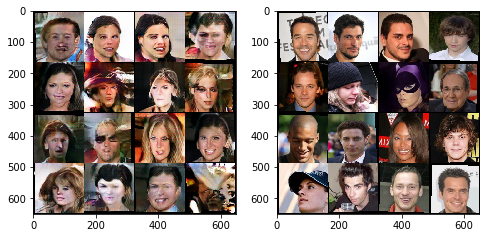

[4/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.8394	Loss_Dec: 4.4700	Aux F1: 0.8474	Loss_Enc: 852.9911	D(x): 0.7228	D(G(z)): 0.2313
[4/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9460	Loss_Dec: 4.3271	Aux F1: 0.8500	Loss_Enc: 873.5240	D(x): 0.6663	D(G(z)): 0.2202
[4/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.9440	Loss_Dec: 4.3221	Aux F1: 0.8507	Loss_Enc: 871.8734	D(x): 0.7172	D(G(z)): 0.2042
[4/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9395	Loss_Dec: 4.3318	Aux F1: 0.8502	Loss_Enc: 873.3562	D(x): 0.6391	D(G(z)): 0.2140
[4/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.9410	Loss_Dec: 4.3288	Aux F1: 0.8505	Loss_Enc: 872.8351	D(x): 0.6860	D(G(z)): 0.1615
[4/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.9385	Loss_Dec: 4.3291	Aux F1: 0.8505	Loss_Enc: 873.2318	D(x): 0.6709	D(G(z)): 0.2169
[4/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.9374	Loss_Dec: 4.3310	Aux F1: 0.8504	Loss_Enc: 873.0933	D(x): 0.6906	D(G(z)): 0.2459
[4/5][1750/5332]	Disc/Dec 

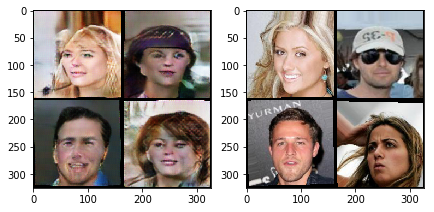

[4/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 0.9357	Loss_Dec: 4.3342	Aux F1: 0.8505	Loss_Enc: 873.0834	D(x): 0.6601	D(G(z)): 0.2361
[4/5][2500/5332]	Disc/Dec Trains: 128.0/2501.0	Loss_D: 0.9364	Loss_Dec: 4.3377	Aux F1: 0.8506	Loss_Enc: 873.4088	D(x): 0.6974	D(G(z)): 0.1985
[4/5][2750/5332]	Disc/Dec Trains: 140.0/2751.0	Loss_D: 0.9359	Loss_Dec: 4.3391	Aux F1: 0.8506	Loss_Enc: 873.2917	D(x): 0.7579	D(G(z)): 0.2220
[4/5][3000/5332]	Disc/Dec Trains: 153.0/3001.0	Loss_D: 0.9353	Loss_Dec: 4.3413	Aux F1: 0.8507	Loss_Enc: 873.2099	D(x): 0.6413	D(G(z)): 0.2211
[4/5][3250/5332]	Disc/Dec Trains: 165.0/3251.0	Loss_D: 0.9346	Loss_Dec: 4.3445	Aux F1: 0.8507	Loss_Enc: 873.4027	D(x): 0.7146	D(G(z)): 0.2274
[4/5][3500/5332]	Disc/Dec Trains: 178.0/3501.0	Loss_D: 0.9344	Loss_Dec: 4.3482	Aux F1: 0.8508	Loss_Enc: 873.5379	D(x): 0.7228	D(G(z)): 0.2006
[4/5][3750/5332]	Disc/Dec Trains: 190.0/3751.0	Loss_D: 0.9337	Loss_Dec: 4.3506	Aux F1: 0.8508	Loss_Enc: 873.8327	D(x): 0.7570	D(G(z)): 0.1985
[4/5][

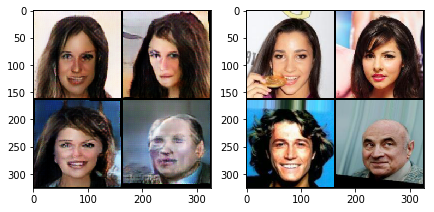

[4/5][4250/5332]	Disc/Dec Trains: 215.0/4251.0	Loss_D: 0.9334	Loss_Dec: 4.3541	Aux F1: 0.8508	Loss_Enc: 874.1275	D(x): 0.6948	D(G(z)): 0.1889
[4/5][4500/5332]	Disc/Dec Trains: 228.0/4501.0	Loss_D: 0.9328	Loss_Dec: 4.3555	Aux F1: 0.8508	Loss_Enc: 874.1824	D(x): 0.6746	D(G(z)): 0.2416
[4/5][4750/5332]	Disc/Dec Trains: 240.0/4751.0	Loss_D: 0.9324	Loss_Dec: 4.3573	Aux F1: 0.8508	Loss_Enc: 874.1802	D(x): 0.7188	D(G(z)): 0.1960
[4/5][5000/5332]	Disc/Dec Trains: 253.0/5001.0	Loss_D: 0.9321	Loss_Dec: 4.3589	Aux F1: 0.8507	Loss_Enc: 874.3729	D(x): 0.6336	D(G(z)): 0.1850
[4/5][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 0.9323	Loss_Dec: 4.3598	Aux F1: 0.8508	Loss_Enc: 874.5164	D(x): 0.7240	D(G(z)): 0.1685


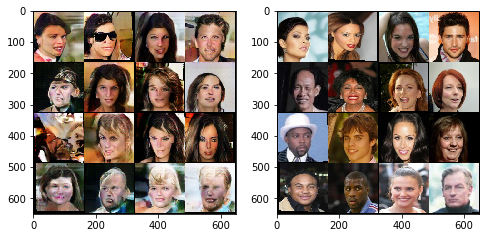

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.4725, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9932	Loss_Dec: 4.2934	Aux F1: 0.8533	Loss_Enc: 840.7433	D(x): 0.6587	D(G(z)): 0.2267
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9334	Loss_Dec: 4.3791	Aux F1: 0.8523	Loss_Enc: 877.5536	D(x): 0.6461	D(G(z)): 0.2370
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.9293	Loss_Dec: 4.3808	Aux F1: 0.8515	Loss_Enc: 877.4900	D(x): 0.6354	D(G(z)): 0.2135
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9254	Loss_Dec: 4.3911	Aux F1: 0.8514	Loss_Enc: 878.3491	D(x): 0.7193	D(G(z)): 0.2295
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.9264	Loss_Dec: 4.3956	Aux F1: 0.8511	Loss_Enc: 879.1930	D(x): 0.6513	D(G(z)): 0.1849
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.9266	Loss_Dec: 4.4000	Aux F1: 0.8510	Loss_Enc: 879.3771	D(x): 0.7024	D(G(z)): 0.1962
[0/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.9262	Loss_Dec: 4.4008	Aux F1: 0.8508	Loss_Enc: 879.0218	D(x): 0.7382	D(G(z)): 0.1995
[0/5][1750/5332]	Disc/Dec 

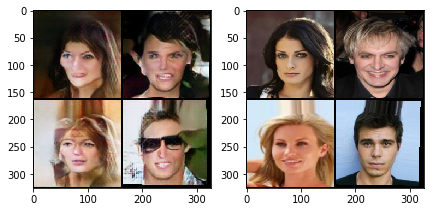

[0/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.9288	Loss_Dec: 4.3971	Aux F1: 0.8508	Loss_Enc: 878.4976	D(x): 0.7453	D(G(z)): 0.1917
[0/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.9289	Loss_Dec: 4.3970	Aux F1: 0.8508	Loss_Enc: 878.6436	D(x): 0.6877	D(G(z)): 0.1991
[0/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.9294	Loss_Dec: 4.3966	Aux F1: 0.8508	Loss_Enc: 878.5969	D(x): 0.7219	D(G(z)): 0.2615
[0/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.9303	Loss_Dec: 4.3964	Aux F1: 0.8508	Loss_Enc: 878.7133	D(x): 0.6319	D(G(z)): 0.2284
[0/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.9304	Loss_Dec: 4.3988	Aux F1: 0.8508	Loss_Enc: 879.2984	D(x): 0.7141	D(G(z)): 0.2198
[0/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.9303	Loss_Dec: 4.3998	Aux F1: 0.8508	Loss_Enc: 879.5673	D(x): 0.7139	D(G(z)): 0.2105
[0/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.9304	Loss_Dec: 4.3999	Aux F1: 0.8507	Loss_Enc: 879.7212	D(x): 0.6642	D(G(z)): 0.1933
[0/5][

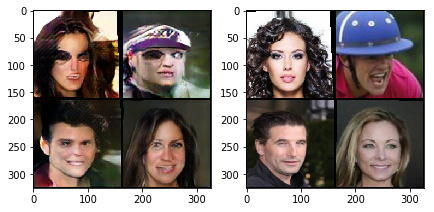

[0/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.9311	Loss_Dec: 4.4003	Aux F1: 0.8508	Loss_Enc: 880.0940	D(x): 0.7405	D(G(z)): 0.2123
[0/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.9309	Loss_Dec: 4.4008	Aux F1: 0.8507	Loss_Enc: 880.1907	D(x): 0.6561	D(G(z)): 0.2678
[0/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.9317	Loss_Dec: 4.4008	Aux F1: 0.8507	Loss_Enc: 880.4533	D(x): 0.6090	D(G(z)): 0.2679
[0/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.9319	Loss_Dec: 4.4011	Aux F1: 0.8507	Loss_Enc: 880.7669	D(x): 0.6632	D(G(z)): 0.2570
[0/5][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 0.9324	Loss_Dec: 4.4009	Aux F1: 0.8508	Loss_Enc: 881.0356	D(x): 0.6939	D(G(z)): 0.2522


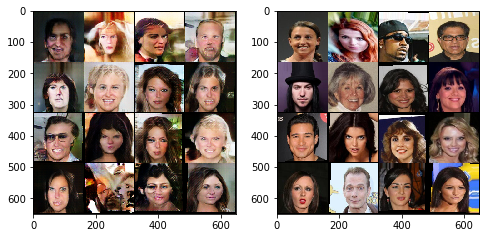

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9749	Loss_Dec: 4.3090	Aux F1: 0.8500	Loss_Enc: 815.3840	D(x): 0.6779	D(G(z)): 0.2464
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9404	Loss_Dec: 4.3887	Aux F1: 0.8510	Loss_Enc: 883.0868	D(x): 0.7018	D(G(z)): 0.2125
[1/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.9413	Loss_Dec: 4.3902	Aux F1: 0.8514	Loss_Enc: 884.2841	D(x): 0.6444	D(G(z)): 0.2465
[1/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9422	Loss_Dec: 4.3918	Aux F1: 0.8513	Loss_Enc: 883.9274	D(x): 0.6664	D(G(z)): 0.2155
[1/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.9428	Loss_Dec: 4.3926	Aux F1: 0.8511	Loss_Enc: 884.6349	D(x): 0.6971	D(G(z)): 0.2244
[1/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.9419	Loss_Dec: 4.3952	Aux F1: 0.8511	Loss_Enc: 885.6867	D(x): 0.7524	D(G(z)): 0.2332
[1/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.9425	Loss_Dec: 4.3970	Aux F1: 0.8512	Loss_Enc: 885.8730	D(x): 0.6982	D(G(z)): 0.2245
[1/5][1750/5332]	Disc/Dec 

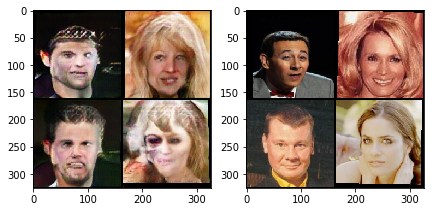

[1/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.9469	Loss_Dec: 4.3934	Aux F1: 0.8511	Loss_Enc: 886.0630	D(x): 0.7316	D(G(z)): 0.2603
[1/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.9471	Loss_Dec: 4.3929	Aux F1: 0.8510	Loss_Enc: 886.0844	D(x): 0.6556	D(G(z)): 0.2292
[1/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.9476	Loss_Dec: 4.3921	Aux F1: 0.8510	Loss_Enc: 886.2131	D(x): 0.6801	D(G(z)): 0.2143
[1/5][3000/5332]	Disc/Dec Trains: 153.0/3001.0	Loss_D: 0.9479	Loss_Dec: 4.3914	Aux F1: 0.8511	Loss_Enc: 886.6970	D(x): 0.7012	D(G(z)): 0.2215
[1/5][3250/5332]	Disc/Dec Trains: 165.0/3251.0	Loss_D: 0.9481	Loss_Dec: 4.3913	Aux F1: 0.8511	Loss_Enc: 887.0268	D(x): 0.6215	D(G(z)): 0.2003
[1/5][3500/5332]	Disc/Dec Trains: 178.0/3501.0	Loss_D: 0.9493	Loss_Dec: 4.3894	Aux F1: 0.8511	Loss_Enc: 887.0199	D(x): 0.7331	D(G(z)): 0.2226
[1/5][3750/5332]	Disc/Dec Trains: 191.0/3751.0	Loss_D: 0.9499	Loss_Dec: 4.3893	Aux F1: 0.8511	Loss_Enc: 887.1728	D(x): 0.7300	D(G(z)): 0.1990
[1/5][

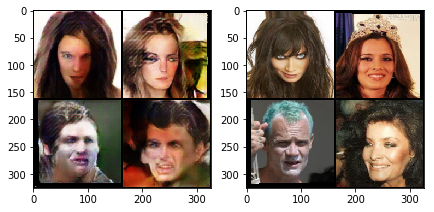

[1/5][4250/5332]	Disc/Dec Trains: 216.0/4251.0	Loss_D: 0.9511	Loss_Dec: 4.3894	Aux F1: 0.8510	Loss_Enc: 887.6993	D(x): 0.6592	D(G(z)): 0.2373
[1/5][4500/5332]	Disc/Dec Trains: 230.0/4501.0	Loss_D: 0.9515	Loss_Dec: 4.3898	Aux F1: 0.8510	Loss_Enc: 887.8999	D(x): 0.7081	D(G(z)): 0.2005
[1/5][4750/5332]	Disc/Dec Trains: 242.0/4751.0	Loss_D: 0.9518	Loss_Dec: 4.3904	Aux F1: 0.8511	Loss_Enc: 888.1010	D(x): 0.6839	D(G(z)): 0.2260
[1/5][5000/5332]	Disc/Dec Trains: 256.0/5001.0	Loss_D: 0.9523	Loss_Dec: 4.3909	Aux F1: 0.8511	Loss_Enc: 888.1459	D(x): 0.6582	D(G(z)): 0.2410
[1/5][5250/5332]	Disc/Dec Trains: 268.0/5251.0	Loss_D: 0.9528	Loss_Dec: 4.3919	Aux F1: 0.8511	Loss_Enc: 888.2643	D(x): 0.6867	D(G(z)): 0.2073


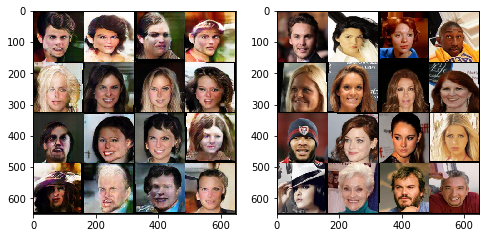

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9650	Loss_Dec: 4.5705	Aux F1: 0.8454	Loss_Enc: 902.5812	D(x): 0.6705	D(G(z)): 0.1976
[2/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9524	Loss_Dec: 4.4171	Aux F1: 0.8522	Loss_Enc: 891.8924	D(x): 0.6389	D(G(z)): 0.2024
[2/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.9541	Loss_Dec: 4.4217	Aux F1: 0.8516	Loss_Enc: 892.8607	D(x): 0.6673	D(G(z)): 0.2454
[2/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9543	Loss_Dec: 4.4157	Aux F1: 0.8513	Loss_Enc: 892.9954	D(x): 0.6669	D(G(z)): 0.2053
[2/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.9567	Loss_Dec: 4.4114	Aux F1: 0.8512	Loss_Enc: 892.2704	D(x): 0.6566	D(G(z)): 0.2469
[2/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.9595	Loss_Dec: 4.4063	Aux F1: 0.8512	Loss_Enc: 891.5371	D(x): 0.6139	D(G(z)): 0.2293
[2/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.9583	Loss_Dec: 4.4045	Aux F1: 0.8511	Loss_Enc: 891.7593	D(x): 0.6639	D(G(z)): 0.2254
[2/5][1750/5332]	Disc/Dec 

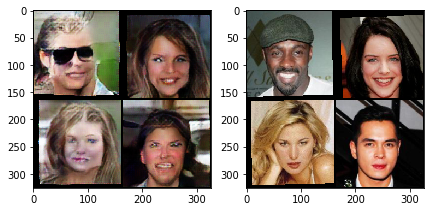

[2/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.9582	Loss_Dec: 4.4059	Aux F1: 0.8511	Loss_Enc: 891.6447	D(x): 0.7085	D(G(z)): 0.2097
[2/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.9587	Loss_Dec: 4.4056	Aux F1: 0.8510	Loss_Enc: 891.7293	D(x): 0.6965	D(G(z)): 0.2281
[2/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.9589	Loss_Dec: 4.4055	Aux F1: 0.8510	Loss_Enc: 891.6457	D(x): 0.6384	D(G(z)): 0.2441
[2/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.9583	Loss_Dec: 4.4053	Aux F1: 0.8510	Loss_Enc: 891.6791	D(x): 0.7419	D(G(z)): 0.1749
[2/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.9573	Loss_Dec: 4.4063	Aux F1: 0.8510	Loss_Enc: 891.9061	D(x): 0.7080	D(G(z)): 0.1900
[2/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.9563	Loss_Dec: 4.4060	Aux F1: 0.8511	Loss_Enc: 892.1478	D(x): 0.6527	D(G(z)): 0.2199
[2/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.9559	Loss_Dec: 4.4060	Aux F1: 0.8512	Loss_Enc: 892.3248	D(x): 0.6456	D(G(z)): 0.3123
[2/5][

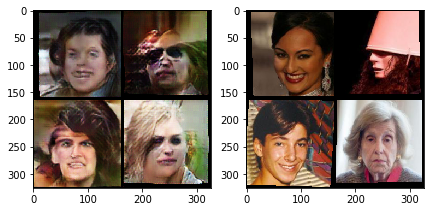

[2/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.9563	Loss_Dec: 4.4028	Aux F1: 0.8511	Loss_Enc: 892.5238	D(x): 0.7034	D(G(z)): 0.2421
[2/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.9553	Loss_Dec: 4.4031	Aux F1: 0.8511	Loss_Enc: 892.8412	D(x): 0.6820	D(G(z)): 0.1981
[2/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.9559	Loss_Dec: 4.4030	Aux F1: 0.8511	Loss_Enc: 893.0092	D(x): 0.7034	D(G(z)): 0.2047
[2/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.9554	Loss_Dec: 4.4041	Aux F1: 0.8510	Loss_Enc: 893.2281	D(x): 0.6650	D(G(z)): 0.1857
[2/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.9554	Loss_Dec: 4.4042	Aux F1: 0.8511	Loss_Enc: 893.2109	D(x): 0.6853	D(G(z)): 0.2309


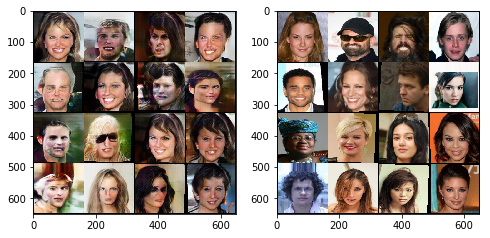

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.1676	Loss_Dec: 4.0949	Aux F1: 0.8461	Loss_Enc: 869.2728	D(x): 0.6114	D(G(z)): 0.2710
[3/5][250/5332]	Disc/Dec Trains: 14.0/251.0	Loss_D: 0.9524	Loss_Dec: 4.4125	Aux F1: 0.8503	Loss_Enc: 898.0346	D(x): 0.6855	D(G(z)): 0.2664
[3/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.9470	Loss_Dec: 4.4179	Aux F1: 0.8508	Loss_Enc: 899.1615	D(x): 0.7340	D(G(z)): 0.2209
[3/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.9484	Loss_Dec: 4.4161	Aux F1: 0.8508	Loss_Enc: 897.6973	D(x): 0.7118	D(G(z)): 0.2614
[3/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.9496	Loss_Dec: 4.4169	Aux F1: 0.8510	Loss_Enc: 897.5434	D(x): 0.6400	D(G(z)): 0.2339
[3/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.9475	Loss_Dec: 4.4184	Aux F1: 0.8510	Loss_Enc: 897.9428	D(x): 0.6525	D(G(z)): 0.1624
[3/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.9454	Loss_Dec: 4.4214	Aux F1: 0.8509	Loss_Enc: 898.0058	D(x): 0.7181	D(G(z)): 0.1986
[3/5][1750/5332]	Disc/Dec 

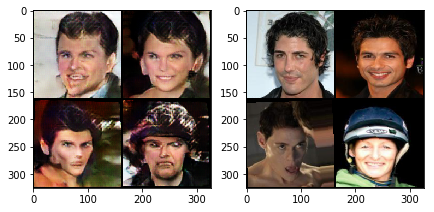

[3/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 0.9430	Loss_Dec: 4.4236	Aux F1: 0.8512	Loss_Enc: 898.0416	D(x): 0.6648	D(G(z)): 0.1958
[3/5][2500/5332]	Disc/Dec Trains: 128.0/2501.0	Loss_D: 0.9437	Loss_Dec: 4.4242	Aux F1: 0.8512	Loss_Enc: 897.8964	D(x): 0.6765	D(G(z)): 0.1911
[3/5][2750/5332]	Disc/Dec Trains: 140.0/2751.0	Loss_D: 0.9444	Loss_Dec: 4.4241	Aux F1: 0.8512	Loss_Enc: 897.8562	D(x): 0.6901	D(G(z)): 0.2358
[3/5][3000/5332]	Disc/Dec Trains: 153.0/3001.0	Loss_D: 0.9430	Loss_Dec: 4.4257	Aux F1: 0.8512	Loss_Enc: 898.0276	D(x): 0.6630	D(G(z)): 0.2316
[3/5][3250/5332]	Disc/Dec Trains: 166.0/3251.0	Loss_D: 0.9422	Loss_Dec: 4.4273	Aux F1: 0.8513	Loss_Enc: 898.4214	D(x): 0.7110	D(G(z)): 0.2186
[3/5][3500/5332]	Disc/Dec Trains: 179.0/3501.0	Loss_D: 0.9420	Loss_Dec: 4.4280	Aux F1: 0.8512	Loss_Enc: 898.5513	D(x): 0.6815	D(G(z)): 0.2240
[3/5][3750/5332]	Disc/Dec Trains: 191.0/3751.0	Loss_D: 0.9411	Loss_Dec: 4.4294	Aux F1: 0.8513	Loss_Enc: 898.6317	D(x): 0.6685	D(G(z)): 0.2506
[3/5][

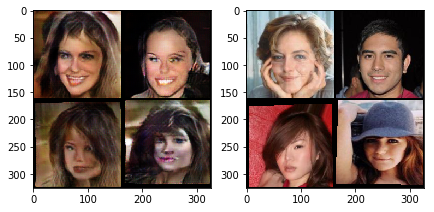

[3/5][4250/5332]	Disc/Dec Trains: 216.0/4251.0	Loss_D: 0.9389	Loss_Dec: 4.4327	Aux F1: 0.8512	Loss_Enc: 898.7842	D(x): 0.6341	D(G(z)): 0.2013
[3/5][4500/5332]	Disc/Dec Trains: 229.0/4501.0	Loss_D: 0.9389	Loss_Dec: 4.4336	Aux F1: 0.8512	Loss_Enc: 898.8500	D(x): 0.6568	D(G(z)): 0.2144
[3/5][4750/5332]	Disc/Dec Trains: 241.0/4751.0	Loss_D: 0.9385	Loss_Dec: 4.4346	Aux F1: 0.8512	Loss_Enc: 898.9191	D(x): 0.7238	D(G(z)): 0.2047
[3/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.9379	Loss_Dec: 4.4350	Aux F1: 0.8512	Loss_Enc: 899.0202	D(x): 0.6713	D(G(z)): 0.1861
[3/5][5250/5332]	Disc/Dec Trains: 266.0/5251.0	Loss_D: 0.9368	Loss_Dec: 4.4370	Aux F1: 0.8512	Loss_Enc: 899.3201	D(x): 0.6912	D(G(z)): 0.2123


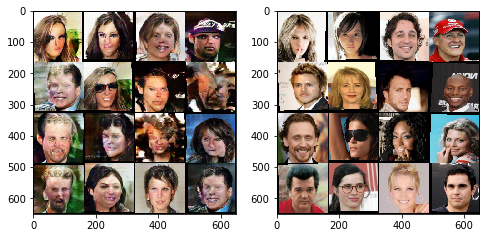

[4/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9799	Loss_Dec: 4.2893	Aux F1: 0.8441	Loss_Enc: 918.0277	D(x): 0.6708	D(G(z)): 0.2199
[4/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9181	Loss_Dec: 4.4688	Aux F1: 0.8514	Loss_Enc: 902.3678	D(x): 0.6922	D(G(z)): 0.1615
[4/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.9218	Loss_Dec: 4.4679	Aux F1: 0.8514	Loss_Enc: 901.9898	D(x): 0.6725	D(G(z)): 0.2267
[4/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.9244	Loss_Dec: 4.4629	Aux F1: 0.8513	Loss_Enc: 900.9257	D(x): 0.6855	D(G(z)): 0.2118
[4/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.9248	Loss_Dec: 4.4637	Aux F1: 0.8513	Loss_Enc: 900.7628	D(x): 0.6724	D(G(z)): 0.2131
[4/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.9254	Loss_Dec: 4.4665	Aux F1: 0.8514	Loss_Enc: 900.9365	D(x): 0.6893	D(G(z)): 0.2105
[4/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.9263	Loss_Dec: 4.4685	Aux F1: 0.8514	Loss_Enc: 900.6888	D(x): 0.7286	D(G(z)): 0.2195
[4/5][1750/5332]	Disc/Dec 

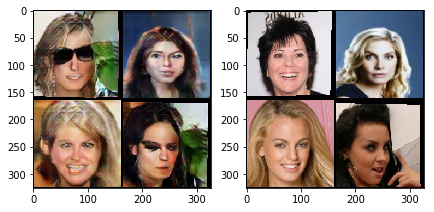

[4/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.9254	Loss_Dec: 4.4725	Aux F1: 0.8515	Loss_Enc: 901.1963	D(x): 0.6578	D(G(z)): 0.2385
[4/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.9253	Loss_Dec: 4.4721	Aux F1: 0.8515	Loss_Enc: 900.9813	D(x): 0.6509	D(G(z)): 0.2392
[4/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.9247	Loss_Dec: 4.4732	Aux F1: 0.8515	Loss_Enc: 901.2835	D(x): 0.7070	D(G(z)): 0.2186
[4/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.9240	Loss_Dec: 4.4737	Aux F1: 0.8513	Loss_Enc: 901.2527	D(x): 0.6881	D(G(z)): 0.2218
[4/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.9234	Loss_Dec: 4.4737	Aux F1: 0.8513	Loss_Enc: 901.3541	D(x): 0.6476	D(G(z)): 0.2164
[4/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.9231	Loss_Dec: 4.4737	Aux F1: 0.8513	Loss_Enc: 901.5123	D(x): 0.6900	D(G(z)): 0.2015
[4/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.9230	Loss_Dec: 4.4732	Aux F1: 0.8513	Loss_Enc: 901.2613	D(x): 0.6332	D(G(z)): 0.2473
[4/5][

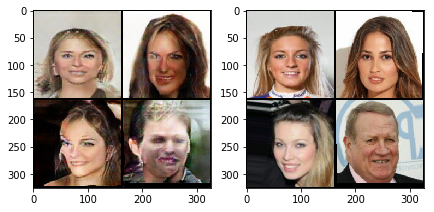

[4/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.9224	Loss_Dec: 4.4738	Aux F1: 0.8513	Loss_Enc: 901.3008	D(x): 0.6684	D(G(z)): 0.2574
[4/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.9222	Loss_Dec: 4.4744	Aux F1: 0.8512	Loss_Enc: 901.4724	D(x): 0.7067	D(G(z)): 0.2166
[4/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.9210	Loss_Dec: 4.4746	Aux F1: 0.8512	Loss_Enc: 901.4275	D(x): 0.6912	D(G(z)): 0.2062
[4/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.9203	Loss_Dec: 4.4747	Aux F1: 0.8512	Loss_Enc: 901.5921	D(x): 0.6996	D(G(z)): 0.2031
[4/5][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 0.9200	Loss_Dec: 4.4749	Aux F1: 0.8512	Loss_Enc: 901.5745	D(x): 0.7126	D(G(z)): 0.2062


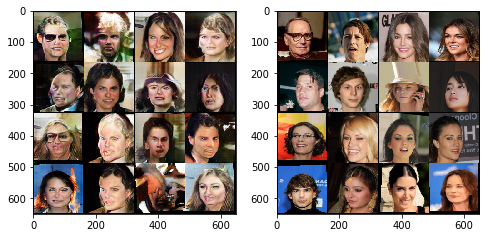

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.47, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0486	Loss_Dec: 4.5863	Aux F1: 0.8526	Loss_Enc: 910.1917	D(x): 0.6478	D(G(z)): 0.2197
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9202	Loss_Dec: 4.4738	Aux F1: 0.8509	Loss_Enc: 899.1466	D(x): 0.6888	D(G(z)): 0.1937
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.9126	Loss_Dec: 4.4821	Aux F1: 0.8508	Loss_Enc: 900.7681	D(x): 0.7583	D(G(z)): 0.2086
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9110	Loss_Dec: 4.4857	Aux F1: 0.8508	Loss_Enc: 899.9453	D(x): 0.6932	D(G(z)): 0.2164
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.9101	Loss_Dec: 4.4888	Aux F1: 0.8511	Loss_Enc: 899.8580	D(x): 0.6686	D(G(z)): 0.2025
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.9081	Loss_Dec: 4.4912	Aux F1: 0.8513	Loss_Enc: 899.9124	D(x): 0.7133	D(G(z)): 0.1594
[0/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.9091	Loss_Dec: 4.4906	Aux F1: 0.8513	Loss_Enc: 899.8637	D(x): 0.6908	D(G(z)): 0.2482
[0/5][1750/5332]	Disc/Dec 

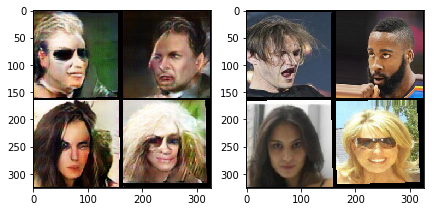

[0/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.9084	Loss_Dec: 4.4902	Aux F1: 0.8513	Loss_Enc: 899.9854	D(x): 0.6414	D(G(z)): 0.2547
[0/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.9073	Loss_Dec: 4.4909	Aux F1: 0.8514	Loss_Enc: 899.9508	D(x): 0.7013	D(G(z)): 0.2262
[0/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.9075	Loss_Dec: 4.4900	Aux F1: 0.8514	Loss_Enc: 899.8969	D(x): 0.6854	D(G(z)): 0.1876
[0/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.9073	Loss_Dec: 4.4900	Aux F1: 0.8514	Loss_Enc: 899.8904	D(x): 0.7291	D(G(z)): 0.2604
[0/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.9073	Loss_Dec: 4.4889	Aux F1: 0.8513	Loss_Enc: 899.5552	D(x): 0.6634	D(G(z)): 0.2416
[0/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.9070	Loss_Dec: 4.4885	Aux F1: 0.8513	Loss_Enc: 899.5710	D(x): 0.7296	D(G(z)): 0.2082
[0/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.9070	Loss_Dec: 4.4881	Aux F1: 0.8512	Loss_Enc: 899.6424	D(x): 0.7049	D(G(z)): 0.2259
[0/5][

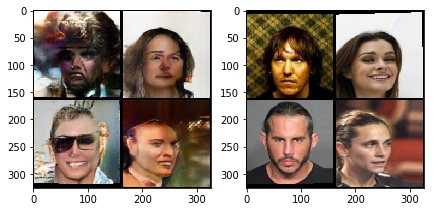

[0/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.9062	Loss_Dec: 4.4872	Aux F1: 0.8513	Loss_Enc: 899.4166	D(x): 0.6755	D(G(z)): 0.1988
[0/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.9060	Loss_Dec: 4.4885	Aux F1: 0.8513	Loss_Enc: 899.2713	D(x): 0.7360	D(G(z)): 0.1932
[0/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.9056	Loss_Dec: 4.4889	Aux F1: 0.8512	Loss_Enc: 899.2109	D(x): 0.7479	D(G(z)): 0.2103
[0/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.9052	Loss_Dec: 4.4897	Aux F1: 0.8513	Loss_Enc: 899.3526	D(x): 0.6552	D(G(z)): 0.2115
[0/5][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.9044	Loss_Dec: 4.4905	Aux F1: 0.8513	Loss_Enc: 899.2648	D(x): 0.7221	D(G(z)): 0.2166


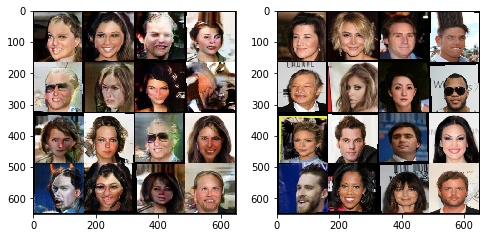

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7735	Loss_Dec: 4.6078	Aux F1: 0.8579	Loss_Enc: 896.2759	D(x): 0.7354	D(G(z)): 0.2147
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8965	Loss_Dec: 4.4947	Aux F1: 0.8506	Loss_Enc: 899.3156	D(x): 0.7718	D(G(z)): 0.1877
[1/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.9003	Loss_Dec: 4.4900	Aux F1: 0.8503	Loss_Enc: 898.3882	D(x): 0.6857	D(G(z)): 0.2203
[1/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9007	Loss_Dec: 4.4912	Aux F1: 0.8504	Loss_Enc: 899.0152	D(x): 0.6779	D(G(z)): 0.2311
[1/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.9000	Loss_Dec: 4.4945	Aux F1: 0.8507	Loss_Enc: 899.6347	D(x): 0.6927	D(G(z)): 0.2269
[1/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8965	Loss_Dec: 4.5021	Aux F1: 0.8506	Loss_Enc: 899.8965	D(x): 0.7590	D(G(z)): 0.1963
[1/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8962	Loss_Dec: 4.5028	Aux F1: 0.8508	Loss_Enc: 899.4424	D(x): 0.7186	D(G(z)): 0.1977
[1/5][1750/5332]	Disc/Dec 

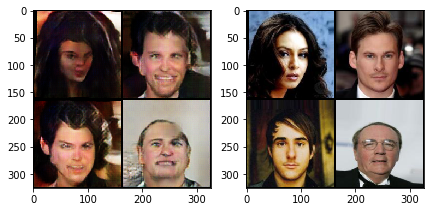

[1/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8975	Loss_Dec: 4.5035	Aux F1: 0.8508	Loss_Enc: 898.4912	D(x): 0.6793	D(G(z)): 0.1693
[1/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8971	Loss_Dec: 4.5036	Aux F1: 0.8509	Loss_Enc: 898.5111	D(x): 0.6470	D(G(z)): 0.2217
[1/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8964	Loss_Dec: 4.5036	Aux F1: 0.8510	Loss_Enc: 898.2920	D(x): 0.7353	D(G(z)): 0.1771
[1/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8950	Loss_Dec: 4.5063	Aux F1: 0.8511	Loss_Enc: 898.6833	D(x): 0.7076	D(G(z)): 0.2378
[1/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8949	Loss_Dec: 4.5060	Aux F1: 0.8511	Loss_Enc: 898.7011	D(x): 0.6822	D(G(z)): 0.2489
[1/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8959	Loss_Dec: 4.5052	Aux F1: 0.8511	Loss_Enc: 898.7172	D(x): 0.7310	D(G(z)): 0.2241
[1/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8956	Loss_Dec: 4.5062	Aux F1: 0.8512	Loss_Enc: 898.7641	D(x): 0.7045	D(G(z)): 0.2463
[1/5][

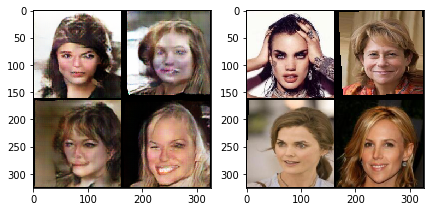

[1/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8960	Loss_Dec: 4.5062	Aux F1: 0.8511	Loss_Enc: 898.7263	D(x): 0.6772	D(G(z)): 0.2196
[1/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8963	Loss_Dec: 4.5063	Aux F1: 0.8511	Loss_Enc: 898.6991	D(x): 0.6871	D(G(z)): 0.2210
[1/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8955	Loss_Dec: 4.5074	Aux F1: 0.8511	Loss_Enc: 898.7996	D(x): 0.6652	D(G(z)): 0.2309
[1/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8969	Loss_Dec: 4.5060	Aux F1: 0.8511	Loss_Enc: 898.6264	D(x): 0.7032	D(G(z)): 0.2125
[1/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8968	Loss_Dec: 4.5061	Aux F1: 0.8511	Loss_Enc: 898.6737	D(x): 0.6577	D(G(z)): 0.1493


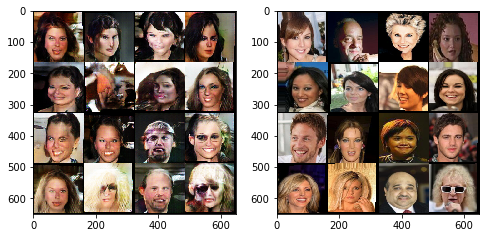

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.6910	Loss_Dec: 4.7070	Aux F1: 0.8592	Loss_Enc: 915.7511	D(x): 0.7509	D(G(z)): 0.1928
[2/5][250/5332]	Disc/Dec Trains: 14.0/251.0	Loss_D: 0.9090	Loss_Dec: 4.4926	Aux F1: 0.8505	Loss_Enc: 894.3556	D(x): 0.7242	D(G(z)): 0.2419
[2/5][500/5332]	Disc/Dec Trains: 29.0/501.0	Loss_D: 0.9090	Loss_Dec: 4.4947	Aux F1: 0.8505	Loss_Enc: 895.0601	D(x): 0.7364	D(G(z)): 0.2109
[2/5][750/5332]	Disc/Dec Trains: 41.0/751.0	Loss_D: 0.9023	Loss_Dec: 4.5029	Aux F1: 0.8504	Loss_Enc: 895.9479	D(x): 0.7656	D(G(z)): 0.1960
[2/5][1000/5332]	Disc/Dec Trains: 54.0/1001.0	Loss_D: 0.9013	Loss_Dec: 4.5073	Aux F1: 0.8504	Loss_Enc: 895.6910	D(x): 0.7158	D(G(z)): 0.1966
[2/5][1250/5332]	Disc/Dec Trains: 66.0/1251.0	Loss_D: 0.8998	Loss_Dec: 4.5104	Aux F1: 0.8507	Loss_Enc: 895.6947	D(x): 0.6955	D(G(z)): 0.2446
[2/5][1500/5332]	Disc/Dec Trains: 79.0/1501.0	Loss_D: 0.9028	Loss_Dec: 4.5081	Aux F1: 0.8509	Loss_Enc: 895.9495	D(x): 0.7026	D(G(z)): 0.2687
[2/5][1750/5332]	Disc/Dec 

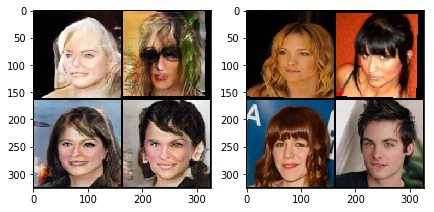

[2/5][2250/5332]	Disc/Dec Trains: 116.0/2251.0	Loss_D: 0.9014	Loss_Dec: 4.5097	Aux F1: 0.8510	Loss_Enc: 896.0069	D(x): 0.6640	D(G(z)): 0.2370
[2/5][2500/5332]	Disc/Dec Trains: 129.0/2501.0	Loss_D: 0.9004	Loss_Dec: 4.5121	Aux F1: 0.8510	Loss_Enc: 896.2351	D(x): 0.6911	D(G(z)): 0.1850
[2/5][2750/5332]	Disc/Dec Trains: 141.0/2751.0	Loss_D: 0.9004	Loss_Dec: 4.5111	Aux F1: 0.8511	Loss_Enc: 896.1187	D(x): 0.7319	D(G(z)): 0.2397
[2/5][3000/5332]	Disc/Dec Trains: 154.0/3001.0	Loss_D: 0.9006	Loss_Dec: 4.5124	Aux F1: 0.8511	Loss_Enc: 896.1415	D(x): 0.7180	D(G(z)): 0.2283
[2/5][3250/5332]	Disc/Dec Trains: 167.0/3251.0	Loss_D: 0.8997	Loss_Dec: 4.5136	Aux F1: 0.8510	Loss_Enc: 896.4248	D(x): 0.6691	D(G(z)): 0.2125
[2/5][3500/5332]	Disc/Dec Trains: 180.0/3501.0	Loss_D: 0.8996	Loss_Dec: 4.5135	Aux F1: 0.8509	Loss_Enc: 896.3892	D(x): 0.7171	D(G(z)): 0.1816
[2/5][3750/5332]	Disc/Dec Trains: 192.0/3751.0	Loss_D: 0.8998	Loss_Dec: 4.5129	Aux F1: 0.8509	Loss_Enc: 896.3415	D(x): 0.7131	D(G(z)): 0.2430
[2/5][

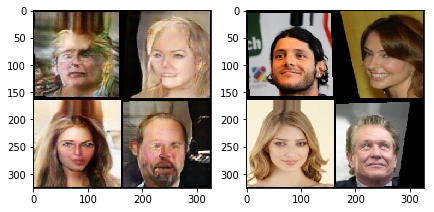

[2/5][4250/5332]	Disc/Dec Trains: 217.0/4251.0	Loss_D: 0.8990	Loss_Dec: 4.5143	Aux F1: 0.8509	Loss_Enc: 896.4722	D(x): 0.7044	D(G(z)): 0.2151
[2/5][4500/5332]	Disc/Dec Trains: 230.0/4501.0	Loss_D: 0.8982	Loss_Dec: 4.5154	Aux F1: 0.8510	Loss_Enc: 896.5869	D(x): 0.6659	D(G(z)): 0.2183
[2/5][4750/5332]	Disc/Dec Trains: 242.0/4751.0	Loss_D: 0.8971	Loss_Dec: 4.5172	Aux F1: 0.8510	Loss_Enc: 896.7315	D(x): 0.7196	D(G(z)): 0.2236
[2/5][5000/5332]	Disc/Dec Trains: 255.0/5001.0	Loss_D: 0.8964	Loss_Dec: 4.5185	Aux F1: 0.8509	Loss_Enc: 896.8301	D(x): 0.6897	D(G(z)): 0.2094
[2/5][5250/5332]	Disc/Dec Trains: 267.0/5251.0	Loss_D: 0.8957	Loss_Dec: 4.5204	Aux F1: 0.8510	Loss_Enc: 896.9481	D(x): 0.6987	D(G(z)): 0.2290


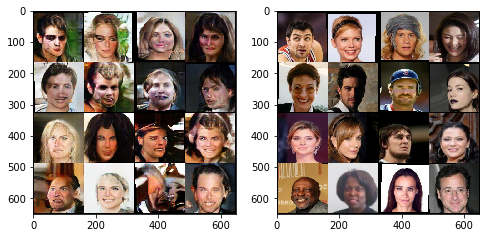

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7715	Loss_Dec: 4.7635	Aux F1: 0.8513	Loss_Enc: 931.0037	D(x): 0.7519	D(G(z)): 0.2046
[3/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8873	Loss_Dec: 4.5553	Aux F1: 0.8521	Loss_Enc: 898.6394	D(x): 0.7057	D(G(z)): 0.2472
[3/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.8880	Loss_Dec: 4.5522	Aux F1: 0.8515	Loss_Enc: 899.1638	D(x): 0.7146	D(G(z)): 0.2048
[3/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.8821	Loss_Dec: 4.5569	Aux F1: 0.8516	Loss_Enc: 899.6836	D(x): 0.6178	D(G(z)): 0.2148
[3/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8855	Loss_Dec: 4.5497	Aux F1: 0.8514	Loss_Enc: 898.6393	D(x): 0.6642	D(G(z)): 0.1991
[3/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8864	Loss_Dec: 4.5487	Aux F1: 0.8515	Loss_Enc: 898.3398	D(x): 0.6993	D(G(z)): 0.2497
[3/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8865	Loss_Dec: 4.5510	Aux F1: 0.8514	Loss_Enc: 898.2997	D(x): 0.7231	D(G(z)): 0.2122
[3/5][1750/5332]	Disc/Dec 

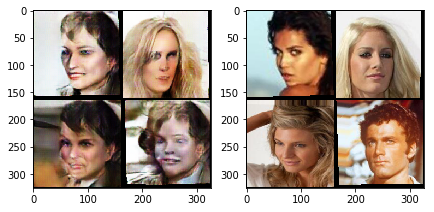

[3/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 0.8879	Loss_Dec: 4.5480	Aux F1: 0.8512	Loss_Enc: 898.3813	D(x): 0.7189	D(G(z)): 0.1781
[3/5][2500/5332]	Disc/Dec Trains: 129.0/2501.0	Loss_D: 0.8888	Loss_Dec: 4.5476	Aux F1: 0.8511	Loss_Enc: 898.7029	D(x): 0.7749	D(G(z)): 0.1405
[3/5][2750/5332]	Disc/Dec Trains: 142.0/2751.0	Loss_D: 0.8876	Loss_Dec: 4.5477	Aux F1: 0.8512	Loss_Enc: 898.6872	D(x): 0.7304	D(G(z)): 0.2221
[3/5][3000/5332]	Disc/Dec Trains: 155.0/3001.0	Loss_D: 0.8882	Loss_Dec: 4.5459	Aux F1: 0.8511	Loss_Enc: 898.4471	D(x): 0.7484	D(G(z)): 0.2167
[3/5][3250/5332]	Disc/Dec Trains: 167.0/3251.0	Loss_D: 0.8883	Loss_Dec: 4.5467	Aux F1: 0.8511	Loss_Enc: 898.6450	D(x): 0.7540	D(G(z)): 0.1682
[3/5][3500/5332]	Disc/Dec Trains: 180.0/3501.0	Loss_D: 0.8881	Loss_Dec: 4.5462	Aux F1: 0.8511	Loss_Enc: 898.6604	D(x): 0.7352	D(G(z)): 0.1572
[3/5][3750/5332]	Disc/Dec Trains: 192.0/3751.0	Loss_D: 0.8878	Loss_Dec: 4.5455	Aux F1: 0.8511	Loss_Enc: 898.5628	D(x): 0.7158	D(G(z)): 0.1492
[3/5][

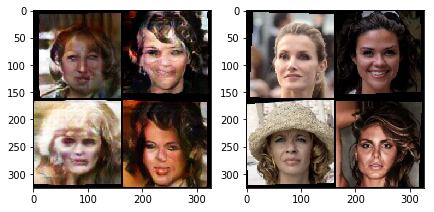

[3/5][4250/5332]	Disc/Dec Trains: 218.0/4251.0	Loss_D: 0.8878	Loss_Dec: 4.5451	Aux F1: 0.8511	Loss_Enc: 898.4030	D(x): 0.6668	D(G(z)): 0.2518
[3/5][4500/5332]	Disc/Dec Trains: 231.0/4501.0	Loss_D: 0.8876	Loss_Dec: 4.5442	Aux F1: 0.8511	Loss_Enc: 898.3958	D(x): 0.6567	D(G(z)): 0.1704
[3/5][4750/5332]	Disc/Dec Trains: 243.0/4751.0	Loss_D: 0.8880	Loss_Dec: 4.5429	Aux F1: 0.8512	Loss_Enc: 898.3538	D(x): 0.7176	D(G(z)): 0.1909
[3/5][5000/5332]	Disc/Dec Trains: 256.0/5001.0	Loss_D: 0.8871	Loss_Dec: 4.5433	Aux F1: 0.8511	Loss_Enc: 898.5560	D(x): 0.6532	D(G(z)): 0.2060
[3/5][5250/5332]	Disc/Dec Trains: 269.0/5251.0	Loss_D: 0.8866	Loss_Dec: 4.5442	Aux F1: 0.8512	Loss_Enc: 898.6529	D(x): 0.7098	D(G(z)): 0.1862


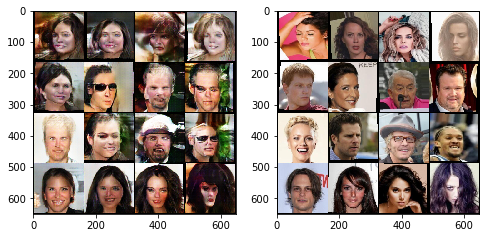

[4/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9398	Loss_Dec: 4.5876	Aux F1: 0.8533	Loss_Enc: 948.9689	D(x): 0.6688	D(G(z)): 0.1682
[4/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8787	Loss_Dec: 4.5439	Aux F1: 0.8515	Loss_Enc: 899.9496	D(x): 0.7354	D(G(z)): 0.1816
[4/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.8775	Loss_Dec: 4.5489	Aux F1: 0.8518	Loss_Enc: 900.4218	D(x): 0.6233	D(G(z)): 0.2580
[4/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.8831	Loss_Dec: 4.5505	Aux F1: 0.8511	Loss_Enc: 900.2887	D(x): 0.7214	D(G(z)): 0.2417
[4/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8836	Loss_Dec: 4.5498	Aux F1: 0.8510	Loss_Enc: 899.9722	D(x): 0.7498	D(G(z)): 0.1772
[4/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8826	Loss_Dec: 4.5538	Aux F1: 0.8510	Loss_Enc: 900.5083	D(x): 0.7115	D(G(z)): 0.2739
[4/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8812	Loss_Dec: 4.5577	Aux F1: 0.8511	Loss_Enc: 900.6427	D(x): 0.7294	D(G(z)): 0.1929
[4/5][1750/5332]	Disc/Dec 

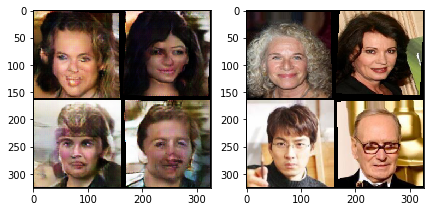

[4/5][2250/5332]	Disc/Dec Trains: 116.0/2251.0	Loss_D: 0.8771	Loss_Dec: 4.5623	Aux F1: 0.8510	Loss_Enc: 900.4899	D(x): 0.7106	D(G(z)): 0.1760
[4/5][2500/5332]	Disc/Dec Trains: 129.0/2501.0	Loss_D: 0.8776	Loss_Dec: 4.5616	Aux F1: 0.8509	Loss_Enc: 900.4170	D(x): 0.6223	D(G(z)): 0.2359
[4/5][2750/5332]	Disc/Dec Trains: 141.0/2751.0	Loss_D: 0.8773	Loss_Dec: 4.5628	Aux F1: 0.8510	Loss_Enc: 900.4963	D(x): 0.6998	D(G(z)): 0.2276
[4/5][3000/5332]	Disc/Dec Trains: 154.0/3001.0	Loss_D: 0.8779	Loss_Dec: 4.5625	Aux F1: 0.8510	Loss_Enc: 900.3741	D(x): 0.7461	D(G(z)): 0.2013
[4/5][3250/5332]	Disc/Dec Trains: 166.0/3251.0	Loss_D: 0.8780	Loss_Dec: 4.5632	Aux F1: 0.8509	Loss_Enc: 900.3743	D(x): 0.7343	D(G(z)): 0.1833
[4/5][3500/5332]	Disc/Dec Trains: 179.0/3501.0	Loss_D: 0.8775	Loss_Dec: 4.5646	Aux F1: 0.8509	Loss_Enc: 900.5195	D(x): 0.6685	D(G(z)): 0.2735
[4/5][3750/5332]	Disc/Dec Trains: 191.0/3751.0	Loss_D: 0.8773	Loss_Dec: 4.5645	Aux F1: 0.8510	Loss_Enc: 900.3951	D(x): 0.6409	D(G(z)): 0.2700
[4/5][

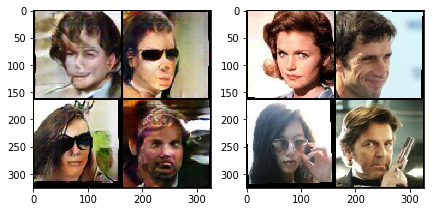

[4/5][4250/5332]	Disc/Dec Trains: 216.0/4251.0	Loss_D: 0.8775	Loss_Dec: 4.5649	Aux F1: 0.8510	Loss_Enc: 900.6301	D(x): 0.7267	D(G(z)): 0.1843
[4/5][4500/5332]	Disc/Dec Trains: 229.0/4501.0	Loss_D: 0.8772	Loss_Dec: 4.5666	Aux F1: 0.8511	Loss_Enc: 900.8870	D(x): 0.6308	D(G(z)): 0.2347
[4/5][4750/5332]	Disc/Dec Trains: 241.0/4751.0	Loss_D: 0.8773	Loss_Dec: 4.5667	Aux F1: 0.8510	Loss_Enc: 900.8055	D(x): 0.6929	D(G(z)): 0.2104
[4/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.8779	Loss_Dec: 4.5662	Aux F1: 0.8510	Loss_Enc: 900.6405	D(x): 0.7527	D(G(z)): 0.2560
[4/5][5250/5332]	Disc/Dec Trains: 266.0/5251.0	Loss_D: 0.8783	Loss_Dec: 4.5660	Aux F1: 0.8510	Loss_Enc: 900.4978	D(x): 0.6656	D(G(z)): 0.2216


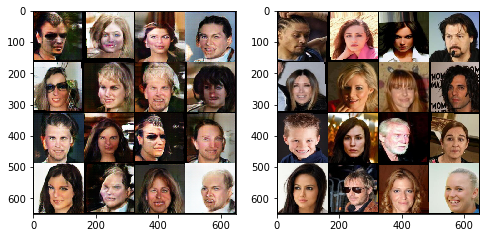

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.4675, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7537	Loss_Dec: 4.6768	Aux F1: 0.8408	Loss_Enc: 921.9724	D(x): 0.7366	D(G(z)): 0.2007
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8763	Loss_Dec: 4.5688	Aux F1: 0.8512	Loss_Enc: 900.6107	D(x): 0.6801	D(G(z)): 0.2025
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8753	Loss_Dec: 4.5716	Aux F1: 0.8512	Loss_Enc: 900.7023	D(x): 0.7378	D(G(z)): 0.1819
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8725	Loss_Dec: 4.5769	Aux F1: 0.8510	Loss_Enc: 900.9132	D(x): 0.6591	D(G(z)): 0.2589
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8715	Loss_Dec: 4.5821	Aux F1: 0.8509	Loss_Enc: 901.5464	D(x): 0.6698	D(G(z)): 0.2565
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8721	Loss_Dec: 4.5819	Aux F1: 0.8510	Loss_Enc: 901.3865	D(x): 0.7443	D(G(z)): 0.2063
[0/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8729	Loss_Dec: 4.5803	Aux F1: 0.8509	Loss_Enc: 900.9650	D(x): 0.7198	D(G(z)): 0.2388
[0/5][1750/5332]	Disc/Dec 

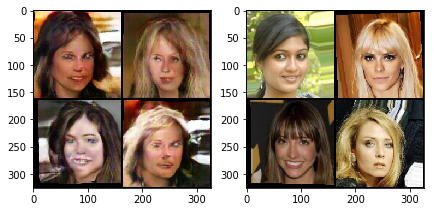

[0/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8719	Loss_Dec: 4.5852	Aux F1: 0.8509	Loss_Enc: 901.8977	D(x): 0.7371	D(G(z)): 0.2058
[0/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8719	Loss_Dec: 4.5865	Aux F1: 0.8509	Loss_Enc: 901.8973	D(x): 0.7395	D(G(z)): 0.2246
[0/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8719	Loss_Dec: 4.5877	Aux F1: 0.8509	Loss_Enc: 901.7322	D(x): 0.7141	D(G(z)): 0.1760
[0/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8727	Loss_Dec: 4.5872	Aux F1: 0.8510	Loss_Enc: 901.5861	D(x): 0.7272	D(G(z)): 0.1484
[0/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8738	Loss_Dec: 4.5863	Aux F1: 0.8510	Loss_Enc: 901.2811	D(x): 0.7427	D(G(z)): 0.2298
[0/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.8736	Loss_Dec: 4.5872	Aux F1: 0.8510	Loss_Enc: 901.3677	D(x): 0.6890	D(G(z)): 0.1977
[0/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.8738	Loss_Dec: 4.5869	Aux F1: 0.8509	Loss_Enc: 901.3676	D(x): 0.6984	D(G(z)): 0.1912
[0/5][

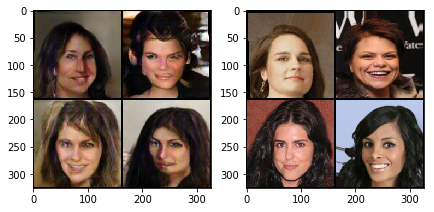

[0/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.8738	Loss_Dec: 4.5876	Aux F1: 0.8509	Loss_Enc: 901.1876	D(x): 0.6895	D(G(z)): 0.2229
[0/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.8738	Loss_Dec: 4.5883	Aux F1: 0.8509	Loss_Enc: 901.2385	D(x): 0.6833	D(G(z)): 0.2298
[0/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.8745	Loss_Dec: 4.5875	Aux F1: 0.8509	Loss_Enc: 901.0994	D(x): 0.7184	D(G(z)): 0.1447
[0/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.8747	Loss_Dec: 4.5876	Aux F1: 0.8509	Loss_Enc: 901.2070	D(x): 0.7483	D(G(z)): 0.2050
[0/5][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.8747	Loss_Dec: 4.5869	Aux F1: 0.8509	Loss_Enc: 901.1730	D(x): 0.7159	D(G(z)): 0.1844


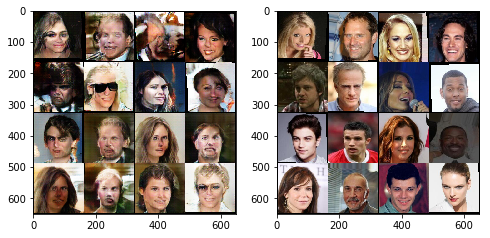

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.8063	Loss_Dec: 4.5812	Aux F1: 0.8625	Loss_Enc: 883.3317	D(x): 0.7425	D(G(z)): 0.2083
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8753	Loss_Dec: 4.5721	Aux F1: 0.8516	Loss_Enc: 901.8022	D(x): 0.7140	D(G(z)): 0.2206
[1/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8742	Loss_Dec: 4.5815	Aux F1: 0.8511	Loss_Enc: 903.5252	D(x): 0.7511	D(G(z)): 0.1706
[1/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8745	Loss_Dec: 4.5855	Aux F1: 0.8506	Loss_Enc: 902.7583	D(x): 0.7108	D(G(z)): 0.2151
[1/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8764	Loss_Dec: 4.5863	Aux F1: 0.8507	Loss_Enc: 903.3531	D(x): 0.7360	D(G(z)): 0.1798
[1/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8787	Loss_Dec: 4.5834	Aux F1: 0.8509	Loss_Enc: 903.1261	D(x): 0.7481	D(G(z)): 0.2121
[1/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8772	Loss_Dec: 4.5839	Aux F1: 0.8510	Loss_Enc: 903.2077	D(x): 0.7234	D(G(z)): 0.1987
[1/5][1750/5332]	Disc/Dec 

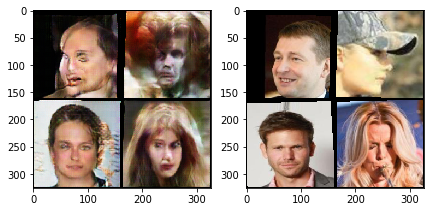

[1/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8753	Loss_Dec: 4.5858	Aux F1: 0.8511	Loss_Enc: 902.7050	D(x): 0.7205	D(G(z)): 0.1716
[1/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8740	Loss_Dec: 4.5891	Aux F1: 0.8510	Loss_Enc: 902.9982	D(x): 0.6987	D(G(z)): 0.2565
[1/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8747	Loss_Dec: 4.5894	Aux F1: 0.8510	Loss_Enc: 903.0784	D(x): 0.7289	D(G(z)): 0.1924
[1/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8752	Loss_Dec: 4.5903	Aux F1: 0.8510	Loss_Enc: 903.2154	D(x): 0.7499	D(G(z)): 0.2103
[1/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8749	Loss_Dec: 4.5901	Aux F1: 0.8510	Loss_Enc: 902.9751	D(x): 0.7415	D(G(z)): 0.1940
[1/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8756	Loss_Dec: 4.5895	Aux F1: 0.8509	Loss_Enc: 902.9557	D(x): 0.7753	D(G(z)): 0.1645
[1/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8758	Loss_Dec: 4.5889	Aux F1: 0.8509	Loss_Enc: 902.7710	D(x): 0.7127	D(G(z)): 0.2076
[1/5][

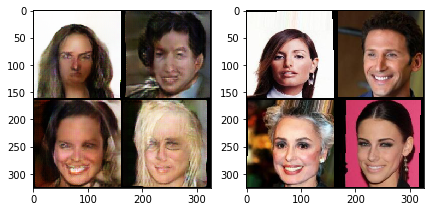

[1/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8769	Loss_Dec: 4.5889	Aux F1: 0.8509	Loss_Enc: 902.6896	D(x): 0.6903	D(G(z)): 0.2203
[1/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8767	Loss_Dec: 4.5898	Aux F1: 0.8509	Loss_Enc: 902.7755	D(x): 0.7158	D(G(z)): 0.1633
[1/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8766	Loss_Dec: 4.5903	Aux F1: 0.8509	Loss_Enc: 902.8044	D(x): 0.6978	D(G(z)): 0.2004
[1/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8769	Loss_Dec: 4.5908	Aux F1: 0.8510	Loss_Enc: 902.9105	D(x): 0.7137	D(G(z)): 0.2030
[1/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8777	Loss_Dec: 4.5901	Aux F1: 0.8510	Loss_Enc: 902.8259	D(x): 0.6908	D(G(z)): 0.2412


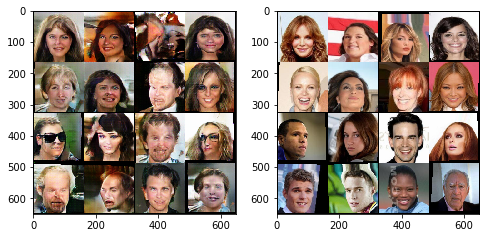

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7599	Loss_Dec: 4.6874	Aux F1: 0.8447	Loss_Enc: 917.7332	D(x): 0.7558	D(G(z)): 0.2058
[2/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8932	Loss_Dec: 4.5843	Aux F1: 0.8508	Loss_Enc: 902.0750	D(x): 0.6949	D(G(z)): 0.2017
[2/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8826	Loss_Dec: 4.5856	Aux F1: 0.8508	Loss_Enc: 901.5628	D(x): 0.7355	D(G(z)): 0.2203
[2/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8828	Loss_Dec: 4.5887	Aux F1: 0.8513	Loss_Enc: 902.1810	D(x): 0.6482	D(G(z)): 0.1988
[2/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8822	Loss_Dec: 4.5891	Aux F1: 0.8513	Loss_Enc: 901.8225	D(x): 0.7322	D(G(z)): 0.1888
[2/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8817	Loss_Dec: 4.5889	Aux F1: 0.8510	Loss_Enc: 901.9060	D(x): 0.7069	D(G(z)): 0.2118
[2/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8851	Loss_Dec: 4.5844	Aux F1: 0.8511	Loss_Enc: 901.4867	D(x): 0.7584	D(G(z)): 0.1648
[2/5][1750/5332]	Disc/Dec 

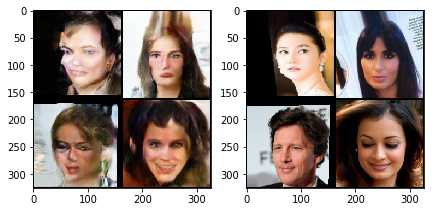

[2/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 0.8823	Loss_Dec: 4.5878	Aux F1: 0.8511	Loss_Enc: 902.0950	D(x): 0.6714	D(G(z)): 0.1898
[2/5][2500/5332]	Disc/Dec Trains: 128.0/2501.0	Loss_D: 0.8830	Loss_Dec: 4.5879	Aux F1: 0.8510	Loss_Enc: 902.1544	D(x): 0.6914	D(G(z)): 0.2556
[2/5][2750/5332]	Disc/Dec Trains: 140.0/2751.0	Loss_D: 0.8833	Loss_Dec: 4.5884	Aux F1: 0.8509	Loss_Enc: 902.2433	D(x): 0.6764	D(G(z)): 0.2672
[2/5][3000/5332]	Disc/Dec Trains: 153.0/3001.0	Loss_D: 0.8824	Loss_Dec: 4.5889	Aux F1: 0.8510	Loss_Enc: 902.1491	D(x): 0.7170	D(G(z)): 0.1940
[2/5][3250/5332]	Disc/Dec Trains: 165.0/3251.0	Loss_D: 0.8827	Loss_Dec: 4.5904	Aux F1: 0.8510	Loss_Enc: 902.4935	D(x): 0.6861	D(G(z)): 0.1719
[2/5][3500/5332]	Disc/Dec Trains: 178.0/3501.0	Loss_D: 0.8825	Loss_Dec: 4.5914	Aux F1: 0.8510	Loss_Enc: 902.4283	D(x): 0.7012	D(G(z)): 0.1544
[2/5][3750/5332]	Disc/Dec Trains: 190.0/3751.0	Loss_D: 0.8828	Loss_Dec: 4.5916	Aux F1: 0.8509	Loss_Enc: 902.3973	D(x): 0.7894	D(G(z)): 0.1654
[2/5][

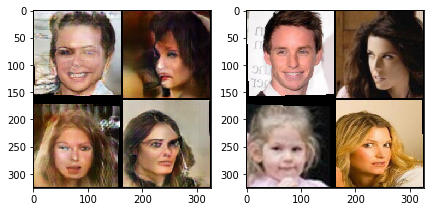

[2/5][4250/5332]	Disc/Dec Trains: 215.0/4251.0	Loss_D: 0.8830	Loss_Dec: 4.5934	Aux F1: 0.8510	Loss_Enc: 902.3505	D(x): 0.7317	D(G(z)): 0.1991
[2/5][4500/5332]	Disc/Dec Trains: 228.0/4501.0	Loss_D: 0.8831	Loss_Dec: 4.5936	Aux F1: 0.8510	Loss_Enc: 902.2508	D(x): 0.7360	D(G(z)): 0.2241
[2/5][4750/5332]	Disc/Dec Trains: 240.0/4751.0	Loss_D: 0.8837	Loss_Dec: 4.5930	Aux F1: 0.8509	Loss_Enc: 902.1319	D(x): 0.7228	D(G(z)): 0.1646
[2/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.8828	Loss_Dec: 4.5942	Aux F1: 0.8509	Loss_Enc: 902.1905	D(x): 0.6883	D(G(z)): 0.2305
[2/5][5250/5332]	Disc/Dec Trains: 266.0/5251.0	Loss_D: 0.8829	Loss_Dec: 4.5949	Aux F1: 0.8509	Loss_Enc: 902.1003	D(x): 0.7602	D(G(z)): 0.1634


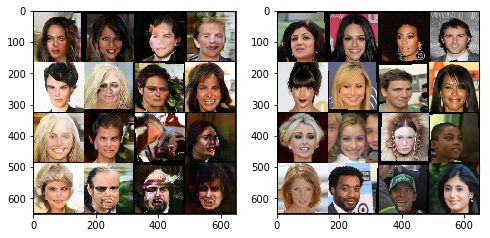

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.1772	Loss_Dec: 4.3385	Aux F1: 0.8559	Loss_Enc: 855.4329	D(x): 0.6326	D(G(z)): 0.2337
[3/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8981	Loss_Dec: 4.5882	Aux F1: 0.8505	Loss_Enc: 900.9110	D(x): 0.6774	D(G(z)): 0.1844
[3/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.8915	Loss_Dec: 4.5883	Aux F1: 0.8509	Loss_Enc: 899.4461	D(x): 0.7230	D(G(z)): 0.2290
[3/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.8889	Loss_Dec: 4.5938	Aux F1: 0.8508	Loss_Enc: 900.1768	D(x): 0.7267	D(G(z)): 0.2036
[3/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8883	Loss_Dec: 4.5958	Aux F1: 0.8507	Loss_Enc: 900.0312	D(x): 0.7175	D(G(z)): 0.2073
[3/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8880	Loss_Dec: 4.5957	Aux F1: 0.8506	Loss_Enc: 900.5453	D(x): 0.6302	D(G(z)): 0.2298
[3/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8884	Loss_Dec: 4.5946	Aux F1: 0.8505	Loss_Enc: 899.8898	D(x): 0.6544	D(G(z)): 0.2113
[3/5][1750/5332]	Disc/Dec 

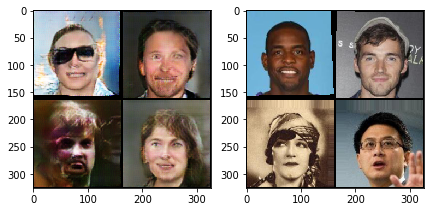

[3/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8879	Loss_Dec: 4.5988	Aux F1: 0.8507	Loss_Enc: 900.2538	D(x): 0.6860	D(G(z)): 0.2088
[3/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8881	Loss_Dec: 4.5997	Aux F1: 0.8507	Loss_Enc: 900.2897	D(x): 0.7540	D(G(z)): 0.1834
[3/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8882	Loss_Dec: 4.5992	Aux F1: 0.8508	Loss_Enc: 900.1331	D(x): 0.6358	D(G(z)): 0.2393
[3/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8880	Loss_Dec: 4.5992	Aux F1: 0.8508	Loss_Enc: 900.1342	D(x): 0.6416	D(G(z)): 0.2405
[3/5][3250/5332]	Disc/Dec Trains: 165.0/3251.0	Loss_D: 0.8872	Loss_Dec: 4.6005	Aux F1: 0.8508	Loss_Enc: 900.4001	D(x): 0.7236	D(G(z)): 0.1694
[3/5][3500/5332]	Disc/Dec Trains: 178.0/3501.0	Loss_D: 0.8872	Loss_Dec: 4.6014	Aux F1: 0.8508	Loss_Enc: 900.1900	D(x): 0.6864	D(G(z)): 0.2028
[3/5][3750/5332]	Disc/Dec Trains: 191.0/3751.0	Loss_D: 0.8878	Loss_Dec: 4.6004	Aux F1: 0.8508	Loss_Enc: 900.1186	D(x): 0.7453	D(G(z)): 0.2166
[3/5][

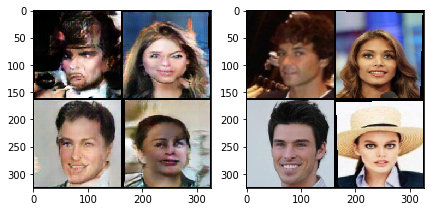

[3/5][4250/5332]	Disc/Dec Trains: 216.0/4251.0	Loss_D: 0.8871	Loss_Dec: 4.6016	Aux F1: 0.8508	Loss_Enc: 900.1837	D(x): 0.6871	D(G(z)): 0.2303
[3/5][4500/5332]	Disc/Dec Trains: 229.0/4501.0	Loss_D: 0.8874	Loss_Dec: 4.6014	Aux F1: 0.8508	Loss_Enc: 900.1444	D(x): 0.7354	D(G(z)): 0.2140
[3/5][4750/5332]	Disc/Dec Trains: 241.0/4751.0	Loss_D: 0.8876	Loss_Dec: 4.6012	Aux F1: 0.8508	Loss_Enc: 900.1820	D(x): 0.7253	D(G(z)): 0.1766
[3/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.8877	Loss_Dec: 4.6012	Aux F1: 0.8508	Loss_Enc: 900.2090	D(x): 0.7114	D(G(z)): 0.2173
[3/5][5250/5332]	Disc/Dec Trains: 267.0/5251.0	Loss_D: 0.8873	Loss_Dec: 4.6017	Aux F1: 0.8509	Loss_Enc: 900.2877	D(x): 0.6897	D(G(z)): 0.2200


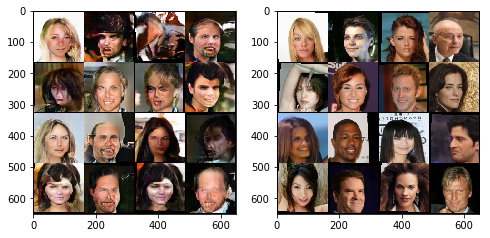

[4/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7515	Loss_Dec: 4.8136	Aux F1: 0.8454	Loss_Enc: 954.4202	D(x): 0.7285	D(G(z)): 0.1696
[4/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8900	Loss_Dec: 4.6045	Aux F1: 0.8512	Loss_Enc: 901.7245	D(x): 0.6887	D(G(z)): 0.2390
[4/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8851	Loss_Dec: 4.6036	Aux F1: 0.8512	Loss_Enc: 900.6152	D(x): 0.6908	D(G(z)): 0.1725
[4/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8863	Loss_Dec: 4.6008	Aux F1: 0.8507	Loss_Enc: 900.3441	D(x): 0.6674	D(G(z)): 0.2095
[4/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8881	Loss_Dec: 4.5990	Aux F1: 0.8509	Loss_Enc: 900.4354	D(x): 0.6800	D(G(z)): 0.1889
[4/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8885	Loss_Dec: 4.5975	Aux F1: 0.8507	Loss_Enc: 900.0040	D(x): 0.7599	D(G(z)): 0.1955
[4/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8898	Loss_Dec: 4.5943	Aux F1: 0.8507	Loss_Enc: 899.4730	D(x): 0.7647	D(G(z)): 0.1639
[4/5][1750/5332]	Disc/Dec 

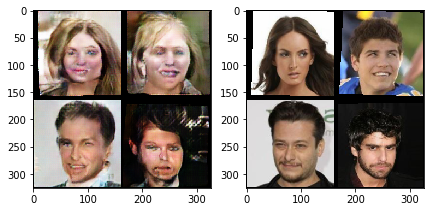

[4/5][2250/5332]	Disc/Dec Trains: 115.0/2251.0	Loss_D: 0.8916	Loss_Dec: 4.5927	Aux F1: 0.8506	Loss_Enc: 899.4444	D(x): 0.7175	D(G(z)): 0.2085
[4/5][2500/5332]	Disc/Dec Trains: 128.0/2501.0	Loss_D: 0.8921	Loss_Dec: 4.5908	Aux F1: 0.8507	Loss_Enc: 899.2929	D(x): 0.7310	D(G(z)): 0.2242
[4/5][2750/5332]	Disc/Dec Trains: 140.0/2751.0	Loss_D: 0.8916	Loss_Dec: 4.5909	Aux F1: 0.8508	Loss_Enc: 899.3736	D(x): 0.7723	D(G(z)): 0.1742
[4/5][3000/5332]	Disc/Dec Trains: 153.0/3001.0	Loss_D: 0.8919	Loss_Dec: 4.5900	Aux F1: 0.8508	Loss_Enc: 899.5010	D(x): 0.6511	D(G(z)): 0.2401
[4/5][3250/5332]	Disc/Dec Trains: 166.0/3251.0	Loss_D: 0.8928	Loss_Dec: 4.5891	Aux F1: 0.8508	Loss_Enc: 899.7887	D(x): 0.6597	D(G(z)): 0.2087
[4/5][3500/5332]	Disc/Dec Trains: 179.0/3501.0	Loss_D: 0.8929	Loss_Dec: 4.5892	Aux F1: 0.8508	Loss_Enc: 899.7018	D(x): 0.7228	D(G(z)): 0.1803
[4/5][3750/5332]	Disc/Dec Trains: 191.0/3751.0	Loss_D: 0.8923	Loss_Dec: 4.5907	Aux F1: 0.8508	Loss_Enc: 899.7220	D(x): 0.7141	D(G(z)): 0.2018
[4/5][

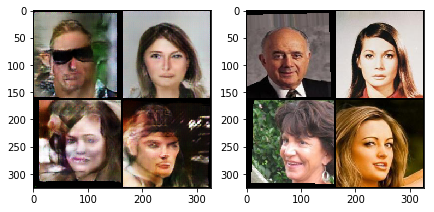

[4/5][4250/5332]	Disc/Dec Trains: 216.0/4251.0	Loss_D: 0.8905	Loss_Dec: 4.5939	Aux F1: 0.8507	Loss_Enc: 900.0424	D(x): 0.6981	D(G(z)): 0.2135
[4/5][4500/5332]	Disc/Dec Trains: 229.0/4501.0	Loss_D: 0.8900	Loss_Dec: 4.5948	Aux F1: 0.8508	Loss_Enc: 900.0693	D(x): 0.6867	D(G(z)): 0.2006
[4/5][4750/5332]	Disc/Dec Trains: 241.0/4751.0	Loss_D: 0.8898	Loss_Dec: 4.5960	Aux F1: 0.8508	Loss_Enc: 900.1720	D(x): 0.6931	D(G(z)): 0.1862
[4/5][5000/5332]	Disc/Dec Trains: 254.0/5001.0	Loss_D: 0.8903	Loss_Dec: 4.5963	Aux F1: 0.8508	Loss_Enc: 900.1179	D(x): 0.7188	D(G(z)): 0.2378
[4/5][5250/5332]	Disc/Dec Trains: 266.0/5251.0	Loss_D: 0.8905	Loss_Dec: 4.5968	Aux F1: 0.8508	Loss_Enc: 900.1356	D(x): 0.7241	D(G(z)): 0.2116


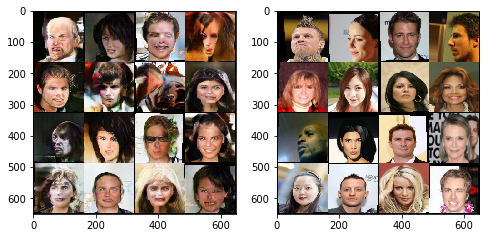

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.465, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.1034	Loss_Dec: 4.4920	Aux F1: 0.8493	Loss_Enc: 896.9773	D(x): 0.6560	D(G(z)): 0.2457
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9063	Loss_Dec: 4.5863	Aux F1: 0.8512	Loss_Enc: 898.8755	D(x): 0.7382	D(G(z)): 0.1840
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8966	Loss_Dec: 4.5922	Aux F1: 0.8514	Loss_Enc: 900.4812	D(x): 0.7394	D(G(z)): 0.2025
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8950	Loss_Dec: 4.5932	Aux F1: 0.8510	Loss_Enc: 900.3385	D(x): 0.6662	D(G(z)): 0.2073
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8974	Loss_Dec: 4.5891	Aux F1: 0.8508	Loss_Enc: 899.9864	D(x): 0.7419	D(G(z)): 0.1153
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8981	Loss_Dec: 4.5870	Aux F1: 0.8508	Loss_Enc: 899.8504	D(x): 0.6962	D(G(z)): 0.2106
[0/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8971	Loss_Dec: 4.5872	Aux F1: 0.8506	Loss_Enc: 899.6688	D(x): 0.7297	D(G(z)): 0.1762
[0/5][1750/5332]	Disc/Dec 

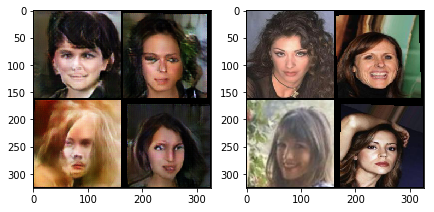

[0/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8969	Loss_Dec: 4.5886	Aux F1: 0.8506	Loss_Enc: 900.1059	D(x): 0.6403	D(G(z)): 0.2411
[0/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8962	Loss_Dec: 4.5888	Aux F1: 0.8506	Loss_Enc: 900.3593	D(x): 0.6877	D(G(z)): 0.1714
[0/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8963	Loss_Dec: 4.5892	Aux F1: 0.8507	Loss_Enc: 900.4372	D(x): 0.7478	D(G(z)): 0.1918
[0/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8969	Loss_Dec: 4.5882	Aux F1: 0.8507	Loss_Enc: 900.5660	D(x): 0.6836	D(G(z)): 0.1610
[0/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8958	Loss_Dec: 4.5893	Aux F1: 0.8506	Loss_Enc: 900.6484	D(x): 0.7485	D(G(z)): 0.1956
[0/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.8959	Loss_Dec: 4.5889	Aux F1: 0.8507	Loss_Enc: 900.7200	D(x): 0.7674	D(G(z)): 0.1650
[0/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.8966	Loss_Dec: 4.5877	Aux F1: 0.8507	Loss_Enc: 900.7832	D(x): 0.6949	D(G(z)): 0.2300
[0/5][

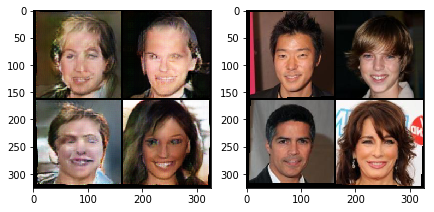

[0/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.8975	Loss_Dec: 4.5864	Aux F1: 0.8508	Loss_Enc: 900.6099	D(x): 0.6500	D(G(z)): 0.2260
[0/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.8972	Loss_Dec: 4.5865	Aux F1: 0.8507	Loss_Enc: 900.5552	D(x): 0.7164	D(G(z)): 0.2124
[0/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.8968	Loss_Dec: 4.5867	Aux F1: 0.8507	Loss_Enc: 900.6798	D(x): 0.7453	D(G(z)): 0.1620
[0/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.8973	Loss_Dec: 4.5855	Aux F1: 0.8507	Loss_Enc: 900.6414	D(x): 0.7429	D(G(z)): 0.1817
[0/5][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.8978	Loss_Dec: 4.5848	Aux F1: 0.8507	Loss_Enc: 900.6838	D(x): 0.7037	D(G(z)): 0.2691


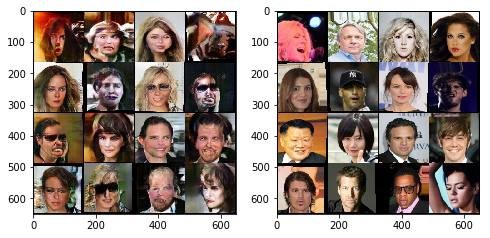

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.8284	Loss_Dec: 4.6471	Aux F1: 0.8546	Loss_Enc: 961.5205	D(x): 0.7391	D(G(z)): 0.1948
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8835	Loss_Dec: 4.5765	Aux F1: 0.8520	Loss_Enc: 899.4045	D(x): 0.6756	D(G(z)): 0.1801
[1/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.8889	Loss_Dec: 4.5794	Aux F1: 0.8511	Loss_Enc: 901.2340	D(x): 0.7003	D(G(z)): 0.1990
[1/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.8900	Loss_Dec: 4.5790	Aux F1: 0.8510	Loss_Enc: 901.3398	D(x): 0.6952	D(G(z)): 0.1632
[1/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8883	Loss_Dec: 4.5827	Aux F1: 0.8508	Loss_Enc: 901.3935	D(x): 0.6887	D(G(z)): 0.1983
[1/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8923	Loss_Dec: 4.5811	Aux F1: 0.8507	Loss_Enc: 901.0828	D(x): 0.7397	D(G(z)): 0.1886
[1/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8926	Loss_Dec: 4.5799	Aux F1: 0.8508	Loss_Enc: 901.0852	D(x): 0.7012	D(G(z)): 0.2387
[1/5][1750/5332]	Disc/Dec 

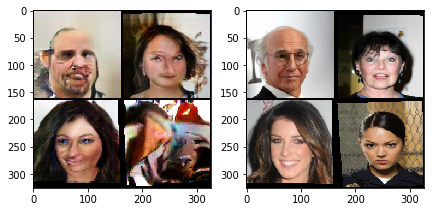

[1/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8940	Loss_Dec: 4.5801	Aux F1: 0.8507	Loss_Enc: 900.6277	D(x): 0.6744	D(G(z)): 0.1787
[1/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8944	Loss_Dec: 4.5797	Aux F1: 0.8508	Loss_Enc: 900.6494	D(x): 0.6965	D(G(z)): 0.2569
[1/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8943	Loss_Dec: 4.5815	Aux F1: 0.8509	Loss_Enc: 901.0620	D(x): 0.6766	D(G(z)): 0.1782
[1/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8945	Loss_Dec: 4.5810	Aux F1: 0.8509	Loss_Enc: 900.9169	D(x): 0.7296	D(G(z)): 0.1698
[1/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8945	Loss_Dec: 4.5819	Aux F1: 0.8509	Loss_Enc: 900.6562	D(x): 0.6399	D(G(z)): 0.1977
[1/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.8946	Loss_Dec: 4.5827	Aux F1: 0.8508	Loss_Enc: 900.8211	D(x): 0.7389	D(G(z)): 0.1912
[1/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.8946	Loss_Dec: 4.5845	Aux F1: 0.8508	Loss_Enc: 900.9156	D(x): 0.7628	D(G(z)): 0.1867
[1/5][

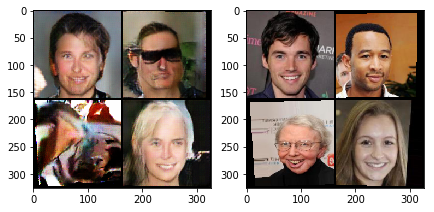

[1/5][4250/5332]	Disc/Dec Trains: 215.0/4251.0	Loss_D: 0.8945	Loss_Dec: 4.5847	Aux F1: 0.8508	Loss_Enc: 900.9829	D(x): 0.7322	D(G(z)): 0.2105
[1/5][4500/5332]	Disc/Dec Trains: 228.0/4501.0	Loss_D: 0.8948	Loss_Dec: 4.5846	Aux F1: 0.8508	Loss_Enc: 901.1839	D(x): 0.7504	D(G(z)): 0.1564
[1/5][4750/5332]	Disc/Dec Trains: 240.0/4751.0	Loss_D: 0.8951	Loss_Dec: 4.5848	Aux F1: 0.8507	Loss_Enc: 901.3004	D(x): 0.6468	D(G(z)): 0.2277
[1/5][5000/5332]	Disc/Dec Trains: 253.0/5001.0	Loss_D: 0.8956	Loss_Dec: 4.5841	Aux F1: 0.8507	Loss_Enc: 901.3670	D(x): 0.7217	D(G(z)): 0.2453
[1/5][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 0.8958	Loss_Dec: 4.5843	Aux F1: 0.8507	Loss_Enc: 901.2814	D(x): 0.7154	D(G(z)): 0.2003


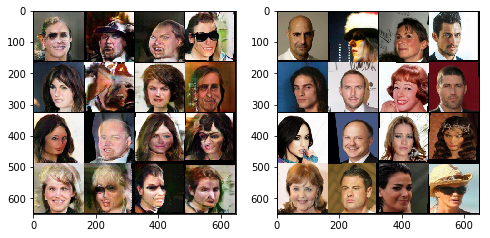

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0212	Loss_Dec: 4.4685	Aux F1: 0.8645	Loss_Enc: 912.8436	D(x): 0.6579	D(G(z)): 0.2242
[2/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9007	Loss_Dec: 4.5687	Aux F1: 0.8497	Loss_Enc: 898.3688	D(x): 0.6899	D(G(z)): 0.1871
[2/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8988	Loss_Dec: 4.5762	Aux F1: 0.8496	Loss_Enc: 898.7807	D(x): 0.7311	D(G(z)): 0.1801
[2/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.9018	Loss_Dec: 4.5740	Aux F1: 0.8499	Loss_Enc: 899.3619	D(x): 0.7249	D(G(z)): 0.1642
[2/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.9002	Loss_Dec: 4.5751	Aux F1: 0.8502	Loss_Enc: 899.2396	D(x): 0.6992	D(G(z)): 0.1574
[2/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8999	Loss_Dec: 4.5779	Aux F1: 0.8504	Loss_Enc: 899.7583	D(x): 0.7352	D(G(z)): 0.1966
[2/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.9011	Loss_Dec: 4.5789	Aux F1: 0.8504	Loss_Enc: 899.6240	D(x): 0.7296	D(G(z)): 0.1829
[2/5][1750/5332]	Disc/Dec 

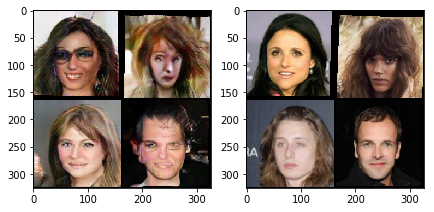

[2/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8982	Loss_Dec: 4.5816	Aux F1: 0.8502	Loss_Enc: 899.9005	D(x): 0.7105	D(G(z)): 0.2004
[2/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8983	Loss_Dec: 4.5825	Aux F1: 0.8503	Loss_Enc: 900.1764	D(x): 0.7354	D(G(z)): 0.1922
[2/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8978	Loss_Dec: 4.5823	Aux F1: 0.8504	Loss_Enc: 900.0865	D(x): 0.7352	D(G(z)): 0.1866
[2/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8979	Loss_Dec: 4.5814	Aux F1: 0.8505	Loss_Enc: 899.8820	D(x): 0.7133	D(G(z)): 0.2211
[2/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8975	Loss_Dec: 4.5815	Aux F1: 0.8505	Loss_Enc: 900.0354	D(x): 0.6817	D(G(z)): 0.2157
[2/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8960	Loss_Dec: 4.5831	Aux F1: 0.8505	Loss_Enc: 900.0486	D(x): 0.7146	D(G(z)): 0.1836
[2/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8964	Loss_Dec: 4.5822	Aux F1: 0.8506	Loss_Enc: 900.0475	D(x): 0.7267	D(G(z)): 0.1761
[2/5][

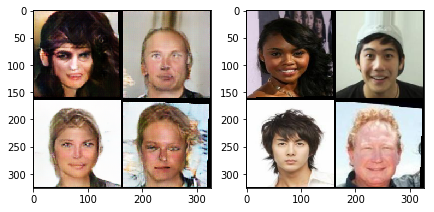

[2/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8958	Loss_Dec: 4.5828	Aux F1: 0.8507	Loss_Enc: 900.2808	D(x): 0.7199	D(G(z)): 0.1936
[2/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8955	Loss_Dec: 4.5830	Aux F1: 0.8506	Loss_Enc: 900.2452	D(x): 0.7269	D(G(z)): 0.2377
[2/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8960	Loss_Dec: 4.5819	Aux F1: 0.8506	Loss_Enc: 900.0572	D(x): 0.7581	D(G(z)): 0.1821
[2/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8968	Loss_Dec: 4.5817	Aux F1: 0.8506	Loss_Enc: 900.1941	D(x): 0.6295	D(G(z)): 0.1951
[2/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8970	Loss_Dec: 4.5815	Aux F1: 0.8506	Loss_Enc: 900.2835	D(x): 0.6868	D(G(z)): 0.2110


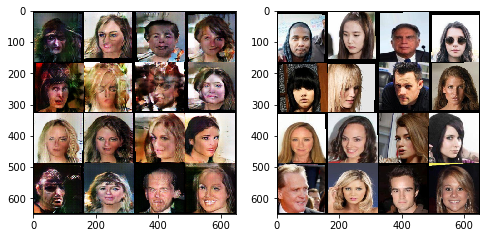

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9166	Loss_Dec: 4.5227	Aux F1: 0.8507	Loss_Enc: 892.6443	D(x): 0.6750	D(G(z)): 0.2122
[3/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9017	Loss_Dec: 4.5758	Aux F1: 0.8494	Loss_Enc: 901.0381	D(x): 0.6971	D(G(z)): 0.1836
[3/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8935	Loss_Dec: 4.5872	Aux F1: 0.8503	Loss_Enc: 901.3602	D(x): 0.7526	D(G(z)): 0.1436
[3/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8986	Loss_Dec: 4.5831	Aux F1: 0.8500	Loss_Enc: 901.1522	D(x): 0.7032	D(G(z)): 0.2061
[3/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8959	Loss_Dec: 4.5862	Aux F1: 0.8501	Loss_Enc: 901.5204	D(x): 0.6613	D(G(z)): 0.2351
[3/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8968	Loss_Dec: 4.5860	Aux F1: 0.8502	Loss_Enc: 902.0592	D(x): 0.6781	D(G(z)): 0.2526
[3/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8947	Loss_Dec: 4.5909	Aux F1: 0.8502	Loss_Enc: 902.5499	D(x): 0.7083	D(G(z)): 0.2036
[3/5][1750/5332]	Disc/Dec 

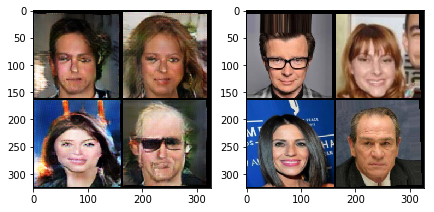

[3/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8945	Loss_Dec: 4.5903	Aux F1: 0.8503	Loss_Enc: 902.0465	D(x): 0.6754	D(G(z)): 0.1997
[3/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8943	Loss_Dec: 4.5890	Aux F1: 0.8504	Loss_Enc: 901.8465	D(x): 0.7348	D(G(z)): 0.1604
[3/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8952	Loss_Dec: 4.5876	Aux F1: 0.8504	Loss_Enc: 901.7736	D(x): 0.7208	D(G(z)): 0.1890
[3/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8942	Loss_Dec: 4.5881	Aux F1: 0.8504	Loss_Enc: 902.0284	D(x): 0.6940	D(G(z)): 0.1860
[3/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8945	Loss_Dec: 4.5877	Aux F1: 0.8505	Loss_Enc: 901.8563	D(x): 0.6377	D(G(z)): 0.2059
[3/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8945	Loss_Dec: 4.5889	Aux F1: 0.8504	Loss_Enc: 902.0205	D(x): 0.7053	D(G(z)): 0.2720
[3/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8948	Loss_Dec: 4.5876	Aux F1: 0.8504	Loss_Enc: 901.8816	D(x): 0.7166	D(G(z)): 0.2190
[3/5][

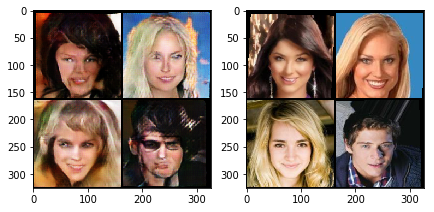

[3/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.8940	Loss_Dec: 4.5871	Aux F1: 0.8504	Loss_Enc: 901.7655	D(x): 0.6801	D(G(z)): 0.2124
[3/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.8933	Loss_Dec: 4.5871	Aux F1: 0.8505	Loss_Enc: 901.6092	D(x): 0.7326	D(G(z)): 0.1920
[3/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.8932	Loss_Dec: 4.5873	Aux F1: 0.8505	Loss_Enc: 901.6042	D(x): 0.7174	D(G(z)): 0.2226
[3/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.8935	Loss_Dec: 4.5871	Aux F1: 0.8505	Loss_Enc: 901.5704	D(x): 0.7063	D(G(z)): 0.2241
[3/5][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.8934	Loss_Dec: 4.5866	Aux F1: 0.8505	Loss_Enc: 901.4837	D(x): 0.7442	D(G(z)): 0.2024


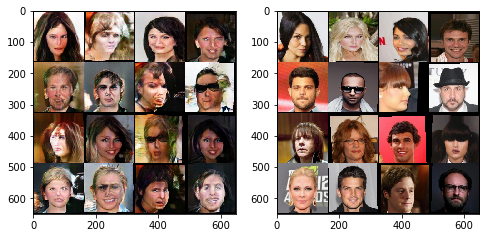

[4/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7729	Loss_Dec: 4.7358	Aux F1: 0.8638	Loss_Enc: 905.7694	D(x): 0.7377	D(G(z)): 0.1713
[4/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.9059	Loss_Dec: 4.5723	Aux F1: 0.8504	Loss_Enc: 901.3219	D(x): 0.7147	D(G(z)): 0.1949
[4/5][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.9031	Loss_Dec: 4.5742	Aux F1: 0.8511	Loss_Enc: 901.8071	D(x): 0.6893	D(G(z)): 0.1837
[4/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.8973	Loss_Dec: 4.5815	Aux F1: 0.8509	Loss_Enc: 901.9389	D(x): 0.7811	D(G(z)): 0.1637
[4/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8951	Loss_Dec: 4.5845	Aux F1: 0.8512	Loss_Enc: 902.5113	D(x): 0.7196	D(G(z)): 0.1846
[4/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8934	Loss_Dec: 4.5865	Aux F1: 0.8510	Loss_Enc: 902.2287	D(x): 0.7285	D(G(z)): 0.1641
[4/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8914	Loss_Dec: 4.5901	Aux F1: 0.8509	Loss_Enc: 902.5593	D(x): 0.7138	D(G(z)): 0.1480
[4/5][1750/5332]	Disc/Dec 

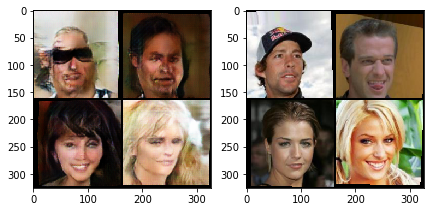

[4/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8924	Loss_Dec: 4.5885	Aux F1: 0.8508	Loss_Enc: 902.2699	D(x): 0.6921	D(G(z)): 0.1975
[4/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8926	Loss_Dec: 4.5877	Aux F1: 0.8508	Loss_Enc: 902.3830	D(x): 0.7448	D(G(z)): 0.1928
[4/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8925	Loss_Dec: 4.5873	Aux F1: 0.8507	Loss_Enc: 902.3277	D(x): 0.6840	D(G(z)): 0.2164
[4/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8927	Loss_Dec: 4.5872	Aux F1: 0.8508	Loss_Enc: 902.3295	D(x): 0.7481	D(G(z)): 0.1538
[4/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8920	Loss_Dec: 4.5870	Aux F1: 0.8507	Loss_Enc: 902.2353	D(x): 0.7219	D(G(z)): 0.2473
[4/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.8926	Loss_Dec: 4.5855	Aux F1: 0.8507	Loss_Enc: 902.2286	D(x): 0.6826	D(G(z)): 0.1838
[4/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.8932	Loss_Dec: 4.5846	Aux F1: 0.8506	Loss_Enc: 902.2737	D(x): 0.7134	D(G(z)): 0.1889
[4/5][

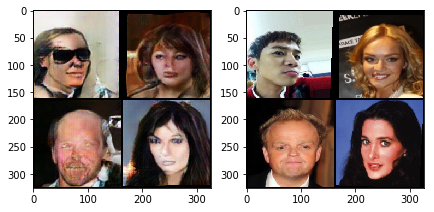

[4/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.8926	Loss_Dec: 4.5833	Aux F1: 0.8506	Loss_Enc: 901.9366	D(x): 0.7252	D(G(z)): 0.2052
[4/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.8930	Loss_Dec: 4.5835	Aux F1: 0.8506	Loss_Enc: 901.9384	D(x): 0.6995	D(G(z)): 0.2343
[4/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.8941	Loss_Dec: 4.5817	Aux F1: 0.8507	Loss_Enc: 901.8135	D(x): 0.6477	D(G(z)): 0.2286
[4/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.8938	Loss_Dec: 4.5819	Aux F1: 0.8506	Loss_Enc: 901.7657	D(x): 0.6716	D(G(z)): 0.2122
[4/5][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.8932	Loss_Dec: 4.5820	Aux F1: 0.8506	Loss_Enc: 901.6965	D(x): 0.6303	D(G(z)): 0.2383


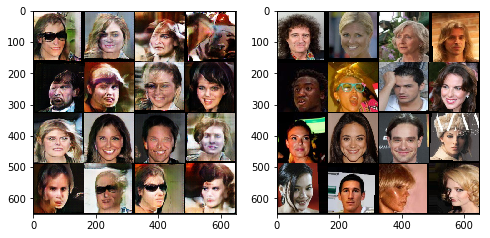

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.4625, plot_images=2000)

[0/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7420	Loss_Dec: 4.7485	Aux F1: 0.8454	Loss_Enc: 903.9514	D(x): 0.7475	D(G(z)): 0.1955
[0/3][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8712	Loss_Dec: 4.6090	Aux F1: 0.8502	Loss_Enc: 904.9720	D(x): 0.6829	D(G(z)): 0.2322
[0/3][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8697	Loss_Dec: 4.6110	Aux F1: 0.8500	Loss_Enc: 905.7196	D(x): 0.7043	D(G(z)): 0.2146
[0/3][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8711	Loss_Dec: 4.6045	Aux F1: 0.8500	Loss_Enc: 903.7707	D(x): 0.7765	D(G(z)): 0.1931
[0/3][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8730	Loss_Dec: 4.6037	Aux F1: 0.8502	Loss_Enc: 904.5210	D(x): 0.6893	D(G(z)): 0.2320
[0/3][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8741	Loss_Dec: 4.6029	Aux F1: 0.8502	Loss_Enc: 904.5509	D(x): 0.7217	D(G(z)): 0.1980
[0/3][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8737	Loss_Dec: 4.6035	Aux F1: 0.8503	Loss_Enc: 904.6997	D(x): 0.6824	D(G(z)): 0.2186
[0/3][1750/5332]	Disc/Dec 

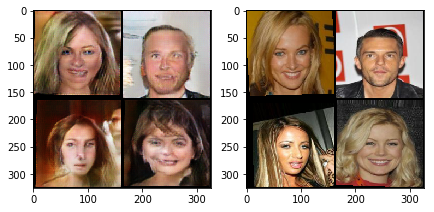

[0/3][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8716	Loss_Dec: 4.6065	Aux F1: 0.8505	Loss_Enc: 904.7339	D(x): 0.7000	D(G(z)): 0.2430
[0/3][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8715	Loss_Dec: 4.6066	Aux F1: 0.8504	Loss_Enc: 904.6569	D(x): 0.6610	D(G(z)): 0.1828
[0/3][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8716	Loss_Dec: 4.6070	Aux F1: 0.8505	Loss_Enc: 904.4903	D(x): 0.7223	D(G(z)): 0.2244
[0/3][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8709	Loss_Dec: 4.6074	Aux F1: 0.8504	Loss_Enc: 904.4386	D(x): 0.7069	D(G(z)): 0.2040
[0/3][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8700	Loss_Dec: 4.6086	Aux F1: 0.8504	Loss_Enc: 904.6826	D(x): 0.6861	D(G(z)): 0.2223
[0/3][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8704	Loss_Dec: 4.6075	Aux F1: 0.8504	Loss_Enc: 904.5777	D(x): 0.6845	D(G(z)): 0.1969
[0/3][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8702	Loss_Dec: 4.6080	Aux F1: 0.8505	Loss_Enc: 904.4207	D(x): 0.7242	D(G(z)): 0.2230
[0/3][

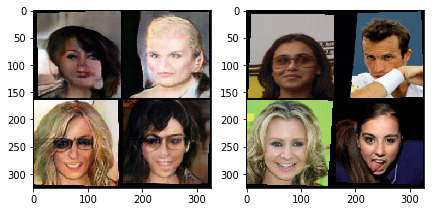

[0/3][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8694	Loss_Dec: 4.6070	Aux F1: 0.8506	Loss_Enc: 904.3894	D(x): 0.7625	D(G(z)): 0.1859
[0/3][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8686	Loss_Dec: 4.6079	Aux F1: 0.8506	Loss_Enc: 904.4362	D(x): 0.7560	D(G(z)): 0.1935
[0/3][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8687	Loss_Dec: 4.6083	Aux F1: 0.8505	Loss_Enc: 904.5391	D(x): 0.7763	D(G(z)): 0.2269
[0/3][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8690	Loss_Dec: 4.6082	Aux F1: 0.8506	Loss_Enc: 904.5118	D(x): 0.6695	D(G(z)): 0.1985
[0/3][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8684	Loss_Dec: 4.6084	Aux F1: 0.8505	Loss_Enc: 904.4759	D(x): 0.7610	D(G(z)): 0.1535


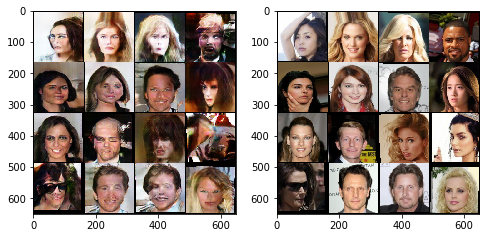

[1/3][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.6805	Loss_Dec: 4.8634	Aux F1: 0.8533	Loss_Enc: 912.5477	D(x): 0.7726	D(G(z)): 0.1808
[1/3][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8628	Loss_Dec: 4.6222	Aux F1: 0.8495	Loss_Enc: 905.4476	D(x): 0.7391	D(G(z)): 0.2707
[1/3][500/5332]	Disc/Dec Trains: 27.0/501.0	Loss_D: 0.8611	Loss_Dec: 4.6253	Aux F1: 0.8502	Loss_Enc: 906.1602	D(x): 0.7081	D(G(z)): 0.2026
Interrupting... Saving model...


In [0]:
train(net, n_epochs=3, train_loader=train_loader, margin=0.46, plot_images=2000)

[0/2][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7107	Loss_Dec: 4.7157	Aux F1: 0.8493	Loss_Enc: 894.3674	D(x): 0.7528	D(G(z)): 0.1932
[0/2][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8483	Loss_Dec: 4.6540	Aux F1: 0.8508	Loss_Enc: 909.5764	D(x): 0.7745	D(G(z)): 0.1846
[0/2][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8549	Loss_Dec: 4.6364	Aux F1: 0.8504	Loss_Enc: 907.4331	D(x): 0.6865	D(G(z)): 0.1639
[0/2][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8581	Loss_Dec: 4.6273	Aux F1: 0.8502	Loss_Enc: 905.9719	D(x): 0.7011	D(G(z)): 0.2283
[0/2][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8578	Loss_Dec: 4.6264	Aux F1: 0.8502	Loss_Enc: 906.0190	D(x): 0.6945	D(G(z)): 0.1900
[0/2][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8578	Loss_Dec: 4.6231	Aux F1: 0.8501	Loss_Enc: 905.7000	D(x): 0.6554	D(G(z)): 0.2152
[0/2][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8589	Loss_Dec: 4.6194	Aux F1: 0.8501	Loss_Enc: 905.1367	D(x): 0.6836	D(G(z)): 0.2335
[0/2][1750/5332]	Disc/Dec 

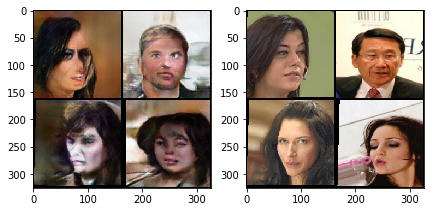

[0/2][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8568	Loss_Dec: 4.6189	Aux F1: 0.8503	Loss_Enc: 904.8240	D(x): 0.6949	D(G(z)): 0.2069
[0/2][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8564	Loss_Dec: 4.6191	Aux F1: 0.8504	Loss_Enc: 904.8592	D(x): 0.7090	D(G(z)): 0.2150
[0/2][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8575	Loss_Dec: 4.6163	Aux F1: 0.8505	Loss_Enc: 904.4558	D(x): 0.7119	D(G(z)): 0.2038
[0/2][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8569	Loss_Dec: 4.6163	Aux F1: 0.8505	Loss_Enc: 904.3531	D(x): 0.6663	D(G(z)): 0.2449
[0/2][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8573	Loss_Dec: 4.6159	Aux F1: 0.8504	Loss_Enc: 904.4518	D(x): 0.7576	D(G(z)): 0.1734
[0/2][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.8576	Loss_Dec: 4.6153	Aux F1: 0.8505	Loss_Enc: 904.4726	D(x): 0.7309	D(G(z)): 0.2052
[0/2][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.8575	Loss_Dec: 4.6156	Aux F1: 0.8505	Loss_Enc: 904.5631	D(x): 0.7489	D(G(z)): 0.1852
[0/2][

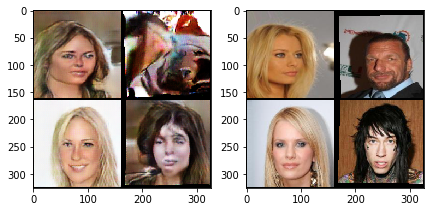

[0/2][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.8563	Loss_Dec: 4.6159	Aux F1: 0.8506	Loss_Enc: 904.8283	D(x): 0.7139	D(G(z)): 0.2018
[0/2][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.8557	Loss_Dec: 4.6170	Aux F1: 0.8506	Loss_Enc: 904.8951	D(x): 0.7005	D(G(z)): 0.1875
[0/2][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.8557	Loss_Dec: 4.6170	Aux F1: 0.8506	Loss_Enc: 904.8780	D(x): 0.7589	D(G(z)): 0.1948
[0/2][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.8559	Loss_Dec: 4.6165	Aux F1: 0.8506	Loss_Enc: 904.9568	D(x): 0.7086	D(G(z)): 0.2100
[0/2][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.8564	Loss_Dec: 4.6155	Aux F1: 0.8506	Loss_Enc: 904.9550	D(x): 0.7605	D(G(z)): 0.1982


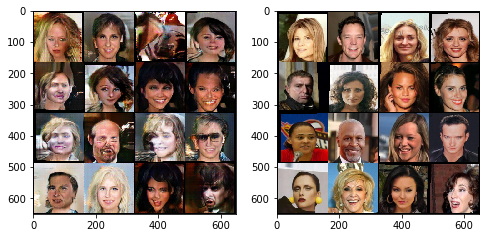

[1/2][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.8906	Loss_Dec: 4.5647	Aux F1: 0.8526	Loss_Enc: 887.4720	D(x): 0.7188	D(G(z)): 0.2113
[1/2][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8396	Loss_Dec: 4.6264	Aux F1: 0.8531	Loss_Enc: 907.5975	D(x): 0.7081	D(G(z)): 0.1828
[1/2][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8482	Loss_Dec: 4.6196	Aux F1: 0.8517	Loss_Enc: 905.9632	D(x): 0.7451	D(G(z)): 0.1874
[1/2][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8481	Loss_Dec: 4.6226	Aux F1: 0.8513	Loss_Enc: 906.2897	D(x): 0.6927	D(G(z)): 0.1978
[1/2][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8479	Loss_Dec: 4.6244	Aux F1: 0.8512	Loss_Enc: 905.8482	D(x): 0.7728	D(G(z)): 0.2039
[1/2][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8492	Loss_Dec: 4.6229	Aux F1: 0.8512	Loss_Enc: 905.8824	D(x): 0.6852	D(G(z)): 0.1978
[1/2][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8503	Loss_Dec: 4.6213	Aux F1: 0.8509	Loss_Enc: 906.3158	D(x): 0.7105	D(G(z)): 0.1865
[1/2][1750/5332]	Disc/Dec 

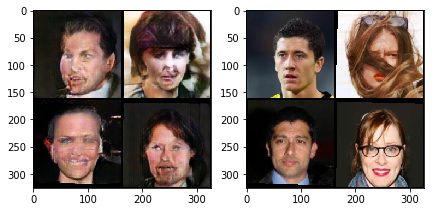

[1/2][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8519	Loss_Dec: 4.6166	Aux F1: 0.8509	Loss_Enc: 906.0100	D(x): 0.6987	D(G(z)): 0.2126
[1/2][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8528	Loss_Dec: 4.6156	Aux F1: 0.8508	Loss_Enc: 905.9164	D(x): 0.7014	D(G(z)): 0.1794
[1/2][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8530	Loss_Dec: 4.6165	Aux F1: 0.8508	Loss_Enc: 905.8100	D(x): 0.6702	D(G(z)): 0.1996
[1/2][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8515	Loss_Dec: 4.6178	Aux F1: 0.8508	Loss_Enc: 905.9038	D(x): 0.6982	D(G(z)): 0.2070
[1/2][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8516	Loss_Dec: 4.6179	Aux F1: 0.8507	Loss_Enc: 905.7146	D(x): 0.6659	D(G(z)): 0.1689
[1/2][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8500	Loss_Dec: 4.6212	Aux F1: 0.8507	Loss_Enc: 905.9282	D(x): 0.6828	D(G(z)): 0.1872
[1/2][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8499	Loss_Dec: 4.6209	Aux F1: 0.8507	Loss_Enc: 905.7986	D(x): 0.7404	D(G(z)): 0.1353
[1/2][

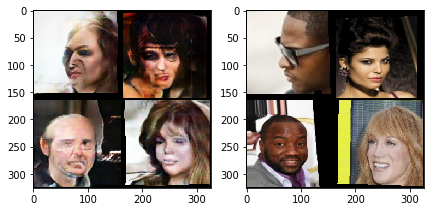

[1/2][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8500	Loss_Dec: 4.6199	Aux F1: 0.8507	Loss_Enc: 905.5637	D(x): 0.7434	D(G(z)): 0.1896
[1/2][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8498	Loss_Dec: 4.6198	Aux F1: 0.8507	Loss_Enc: 905.5788	D(x): 0.7651	D(G(z)): 0.1731
[1/2][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8492	Loss_Dec: 4.6203	Aux F1: 0.8507	Loss_Enc: 905.4887	D(x): 0.7457	D(G(z)): 0.1966
[1/2][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8486	Loss_Dec: 4.6211	Aux F1: 0.8508	Loss_Enc: 905.4584	D(x): 0.6998	D(G(z)): 0.1879
[1/2][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8485	Loss_Dec: 4.6210	Aux F1: 0.8508	Loss_Enc: 905.4847	D(x): 0.6439	D(G(z)): 0.2193


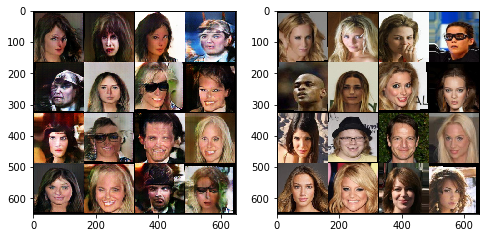

In [0]:
train(net, n_epochs=2, train_loader=train_loader, margin=0.46, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7290	Loss_Dec: 4.8353	Aux F1: 0.8533	Loss_Enc: 908.5483	D(x): 0.7442	D(G(z)): 0.2004
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8382	Loss_Dec: 4.6502	Aux F1: 0.8503	Loss_Enc: 909.8747	D(x): 0.7259	D(G(z)): 0.2193
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8364	Loss_Dec: 4.6426	Aux F1: 0.8510	Loss_Enc: 908.4314	D(x): 0.8146	D(G(z)): 0.1395
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8288	Loss_Dec: 4.6495	Aux F1: 0.8511	Loss_Enc: 908.6638	D(x): 0.7011	D(G(z)): 0.1850
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8316	Loss_Dec: 4.6495	Aux F1: 0.8510	Loss_Enc: 908.0532	D(x): 0.7240	D(G(z)): 0.1750
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8325	Loss_Dec: 4.6482	Aux F1: 0.8511	Loss_Enc: 908.1237	D(x): 0.6960	D(G(z)): 0.2441
[0/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8309	Loss_Dec: 4.6477	Aux F1: 0.8512	Loss_Enc: 907.5680	D(x): 0.6868	D(G(z)): 0.2087
[0/5][1750/5332]	Disc/Dec 

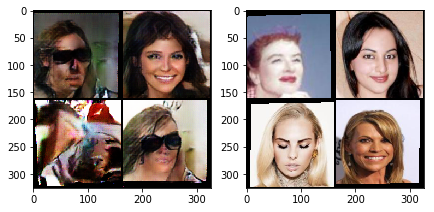

[0/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8280	Loss_Dec: 4.6520	Aux F1: 0.8513	Loss_Enc: 907.7685	D(x): 0.7605	D(G(z)): 0.1477
[0/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8280	Loss_Dec: 4.6528	Aux F1: 0.8513	Loss_Enc: 907.7783	D(x): 0.7297	D(G(z)): 0.1393
[0/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8287	Loss_Dec: 4.6524	Aux F1: 0.8513	Loss_Enc: 907.7042	D(x): 0.6998	D(G(z)): 0.2329
[0/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8275	Loss_Dec: 4.6539	Aux F1: 0.8512	Loss_Enc: 907.9204	D(x): 0.7530	D(G(z)): 0.1521
[0/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8270	Loss_Dec: 4.6538	Aux F1: 0.8512	Loss_Enc: 907.9091	D(x): 0.7083	D(G(z)): 0.2141
[0/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8273	Loss_Dec: 4.6535	Aux F1: 0.8511	Loss_Enc: 907.8037	D(x): 0.7034	D(G(z)): 0.2081
[0/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8266	Loss_Dec: 4.6547	Aux F1: 0.8511	Loss_Enc: 907.8544	D(x): 0.7445	D(G(z)): 0.1953
[0/5][

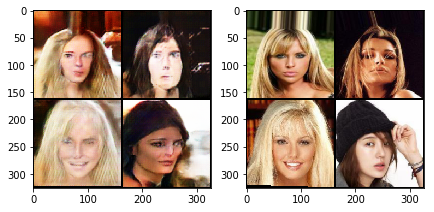

[0/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8271	Loss_Dec: 4.6542	Aux F1: 0.8510	Loss_Enc: 907.7831	D(x): 0.7199	D(G(z)): 0.2147
[0/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8266	Loss_Dec: 4.6553	Aux F1: 0.8510	Loss_Enc: 908.0456	D(x): 0.6795	D(G(z)): 0.2095
[0/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8261	Loss_Dec: 4.6559	Aux F1: 0.8510	Loss_Enc: 908.1032	D(x): 0.6989	D(G(z)): 0.1791
[0/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8260	Loss_Dec: 4.6560	Aux F1: 0.8509	Loss_Enc: 907.9949	D(x): 0.7546	D(G(z)): 0.1977
[0/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8258	Loss_Dec: 4.6560	Aux F1: 0.8509	Loss_Enc: 907.9036	D(x): 0.6804	D(G(z)): 0.1927


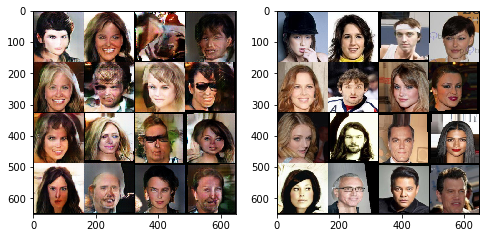

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7851	Loss_Dec: 4.4600	Aux F1: 0.8539	Loss_Enc: 888.1125	D(x): 0.7238	D(G(z)): 0.1865
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8263	Loss_Dec: 4.6573	Aux F1: 0.8498	Loss_Enc: 908.3830	D(x): 0.7537	D(G(z)): 0.1391
[1/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8212	Loss_Dec: 4.6623	Aux F1: 0.8509	Loss_Enc: 908.3635	D(x): 0.7510	D(G(z)): 0.1963
[1/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8203	Loss_Dec: 4.6616	Aux F1: 0.8510	Loss_Enc: 907.9644	D(x): 0.7265	D(G(z)): 0.1962
[1/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8244	Loss_Dec: 4.6571	Aux F1: 0.8512	Loss_Enc: 907.6328	D(x): 0.7657	D(G(z)): 0.1927
[1/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8236	Loss_Dec: 4.6580	Aux F1: 0.8513	Loss_Enc: 907.6280	D(x): 0.7381	D(G(z)): 0.2007
[1/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8244	Loss_Dec: 4.6576	Aux F1: 0.8513	Loss_Enc: 907.5266	D(x): 0.7033	D(G(z)): 0.2077
[1/5][1750/5332]	Disc/Dec 

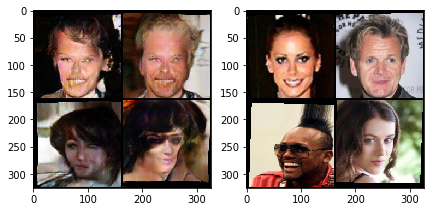

[1/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8241	Loss_Dec: 4.6596	Aux F1: 0.8511	Loss_Enc: 907.9257	D(x): 0.7197	D(G(z)): 0.1857
[1/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8240	Loss_Dec: 4.6585	Aux F1: 0.8511	Loss_Enc: 907.6300	D(x): 0.7894	D(G(z)): 0.2160
[1/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8222	Loss_Dec: 4.6589	Aux F1: 0.8511	Loss_Enc: 907.6294	D(x): 0.6862	D(G(z)): 0.2035
[1/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8220	Loss_Dec: 4.6590	Aux F1: 0.8510	Loss_Enc: 907.4869	D(x): 0.7174	D(G(z)): 0.1606
[1/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8221	Loss_Dec: 4.6581	Aux F1: 0.8509	Loss_Enc: 907.3238	D(x): 0.7237	D(G(z)): 0.2016
[1/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8216	Loss_Dec: 4.6574	Aux F1: 0.8510	Loss_Enc: 907.1861	D(x): 0.6989	D(G(z)): 0.2126
[1/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8217	Loss_Dec: 4.6576	Aux F1: 0.8510	Loss_Enc: 907.3798	D(x): 0.7458	D(G(z)): 0.1976
[1/5][

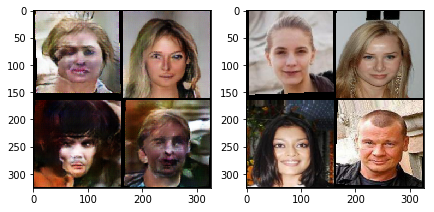

[1/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8216	Loss_Dec: 4.6582	Aux F1: 0.8510	Loss_Enc: 907.5074	D(x): 0.7614	D(G(z)): 0.1679
[1/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8218	Loss_Dec: 4.6579	Aux F1: 0.8510	Loss_Enc: 907.4588	D(x): 0.7212	D(G(z)): 0.2081
[1/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8208	Loss_Dec: 4.6597	Aux F1: 0.8510	Loss_Enc: 907.6498	D(x): 0.6911	D(G(z)): 0.2422
[1/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8207	Loss_Dec: 4.6594	Aux F1: 0.8510	Loss_Enc: 907.6011	D(x): 0.7060	D(G(z)): 0.1768
[1/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8202	Loss_Dec: 4.6605	Aux F1: 0.8510	Loss_Enc: 907.6766	D(x): 0.7389	D(G(z)): 0.1756


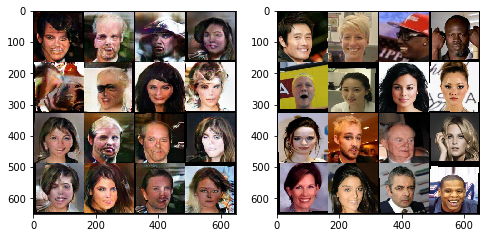

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9463	Loss_Dec: 4.4628	Aux F1: 0.8428	Loss_Enc: 897.3154	D(x): 0.6864	D(G(z)): 0.2013
[2/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8206	Loss_Dec: 4.6624	Aux F1: 0.8509	Loss_Enc: 909.3150	D(x): 0.6790	D(G(z)): 0.2004
[2/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8162	Loss_Dec: 4.6606	Aux F1: 0.8512	Loss_Enc: 907.5714	D(x): 0.7163	D(G(z)): 0.1945
[2/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8205	Loss_Dec: 4.6572	Aux F1: 0.8513	Loss_Enc: 907.1858	D(x): 0.7039	D(G(z)): 0.1980
[2/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8199	Loss_Dec: 4.6595	Aux F1: 0.8510	Loss_Enc: 907.5774	D(x): 0.7464	D(G(z)): 0.1813
[2/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8176	Loss_Dec: 4.6612	Aux F1: 0.8512	Loss_Enc: 907.8042	D(x): 0.7303	D(G(z)): 0.1767
[2/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8178	Loss_Dec: 4.6590	Aux F1: 0.8511	Loss_Enc: 907.8192	D(x): 0.7464	D(G(z)): 0.2359
[2/5][1750/5332]	Disc/Dec 

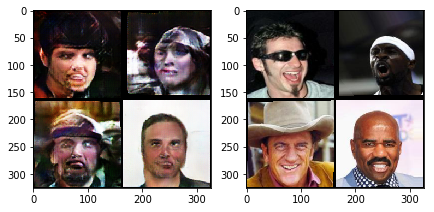

[2/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8160	Loss_Dec: 4.6653	Aux F1: 0.8510	Loss_Enc: 908.9163	D(x): 0.7263	D(G(z)): 0.1883
[2/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8160	Loss_Dec: 4.6649	Aux F1: 0.8510	Loss_Enc: 908.7285	D(x): 0.7450	D(G(z)): 0.1666
[2/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8156	Loss_Dec: 4.6658	Aux F1: 0.8509	Loss_Enc: 908.9306	D(x): 0.7476	D(G(z)): 0.1557
[2/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8165	Loss_Dec: 4.6641	Aux F1: 0.8509	Loss_Enc: 908.7775	D(x): 0.7640	D(G(z)): 0.1825
[2/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8157	Loss_Dec: 4.6646	Aux F1: 0.8509	Loss_Enc: 908.7967	D(x): 0.6524	D(G(z)): 0.2034
[2/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8164	Loss_Dec: 4.6639	Aux F1: 0.8509	Loss_Enc: 908.6365	D(x): 0.7518	D(G(z)): 0.2262
[2/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8166	Loss_Dec: 4.6642	Aux F1: 0.8510	Loss_Enc: 908.6368	D(x): 0.7242	D(G(z)): 0.1675
[2/5][

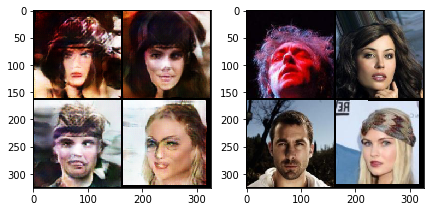

[2/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8169	Loss_Dec: 4.6631	Aux F1: 0.8509	Loss_Enc: 908.5909	D(x): 0.6864	D(G(z)): 0.1914
[2/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8164	Loss_Dec: 4.6634	Aux F1: 0.8510	Loss_Enc: 908.6415	D(x): 0.7554	D(G(z)): 0.2215
[2/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8167	Loss_Dec: 4.6637	Aux F1: 0.8510	Loss_Enc: 908.6352	D(x): 0.7589	D(G(z)): 0.2056
[2/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8162	Loss_Dec: 4.6643	Aux F1: 0.8509	Loss_Enc: 908.6315	D(x): 0.7588	D(G(z)): 0.1423
[2/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8162	Loss_Dec: 4.6649	Aux F1: 0.8510	Loss_Enc: 908.7476	D(x): 0.6805	D(G(z)): 0.1982


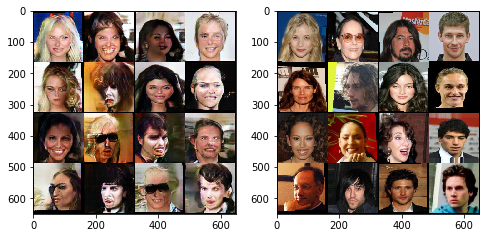

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9313	Loss_Dec: 4.3534	Aux F1: 0.8428	Loss_Enc: 882.7970	D(x): 0.6911	D(G(z)): 0.2412
[3/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8143	Loss_Dec: 4.6783	Aux F1: 0.8506	Loss_Enc: 910.4517	D(x): 0.6703	D(G(z)): 0.2215
[3/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8116	Loss_Dec: 4.6839	Aux F1: 0.8509	Loss_Enc: 910.9850	D(x): 0.7579	D(G(z)): 0.1901
[3/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8144	Loss_Dec: 4.6724	Aux F1: 0.8510	Loss_Enc: 909.5714	D(x): 0.7251	D(G(z)): 0.1870
[3/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8146	Loss_Dec: 4.6710	Aux F1: 0.8511	Loss_Enc: 909.2479	D(x): 0.6432	D(G(z)): 0.1829
[3/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8124	Loss_Dec: 4.6703	Aux F1: 0.8511	Loss_Enc: 909.4424	D(x): 0.7694	D(G(z)): 0.1571
[3/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8112	Loss_Dec: 4.6716	Aux F1: 0.8511	Loss_Enc: 909.2615	D(x): 0.7447	D(G(z)): 0.1845
[3/5][1750/5332]	Disc/Dec 

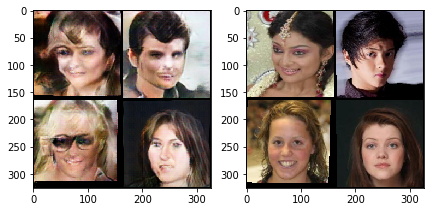

[3/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8096	Loss_Dec: 4.6755	Aux F1: 0.8509	Loss_Enc: 909.5246	D(x): 0.7351	D(G(z)): 0.1859
[3/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8102	Loss_Dec: 4.6745	Aux F1: 0.8509	Loss_Enc: 909.2469	D(x): 0.6850	D(G(z)): 0.1845
[3/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8103	Loss_Dec: 4.6749	Aux F1: 0.8509	Loss_Enc: 909.1307	D(x): 0.7253	D(G(z)): 0.1811
[3/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8093	Loss_Dec: 4.6761	Aux F1: 0.8509	Loss_Enc: 909.1861	D(x): 0.7496	D(G(z)): 0.2143
[3/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8091	Loss_Dec: 4.6759	Aux F1: 0.8509	Loss_Enc: 909.1652	D(x): 0.6803	D(G(z)): 0.2161
[3/5][3500/5332]	Disc/Dec Trains: 178.0/3501.0	Loss_D: 0.8089	Loss_Dec: 4.6766	Aux F1: 0.8509	Loss_Enc: 909.2915	D(x): 0.7637	D(G(z)): 0.1574
[3/5][3750/5332]	Disc/Dec Trains: 190.0/3751.0	Loss_D: 0.8086	Loss_Dec: 4.6765	Aux F1: 0.8510	Loss_Enc: 909.2479	D(x): 0.6863	D(G(z)): 0.2081
[3/5][

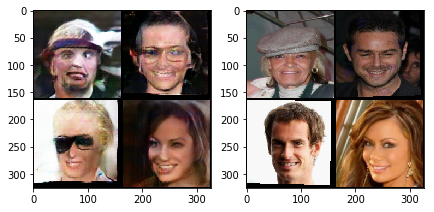

[3/5][4250/5332]	Disc/Dec Trains: 215.0/4251.0	Loss_D: 0.8089	Loss_Dec: 4.6765	Aux F1: 0.8510	Loss_Enc: 909.3598	D(x): 0.7042	D(G(z)): 0.1946
[3/5][4500/5332]	Disc/Dec Trains: 228.0/4501.0	Loss_D: 0.8088	Loss_Dec: 4.6771	Aux F1: 0.8510	Loss_Enc: 909.3689	D(x): 0.7242	D(G(z)): 0.1773
[3/5][4750/5332]	Disc/Dec Trains: 240.0/4751.0	Loss_D: 0.8088	Loss_Dec: 4.6765	Aux F1: 0.8510	Loss_Enc: 909.3129	D(x): 0.6916	D(G(z)): 0.1667
[3/5][5000/5332]	Disc/Dec Trains: 253.0/5001.0	Loss_D: 0.8090	Loss_Dec: 4.6763	Aux F1: 0.8510	Loss_Enc: 909.2842	D(x): 0.6888	D(G(z)): 0.2241
[3/5][5250/5332]	Disc/Dec Trains: 265.0/5251.0	Loss_D: 0.8093	Loss_Dec: 4.6758	Aux F1: 0.8510	Loss_Enc: 909.2743	D(x): 0.7684	D(G(z)): 0.1708


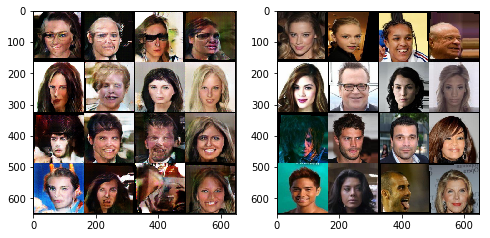

[4/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7382	Loss_Dec: 4.7205	Aux F1: 0.8632	Loss_Enc: 905.8759	D(x): 0.7449	D(G(z)): 0.1594
[4/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8023	Loss_Dec: 4.6961	Aux F1: 0.8518	Loss_Enc: 909.9558	D(x): 0.7271	D(G(z)): 0.2083
[4/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8098	Loss_Dec: 4.6854	Aux F1: 0.8514	Loss_Enc: 909.5719	D(x): 0.7194	D(G(z)): 0.2247
[4/5][750/5332]	Disc/Dec Trains: 39.0/751.0	Loss_D: 0.8103	Loss_Dec: 4.6824	Aux F1: 0.8514	Loss_Enc: 909.4541	D(x): 0.6799	D(G(z)): 0.1758
[4/5][1000/5332]	Disc/Dec Trains: 52.0/1001.0	Loss_D: 0.8104	Loss_Dec: 4.6802	Aux F1: 0.8512	Loss_Enc: 908.8913	D(x): 0.6902	D(G(z)): 0.2667
[4/5][1250/5332]	Disc/Dec Trains: 64.0/1251.0	Loss_D: 0.8083	Loss_Dec: 4.6776	Aux F1: 0.8512	Loss_Enc: 908.8107	D(x): 0.7633	D(G(z)): 0.1749
[4/5][1500/5332]	Disc/Dec Trains: 77.0/1501.0	Loss_D: 0.8062	Loss_Dec: 4.6801	Aux F1: 0.8513	Loss_Enc: 909.4424	D(x): 0.7693	D(G(z)): 0.1772
[4/5][1750/5332]	Disc/Dec 

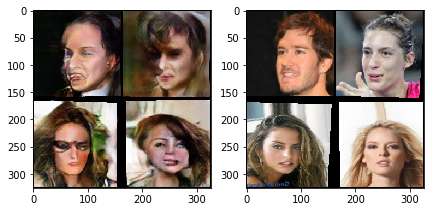

[4/5][2250/5332]	Disc/Dec Trains: 114.0/2251.0	Loss_D: 0.8058	Loss_Dec: 4.6832	Aux F1: 0.8512	Loss_Enc: 909.8314	D(x): 0.7306	D(G(z)): 0.2250
[4/5][2500/5332]	Disc/Dec Trains: 127.0/2501.0	Loss_D: 0.8062	Loss_Dec: 4.6821	Aux F1: 0.8512	Loss_Enc: 910.0511	D(x): 0.7271	D(G(z)): 0.2102
[4/5][2750/5332]	Disc/Dec Trains: 139.0/2751.0	Loss_D: 0.8062	Loss_Dec: 4.6812	Aux F1: 0.8511	Loss_Enc: 909.7434	D(x): 0.7580	D(G(z)): 0.1891
[4/5][3000/5332]	Disc/Dec Trains: 152.0/3001.0	Loss_D: 0.8067	Loss_Dec: 4.6809	Aux F1: 0.8512	Loss_Enc: 909.4092	D(x): 0.7460	D(G(z)): 0.1729
[4/5][3250/5332]	Disc/Dec Trains: 164.0/3251.0	Loss_D: 0.8063	Loss_Dec: 4.6817	Aux F1: 0.8512	Loss_Enc: 909.4642	D(x): 0.7238	D(G(z)): 0.1690
[4/5][3500/5332]	Disc/Dec Trains: 177.0/3501.0	Loss_D: 0.8063	Loss_Dec: 4.6823	Aux F1: 0.8511	Loss_Enc: 909.5578	D(x): 0.7073	D(G(z)): 0.2156
[4/5][3750/5332]	Disc/Dec Trains: 189.0/3751.0	Loss_D: 0.8067	Loss_Dec: 4.6823	Aux F1: 0.8511	Loss_Enc: 909.5751	D(x): 0.7063	D(G(z)): 0.1643
[4/5][

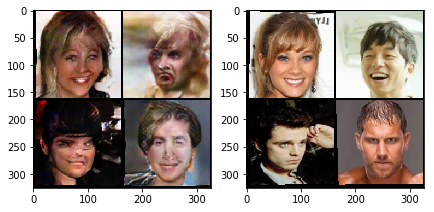

[4/5][4250/5332]	Disc/Dec Trains: 214.0/4251.0	Loss_D: 0.8073	Loss_Dec: 4.6812	Aux F1: 0.8511	Loss_Enc: 909.2928	D(x): 0.7219	D(G(z)): 0.2034
[4/5][4500/5332]	Disc/Dec Trains: 227.0/4501.0	Loss_D: 0.8076	Loss_Dec: 4.6808	Aux F1: 0.8511	Loss_Enc: 909.3137	D(x): 0.6813	D(G(z)): 0.2142
[4/5][4750/5332]	Disc/Dec Trains: 239.0/4751.0	Loss_D: 0.8080	Loss_Dec: 4.6802	Aux F1: 0.8511	Loss_Enc: 909.2679	D(x): 0.6959	D(G(z)): 0.2016
[4/5][5000/5332]	Disc/Dec Trains: 252.0/5001.0	Loss_D: 0.8079	Loss_Dec: 4.6804	Aux F1: 0.8511	Loss_Enc: 909.2960	D(x): 0.7424	D(G(z)): 0.1470
[4/5][5250/5332]	Disc/Dec Trains: 264.0/5251.0	Loss_D: 0.8074	Loss_Dec: 4.6809	Aux F1: 0.8511	Loss_Enc: 909.4941	D(x): 0.6895	D(G(z)): 0.2108


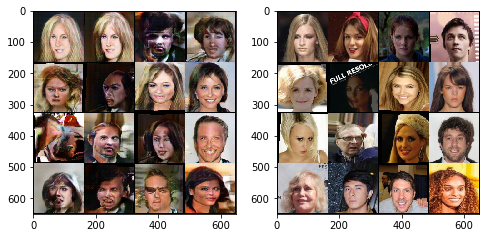

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.4575, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7593	Loss_Dec: 4.5186	Aux F1: 0.8526	Loss_Enc: 877.2675	D(x): 0.7113	D(G(z)): 0.1674
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.7886	Loss_Dec: 4.7066	Aux F1: 0.8509	Loss_Enc: 913.4239	D(x): 0.7155	D(G(z)): 0.2289
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.7921	Loss_Dec: 4.6992	Aux F1: 0.8512	Loss_Enc: 911.4344	D(x): 0.6996	D(G(z)): 0.1910
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.7978	Loss_Dec: 4.6944	Aux F1: 0.8513	Loss_Enc: 911.0061	D(x): 0.6618	D(G(z)): 0.1862
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.7965	Loss_Dec: 4.6961	Aux F1: 0.8511	Loss_Enc: 910.6927	D(x): 0.6830	D(G(z)): 0.1696
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.7987	Loss_Dec: 4.6927	Aux F1: 0.8513	Loss_Enc: 909.7626	D(x): 0.7288	D(G(z)): 0.2044
[0/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.7991	Loss_Dec: 4.6910	Aux F1: 0.8514	Loss_Enc: 909.7393	D(x): 0.7671	D(G(z)): 0.1909
[0/5][1750/5332]	Disc/Dec 

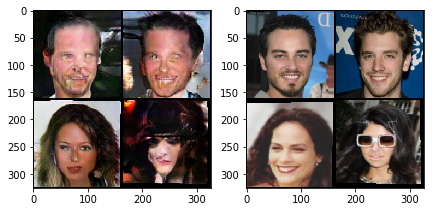

[0/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.7997	Loss_Dec: 4.6897	Aux F1: 0.8511	Loss_Enc: 909.7609	D(x): 0.7161	D(G(z)): 0.1847
[0/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8013	Loss_Dec: 4.6881	Aux F1: 0.8511	Loss_Enc: 909.6163	D(x): 0.7353	D(G(z)): 0.1963
[0/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8019	Loss_Dec: 4.6896	Aux F1: 0.8511	Loss_Enc: 909.8493	D(x): 0.7674	D(G(z)): 0.1657
[0/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8014	Loss_Dec: 4.6890	Aux F1: 0.8511	Loss_Enc: 909.7989	D(x): 0.6933	D(G(z)): 0.1987
[0/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8012	Loss_Dec: 4.6896	Aux F1: 0.8510	Loss_Enc: 909.8416	D(x): 0.6609	D(G(z)): 0.2533
[0/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8005	Loss_Dec: 4.6914	Aux F1: 0.8510	Loss_Enc: 910.0262	D(x): 0.7226	D(G(z)): 0.1559
[0/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8010	Loss_Dec: 4.6910	Aux F1: 0.8511	Loss_Enc: 910.0169	D(x): 0.7585	D(G(z)): 0.1464
[0/5][

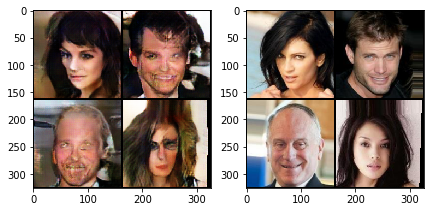

[0/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8019	Loss_Dec: 4.6885	Aux F1: 0.8511	Loss_Enc: 909.8389	D(x): 0.7666	D(G(z)): 0.1828
[0/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8017	Loss_Dec: 4.6888	Aux F1: 0.8511	Loss_Enc: 909.9351	D(x): 0.7470	D(G(z)): 0.1672
[0/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8015	Loss_Dec: 4.6887	Aux F1: 0.8510	Loss_Enc: 909.8292	D(x): 0.7079	D(G(z)): 0.1834
[0/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8017	Loss_Dec: 4.6892	Aux F1: 0.8510	Loss_Enc: 909.9225	D(x): 0.7188	D(G(z)): 0.1751
[0/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8014	Loss_Dec: 4.6892	Aux F1: 0.8510	Loss_Enc: 909.9550	D(x): 0.7071	D(G(z)): 0.2301


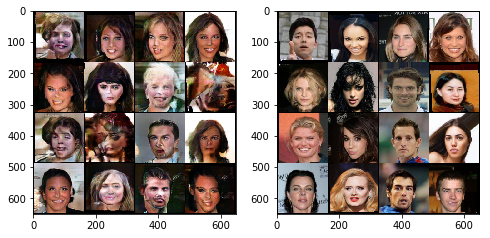

[1/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.7361	Loss_Dec: 4.7263	Aux F1: 0.8513	Loss_Enc: 942.6193	D(x): 0.7359	D(G(z)): 0.1679
[1/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8000	Loss_Dec: 4.6899	Aux F1: 0.8518	Loss_Enc: 910.7444	D(x): 0.7011	D(G(z)): 0.1788
[1/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.8037	Loss_Dec: 4.6800	Aux F1: 0.8511	Loss_Enc: 910.6334	D(x): 0.7400	D(G(z)): 0.2352
[1/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8022	Loss_Dec: 4.6887	Aux F1: 0.8511	Loss_Enc: 910.2179	D(x): 0.7499	D(G(z)): 0.1609
[1/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8018	Loss_Dec: 4.6897	Aux F1: 0.8510	Loss_Enc: 909.8342	D(x): 0.6955	D(G(z)): 0.2010
[1/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8043	Loss_Dec: 4.6867	Aux F1: 0.8509	Loss_Enc: 909.6293	D(x): 0.6653	D(G(z)): 0.2212
[1/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8035	Loss_Dec: 4.6868	Aux F1: 0.8509	Loss_Enc: 909.3459	D(x): 0.7348	D(G(z)): 0.2048
[1/5][1750/5332]	Disc/Dec 

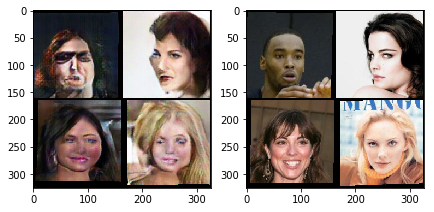

[1/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8035	Loss_Dec: 4.6867	Aux F1: 0.8509	Loss_Enc: 909.5897	D(x): 0.7557	D(G(z)): 0.2346
[1/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.8032	Loss_Dec: 4.6863	Aux F1: 0.8510	Loss_Enc: 909.3793	D(x): 0.6854	D(G(z)): 0.1923
[1/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.8024	Loss_Dec: 4.6869	Aux F1: 0.8510	Loss_Enc: 909.5854	D(x): 0.7243	D(G(z)): 0.2217
[1/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.8024	Loss_Dec: 4.6875	Aux F1: 0.8511	Loss_Enc: 909.6916	D(x): 0.7615	D(G(z)): 0.1977
[1/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.8030	Loss_Dec: 4.6871	Aux F1: 0.8510	Loss_Enc: 909.8080	D(x): 0.6845	D(G(z)): 0.1649
[1/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.8025	Loss_Dec: 4.6873	Aux F1: 0.8510	Loss_Enc: 909.7143	D(x): 0.7216	D(G(z)): 0.1934
[1/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.8015	Loss_Dec: 4.6882	Aux F1: 0.8511	Loss_Enc: 909.7565	D(x): 0.7826	D(G(z)): 0.1659
[1/5][

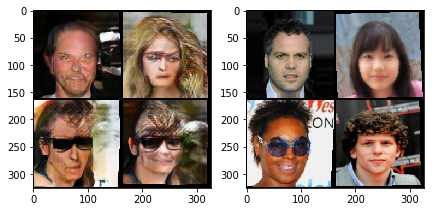

[1/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.8018	Loss_Dec: 4.6881	Aux F1: 0.8512	Loss_Enc: 909.7817	D(x): 0.7581	D(G(z)): 0.1869
[1/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.8023	Loss_Dec: 4.6877	Aux F1: 0.8512	Loss_Enc: 909.7279	D(x): 0.6563	D(G(z)): 0.1861
[1/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.8024	Loss_Dec: 4.6876	Aux F1: 0.8512	Loss_Enc: 909.8041	D(x): 0.7353	D(G(z)): 0.1938
[1/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.8022	Loss_Dec: 4.6876	Aux F1: 0.8512	Loss_Enc: 909.9026	D(x): 0.7197	D(G(z)): 0.2318
[1/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.8022	Loss_Dec: 4.6876	Aux F1: 0.8512	Loss_Enc: 909.8242	D(x): 0.7706	D(G(z)): 0.1697


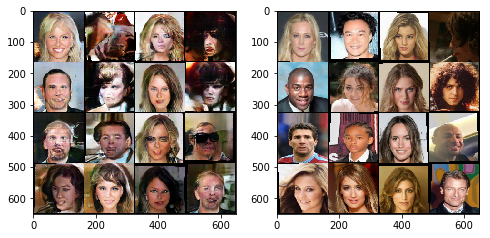

[2/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0835	Loss_Dec: 4.2595	Aux F1: 0.8625	Loss_Enc: 858.4460	D(x): 0.6536	D(G(z)): 0.2482
[2/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.8052	Loss_Dec: 4.6873	Aux F1: 0.8508	Loss_Enc: 911.3330	D(x): 0.7735	D(G(z)): 0.1909
[2/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.7969	Loss_Dec: 4.6975	Aux F1: 0.8513	Loss_Enc: 910.7821	D(x): 0.7027	D(G(z)): 0.1752
[2/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.8006	Loss_Dec: 4.6917	Aux F1: 0.8512	Loss_Enc: 910.7826	D(x): 0.7722	D(G(z)): 0.1497
[2/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.8017	Loss_Dec: 4.6887	Aux F1: 0.8514	Loss_Enc: 910.1728	D(x): 0.7749	D(G(z)): 0.1450
[2/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.8021	Loss_Dec: 4.6852	Aux F1: 0.8513	Loss_Enc: 910.2707	D(x): 0.7137	D(G(z)): 0.2044
[2/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.8036	Loss_Dec: 4.6835	Aux F1: 0.8513	Loss_Enc: 909.9235	D(x): 0.7327	D(G(z)): 0.1618
[2/5][1750/5332]	Disc/Dec 

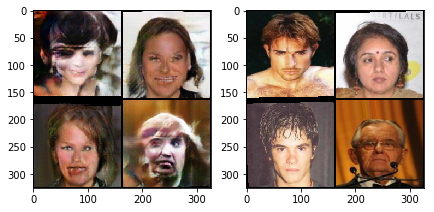

[2/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.8000	Loss_Dec: 4.6881	Aux F1: 0.8512	Loss_Enc: 910.2157	D(x): 0.7434	D(G(z)): 0.1915
[2/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.7994	Loss_Dec: 4.6899	Aux F1: 0.8511	Loss_Enc: 910.3963	D(x): 0.7629	D(G(z)): 0.1588
[2/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.7986	Loss_Dec: 4.6905	Aux F1: 0.8511	Loss_Enc: 910.4854	D(x): 0.7221	D(G(z)): 0.1723
[2/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.7986	Loss_Dec: 4.6907	Aux F1: 0.8511	Loss_Enc: 910.4154	D(x): 0.7476	D(G(z)): 0.1682
[2/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.7984	Loss_Dec: 4.6916	Aux F1: 0.8511	Loss_Enc: 910.4801	D(x): 0.7371	D(G(z)): 0.1605
[2/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.7976	Loss_Dec: 4.6923	Aux F1: 0.8511	Loss_Enc: 910.5586	D(x): 0.7625	D(G(z)): 0.1576
[2/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.7976	Loss_Dec: 4.6926	Aux F1: 0.8511	Loss_Enc: 910.6378	D(x): 0.7317	D(G(z)): 0.2086
[2/5][

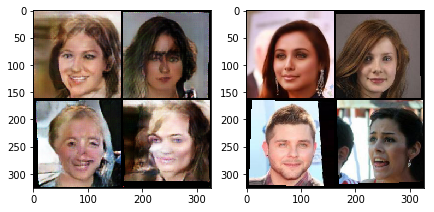

[2/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.7980	Loss_Dec: 4.6928	Aux F1: 0.8510	Loss_Enc: 910.6720	D(x): 0.6888	D(G(z)): 0.1304
[2/5][4500/5332]	Disc/Dec Trains: 226.0/4501.0	Loss_D: 0.7971	Loss_Dec: 4.6943	Aux F1: 0.8510	Loss_Enc: 910.8252	D(x): 0.7472	D(G(z)): 0.1179
[2/5][4750/5332]	Disc/Dec Trains: 238.0/4751.0	Loss_D: 0.7973	Loss_Dec: 4.6950	Aux F1: 0.8510	Loss_Enc: 910.8095	D(x): 0.7496	D(G(z)): 0.1930
[2/5][5000/5332]	Disc/Dec Trains: 251.0/5001.0	Loss_D: 0.7971	Loss_Dec: 4.6951	Aux F1: 0.8510	Loss_Enc: 910.7988	D(x): 0.8210	D(G(z)): 0.1511
[2/5][5250/5332]	Disc/Dec Trains: 263.0/5251.0	Loss_D: 0.7973	Loss_Dec: 4.6948	Aux F1: 0.8511	Loss_Enc: 910.7144	D(x): 0.7186	D(G(z)): 0.1669


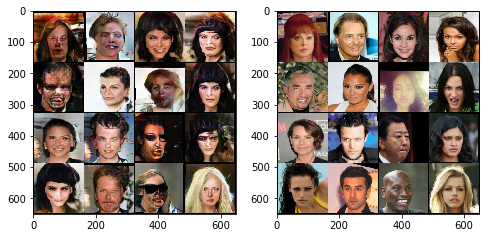

[3/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.8362	Loss_Dec: 4.3781	Aux F1: 0.8434	Loss_Enc: 863.6500	D(x): 0.7300	D(G(z)): 0.2171
[3/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.7896	Loss_Dec: 4.7123	Aux F1: 0.8522	Loss_Enc: 909.2469	D(x): 0.7508	D(G(z)): 0.1972


In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.455, plot_images=2000)

[0/5][0/5332]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9338	Loss_Dec: 4.5785	Aux F1: 0.8553	Loss_Enc: 904.3604	D(x): 0.7192	D(G(z)): 0.1914
[0/5][250/5332]	Disc/Dec Trains: 13.0/251.0	Loss_D: 0.7954	Loss_Dec: 4.6877	Aux F1: 0.8511	Loss_Enc: 910.6790	D(x): 0.7410	D(G(z)): 0.2021
[0/5][500/5332]	Disc/Dec Trains: 26.0/501.0	Loss_D: 0.7928	Loss_Dec: 4.6963	Aux F1: 0.8508	Loss_Enc: 910.4341	D(x): 0.7457	D(G(z)): 0.1889
[0/5][750/5332]	Disc/Dec Trains: 38.0/751.0	Loss_D: 0.7985	Loss_Dec: 4.6869	Aux F1: 0.8513	Loss_Enc: 908.7185	D(x): 0.7238	D(G(z)): 0.1859
[0/5][1000/5332]	Disc/Dec Trains: 51.0/1001.0	Loss_D: 0.7990	Loss_Dec: 4.6890	Aux F1: 0.8513	Loss_Enc: 908.9741	D(x): 0.6621	D(G(z)): 0.2569
[0/5][1250/5332]	Disc/Dec Trains: 63.0/1251.0	Loss_D: 0.7976	Loss_Dec: 4.6932	Aux F1: 0.8512	Loss_Enc: 909.7120	D(x): 0.8079	D(G(z)): 0.1454
[0/5][1500/5332]	Disc/Dec Trains: 76.0/1501.0	Loss_D: 0.7961	Loss_Dec: 4.6964	Aux F1: 0.8511	Loss_Enc: 909.8831	D(x): 0.7736	D(G(z)): 0.1610
[0/5][1750/5332]	Disc/Dec 

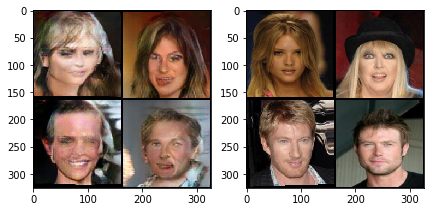

[0/5][2250/5332]	Disc/Dec Trains: 113.0/2251.0	Loss_D: 0.7979	Loss_Dec: 4.6947	Aux F1: 0.8512	Loss_Enc: 909.9002	D(x): 0.6611	D(G(z)): 0.2325
[0/5][2500/5332]	Disc/Dec Trains: 126.0/2501.0	Loss_D: 0.7966	Loss_Dec: 4.6972	Aux F1: 0.8512	Loss_Enc: 910.2348	D(x): 0.6989	D(G(z)): 0.1788
[0/5][2750/5332]	Disc/Dec Trains: 138.0/2751.0	Loss_D: 0.7957	Loss_Dec: 4.6987	Aux F1: 0.8512	Loss_Enc: 910.3772	D(x): 0.8098	D(G(z)): 0.1952
[0/5][3000/5332]	Disc/Dec Trains: 151.0/3001.0	Loss_D: 0.7957	Loss_Dec: 4.6988	Aux F1: 0.8512	Loss_Enc: 910.3601	D(x): 0.7573	D(G(z)): 0.1545
[0/5][3250/5332]	Disc/Dec Trains: 163.0/3251.0	Loss_D: 0.7955	Loss_Dec: 4.6993	Aux F1: 0.8511	Loss_Enc: 910.4273	D(x): 0.7554	D(G(z)): 0.1838
[0/5][3500/5332]	Disc/Dec Trains: 176.0/3501.0	Loss_D: 0.7955	Loss_Dec: 4.6990	Aux F1: 0.8511	Loss_Enc: 910.4844	D(x): 0.7103	D(G(z)): 0.1962
[0/5][3750/5332]	Disc/Dec Trains: 188.0/3751.0	Loss_D: 0.7956	Loss_Dec: 4.6983	Aux F1: 0.8511	Loss_Enc: 910.4486	D(x): 0.7777	D(G(z)): 0.1980
[0/5][

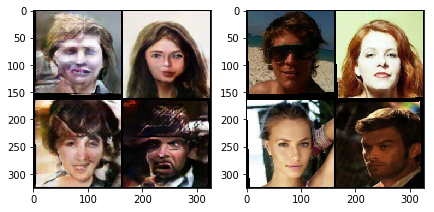

[0/5][4250/5332]	Disc/Dec Trains: 213.0/4251.0	Loss_D: 0.7955	Loss_Dec: 4.6992	Aux F1: 0.8511	Loss_Enc: 910.4510	D(x): 0.6802	D(G(z)): 0.1881
Interrupting... Saving model...


In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.4625, plot_images=2000)

[0/5][0/8442]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0763	Loss_Dec: 4.6272	Aux F1: 0.8521	Loss_Enc: 964.5862	D(x): 0.6974	D(G(z)): 0.1821
[0/5][250/8442]	Disc/Dec Trains: 27.0/251.0	Loss_D: 1.0647	Loss_Dec: 4.3738	Aux F1: 0.8497	Loss_Enc: 939.7004	D(x): 0.6452	D(G(z)): 0.2515
[0/5][500/8442]	Disc/Dec Trains: 68.0/501.0	Loss_D: 1.0637	Loss_Dec: 4.3560	Aux F1: 0.8503	Loss_Enc: 939.3435	D(x): 0.7330	D(G(z)): 0.1976
[0/5][750/8442]	Disc/Dec Trains: 102.0/751.0	Loss_D: 1.0660	Loss_Dec: 4.3380	Aux F1: 0.8508	Loss_Enc: 939.3350	D(x): 0.7069	D(G(z)): 0.2109
[0/5][1000/8442]	Disc/Dec Trains: 129.0/1001.0	Loss_D: 1.0679	Loss_Dec: 4.3247	Aux F1: 0.8505	Loss_Enc: 939.3458	D(x): 0.5955	D(G(z)): 0.2549
[0/5][1250/8442]	Disc/Dec Trains: 154.0/1251.0	Loss_D: 1.0669	Loss_Dec: 4.3248	Aux F1: 0.8503	Loss_Enc: 940.5471	D(x): 0.6276	D(G(z)): 0.2228
[0/5][1500/8442]	Disc/Dec Trains: 183.0/1501.0	Loss_D: 1.0690	Loss_Dec: 4.3167	Aux F1: 0.8499	Loss_Enc: 941.0960	D(x): 0.7352	D(G(z)): 0.1524
[0/5][1750/8442]	Disc/

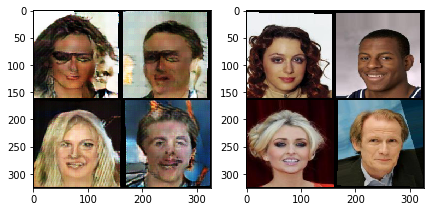

[0/5][2250/8442]	Disc/Dec Trains: 290.0/2251.0	Loss_D: 1.0766	Loss_Dec: 4.2973	Aux F1: 0.8499	Loss_Enc: 940.9816	D(x): 0.6406	D(G(z)): 0.1872
[0/5][2500/8442]	Disc/Dec Trains: 316.0/2501.0	Loss_D: 1.0777	Loss_Dec: 4.2922	Aux F1: 0.8499	Loss_Enc: 940.5329	D(x): 0.7159	D(G(z)): 0.2242
[0/5][2750/8442]	Disc/Dec Trains: 345.0/2751.0	Loss_D: 1.0793	Loss_Dec: 4.2864	Aux F1: 0.8500	Loss_Enc: 940.2706	D(x): 0.6647	D(G(z)): 0.2031
[0/5][3000/8442]	Disc/Dec Trains: 371.0/3001.0	Loss_D: 1.0801	Loss_Dec: 4.2836	Aux F1: 0.8499	Loss_Enc: 940.2360	D(x): 0.6474	D(G(z)): 0.2160
[0/5][3250/8442]	Disc/Dec Trains: 397.0/3251.0	Loss_D: 1.0815	Loss_Dec: 4.2797	Aux F1: 0.8499	Loss_Enc: 940.0903	D(x): 0.7104	D(G(z)): 0.1840
[0/5][3500/8442]	Disc/Dec Trains: 428.0/3501.0	Loss_D: 1.0823	Loss_Dec: 4.2782	Aux F1: 0.8498	Loss_Enc: 940.2124	D(x): 0.5668	D(G(z)): 0.2476
[0/5][3750/8442]	Disc/Dec Trains: 475.0/3751.0	Loss_D: 1.0844	Loss_Dec: 4.2737	Aux F1: 0.8498	Loss_Enc: 940.0555	D(x): 0.7150	D(G(z)): 0.2532
[0/5][

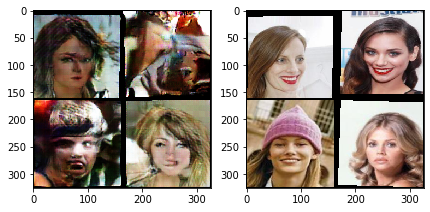

[0/5][4250/8442]	Disc/Dec Trains: 540.0/4251.0	Loss_D: 1.0864	Loss_Dec: 4.2679	Aux F1: 0.8498	Loss_Enc: 939.9189	D(x): 0.6811	D(G(z)): 0.2110
[0/5][4500/8442]	Disc/Dec Trains: 570.0/4501.0	Loss_D: 1.0861	Loss_Dec: 4.2659	Aux F1: 0.8498	Loss_Enc: 939.8475	D(x): 0.6967	D(G(z)): 0.2976
[0/5][4750/8442]	Disc/Dec Trains: 606.0/4751.0	Loss_D: 1.0869	Loss_Dec: 4.2642	Aux F1: 0.8497	Loss_Enc: 939.8720	D(x): 0.7343	D(G(z)): 0.2177
[0/5][5000/8442]	Disc/Dec Trains: 638.0/5001.0	Loss_D: 1.0872	Loss_Dec: 4.2624	Aux F1: 0.8497	Loss_Enc: 939.9577	D(x): 0.6336	D(G(z)): 0.1288
[0/5][5250/8442]	Disc/Dec Trains: 669.0/5250.0	Loss_D: 1.0878	Loss_Dec: 4.2605	Aux F1: 0.8496	Loss_Enc: 939.9626	D(x): 0.6907	D(G(z)): 0.2103
[0/5][5500/8442]	Disc/Dec Trains: 694.0/5500.0	Loss_D: 1.0879	Loss_Dec: 4.2595	Aux F1: 0.8496	Loss_Enc: 940.0770	D(x): 0.6353	D(G(z)): 0.2308
[0/5][5750/8442]	Disc/Dec Trains: 727.0/5750.0	Loss_D: 1.0884	Loss_Dec: 4.2585	Aux F1: 0.8497	Loss_Enc: 940.1518	D(x): 0.7288	D(G(z)): 0.2138
[0/5][

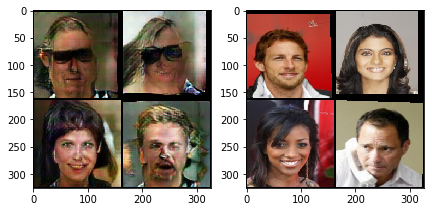

[0/5][6250/8442]	Disc/Dec Trains: 788.0/6250.0	Loss_D: 1.0888	Loss_Dec: 4.2564	Aux F1: 0.8496	Loss_Enc: 940.1138	D(x): 0.6642	D(G(z)): 0.2255
[0/5][6500/8442]	Disc/Dec Trains: 817.0/6500.0	Loss_D: 1.0901	Loss_Dec: 4.2535	Aux F1: 0.8496	Loss_Enc: 939.8603	D(x): 0.6309	D(G(z)): 0.2023
[0/5][6750/8442]	Disc/Dec Trains: 844.0/6750.0	Loss_D: 1.0907	Loss_Dec: 4.2524	Aux F1: 0.8496	Loss_Enc: 939.9230	D(x): 0.7924	D(G(z)): 0.2013
[0/5][7000/8442]	Disc/Dec Trains: 869.0/7000.0	Loss_D: 1.0912	Loss_Dec: 4.2503	Aux F1: 0.8496	Loss_Enc: 939.7975	D(x): 0.6275	D(G(z)): 0.2026
[0/5][7250/8442]	Disc/Dec Trains: 907.0/7250.0	Loss_D: 1.0920	Loss_Dec: 4.2489	Aux F1: 0.8496	Loss_Enc: 939.7942	D(x): 0.7299	D(G(z)): 0.2014
[0/5][7500/8442]	Disc/Dec Trains: 938.0/7499.0	Loss_D: 1.0925	Loss_Dec: 4.2483	Aux F1: 0.8496	Loss_Enc: 939.9067	D(x): 0.6057	D(G(z)): 0.2261
[0/5][7750/8442]	Disc/Dec Trains: 969.0/7749.0	Loss_D: 1.0933	Loss_Dec: 4.2465	Aux F1: 0.8496	Loss_Enc: 939.8792	D(x): 0.6845	D(G(z)): 0.2459
[0/5][

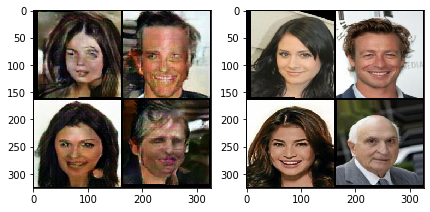

[0/5][8250/8442]	Disc/Dec Trains: 1036.0/8249.0	Loss_D: 1.0942	Loss_Dec: 4.2448	Aux F1: 0.8497	Loss_Enc: 940.0025	D(x): 0.6158	D(G(z)): 0.3382


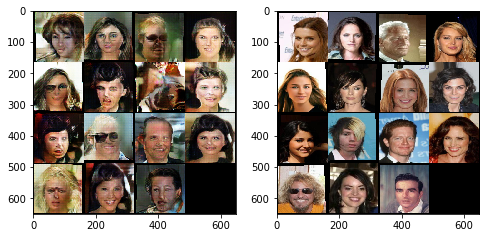

[1/5][0/8442]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.1622	Loss_Dec: 4.3775	Aux F1: 0.8375	Loss_Enc: 960.0741	D(x): 0.6536	D(G(z)): 0.2635
Interrupting... Saving model...
Copying file://./vaegan_dn169_2a.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

|
Operation completed over 1 objects/151.3 MiB.                                

In [0]:
train(net, n_epochs=5, train_loader=train_loader, margin=0.465, plot_images=2000)

In [16]:
!nvidia-smi

Sat Nov  9 10:41:40 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 430.50       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    36W / 250W |  10631MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

[0/1][0/8442]	Disc/Dec Trains: 1.0/1.0	Loss_D: 0.9872	Loss_Dec: 4.5094	Aux F1: 0.8833	Loss_Enc: 725.9054	D(x): 0.6517	D(G(z)): 0.1893
[0/1][250/8442]	Disc/Dec Trains: 24.0/251.0	Loss_D: 0.9799	Loss_Dec: 4.7382	Aux F1: 0.8734	Loss_Enc: 762.5728	D(x): 0.6580	D(G(z)): 0.1953
[0/1][500/8442]	Disc/Dec Trains: 48.0/500.0	Loss_D: 0.9633	Loss_Dec: 4.7353	Aux F1: 0.8731	Loss_Enc: 765.9704	D(x): 0.7164	D(G(z)): 0.1935
[0/1][750/8442]	Disc/Dec Trains: 71.0/750.0	Loss_D: 0.9736	Loss_Dec: 4.6823	Aux F1: 0.8736	Loss_Enc: 774.1387	D(x): 0.6675	D(G(z)): 0.1558
[0/1][1000/8442]	Disc/Dec Trains: 92.0/1000.0	Loss_D: 0.9792	Loss_Dec: 4.6974	Aux F1: 0.8735	Loss_Enc: 780.1264	D(x): 0.5541	D(G(z)): 0.2243
[0/1][1250/8442]	Disc/Dec Trains: 116.0/1250.0	Loss_D: 0.9715	Loss_Dec: 4.6770	Aux F1: 0.8737	Loss_Enc: 794.2721	D(x): 0.8054	D(G(z)): 0.1342
[0/1][1500/8442]	Disc/Dec Trains: 140.0/1500.0	Loss_D: 0.9692	Loss_Dec: 4.6998	Aux F1: 0.8736	Loss_Enc: 793.4750	D(x): 0.7395	D(G(z)): 0.1854
[0/1][1750/8442]	Disc/De

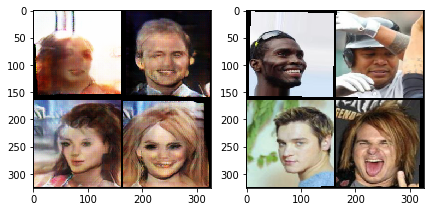

[0/1][2250/8442]	Disc/Dec Trains: 209.0/2250.0	Loss_D: 0.9651	Loss_Dec: 4.7493	Aux F1: 0.8736	Loss_Enc: 794.6772	D(x): 0.6779	D(G(z)): 0.1450
[0/1][2500/8442]	Disc/Dec Trains: 227.0/2500.0	Loss_D: 0.9752	Loss_Dec: 4.7259	Aux F1: 0.8736	Loss_Enc: 792.6749	D(x): 0.6478	D(G(z)): 0.1651
[0/1][2750/8442]	Disc/Dec Trains: 247.0/2750.0	Loss_D: 0.9785	Loss_Dec: 4.7087	Aux F1: 0.8737	Loss_Enc: 790.2380	D(x): 0.6018	D(G(z)): 0.1276
[0/1][3000/8442]	Disc/Dec Trains: 272.0/3000.0	Loss_D: 0.9786	Loss_Dec: 4.7012	Aux F1: 0.8737	Loss_Enc: 790.6452	D(x): 0.7016	D(G(z)): 0.1696
[0/1][3250/8442]	Disc/Dec Trains: 293.0/3249.0	Loss_D: 0.9797	Loss_Dec: 4.6932	Aux F1: 0.8737	Loss_Enc: 786.9293	D(x): 0.6124	D(G(z)): 0.2127
[0/1][3500/8442]	Disc/Dec Trains: 314.0/3499.0	Loss_D: 0.9812	Loss_Dec: 4.6998	Aux F1: 0.8737	Loss_Enc: 787.1830	D(x): 0.6753	D(G(z)): 0.1628
[0/1][3750/8442]	Disc/Dec Trains: 337.0/3749.0	Loss_D: 0.9805	Loss_Dec: 4.7008	Aux F1: 0.8738	Loss_Enc: 787.0502	D(x): 0.7357	D(G(z)): 0.1772
[0/1][

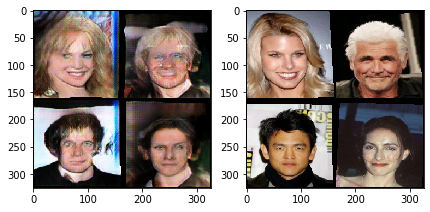

[0/1][4250/8442]	Disc/Dec Trains: 378.0/4249.0	Loss_D: 0.9813	Loss_Dec: 4.6863	Aux F1: 0.8740	Loss_Enc: 787.0206	D(x): 0.7710	D(G(z)): 0.1243
[0/1][4500/8442]	Disc/Dec Trains: 400.0/4499.0	Loss_D: 0.9816	Loss_Dec: 4.6796	Aux F1: 0.8741	Loss_Enc: 785.9613	D(x): 0.5897	D(G(z)): 0.2763
[0/1][4750/8442]	Disc/Dec Trains: 423.0/4749.0	Loss_D: 0.9807	Loss_Dec: 4.6852	Aux F1: 0.8741	Loss_Enc: 787.1575	D(x): 0.7108	D(G(z)): 0.2482
[0/1][5000/8442]	Disc/Dec Trains: 444.0/4999.0	Loss_D: 0.9793	Loss_Dec: 4.6934	Aux F1: 0.8742	Loss_Enc: 787.5849	D(x): 0.7375	D(G(z)): 0.0998
[0/1][5250/8442]	Disc/Dec Trains: 468.0/5249.0	Loss_D: 0.9792	Loss_Dec: 4.6886	Aux F1: 0.8743	Loss_Enc: 790.2453	D(x): 0.5942	D(G(z)): 0.2612
[0/1][5500/8442]	Disc/Dec Trains: 494.0/5499.0	Loss_D: 0.9761	Loss_Dec: 4.6961	Aux F1: 0.8743	Loss_Enc: 790.2132	D(x): 0.6081	D(G(z)): 0.1356
[0/1][5750/8442]	Disc/Dec Trains: 516.0/5749.0	Loss_D: 0.9745	Loss_Dec: 4.7067	Aux F1: 0.8743	Loss_Enc: 790.1907	D(x): 0.6839	D(G(z)): 0.1903
[0/1][

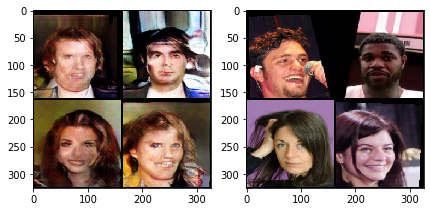

[0/1][6250/8442]	Disc/Dec Trains: 557.0/6249.0	Loss_D: 0.9739	Loss_Dec: 4.7001	Aux F1: 0.8744	Loss_Enc: 786.5358	D(x): 0.7118	D(G(z)): 0.2173
[0/1][6500/8442]	Disc/Dec Trains: 580.0/6499.0	Loss_D: 0.9728	Loss_Dec: 4.7046	Aux F1: 0.8744	Loss_Enc: 785.4148	D(x): 0.5943	D(G(z)): 0.1490
[0/1][6750/8442]	Disc/Dec Trains: 601.0/6749.0	Loss_D: 0.9760	Loss_Dec: 4.7007	Aux F1: 0.8744	Loss_Enc: 785.4026	D(x): 0.5441	D(G(z)): 0.2299
[0/1][7000/8442]	Disc/Dec Trains: 623.0/6998.0	Loss_D: 0.9763	Loss_Dec: 4.6966	Aux F1: 0.8745	Loss_Enc: 786.4929	D(x): 0.5688	D(G(z)): 0.3058
[0/1][7250/8442]	Disc/Dec Trains: 643.0/7248.0	Loss_D: 0.9780	Loss_Dec: 4.6884	Aux F1: 0.8746	Loss_Enc: 786.3316	D(x): 0.6831	D(G(z)): 0.1529
[0/1][7500/8442]	Disc/Dec Trains: 662.0/7498.0	Loss_D: 0.9786	Loss_Dec: 4.6805	Aux F1: 0.8747	Loss_Enc: 786.2779	D(x): 0.5672	D(G(z)): 0.4229
[0/1][7750/8442]	Disc/Dec Trains: 685.0/7748.0	Loss_D: 0.9782	Loss_Dec: 4.6720	Aux F1: 0.8748	Loss_Enc: 786.3062	D(x): 0.7279	D(G(z)): 0.1439
[0/1][

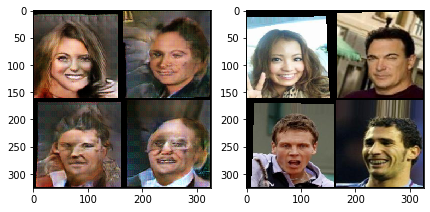

[0/1][8250/8442]	Disc/Dec Trains: 730.0/8248.0	Loss_D: 0.9757	Loss_Dec: 4.6716	Aux F1: 0.8749	Loss_Enc: 787.9688	D(x): 0.7848	D(G(z)): 0.1536


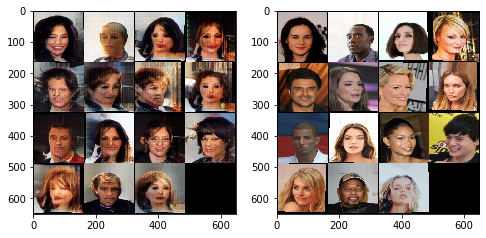

Copying file://./vaegan_dn169_2a.pt [Content-Type=application/octet-stream]...
==> NOTE: You are uploading one or more large file(s), which would run
significantly faster if you enable parallel composite uploads. This
feature can be enabled by editing the
"parallel_composite_upload_threshold" value in your .boto
configuration file. However, note that if you do this large files will
be uploaded as `composite objects
<https://cloud.google.com/storage/docs/composite-objects>`_,which
means that any user who downloads such objects will need to have a
compiled crcmod installed (see "gsutil help crcmod"). This is because
without a compiled crcmod, computing checksums on composite objects is
so slow that gsutil disables downloads of composite objects.

|
Operation completed over 1 objects/151.3 MiB.                                    
Copying file://./vaegan_dn169_opt_disc_2a.pt [Content-Type=application/octet-stream]...
-
Operation completed over 1 objects/48.0 MiB.                           

In [17]:
train(net, n_epochs=1, train_loader=train_loader, margin=0.47, plot_images=2000)

[0/1][0/8442]	Disc/Dec Trains: 1.0/1.0	Loss_D: 1.0012	Loss_Dec: 4.1577	Aux F1: 0.8844	Loss_Enc: 741.5117	D(x): 0.6885	D(G(z)): 0.2417
[0/1][250/8442]	Disc/Dec Trains: 18.0/251.0	Loss_D: 1.0987	Loss_Dec: 4.3477	Aux F1: 0.8792	Loss_Enc: 769.9559	D(x): 0.6165	D(G(z)): 0.2623
[0/1][500/8442]	Disc/Dec Trains: 37.0/501.0	Loss_D: 1.0694	Loss_Dec: 4.3381	Aux F1: 0.8792	Loss_Enc: 774.5367	D(x): 0.6473	D(G(z)): 0.1132
[0/1][750/8442]	Disc/Dec Trains: 52.0/751.0	Loss_D: 1.0685	Loss_Dec: 4.3609	Aux F1: 0.8786	Loss_Enc: 771.7178	D(x): 0.6783	D(G(z)): 0.1918
[0/1][1000/8442]	Disc/Dec Trains: 73.0/1001.0	Loss_D: 1.0626	Loss_Dec: 4.4008	Aux F1: 0.8788	Loss_Enc: 763.5718	D(x): 0.7498	D(G(z)): 0.2550
[0/1][1250/8442]	Disc/Dec Trains: 90.0/1251.0	Loss_D: 1.0510	Loss_Dec: 4.4106	Aux F1: 0.8789	Loss_Enc: 764.6172	D(x): 0.6206	D(G(z)): 0.2921
[0/1][1500/8442]	Disc/Dec Trains: 108.0/1501.0	Loss_D: 1.0490	Loss_Dec: 4.3923	Aux F1: 0.8790	Loss_Enc: 770.8097	D(x): 0.6808	D(G(z)): 0.3521
[0/1][1750/8442]	Disc/Dec

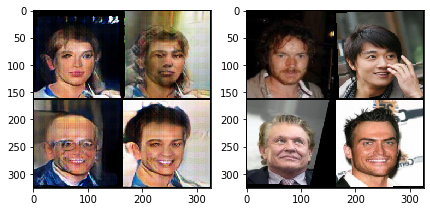

[0/1][2250/8442]	Disc/Dec Trains: 166.0/2249.0	Loss_D: 1.0384	Loss_Dec: 4.3585	Aux F1: 0.8794	Loss_Enc: 776.6917	D(x): 0.6874	D(G(z)): 0.2294
[0/1][2500/8442]	Disc/Dec Trains: 187.0/2499.0	Loss_D: 1.0317	Loss_Dec: 4.3683	Aux F1: 0.8793	Loss_Enc: 778.6909	D(x): 0.6755	D(G(z)): 0.2470
[0/1][2750/8442]	Disc/Dec Trains: 201.0/2749.0	Loss_D: 1.0333	Loss_Dec: 4.3670	Aux F1: 0.8794	Loss_Enc: 779.1338	D(x): 0.6536	D(G(z)): 0.2285
[0/1][3000/8442]	Disc/Dec Trains: 217.0/2999.0	Loss_D: 1.0368	Loss_Dec: 4.3579	Aux F1: 0.8794	Loss_Enc: 780.2104	D(x): 0.5864	D(G(z)): 0.3840
[0/1][3250/8442]	Disc/Dec Trains: 234.0/3249.0	Loss_D: 1.0339	Loss_Dec: 4.3589	Aux F1: 0.8795	Loss_Enc: 779.1178	D(x): 0.6032	D(G(z)): 0.2132
[0/1][3500/8442]	Disc/Dec Trains: 250.0/3499.0	Loss_D: 1.0342	Loss_Dec: 4.3573	Aux F1: 0.8797	Loss_Enc: 778.8939	D(x): 0.6134	D(G(z)): 0.2468
[0/1][3750/8442]	Disc/Dec Trains: 268.0/3749.0	Loss_D: 1.0291	Loss_Dec: 4.3793	Aux F1: 0.8798	Loss_Enc: 780.7832	D(x): 0.6543	D(G(z)): 0.2360
[0/1][

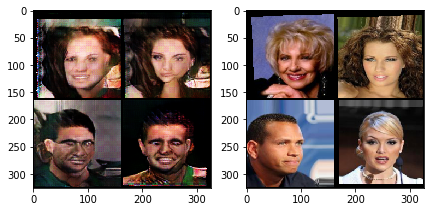

[0/1][4250/8442]	Disc/Dec Trains: 300.0/4249.0	Loss_D: 1.0276	Loss_Dec: 4.3835	Aux F1: 0.8800	Loss_Enc: 783.4532	D(x): 0.6385	D(G(z)): 0.1814
[0/1][4500/8442]	Disc/Dec Trains: 315.0/4499.0	Loss_D: 1.0284	Loss_Dec: 4.3833	Aux F1: 0.8800	Loss_Enc: 782.9736	D(x): 0.5355	D(G(z)): 0.3096
[0/1][4750/8442]	Disc/Dec Trains: 331.0/4749.0	Loss_D: 1.0246	Loss_Dec: 4.3923	Aux F1: 0.8800	Loss_Enc: 781.4080	D(x): 0.5778	D(G(z)): 0.2040
[0/1][5000/8442]	Disc/Dec Trains: 349.0/4999.0	Loss_D: 1.0240	Loss_Dec: 4.3917	Aux F1: 0.8801	Loss_Enc: 783.3897	D(x): 0.7332	D(G(z)): 0.1416


In [0]:
train(net, n_epochs=1, train_loader=train_loader, margin=0.475, plot_images=2000)

In [0]:
optimizer_decoder.step()
optimizer_encoder.step()
optimizer_discriminator.step()

In [0]:
for pg in optimizer_encoder.param_groups:
    print(pg['lr'])

2.6557869305835215e-08


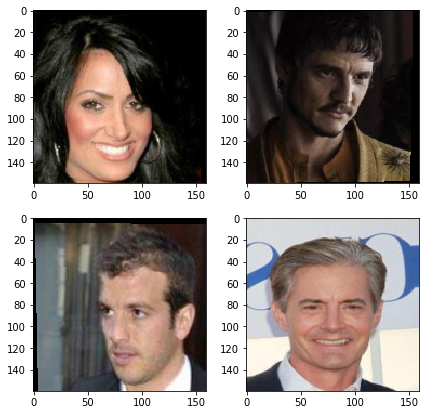

Pred Attrs 1: Index(['Attractive', 'Heavy_Makeup', 'High_Cheekbones', 'Mouth_Slightly_Open',
       'No_Beard', 'Smiling', 'Wavy_Hair', 'Wearing_Lipstick', 'Young'],
      dtype='object')
GT Attrs 1: Index(['Arched_Eyebrows', 'Attractive', 'Bangs', 'Big_Nose', 'Heavy_Makeup',
       'High_Cheekbones', 'Mouth_Slightly_Open', 'No_Beard', 'Pointy_Nose',
       'Rosy_Cheeks', 'Smiling', 'Wavy_Hair', 'Wearing_Earrings',
       'Wearing_Lipstick', 'Young'],
      dtype='object')

Pred Attrs 2: Index(['Male', 'No_Beard', 'Young'], dtype='object')
GT Attrs 2: Index([], dtype='object')

Pred Attrs 3: Index(['Male', 'No_Beard', 'Young'], dtype='object')
GT Attrs 3: Index(['5_o_Clock_Shadow', 'Male', 'No_Beard', 'Wearing_Necktie', 'Young'], dtype='object')

Pred Attrs 4: Index(['Bags_Under_Eyes', 'Big_Nose', 'High_Cheekbones', 'Male',
       'Mouth_Slightly_Open', 'No_Beard', 'Smiling'],
      dtype='object')
GT Attrs 4: Index(['Bags_Under_Eyes', 'Bushy_Eyebrows', 'High_Cheekbones', 'Male',
     

In [0]:
with torch.no_grad():
    for (inputs, b_labels) in train_loader:
#     inputs, labels = next(iter(train_loader))
        inputs = inputs.cuda()
        
        output, out_labels, classes, fm_r, mus, variances = net(inputs)

        # get the predicted attributes
        preds = torch.round(classes).squeeze().detach().cpu().numpy()        
        
        image_1_attrs = image_labels.columns[1:][preds[0] == 1]
        image_2_attrs = image_labels.columns[1:][preds[1] == 1]
        image_3_attrs = image_labels.columns[1:][preds[2] == 1]
        image_4_attrs = image_labels.columns[1:][preds[3] == 1]
        
        b_labels = b_labels.detach().cpu().numpy()
        image_1_gt = image_labels.columns[1:][b_labels[0] == 1]
        image_2_gt = image_labels.columns[1:][b_labels[1] == 1]
        image_3_gt = image_labels.columns[1:][b_labels[2] == 1]
        image_4_gt = image_labels.columns[1:][b_labels[3] == 1]
        
        inputs = (inputs * 0.5) + 0.5
        fig, ax = plt.subplots(2, 2, figsize=(7,7))
        ax[0,0].imshow(inputs[0].detach().cpu().permute(1,2,0))
        ax[0,1].imshow(inputs[1].detach().cpu().permute(1,2,0))
        ax[1,0].imshow(inputs[2].detach().cpu().permute(1,2,0))
        ax[1,1].imshow(inputs[3].detach().cpu().permute(1,2,0))
        plt.show()   
        
        print("Pred Attrs 1:", image_1_attrs)
        print("GT Attrs 1:", image_1_gt)
        print()
        print("Pred Attrs 2:", image_2_attrs)
        print("GT Attrs 2:", image_2_gt)
        print()
        print("Pred Attrs 3:", image_3_attrs)
        print("GT Attrs 3:", image_3_gt)
        print()
        print("Pred Attrs 4:", image_4_attrs)
        print("GT Attrs 4:", image_4_gt)
        print()
        break

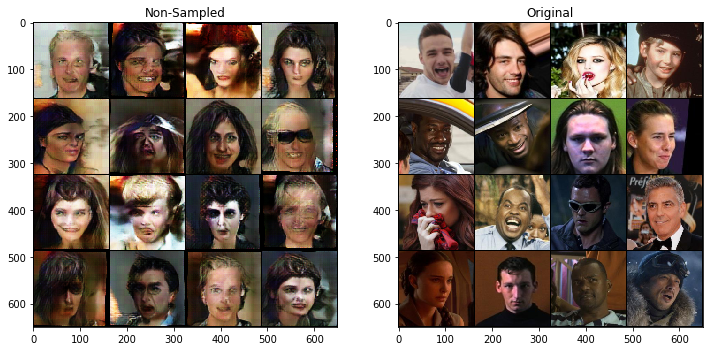

Code mean: 0.011311447247862816
Code max: 17.622909545898438
Code min: -17.45543670654297
Code var: 0.8258548974990845

Logvar mean: -1.6326783895492554
Logvar var: 0.37123122811317444
Logvar Exp: 0.23119306564331055


In [0]:
with torch.no_grad():
    inputs, _ = next(iter(test_loader))
    inputs = inputs.cuda()
    
    fake, out_labels, classes, out_layer, code, logvar = net(inputs)
    
    train_batch = inputs.shape[0]
    
    out_layer_predicted = fake[:train_batch]
    out_layer_original = fake[train_batch:-train_batch]
    out_layer_sampled = fake[-train_batch:]
    
    fig, ax = plt.subplots(1, 2, figsize=(12,12))
    ax[0].imshow(np.transpose(vutils.make_grid(out_layer_predicted.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
    ax[0].set_title("Non-Sampled")
#     ax[1].imshow(np.transpose(vutils.make_grid(out_layer_sampled.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
#     ax[1].set_title("Sampled")
    ax[1].imshow(np.transpose(vutils.make_grid(inputs.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
    ax[1].set_title("Original")
    plt.show()   

print("Code mean:", code.mean().item())
print("Code max:", code.max().item())
print("Code min:", code.min().item())
print("Code var:", code.var().item())
print()

# print("SCode mean:", code_s.mean().item())
# print("SCode max:", code_s.max().item())
# print("SCode min:", code_s.min().item())
# print("SCode var:", code_s.var().item())
# print()

print("Logvar mean:", logvar.mean().item())
print("Logvar var:", logvar.var().item())
print("Logvar Exp:", logvar.exp().mean().item())

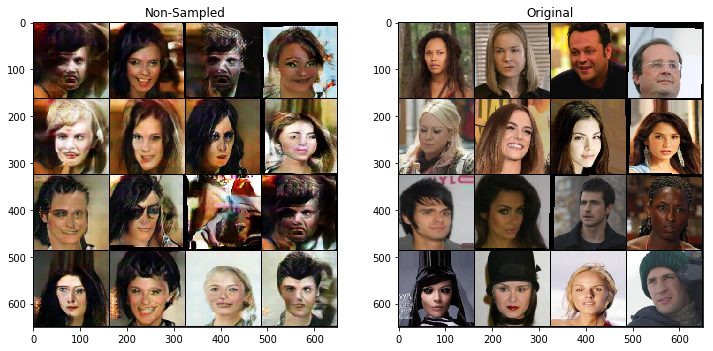

Code mean: 0.010948099195957184
Code max: 11.656641006469727
Code min: -11.153818130493164
Code var: 0.8531774282455444

Logvar mean: -1.6350570917129517
Logvar var: 0.3682040572166443
Logvar Exp: 0.23334483802318573


In [0]:
with torch.no_grad():
    inputs, _ = next(iter(train_loader))
    inputs = inputs.cuda()
    
    fake, out_labels, classes, out_layer, code, logvar = net(inputs)
    
    train_batch = inputs.shape[0]
    
    out_layer_predicted = fake[:train_batch]
    out_layer_original = fake[train_batch:-train_batch]
    out_layer_sampled = fake[-train_batch:]
    
    fig, ax = plt.subplots(1, 2, figsize=(12,12))
    ax[0].imshow(np.transpose(vutils.make_grid(out_layer_predicted.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
    ax[0].set_title("Non-Sampled")
#     ax[1].imshow(np.transpose(vutils.make_grid(out_layer_sampled.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
#     ax[1].set_title("Sampled")
    ax[1].imshow(np.transpose(vutils.make_grid(inputs.detach().cpu()[:16], nrow=4, padding=2, normalize=True),(1,2,0)))
    ax[1].set_title("Original")
    plt.show()   

print("Code mean:", code.mean().item())
print("Code max:", code.max().item())
print("Code min:", code.min().item())
print("Code var:", code.var().item())
print()

# print("SCode mean:", code_s.mean().item())
# print("SCode max:", code_s.max().item())
# print("SCode min:", code_s.min().item())
# print("SCode var:", code_s.var().item())
# print()

print("Logvar mean:", logvar.mean().item())
print("Logvar var:", logvar.var().item())
print("Logvar Exp:", logvar.exp().mean().item())